In [ ]:
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2023-11-03 14:10:18--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving github.com (github.com)... 140.82.112.3
Connecting to github.com (github.com)|140.82.112.3|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2023-11-03 14:10:18--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.108.133, 185.199.110.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: ‘utils.py.1’

utils.py.1          100%[===================>]   2.57K  --.-KB/s    in 0s      

2023-11-03 14:10:18 (46.8 MB/s) - ‘utils.py.1’ saved [2627/2627]



In [ ]:
%run 'utils.py'

In [ ]:
import argparse
import os
import time

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets
import torch.optim.lr_scheduler

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [ ]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self, data_increase=False):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=data_increase),
        )

        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output

def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False, get_dataset=get_dataset, model=ConvNet(), scheduler=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = model
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    if scheduler:
        lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)

        if scheduler:
            lr_sched.step()

        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 170498071/170498071 [00:03<00:00, 48806536.40it/s]


Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.166s (2.166s)	Loss 2.3038 (2.3038)	Prec@1   7.8 (  7.8)	Prec@5  47.7 ( 47.7)


<Figure size 640x480 with 0 Axes>

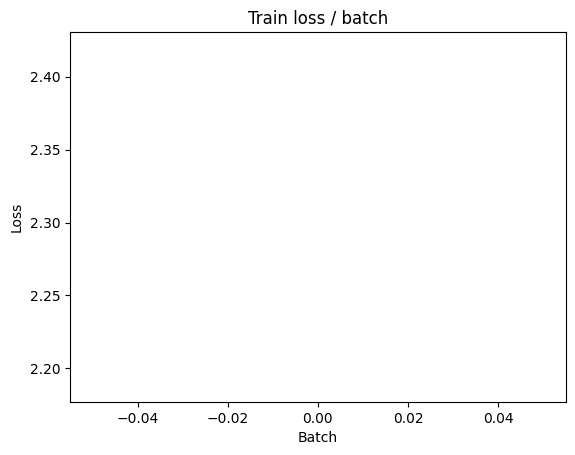

[TRAIN Batch 200/391]	Time 0.018s (0.030s)	Loss 2.1287 (2.2466)	Prec@1  25.0 ( 15.2)	Prec@5  74.2 ( 61.4)


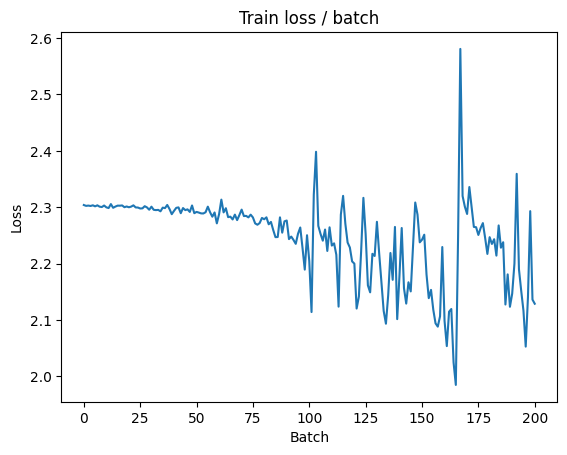


===============> Total time 12s	Avg loss 2.1280	Avg Prec@1 21.29 %	Avg Prec@5 69.53 %

[EVAL Batch 000/079]	Time 0.098s (0.098s)	Loss 1.7703 (1.7703)	Prec@1  34.4 ( 34.4)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7557	Avg Prec@1 35.92 %	Avg Prec@5 86.49 %



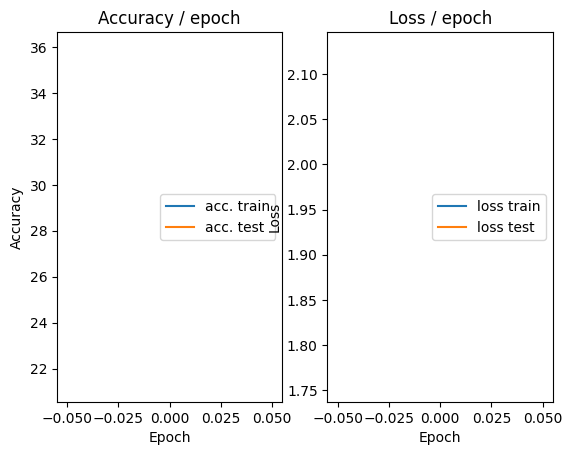

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 1.7420 (1.7420)	Prec@1  33.6 ( 33.6)	Prec@5  90.6 ( 90.6)


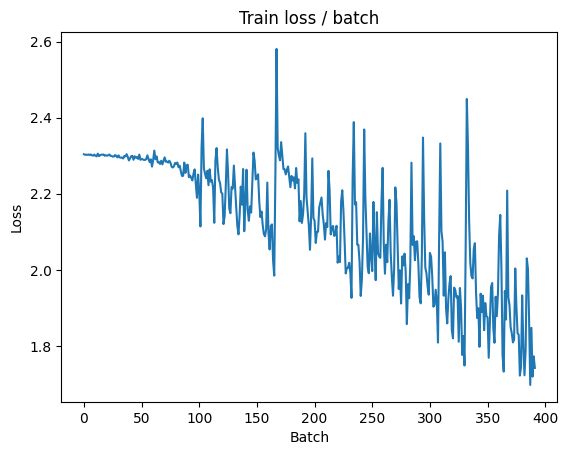

[TRAIN Batch 200/391]	Time 0.016s (0.020s)	Loss 1.5802 (1.7601)	Prec@1  39.1 ( 36.7)	Prec@5  93.8 ( 86.3)


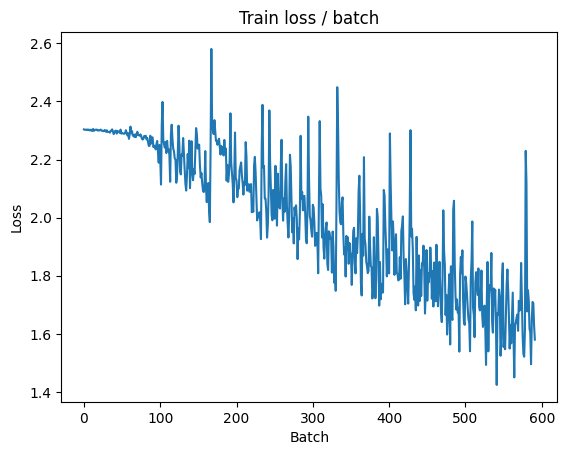


===============> Total time 8s	Avg loss 1.6718	Avg Prec@1 39.77 %	Avg Prec@5 88.30 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 1.4766 (1.4766)	Prec@1  52.3 ( 52.3)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.4974	Avg Prec@1 47.02 %	Avg Prec@5 91.36 %



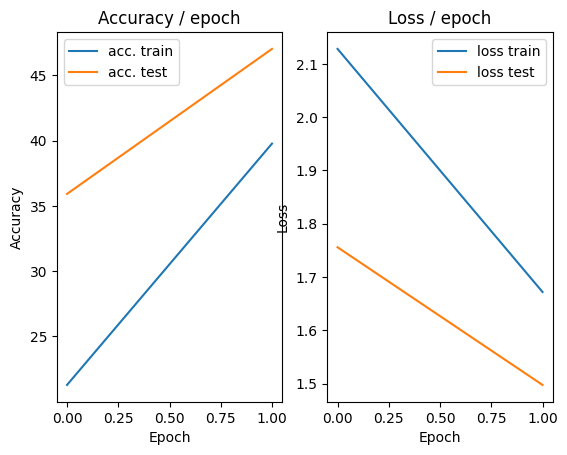

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.107s (0.107s)	Loss 1.5248 (1.5248)	Prec@1  46.1 ( 46.1)	Prec@5  91.4 ( 91.4)


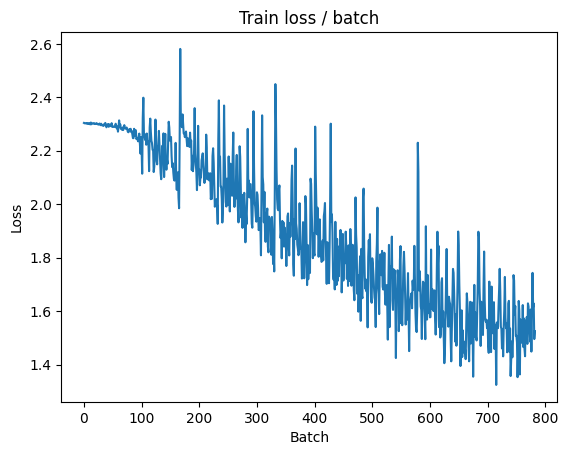

[TRAIN Batch 200/391]	Time 0.011s (0.021s)	Loss 1.2392 (1.4557)	Prec@1  57.8 ( 47.8)	Prec@5  93.0 ( 92.0)


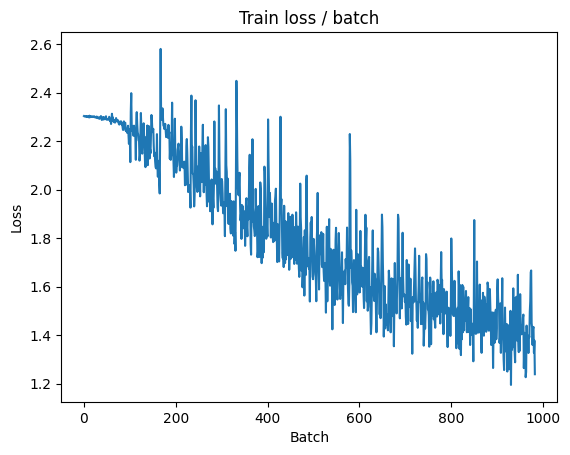


===============> Total time 8s	Avg loss 1.4188	Avg Prec@1 49.21 %	Avg Prec@5 92.54 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 1.3804 (1.3804)	Prec@1  48.4 ( 48.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.5114	Avg Prec@1 46.03 %	Avg Prec@5 92.54 %



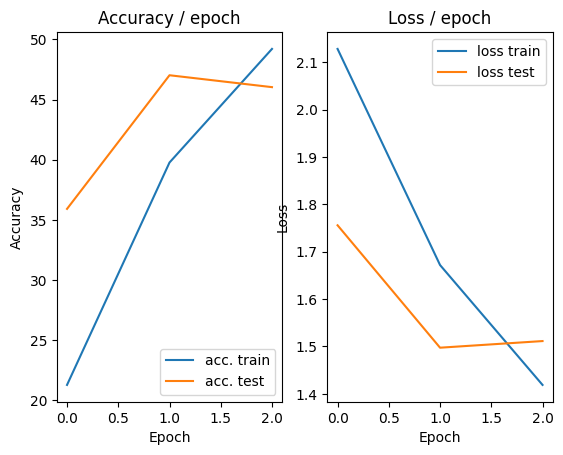

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 1.4036 (1.4036)	Prec@1  51.6 ( 51.6)	Prec@5  93.8 ( 93.8)


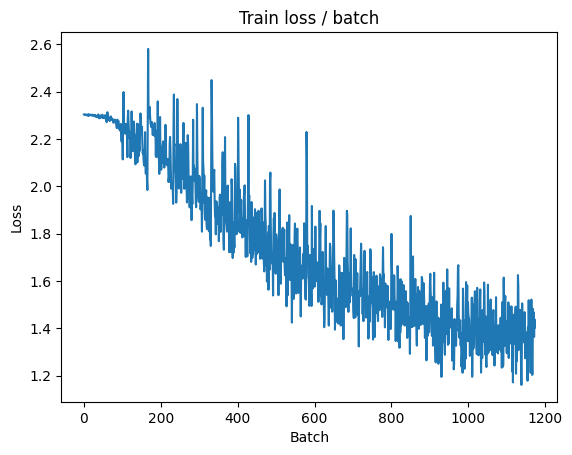

[TRAIN Batch 200/391]	Time 0.013s (0.026s)	Loss 1.4847 (1.2935)	Prec@1  47.7 ( 53.7)	Prec@5  91.4 ( 94.3)


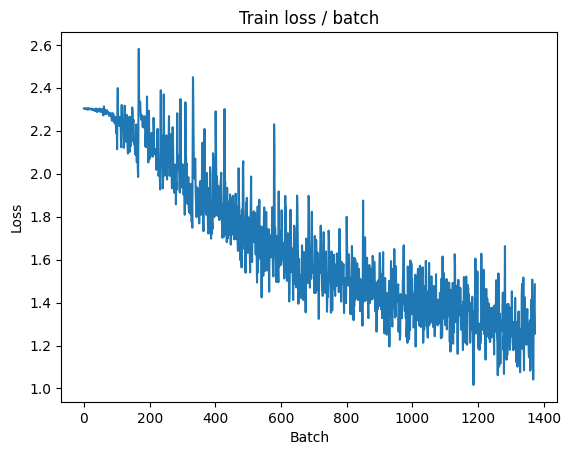


===============> Total time 9s	Avg loss 1.2650	Avg Prec@1 55.03 %	Avg Prec@5 94.49 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.0799 (1.0799)	Prec@1  64.8 ( 64.8)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2413	Avg Prec@1 55.80 %	Avg Prec@5 94.24 %



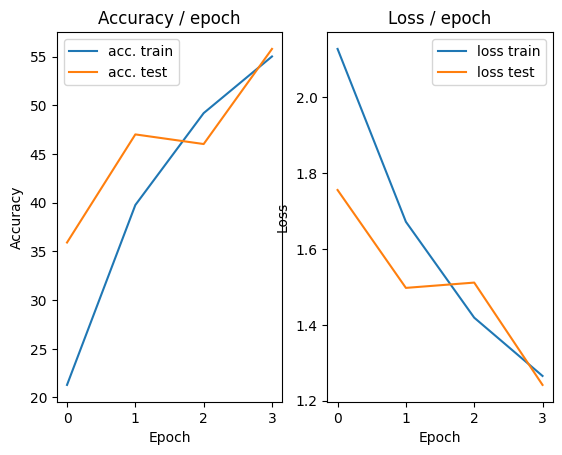

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 1.2668 (1.2668)	Prec@1  54.7 ( 54.7)	Prec@5  94.5 ( 94.5)


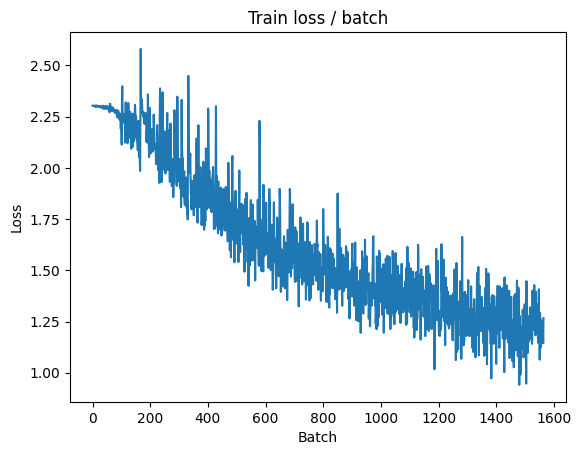

[TRAIN Batch 200/391]	Time 0.029s (0.026s)	Loss 1.1653 (1.1475)	Prec@1  57.0 ( 59.6)	Prec@5  96.1 ( 95.8)


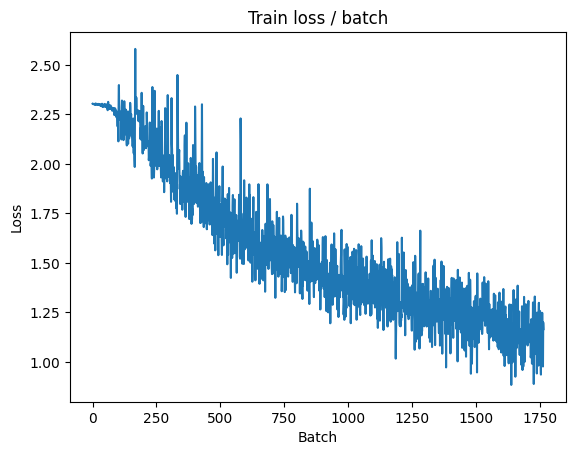


===============> Total time 9s	Avg loss 1.1336	Avg Prec@1 60.12 %	Avg Prec@5 95.76 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.9505 (0.9505)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1535	Avg Prec@1 59.29 %	Avg Prec@5 95.70 %



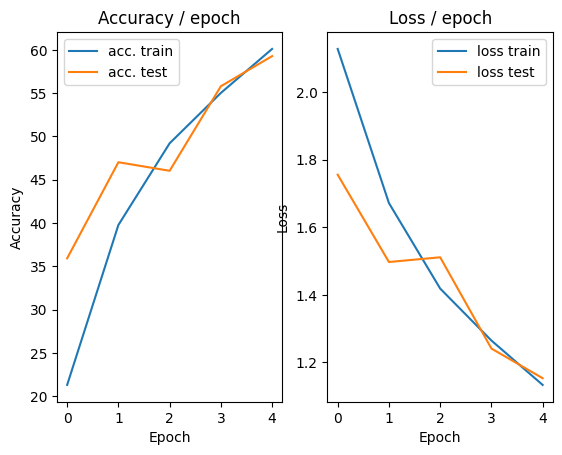

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.0576 (1.0576)	Prec@1  68.8 ( 68.8)	Prec@5  93.8 ( 93.8)


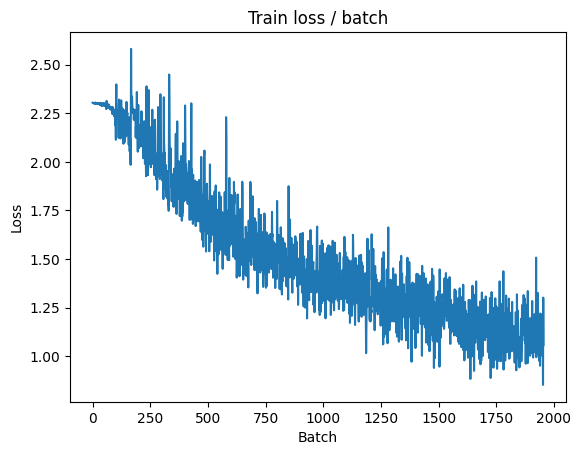

[TRAIN Batch 200/391]	Time 0.022s (0.026s)	Loss 0.9919 (1.0286)	Prec@1  64.8 ( 63.9)	Prec@5  97.7 ( 96.7)


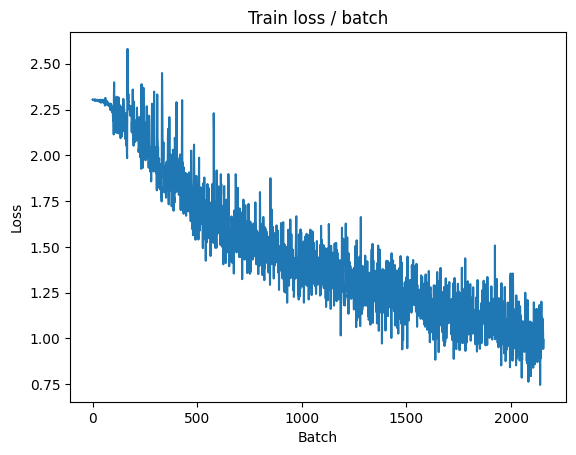


===============> Total time 9s	Avg loss 1.0128	Avg Prec@1 64.55 %	Avg Prec@5 96.69 %

[EVAL Batch 000/079]	Time 0.173s (0.173s)	Loss 1.0997 (1.0997)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1754	Avg Prec@1 58.49 %	Avg Prec@5 95.93 %



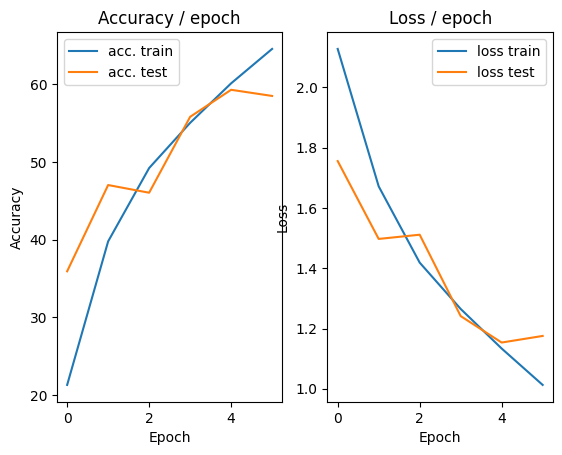

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 0.9102 (0.9102)	Prec@1  63.3 ( 63.3)	Prec@5  98.4 ( 98.4)


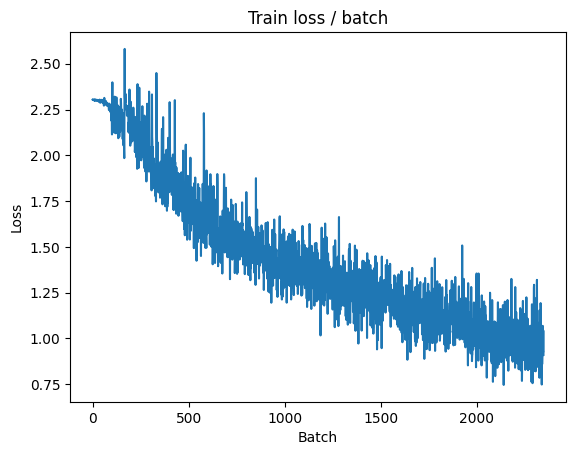

[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.9990 (0.9162)	Prec@1  61.7 ( 67.7)	Prec@5  98.4 ( 97.5)


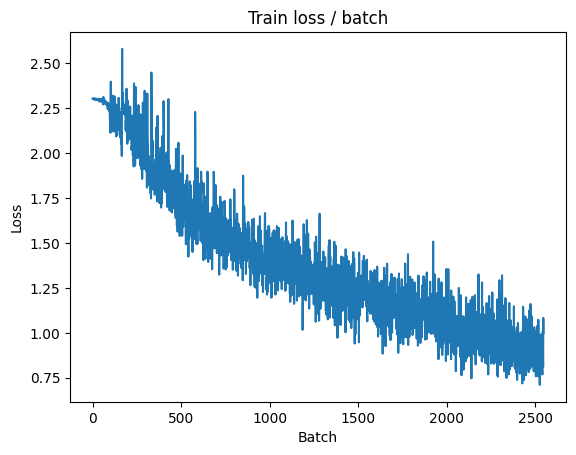


===============> Total time 9s	Avg loss 0.8998	Avg Prec@1 68.28 %	Avg Prec@5 97.49 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 1.0566 (1.0566)	Prec@1  58.6 ( 58.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0536	Avg Prec@1 62.71 %	Avg Prec@5 96.17 %



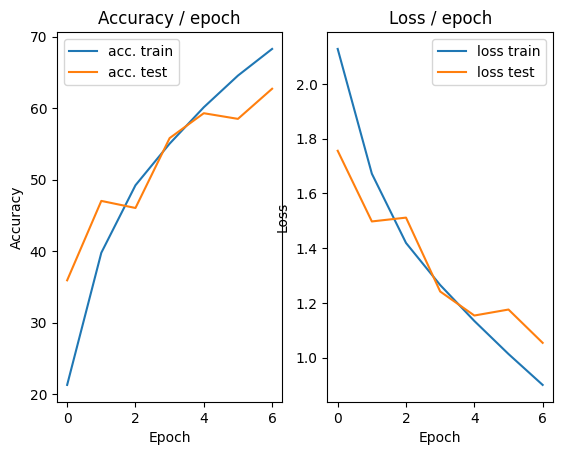

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.8636 (0.8636)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


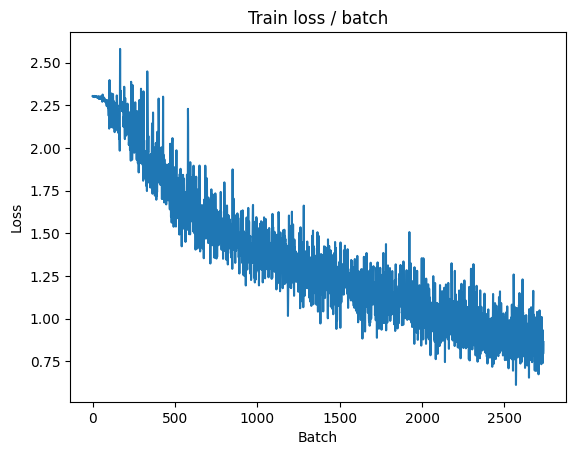

[TRAIN Batch 200/391]	Time 0.041s (0.021s)	Loss 0.8486 (0.7999)	Prec@1  71.9 ( 71.9)	Prec@5 100.0 ( 98.2)


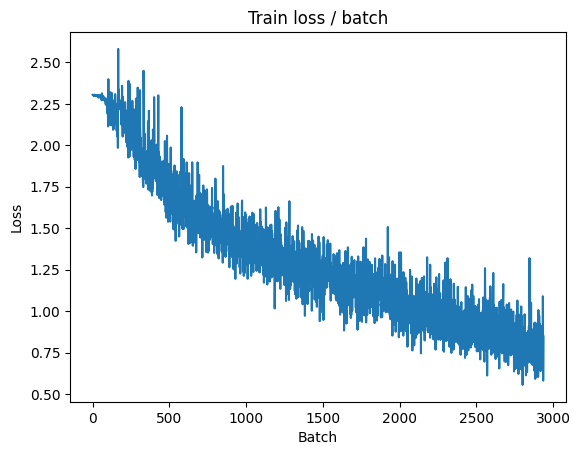


===============> Total time 9s	Avg loss 0.8031	Avg Prec@1 71.82 %	Avg Prec@5 98.15 %

[EVAL Batch 000/079]	Time 0.114s (0.114s)	Loss 0.9898 (0.9898)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9906	Avg Prec@1 65.49 %	Avg Prec@5 96.88 %



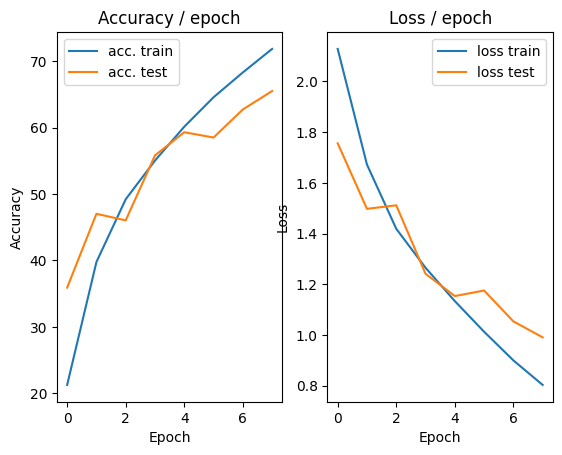

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.7533 (0.7533)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)


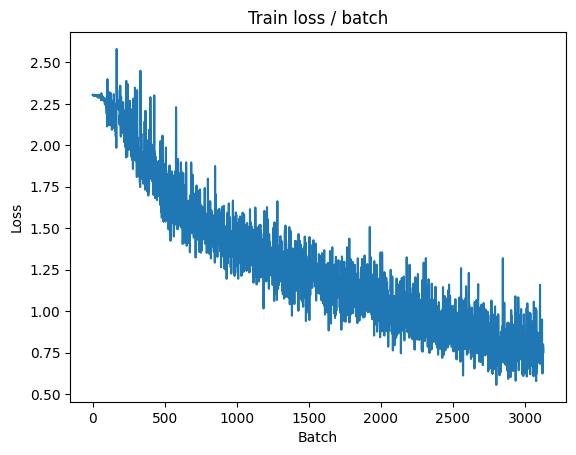

[TRAIN Batch 200/391]	Time 0.020s (0.021s)	Loss 0.6564 (0.6964)	Prec@1  75.8 ( 75.5)	Prec@5 100.0 ( 98.7)


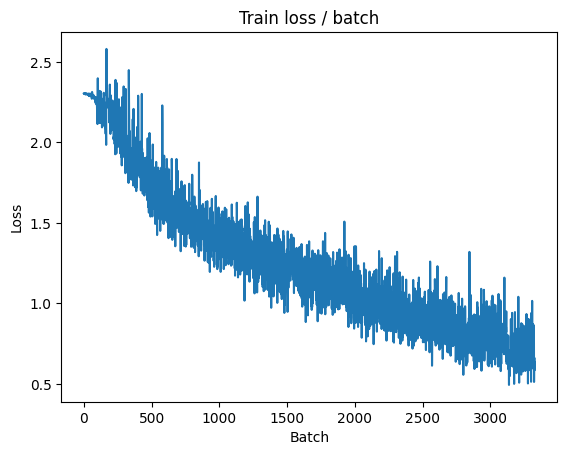


===============> Total time 10s	Avg loss 0.6970	Avg Prec@1 75.64 %	Avg Prec@5 98.66 %

[EVAL Batch 000/079]	Time 0.184s (0.184s)	Loss 0.8627 (0.8627)	Prec@1  66.4 ( 66.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.9942	Avg Prec@1 66.65 %	Avg Prec@5 97.10 %



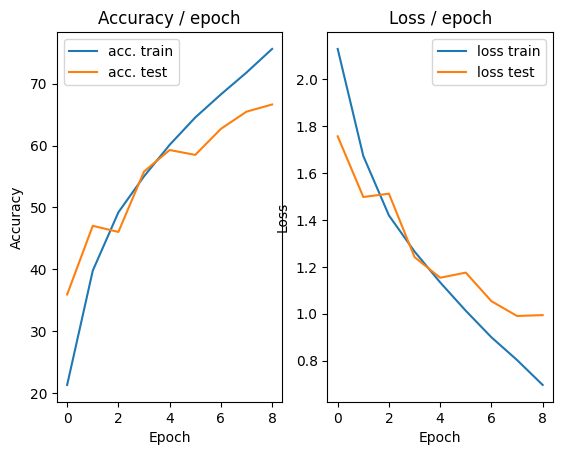

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.6796 (0.6796)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)


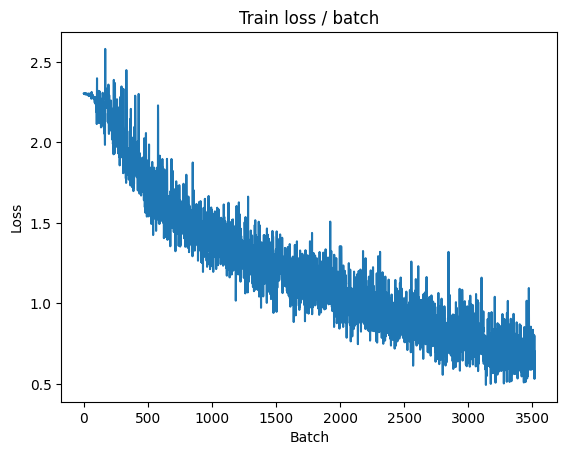

[TRAIN Batch 200/391]	Time 0.019s (0.021s)	Loss 0.5187 (0.5911)	Prec@1  81.2 ( 79.4)	Prec@5 100.0 ( 99.1)


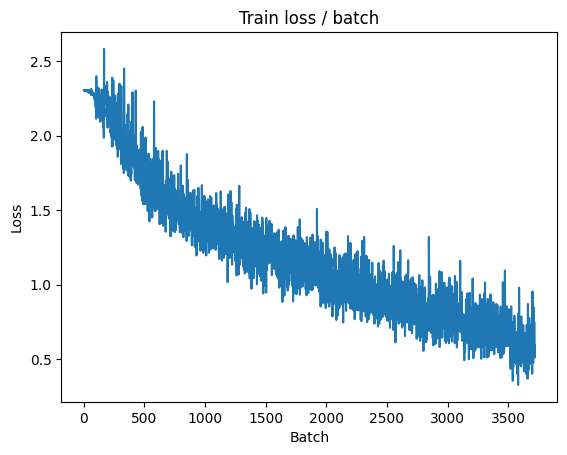


===============> Total time 8s	Avg loss 0.6054	Avg Prec@1 78.74 %	Avg Prec@5 99.03 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.9319 (0.9319)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 2s	Avg loss 0.9238	Avg Prec@1 68.53 %	Avg Prec@5 97.51 %



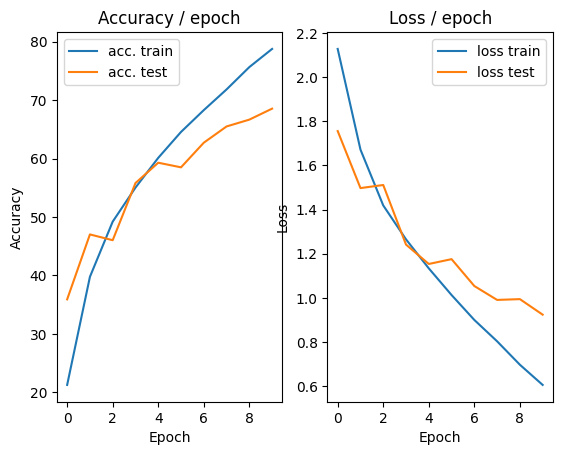

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.4624 (0.4624)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


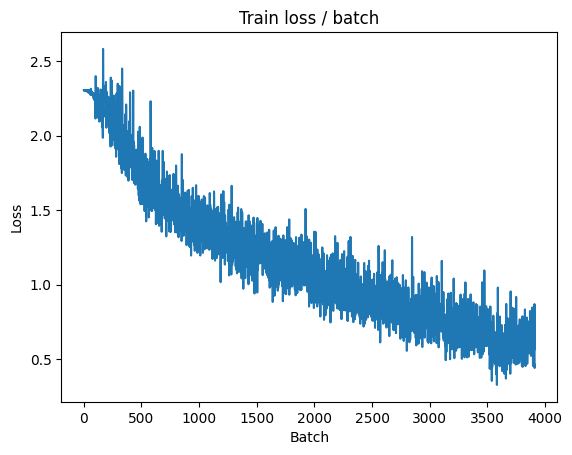

[TRAIN Batch 200/391]	Time 0.009s (0.021s)	Loss 0.6152 (0.5000)	Prec@1  78.1 ( 82.5)	Prec@5 100.0 ( 99.4)


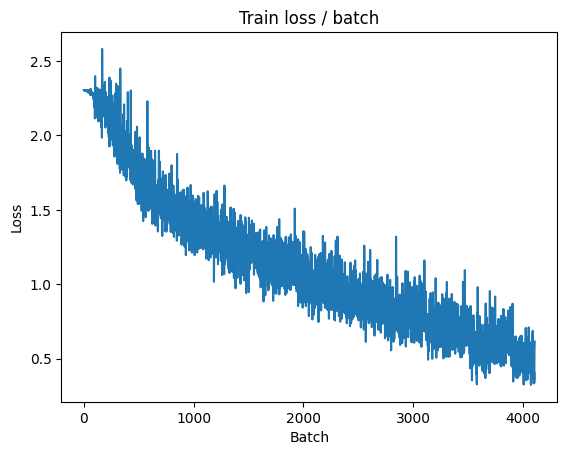


===============> Total time 8s	Avg loss 0.5069	Avg Prec@1 82.27 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 0.9751 (0.9751)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9551	Avg Prec@1 69.08 %	Avg Prec@5 97.32 %



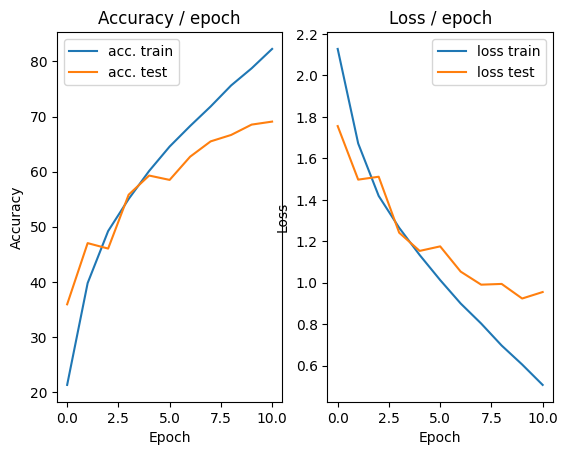

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 0.3558 (0.3558)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


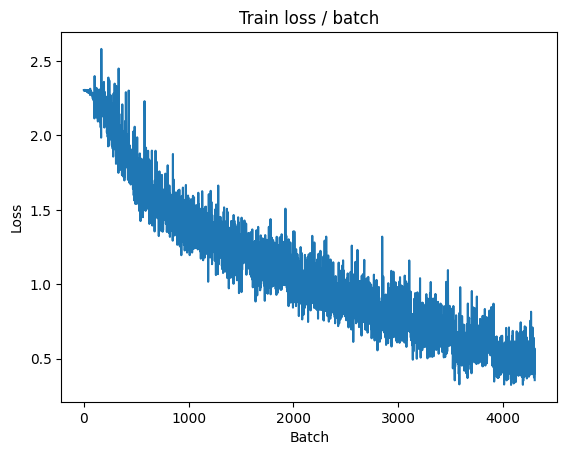

[TRAIN Batch 200/391]	Time 0.015s (0.030s)	Loss 0.3537 (0.3988)	Prec@1  88.3 ( 86.1)	Prec@5 100.0 ( 99.7)


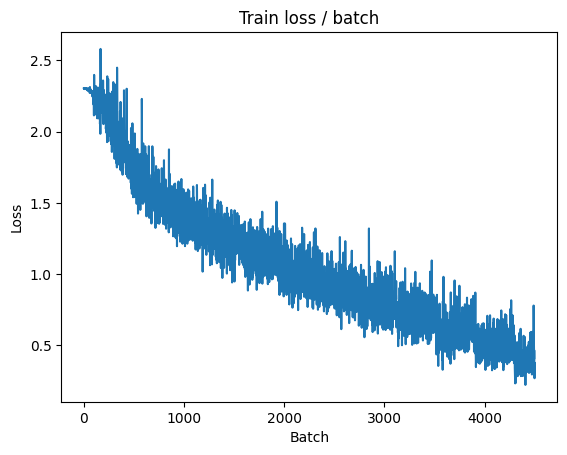


===============> Total time 9s	Avg loss 0.4161	Avg Prec@1 85.37 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.0400 (1.0400)	Prec@1  69.5 ( 69.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0411	Avg Prec@1 67.67 %	Avg Prec@5 97.21 %



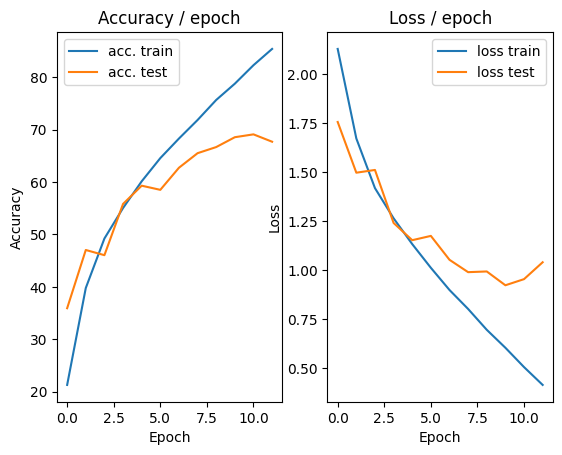

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.3750 (0.3750)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


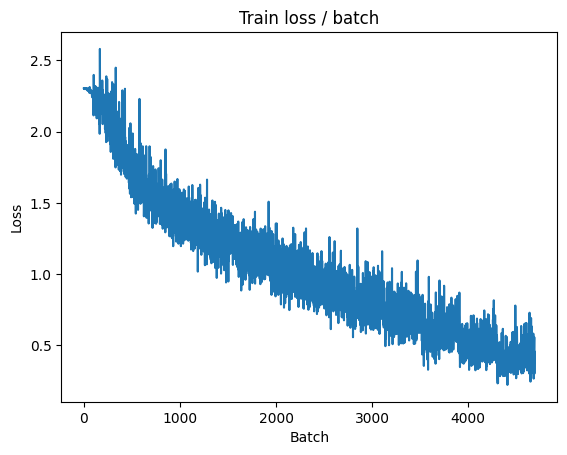

[TRAIN Batch 200/391]	Time 0.022s (0.026s)	Loss 0.4489 (0.3003)	Prec@1  82.8 ( 89.8)	Prec@5 100.0 ( 99.9)


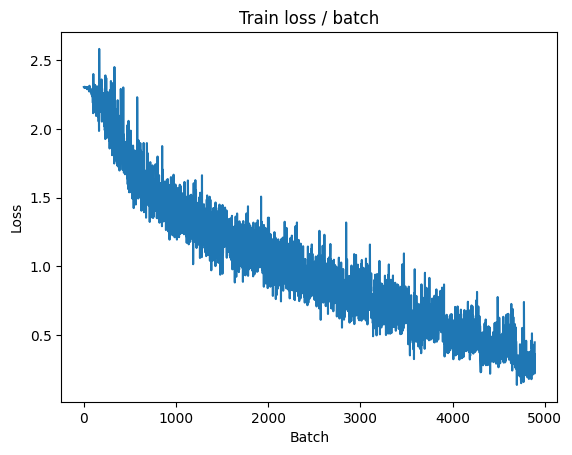


===============> Total time 9s	Avg loss 0.3233	Avg Prec@1 88.80 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 1.0916 (1.0916)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.1197	Avg Prec@1 68.40 %	Avg Prec@5 96.99 %



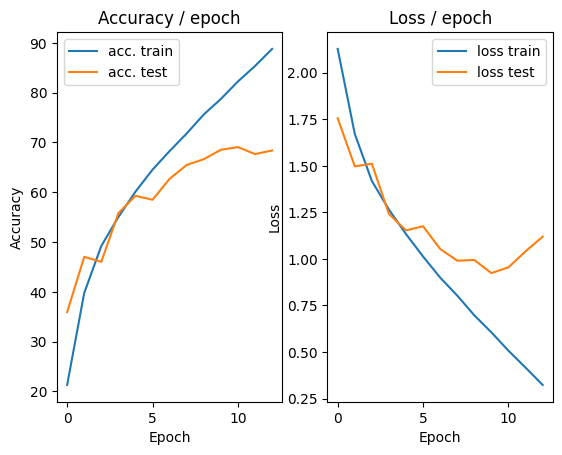

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.2624 (0.2624)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


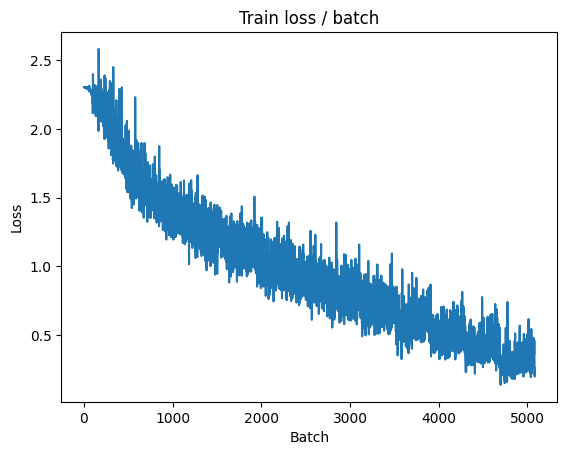

[TRAIN Batch 200/391]	Time 0.019s (0.026s)	Loss 0.3512 (0.2344)	Prec@1  85.2 ( 92.0)	Prec@5 100.0 ( 99.9)


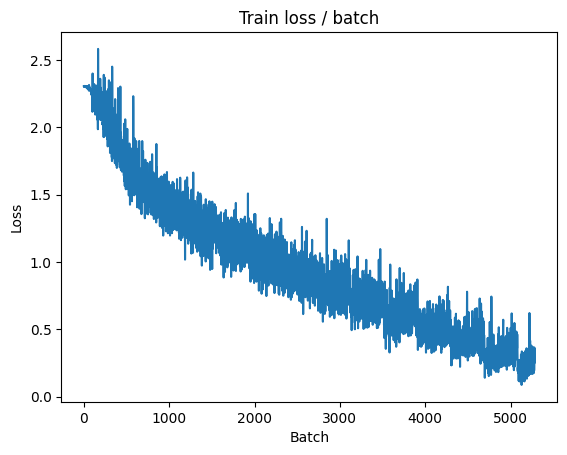


===============> Total time 9s	Avg loss 0.2505	Avg Prec@1 91.41 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 1.0900 (1.0900)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1922	Avg Prec@1 68.82 %	Avg Prec@5 97.03 %



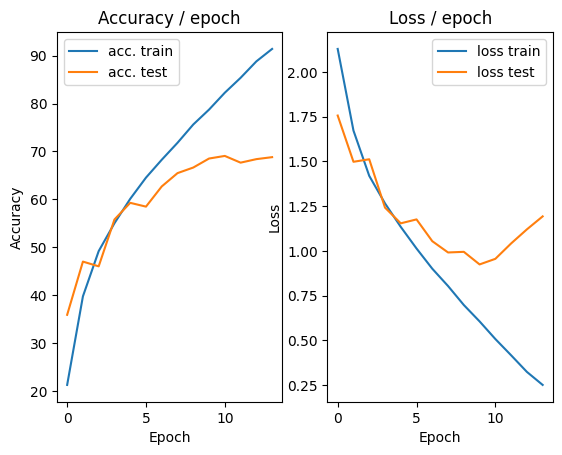

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.1621 (0.1621)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


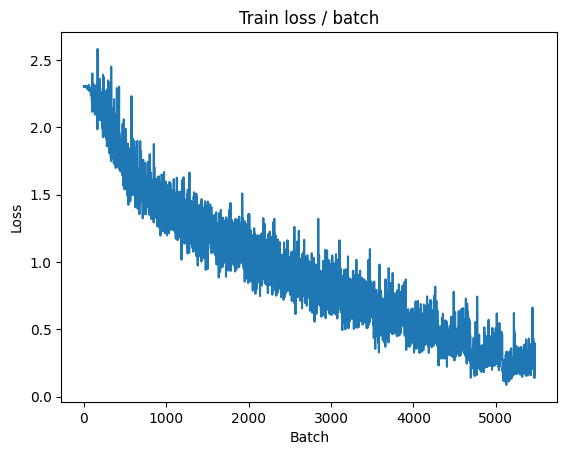

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.1782 (0.1615)	Prec@1  96.1 ( 94.7)	Prec@5 100.0 (100.0)


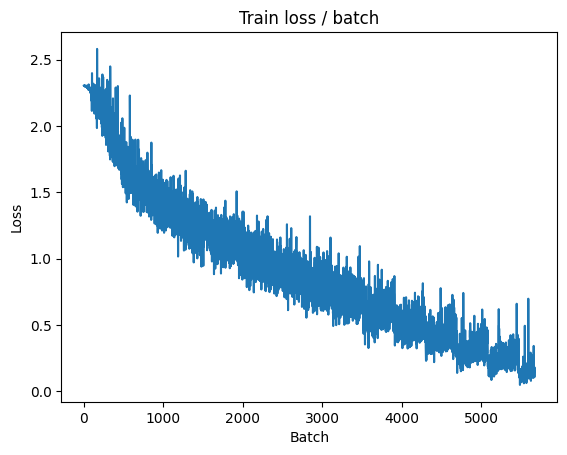


===============> Total time 9s	Avg loss 0.1852	Avg Prec@1 93.76 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.7825 (1.7825)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9280	Avg Prec@1 62.05 %	Avg Prec@5 95.90 %



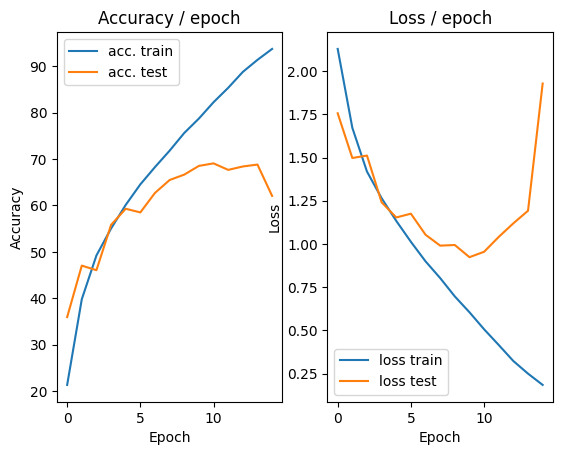

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.5327 (0.5327)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


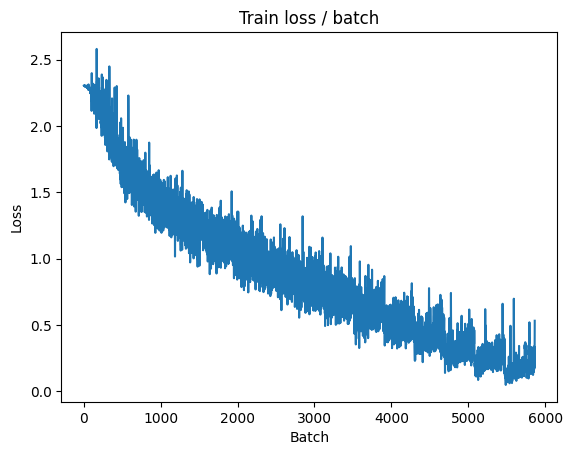

[TRAIN Batch 200/391]	Time 0.019s (0.021s)	Loss 0.3071 (0.1270)	Prec@1  91.4 ( 96.0)	Prec@5 100.0 (100.0)


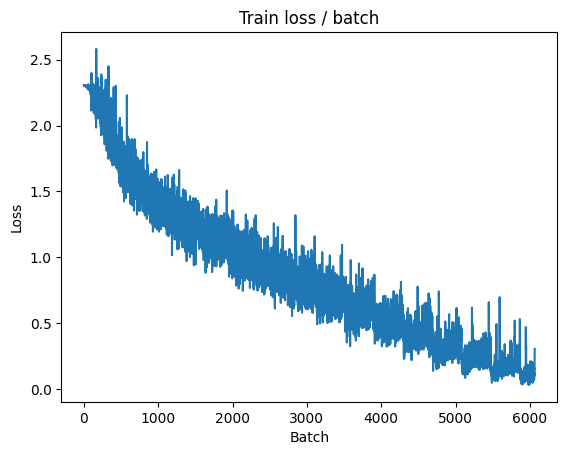


===============> Total time 9s	Avg loss 0.1409	Avg Prec@1 95.31 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 1.5108 (1.5108)	Prec@1  65.6 ( 65.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.4774	Avg Prec@1 68.40 %	Avg Prec@5 96.91 %



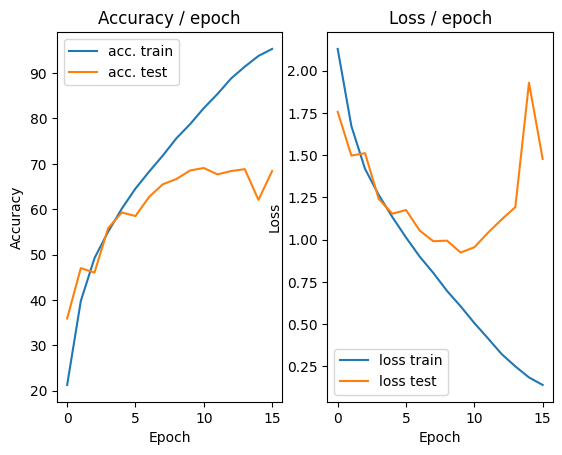

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.0474 (0.0474)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


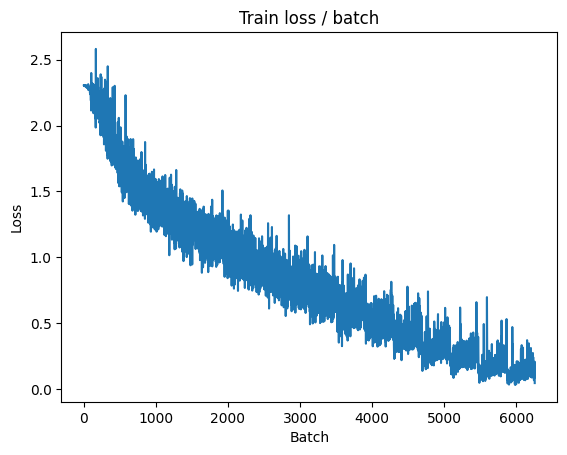

[TRAIN Batch 200/391]	Time 0.024s (0.022s)	Loss 0.1713 (0.0785)	Prec@1  93.0 ( 97.6)	Prec@5 100.0 (100.0)


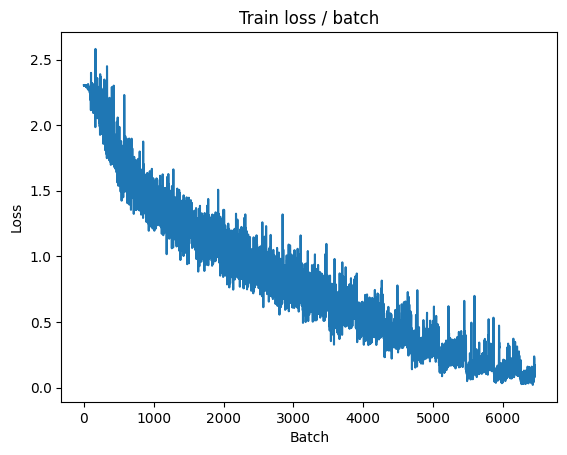


===============> Total time 9s	Avg loss 0.1208	Avg Prec@1 96.26 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 1.4927 (1.4927)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.6276	Avg Prec@1 66.98 %	Avg Prec@5 96.56 %



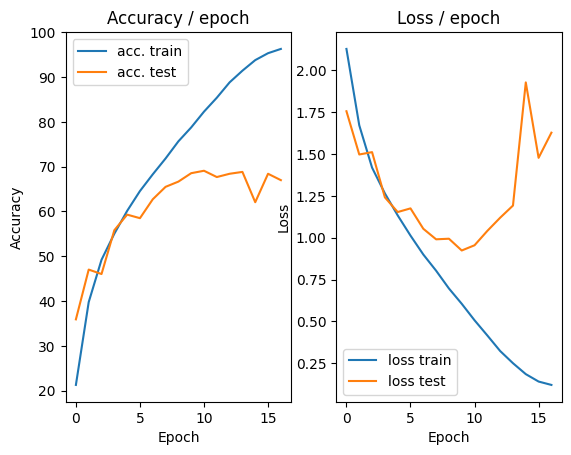

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.1542 (0.1542)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


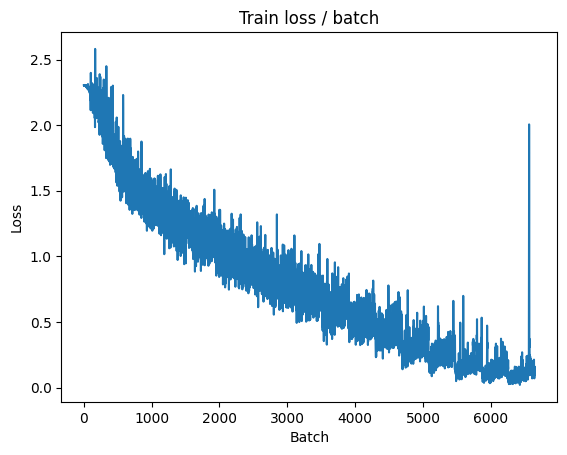

[TRAIN Batch 200/391]	Time 0.011s (0.021s)	Loss 0.0522 (0.0551)	Prec@1  98.4 ( 98.5)	Prec@5 100.0 (100.0)


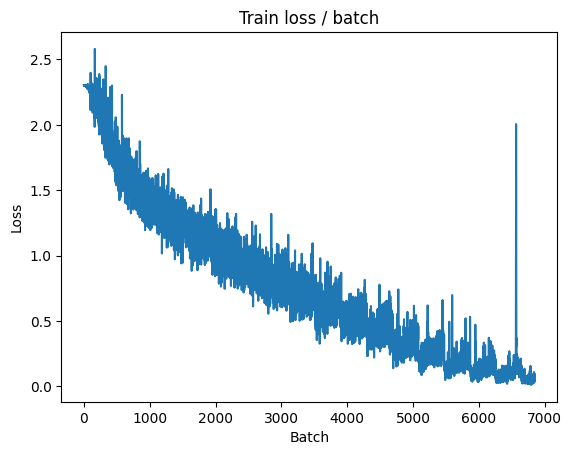


===============> Total time 8s	Avg loss 0.0644	Avg Prec@1 98.08 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 1.6505 (1.6505)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.6088	Avg Prec@1 69.42 %	Avg Prec@5 97.20 %



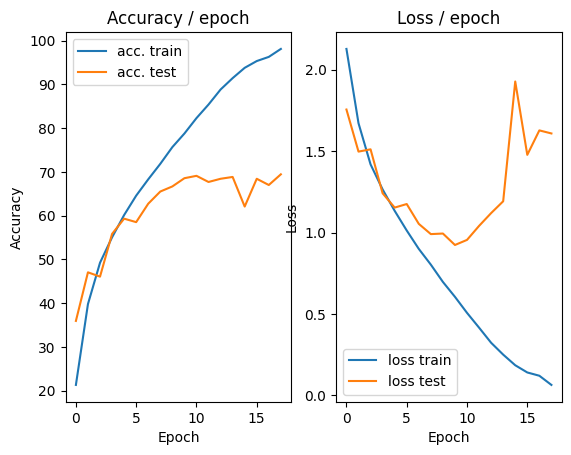

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.0440 (0.0440)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


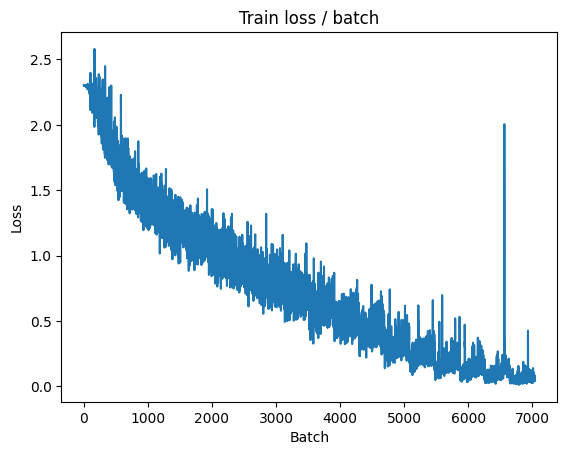

[TRAIN Batch 200/391]	Time 0.013s (0.023s)	Loss 0.0715 (0.0347)	Prec@1  96.9 ( 99.0)	Prec@5 100.0 (100.0)


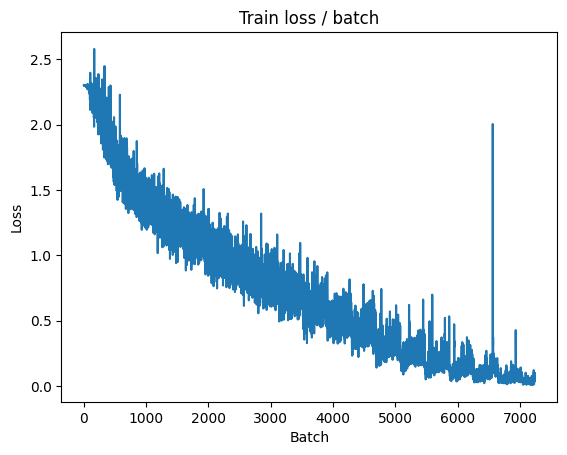


===============> Total time 8s	Avg loss 0.0525	Avg Prec@1 98.40 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.6883 (1.6883)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7060	Avg Prec@1 68.90 %	Avg Prec@5 96.98 %



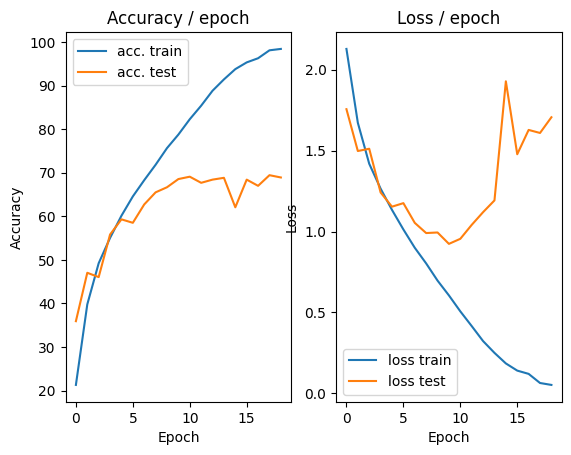

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.0317 (0.0317)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


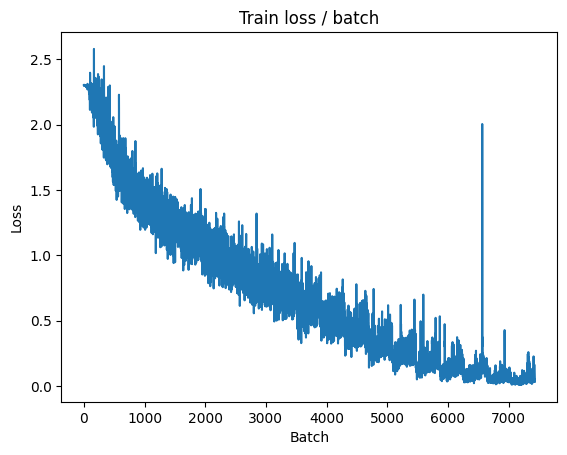

[TRAIN Batch 200/391]	Time 0.028s (0.027s)	Loss 0.1771 (0.0369)	Prec@1  94.5 ( 99.0)	Prec@5 100.0 (100.0)


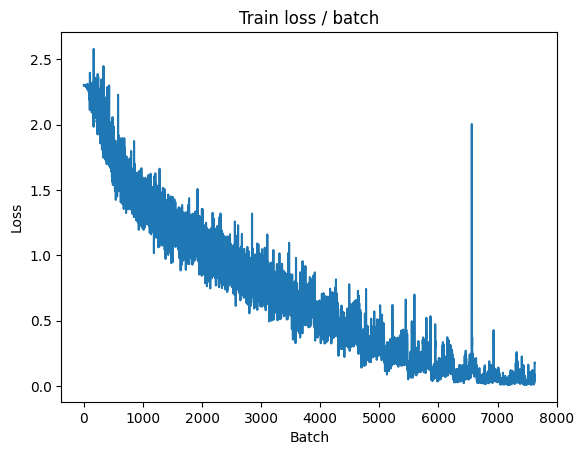


===============> Total time 9s	Avg loss 0.0430	Avg Prec@1 98.70 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.8661 (1.8661)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.8287	Avg Prec@1 69.21 %	Avg Prec@5 97.06 %



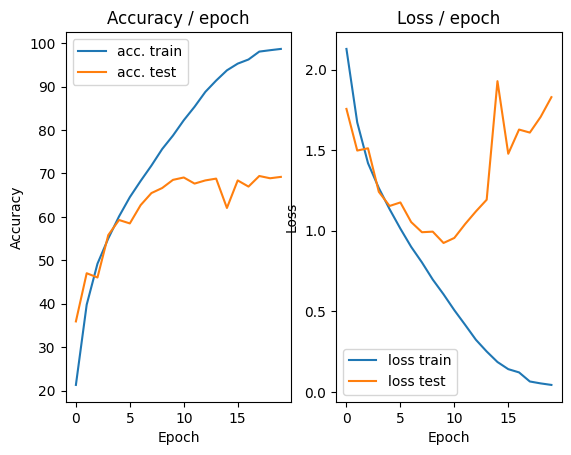

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.0785 (0.0785)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


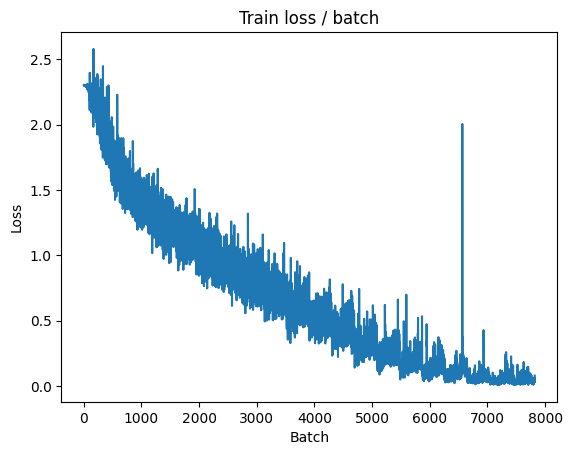

[TRAIN Batch 200/391]	Time 0.018s (0.026s)	Loss 0.0162 (0.0172)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


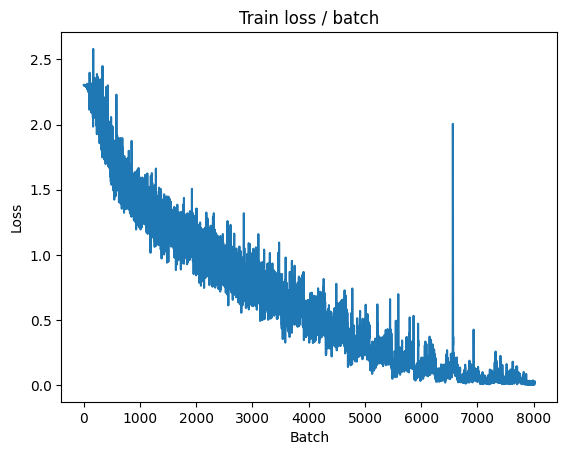


===============> Total time 9s	Avg loss 0.0229	Avg Prec@1 99.36 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 1.6344 (1.6344)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.8548	Avg Prec@1 69.13 %	Avg Prec@5 96.88 %



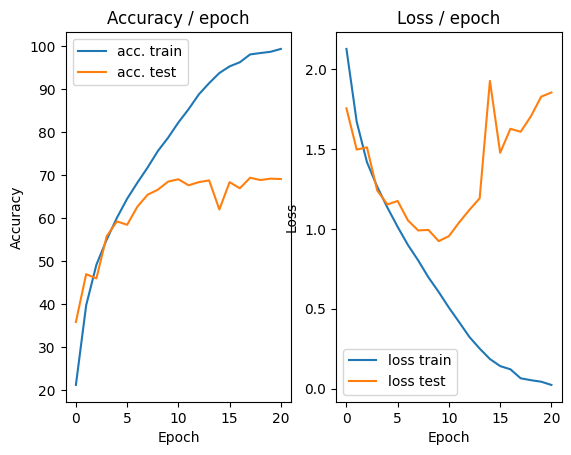

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.108s (0.108s)	Loss 0.0174 (0.0174)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


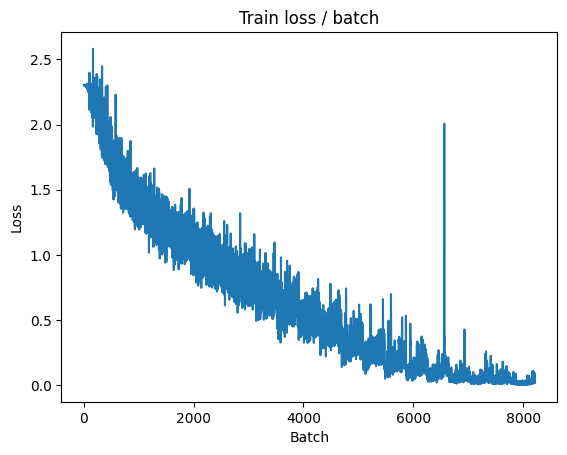

[TRAIN Batch 200/391]	Time 0.022s (0.027s)	Loss 0.0098 (0.0120)	Prec@1  99.2 ( 99.7)	Prec@5 100.0 (100.0)


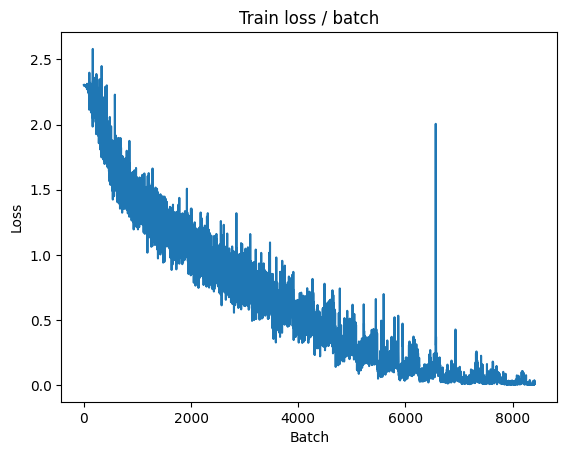


===============> Total time 10s	Avg loss 0.0124	Avg Prec@1 99.70 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 1.7931 (1.7931)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9286	Avg Prec@1 70.80 %	Avg Prec@5 97.35 %



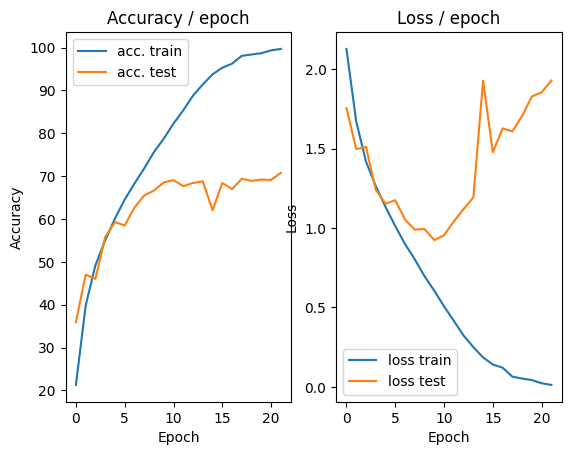

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0015 (0.0015)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


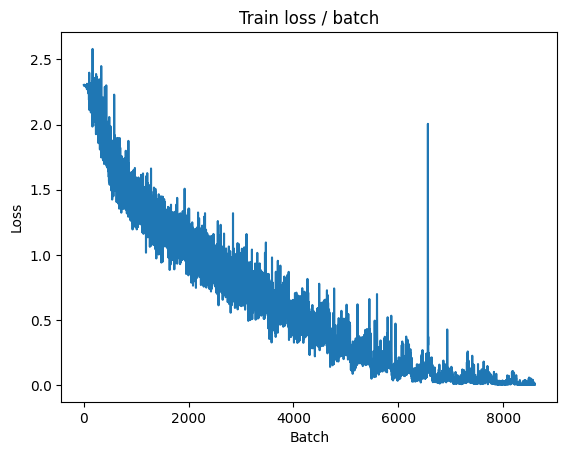

[TRAIN Batch 200/391]	Time 0.031s (0.026s)	Loss 0.0036 (0.0036)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


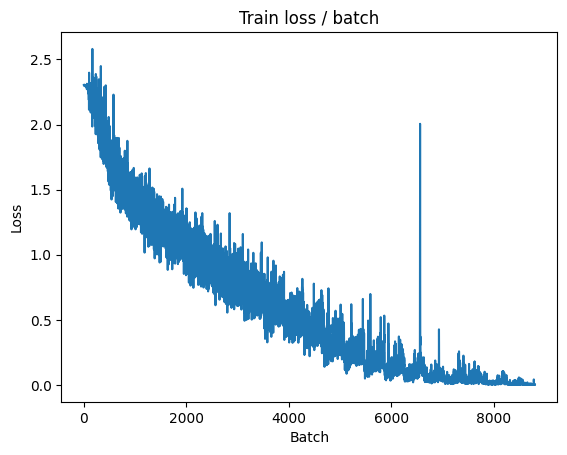


===============> Total time 9s	Avg loss 0.0039	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 1.9061 (1.9061)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0165	Avg Prec@1 71.10 %	Avg Prec@5 97.49 %



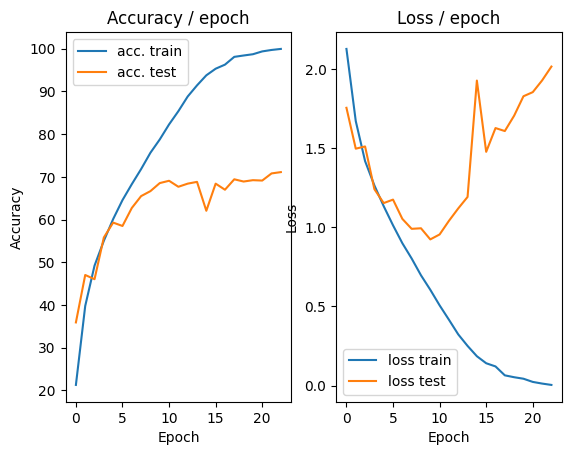

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


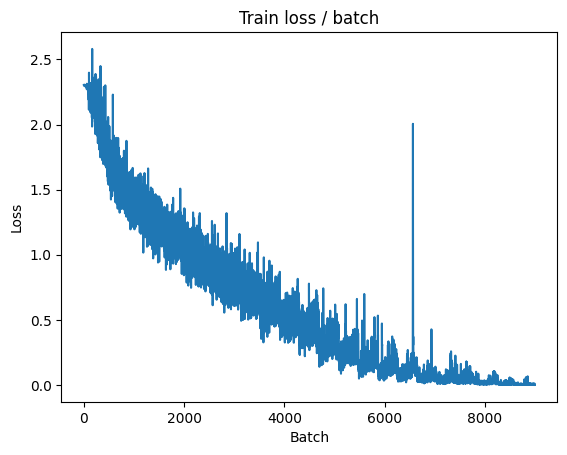

[TRAIN Batch 200/391]	Time 0.013s (0.021s)	Loss 0.0007 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


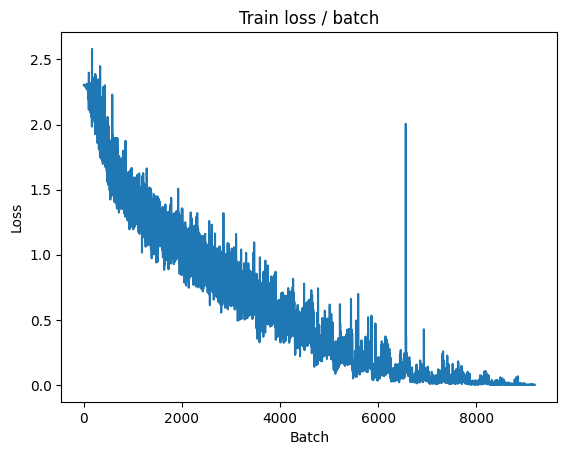


===============> Total time 9s	Avg loss 0.0010	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 1.9455 (1.9455)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0610	Avg Prec@1 71.44 %	Avg Prec@5 97.53 %



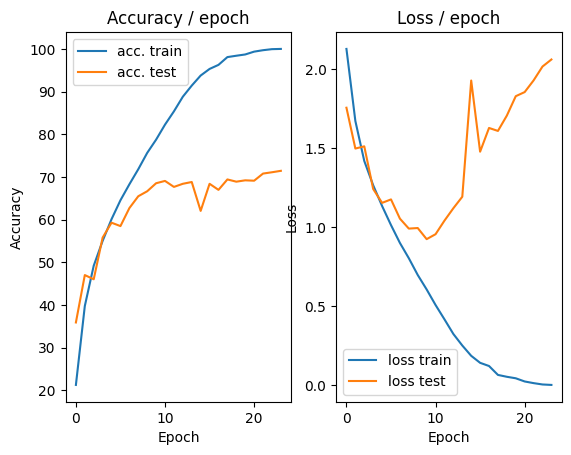

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


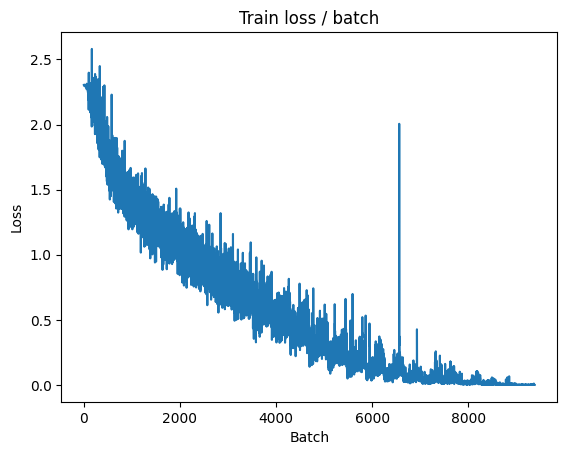

[TRAIN Batch 200/391]	Time 0.013s (0.022s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


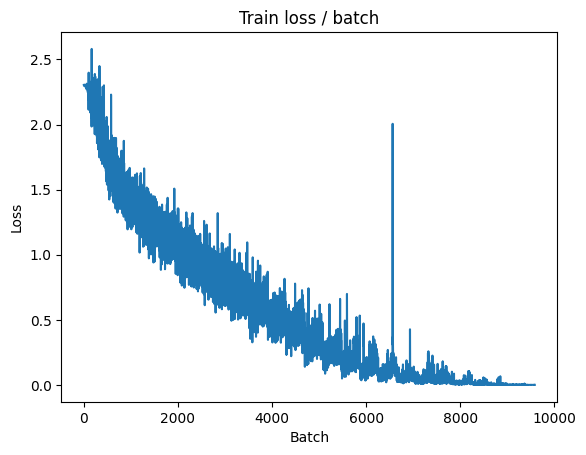


===============> Total time 9s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.106s (0.106s)	Loss 1.9933 (1.9933)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.1111	Avg Prec@1 71.57 %	Avg Prec@5 97.55 %



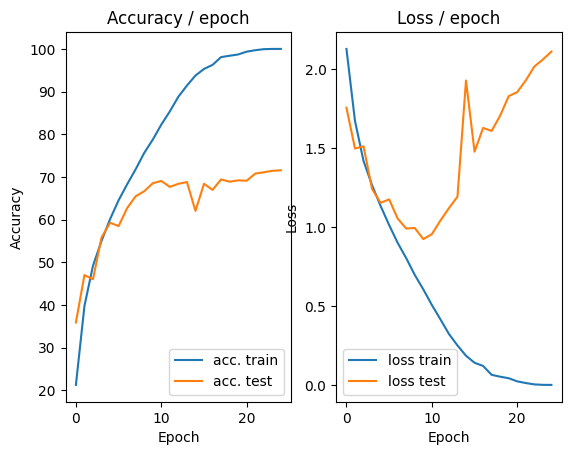

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


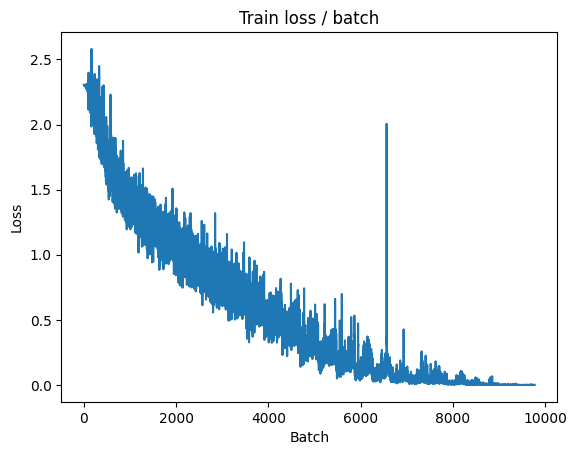

[TRAIN Batch 200/391]	Time 0.025s (0.021s)	Loss 0.0007 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


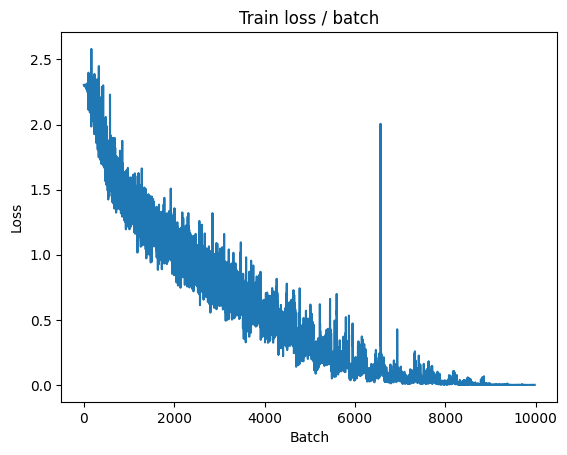


===============> Total time 8s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 2.0317 (2.0317)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.1497	Avg Prec@1 71.78 %	Avg Prec@5 97.60 %



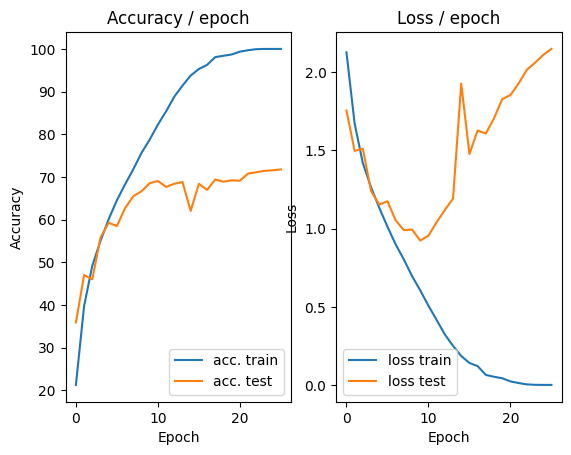

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


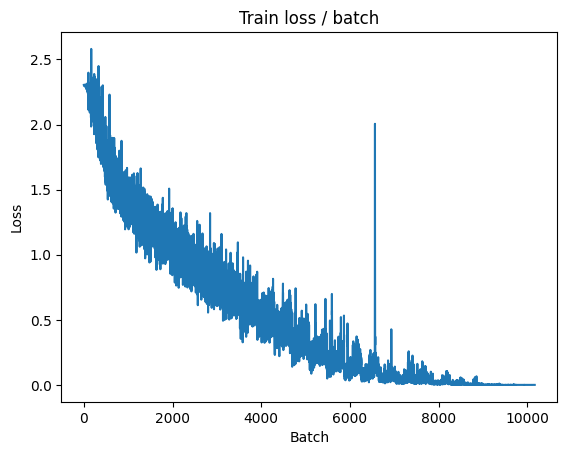

[TRAIN Batch 200/391]	Time 0.008s (0.022s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


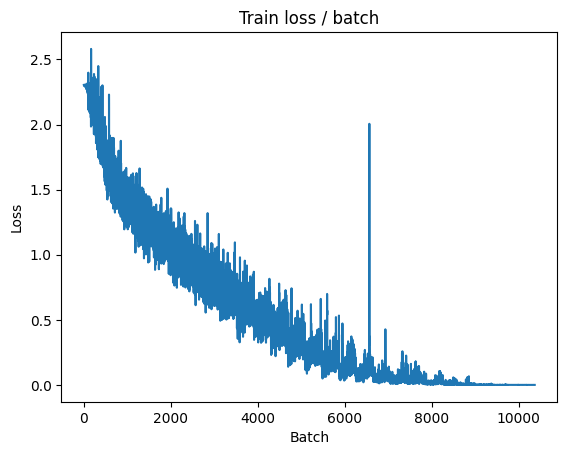


===============> Total time 8s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 2.0576 (2.0576)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.1843	Avg Prec@1 71.75 %	Avg Prec@5 97.60 %



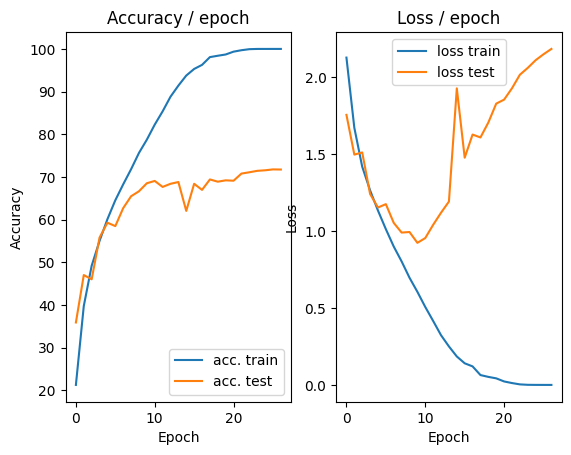

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


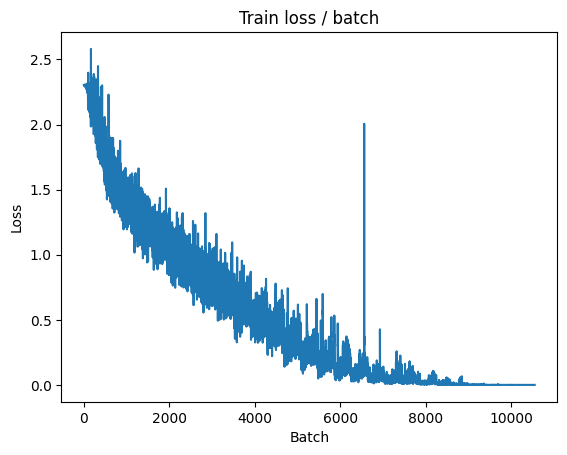

[TRAIN Batch 200/391]	Time 0.013s (0.028s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


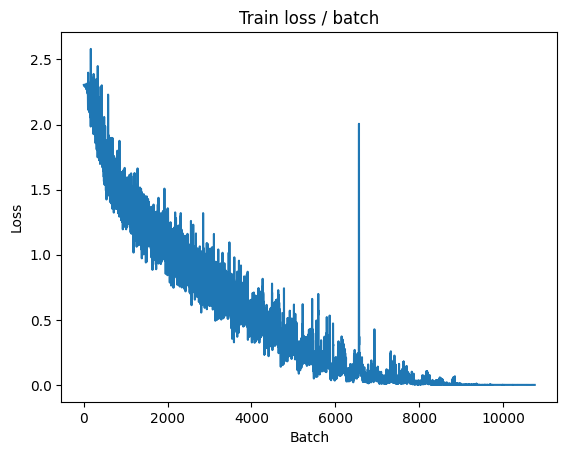


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.112s (0.112s)	Loss 2.0772 (2.0772)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2128	Avg Prec@1 71.91 %	Avg Prec@5 97.62 %



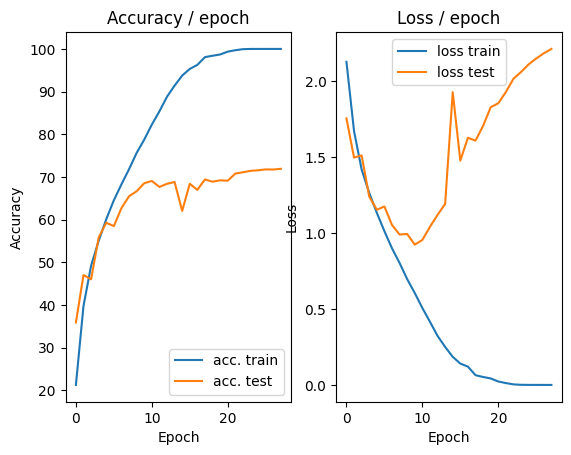

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


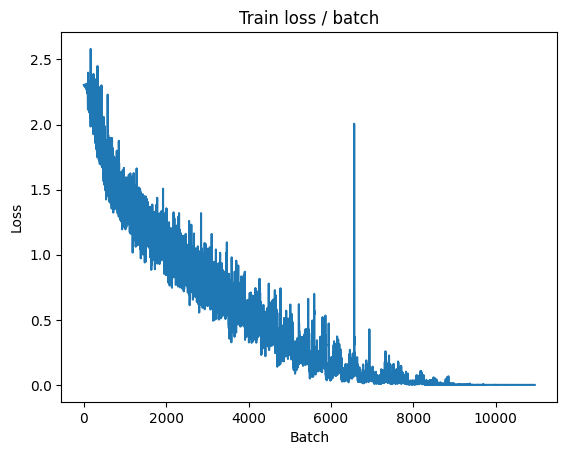

[TRAIN Batch 200/391]	Time 0.011s (0.026s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


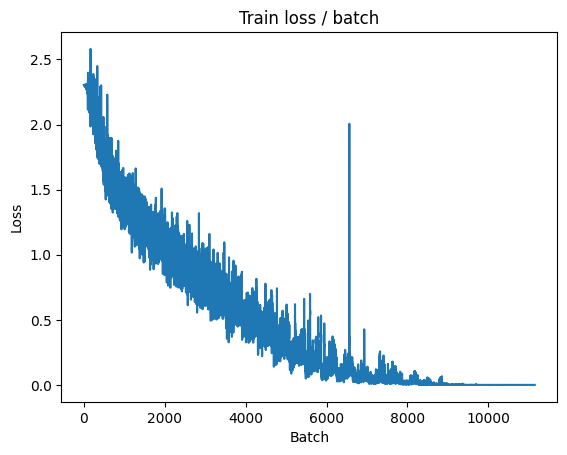


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 2.1029 (2.1029)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2373	Avg Prec@1 71.80 %	Avg Prec@5 97.56 %



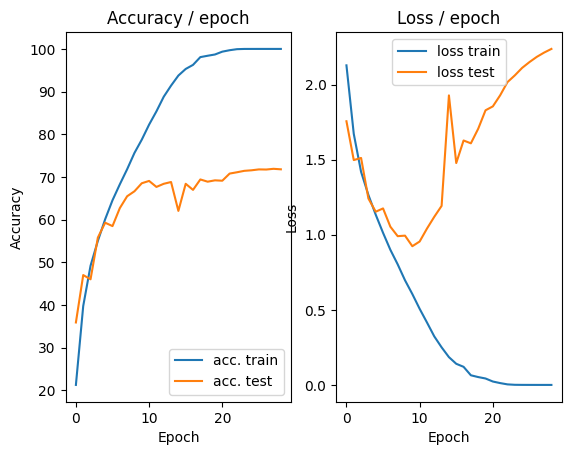

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


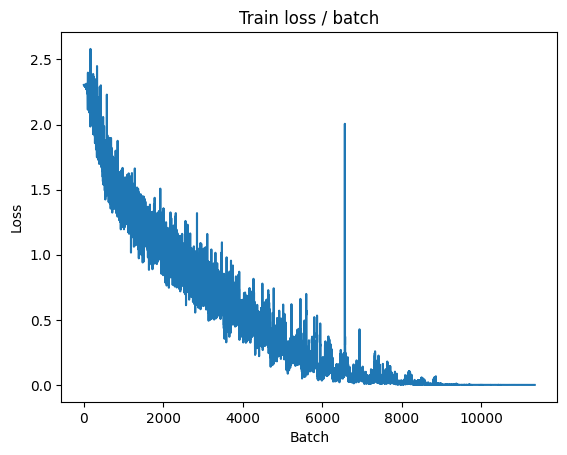

[TRAIN Batch 200/391]	Time 0.032s (0.027s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


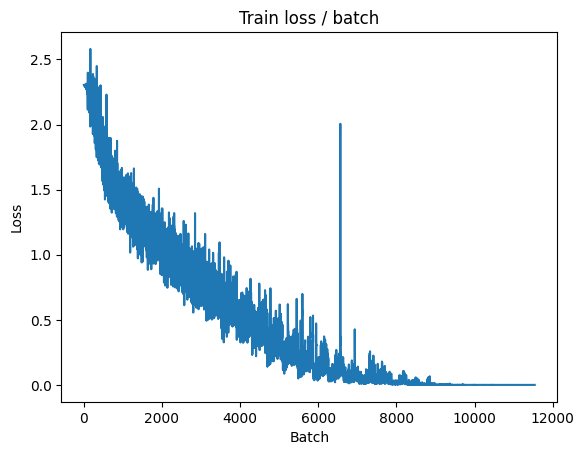


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 2.1140 (2.1140)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2612	Avg Prec@1 71.88 %	Avg Prec@5 97.60 %



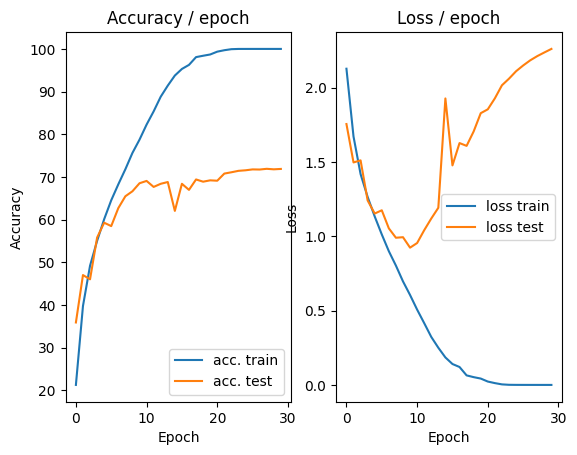

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


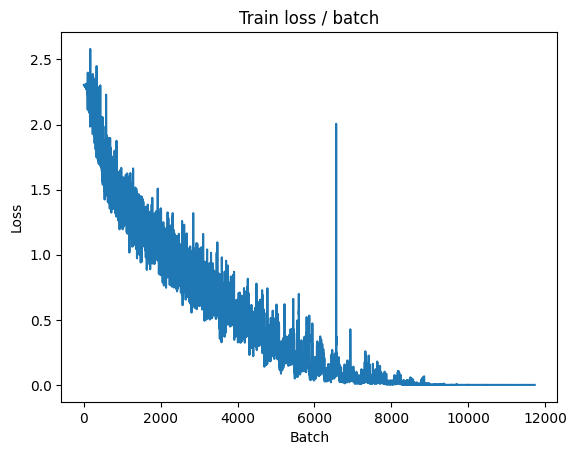

[TRAIN Batch 200/391]	Time 0.027s (0.026s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


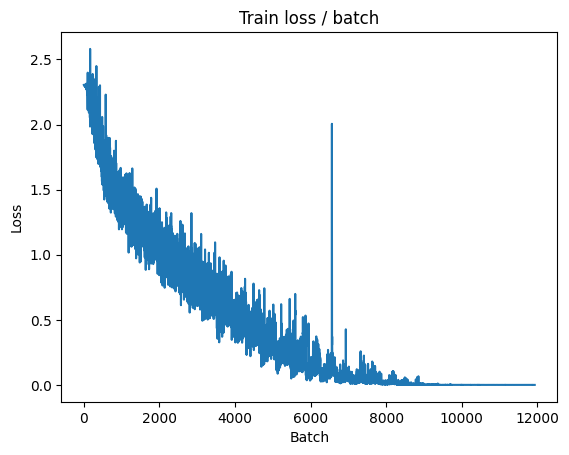


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 2.1351 (2.1351)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2807	Avg Prec@1 71.83 %	Avg Prec@5 97.61 %



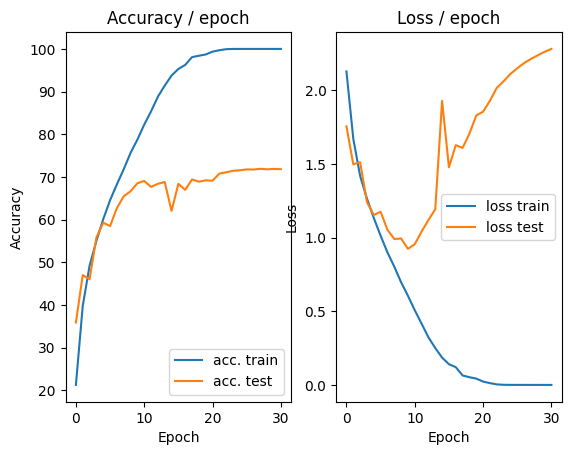

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


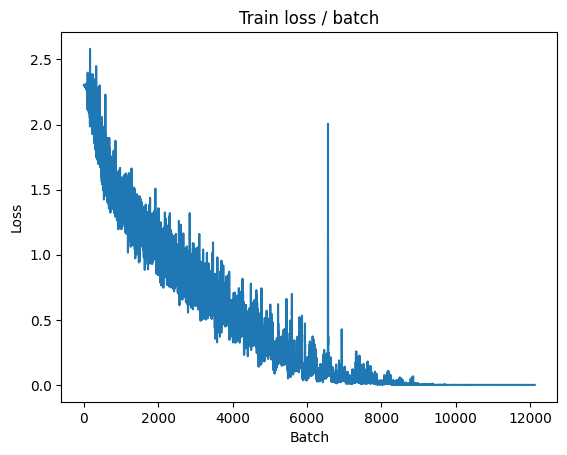

[TRAIN Batch 200/391]	Time 0.016s (0.038s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


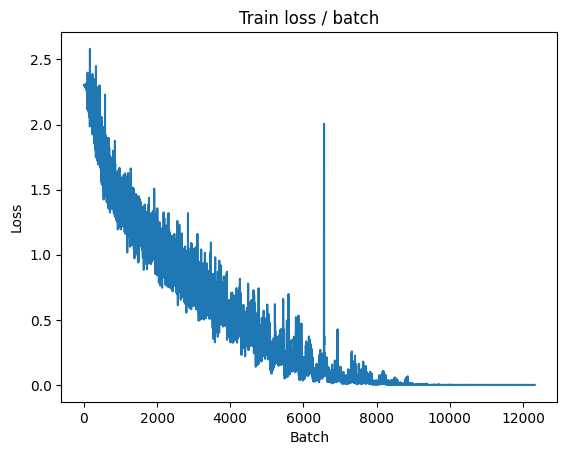


===============> Total time 13s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 2.1509 (2.1509)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.2984	Avg Prec@1 71.88 %	Avg Prec@5 97.62 %



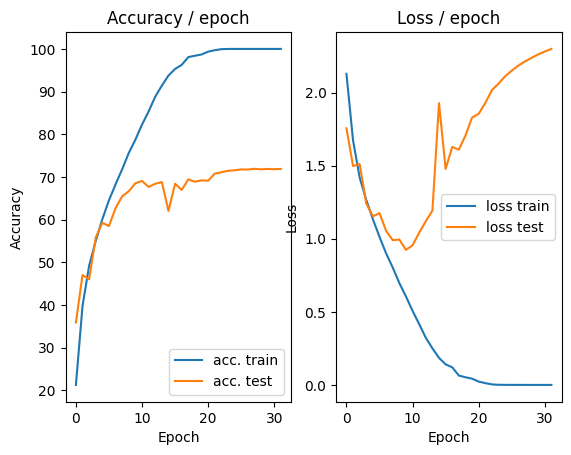

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


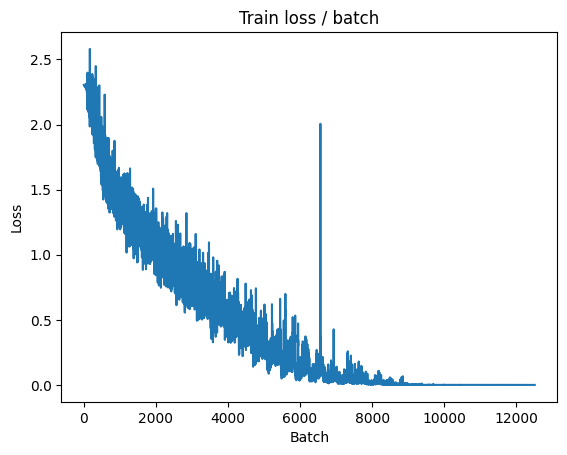

[TRAIN Batch 200/391]	Time 0.036s (0.036s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


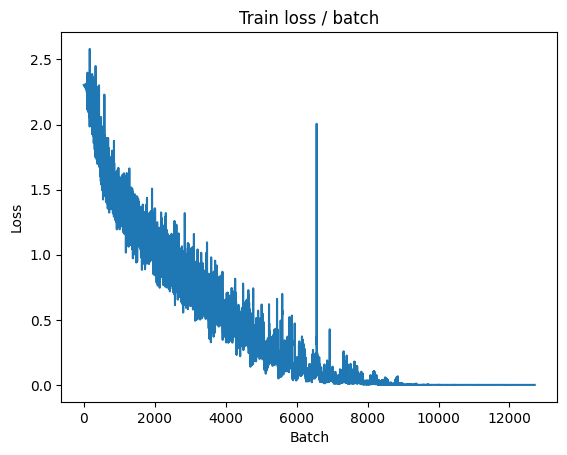


===============> Total time 11s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.130s (0.130s)	Loss 2.1650 (2.1650)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.3138	Avg Prec@1 71.82 %	Avg Prec@5 97.59 %



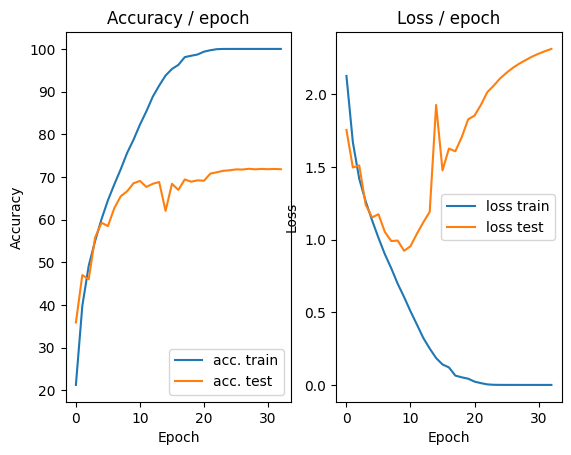

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.154s (0.154s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


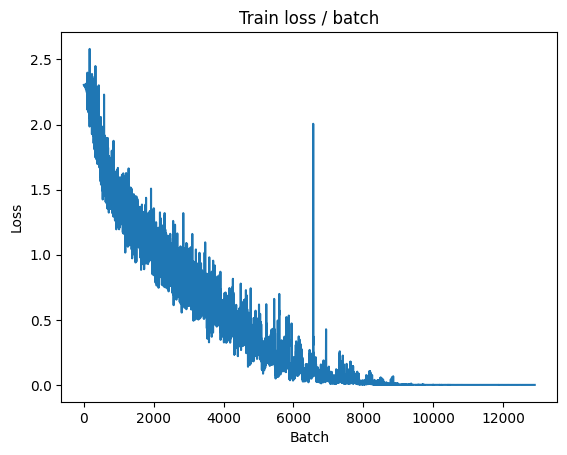

[TRAIN Batch 200/391]	Time 0.013s (0.029s)	Loss 0.0001 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


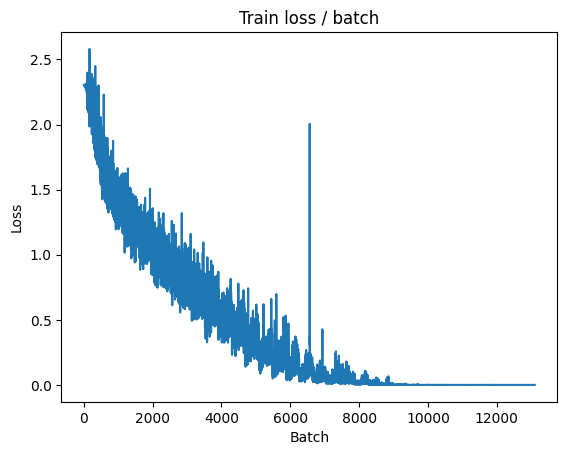


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 2.1744 (2.1744)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 2.3290	Avg Prec@1 71.83 %	Avg Prec@5 97.58 %



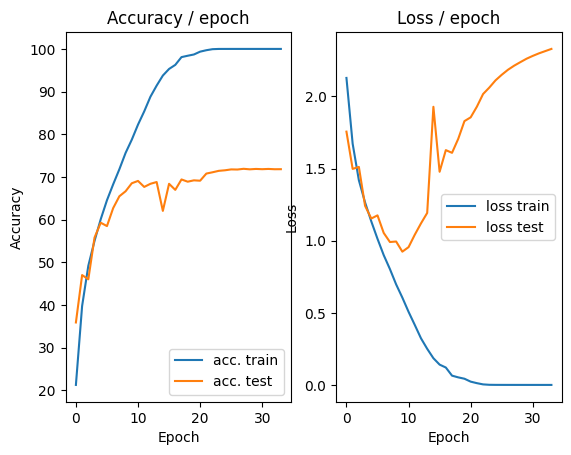

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


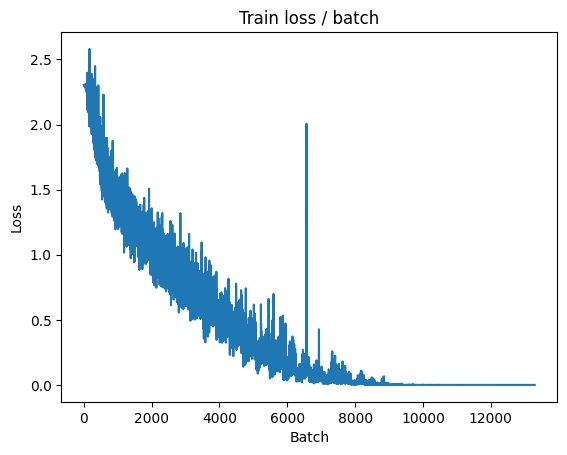

[TRAIN Batch 200/391]	Time 0.014s (0.035s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


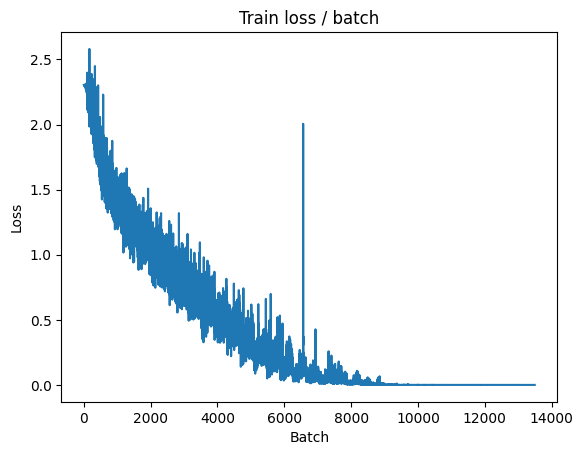


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 2.1899 (2.1899)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.3443	Avg Prec@1 71.81 %	Avg Prec@5 97.62 %



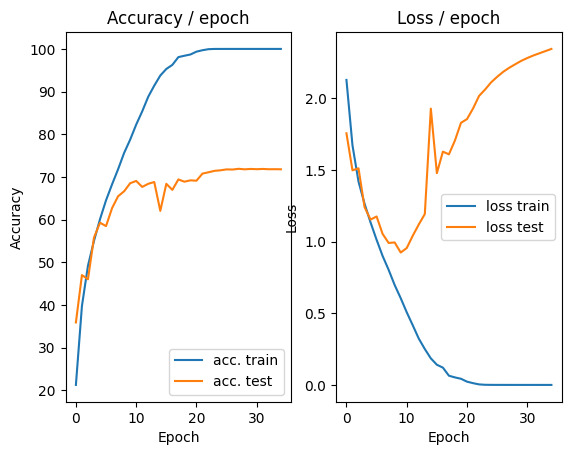

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


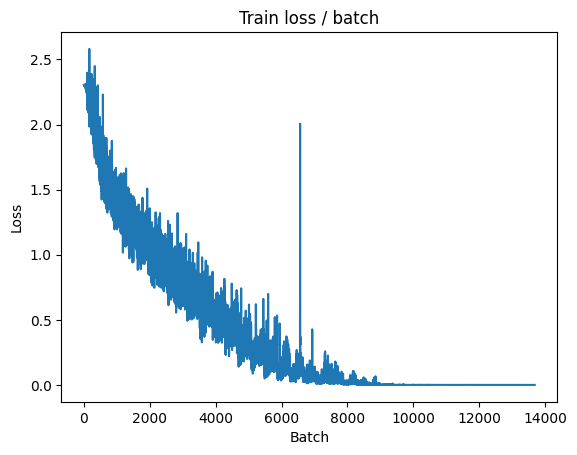

[TRAIN Batch 200/391]	Time 0.032s (0.028s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


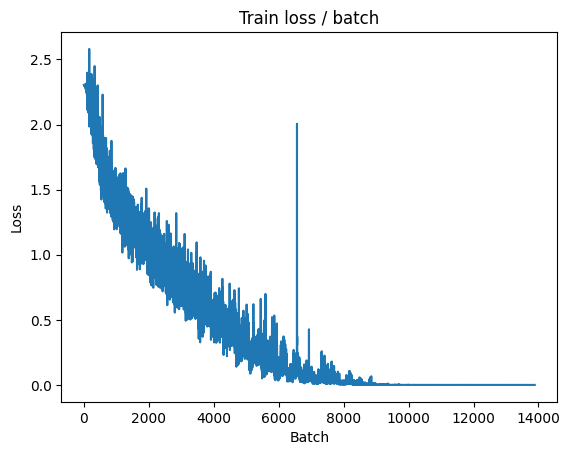


===============> Total time 10s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 2.2033 (2.2033)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.3570	Avg Prec@1 71.85 %	Avg Prec@5 97.60 %



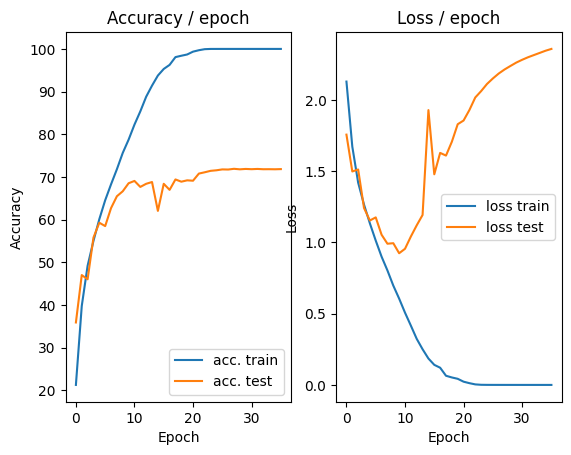

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


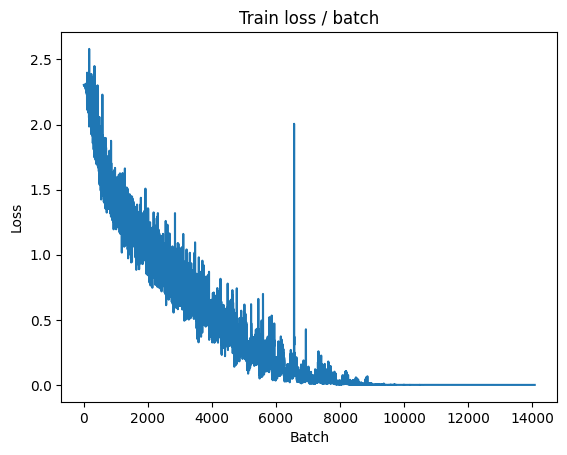

[TRAIN Batch 200/391]	Time 0.035s (0.032s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


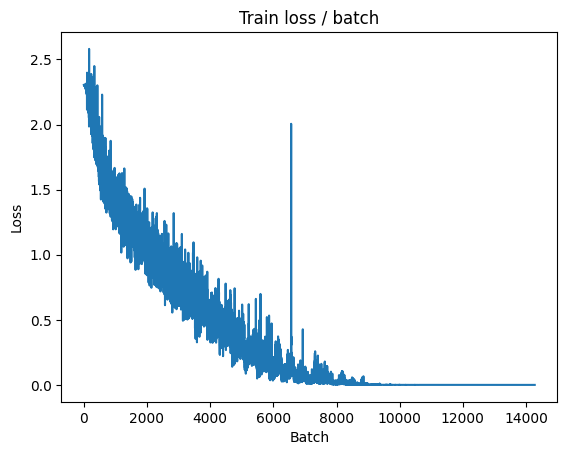


===============> Total time 10s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 2.2134 (2.2134)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.3707	Avg Prec@1 71.87 %	Avg Prec@5 97.64 %



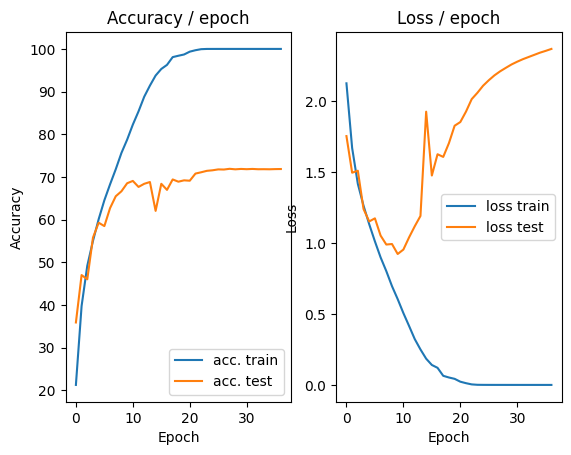

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


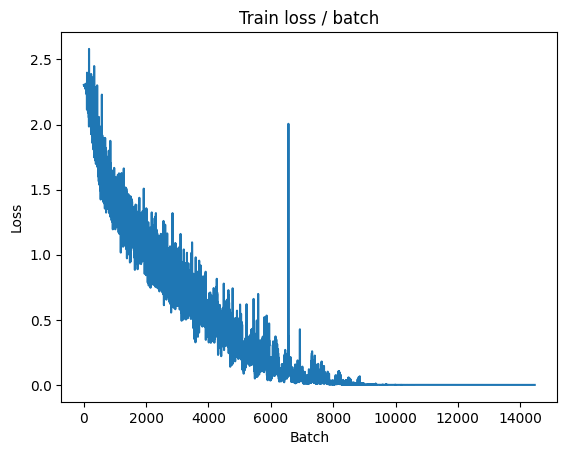

[TRAIN Batch 200/391]	Time 0.013s (0.027s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


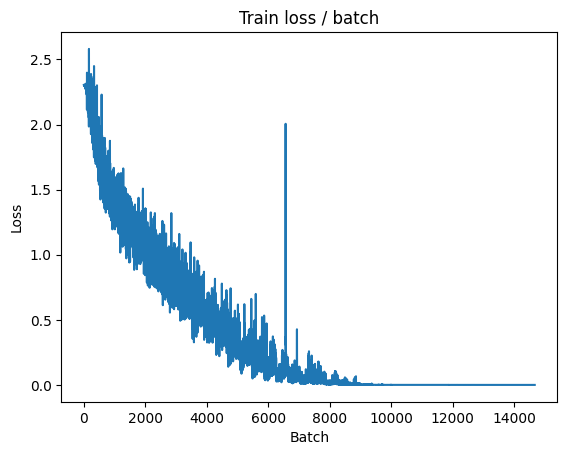


===============> Total time 9s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 2.2222 (2.2222)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.3825	Avg Prec@1 71.86 %	Avg Prec@5 97.61 %



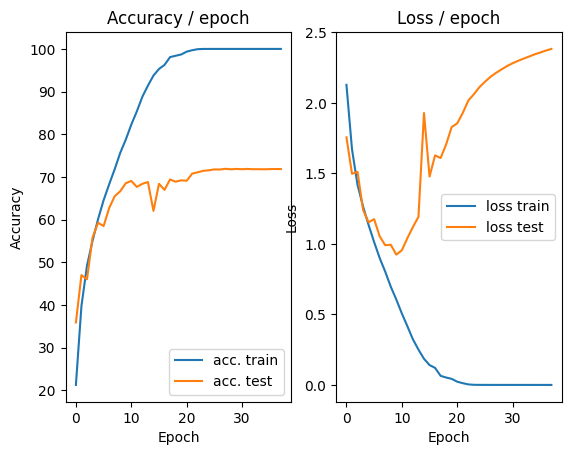

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


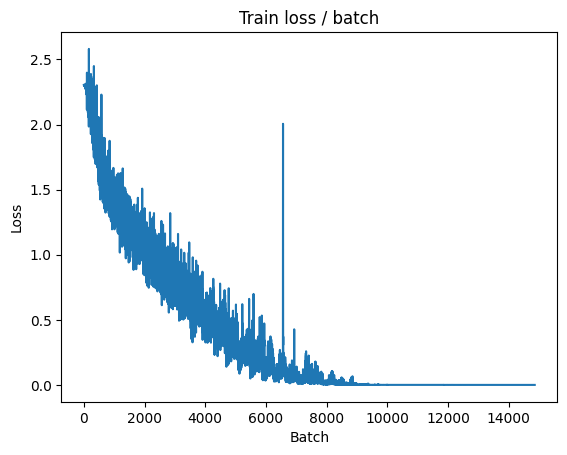

[TRAIN Batch 200/391]	Time 0.026s (0.026s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


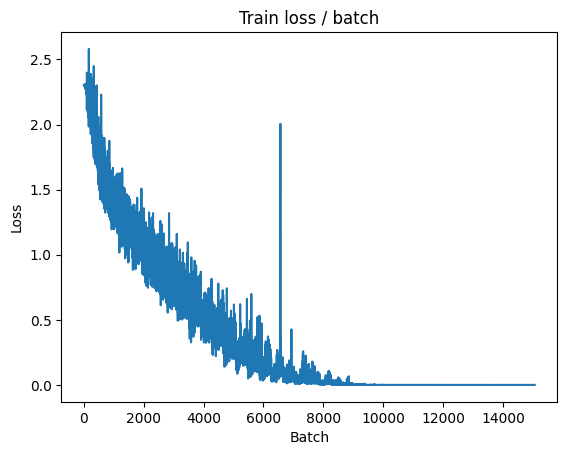


===============> Total time 11s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 2.2335 (2.2335)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.3943	Avg Prec@1 71.82 %	Avg Prec@5 97.62 %



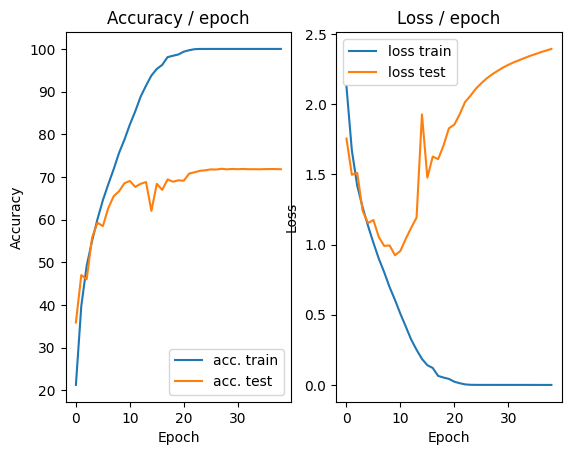

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


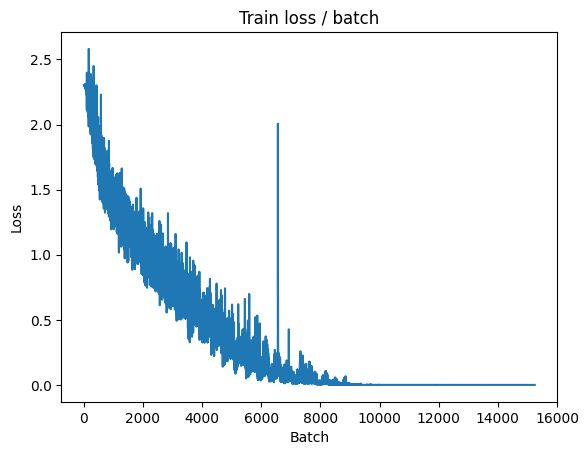

[TRAIN Batch 200/391]	Time 0.033s (0.028s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


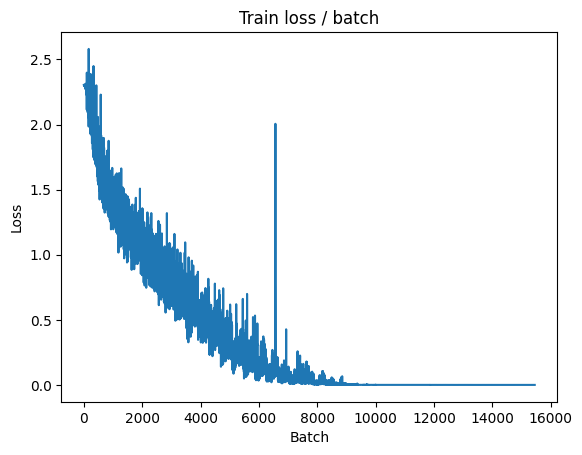


===============> Total time 9s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 2.2428 (2.2428)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 2.4045	Avg Prec@1 71.85 %	Avg Prec@5 97.61 %



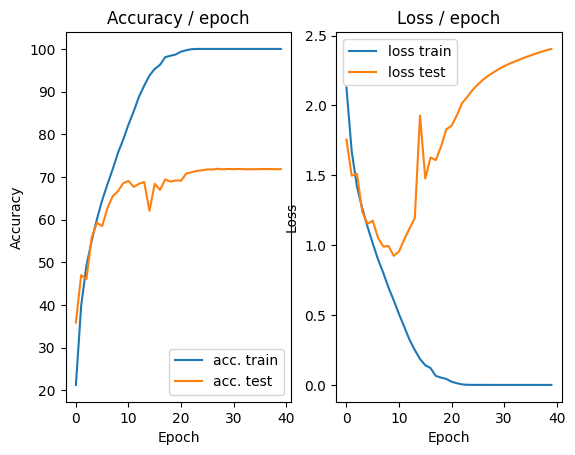

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True)

In [ ]:
def get_dataset_normalized(batch_size, cuda=False):
    """
    This function loads the dataset and normalize each image
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,transform=
        transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447),(0.202,0.199, 0.201))
        ]))

    val_dataset = datasets.CIFAR10(PATH, train=True, download=True,transform=
        transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447),(0.202,0.199, 0.201))
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 2.3034 (2.3034)	Prec@1  10.9 ( 10.9)	Prec@5  51.6 ( 51.6)


<Figure size 640x480 with 0 Axes>

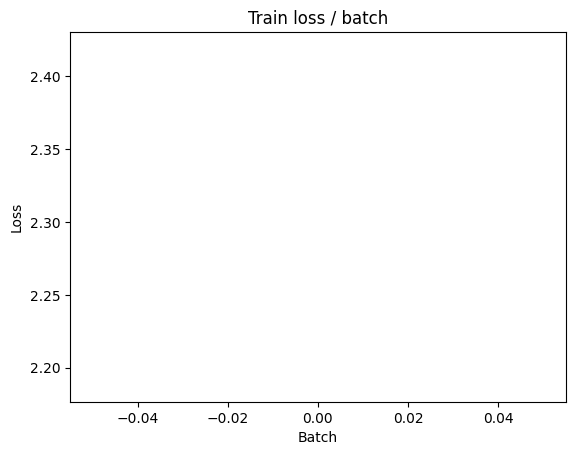

[TRAIN Batch 200/391]	Time 0.016s (0.039s)	Loss 1.5724 (1.9359)	Prec@1  47.7 ( 29.5)	Prec@5  89.8 ( 79.3)


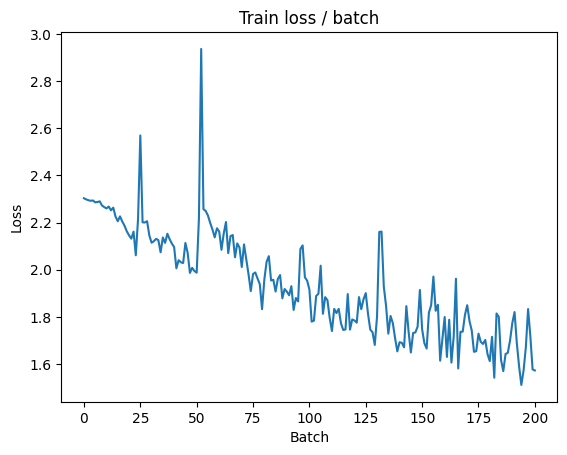


===============> Total time 14s	Avg loss 1.7379	Avg Prec@1 37.06 %	Avg Prec@5 85.09 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 1.2666 (1.2666)	Prec@1  60.9 ( 60.9)	Prec@5  91.4 ( 91.4)
[EVAL Batch 200/391]	Time 0.069s (0.041s)	Loss 1.3751 (1.3624)	Prec@1  54.7 ( 53.4)	Prec@5  91.4 ( 94.0)

===============> Total time 13s	Avg loss 1.3660	Avg Prec@1 53.34 %	Avg Prec@5 93.86 %



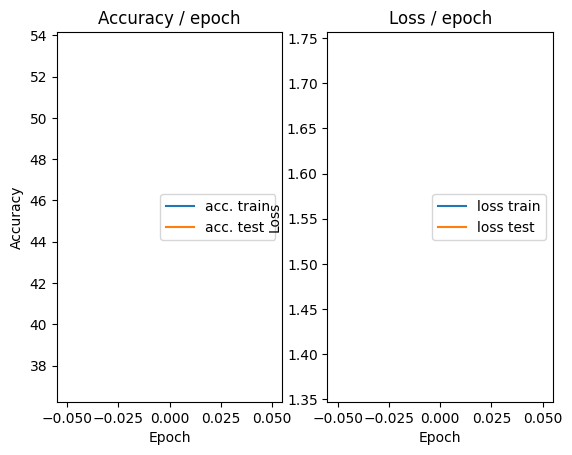

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.3561 (1.3561)	Prec@1  50.8 ( 50.8)	Prec@5  97.7 ( 97.7)


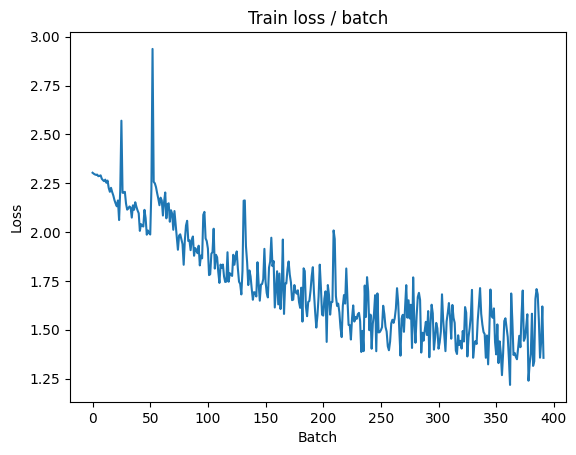

[TRAIN Batch 200/391]	Time 0.052s (0.039s)	Loss 1.3674 (1.3278)	Prec@1  50.8 ( 53.1)	Prec@5  93.8 ( 94.0)


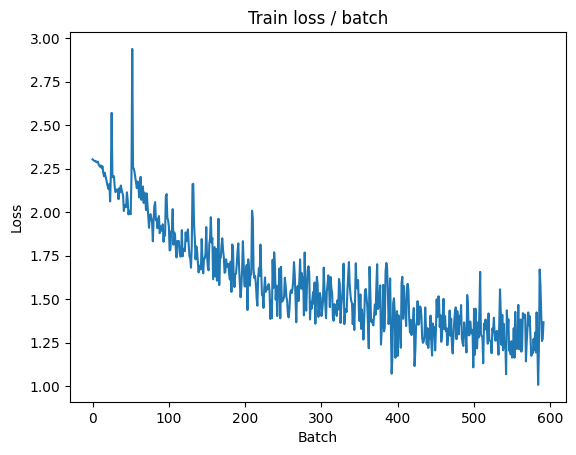


===============> Total time 14s	Avg loss 1.2694	Avg Prec@1 55.20 %	Avg Prec@5 94.46 %

[EVAL Batch 000/391]	Time 0.137s (0.137s)	Loss 1.0099 (1.0099)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)
[EVAL Batch 200/391]	Time 0.055s (0.033s)	Loss 1.1350 (1.0613)	Prec@1  64.8 ( 63.1)	Prec@5  94.5 ( 96.2)

===============> Total time 12s	Avg loss 1.0638	Avg Prec@1 62.88 %	Avg Prec@5 96.12 %



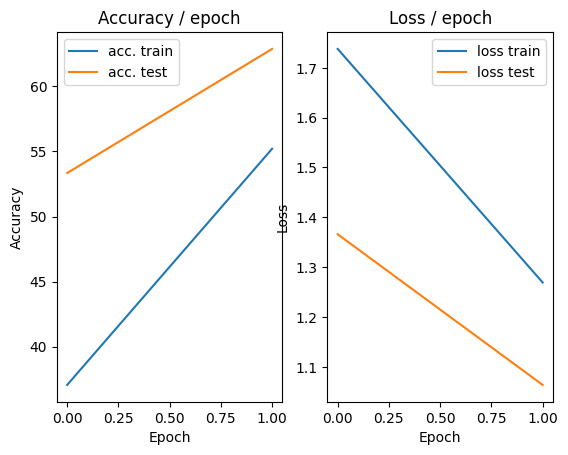

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 1.0696 (1.0696)	Prec@1  61.7 ( 61.7)	Prec@5  95.3 ( 95.3)


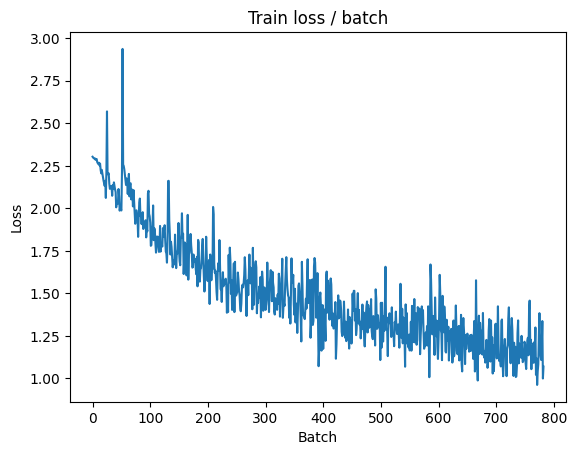

[TRAIN Batch 200/391]	Time 0.051s (0.035s)	Loss 1.0318 (1.0653)	Prec@1  60.9 ( 62.8)	Prec@5  97.7 ( 96.3)


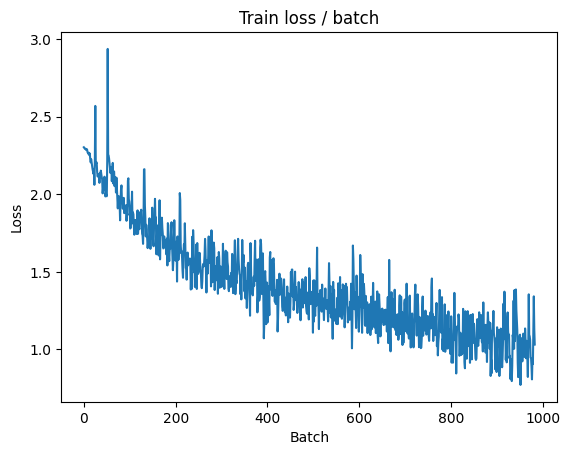


===============> Total time 14s	Avg loss 1.0371	Avg Prec@1 63.85 %	Avg Prec@5 96.53 %

[EVAL Batch 000/391]	Time 0.127s (0.127s)	Loss 0.8707 (0.8707)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)
[EVAL Batch 200/391]	Time 0.034s (0.029s)	Loss 0.9867 (0.9710)	Prec@1  63.3 ( 65.3)	Prec@5  96.9 ( 97.4)

===============> Total time 13s	Avg loss 0.9705	Avg Prec@1 65.45 %	Avg Prec@5 97.40 %



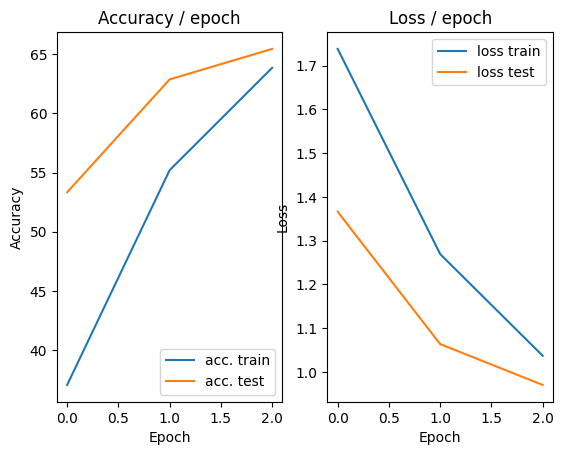

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 1.0200 (1.0200)	Prec@1  63.3 ( 63.3)	Prec@5  96.1 ( 96.1)


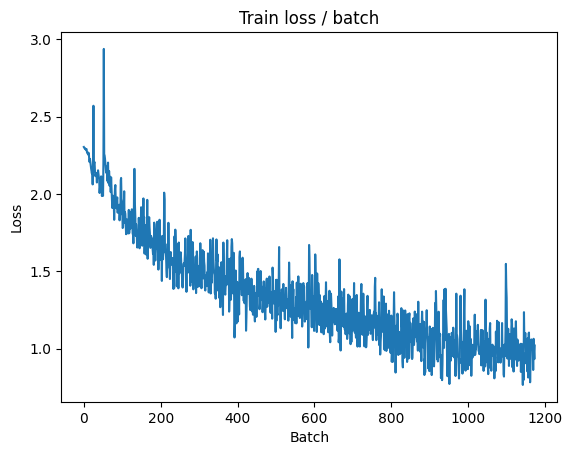

[TRAIN Batch 200/391]	Time 0.015s (0.033s)	Loss 0.9518 (0.8835)	Prec@1  70.3 ( 69.0)	Prec@5  98.4 ( 97.8)


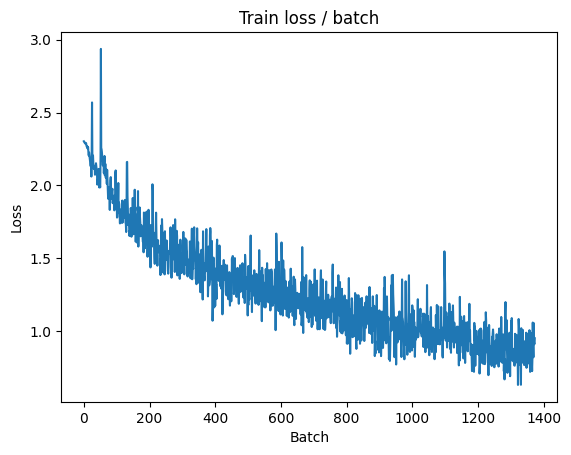


===============> Total time 13s	Avg loss 0.8663	Avg Prec@1 69.63 %	Avg Prec@5 97.80 %

[EVAL Batch 000/391]	Time 0.146s (0.146s)	Loss 0.6687 (0.6687)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)
[EVAL Batch 200/391]	Time 0.048s (0.029s)	Loss 0.8304 (0.7487)	Prec@1  69.5 ( 73.5)	Prec@5  96.9 ( 98.4)

===============> Total time 12s	Avg loss 0.7516	Avg Prec@1 73.51 %	Avg Prec@5 98.39 %



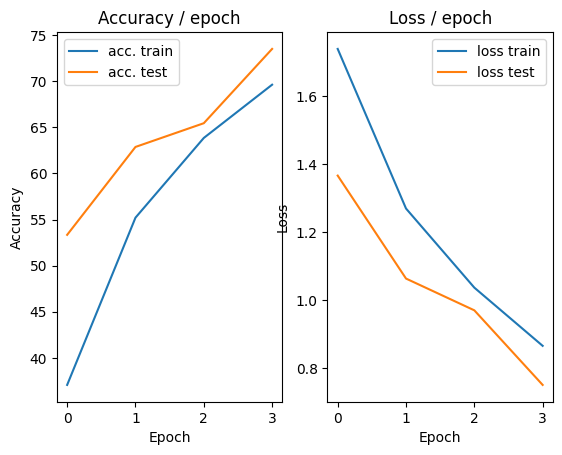

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.6813 (0.6813)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


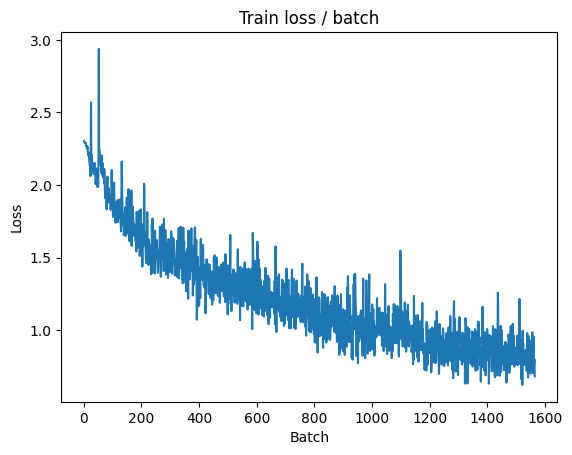

[TRAIN Batch 200/391]	Time 0.048s (0.032s)	Loss 0.6719 (0.7366)	Prec@1  78.9 ( 74.0)	Prec@5  97.7 ( 98.4)


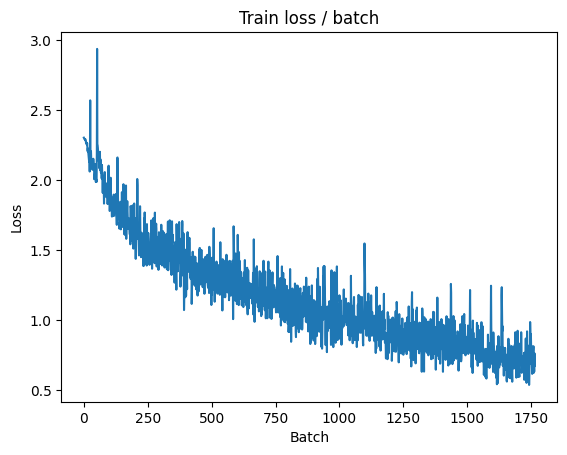


===============> Total time 13s	Avg loss 0.7257	Avg Prec@1 74.55 %	Avg Prec@5 98.51 %

[EVAL Batch 000/391]	Time 0.130s (0.130s)	Loss 0.6721 (0.6721)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)
[EVAL Batch 200/391]	Time 0.054s (0.029s)	Loss 0.8420 (0.6744)	Prec@1  68.0 ( 76.3)	Prec@5  96.9 ( 98.6)

===============> Total time 12s	Avg loss 0.6805	Avg Prec@1 76.14 %	Avg Prec@5 98.66 %



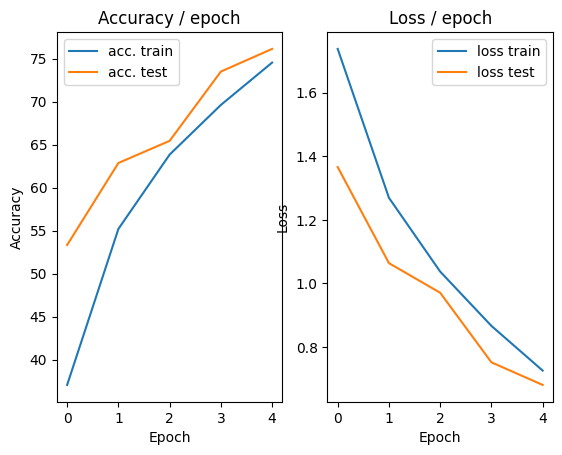

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.6518 (0.6518)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)


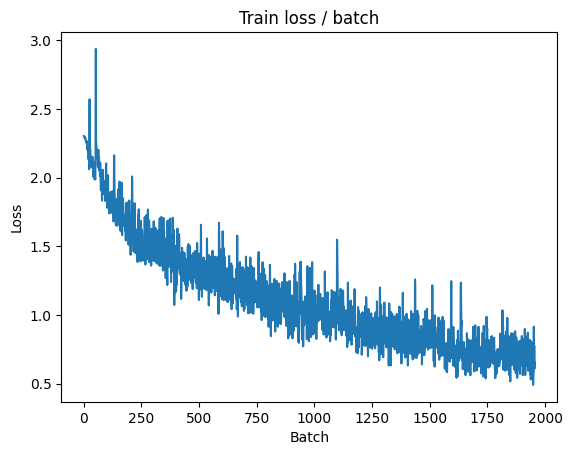

[TRAIN Batch 200/391]	Time 0.094s (0.039s)	Loss 0.5631 (0.6022)	Prec@1  82.0 ( 79.2)	Prec@5  98.4 ( 99.0)


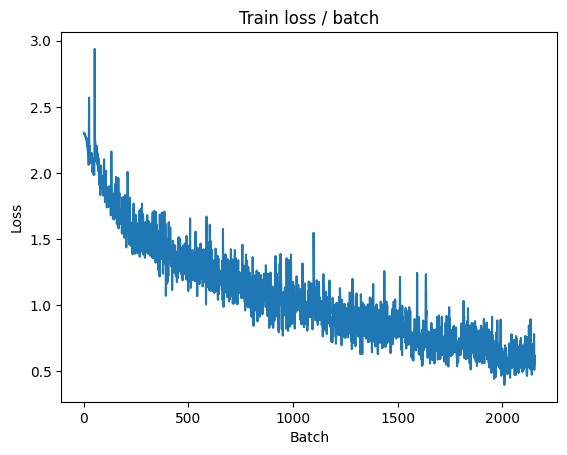


===============> Total time 14s	Avg loss 0.6072	Avg Prec@1 78.93 %	Avg Prec@5 98.98 %

[EVAL Batch 000/391]	Time 0.144s (0.144s)	Loss 0.5834 (0.5834)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.066s (0.033s)	Loss 0.6448 (0.5360)	Prec@1  78.1 ( 81.2)	Prec@5  98.4 ( 99.4)

===============> Total time 12s	Avg loss 0.5368	Avg Prec@1 81.22 %	Avg Prec@5 99.34 %



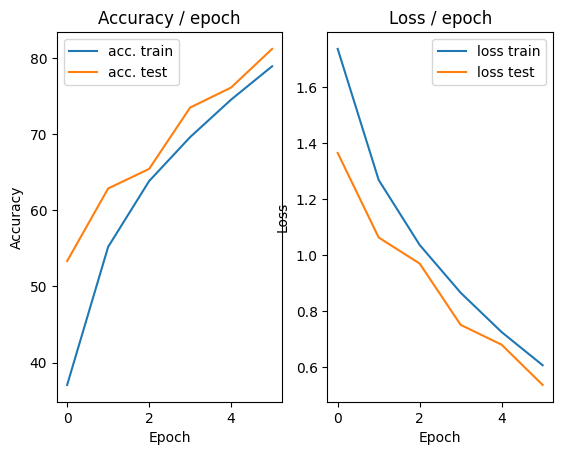

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.5021 (0.5021)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


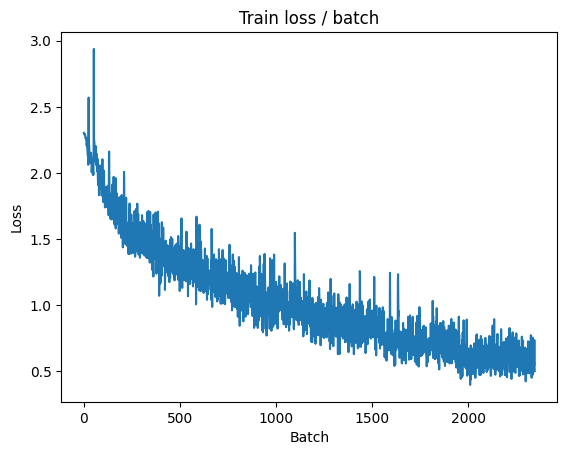

[TRAIN Batch 200/391]	Time 0.013s (0.038s)	Loss 0.4400 (0.4967)	Prec@1  85.9 ( 82.7)	Prec@5 100.0 ( 99.4)


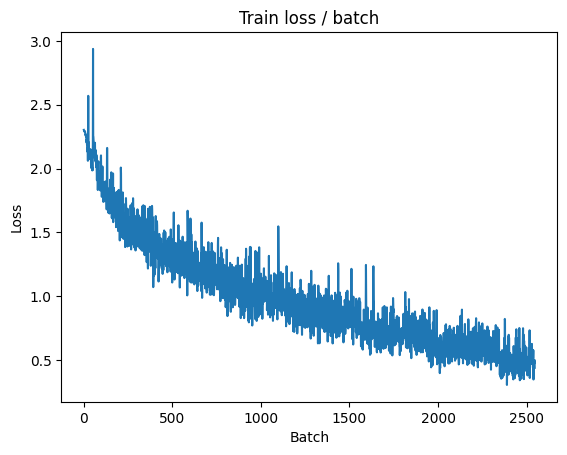


===============> Total time 13s	Avg loss 0.4987	Avg Prec@1 82.55 %	Avg Prec@5 99.38 %

[EVAL Batch 000/391]	Time 0.141s (0.141s)	Loss 0.4240 (0.4240)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.048s (0.035s)	Loss 0.4893 (0.4437)	Prec@1  85.2 ( 84.7)	Prec@5  98.4 ( 99.7)

===============> Total time 12s	Avg loss 0.4396	Avg Prec@1 84.93 %	Avg Prec@5 99.70 %



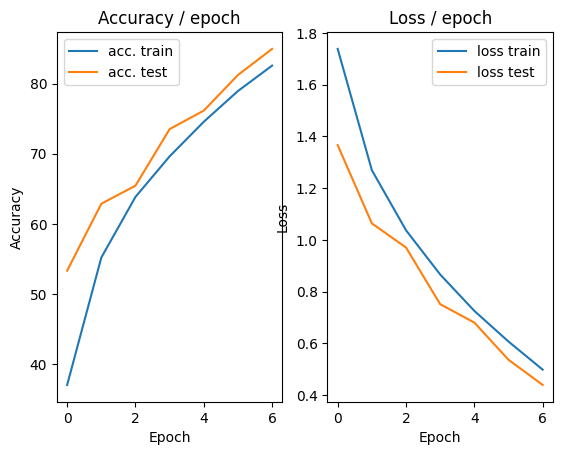

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.5253 (0.5253)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


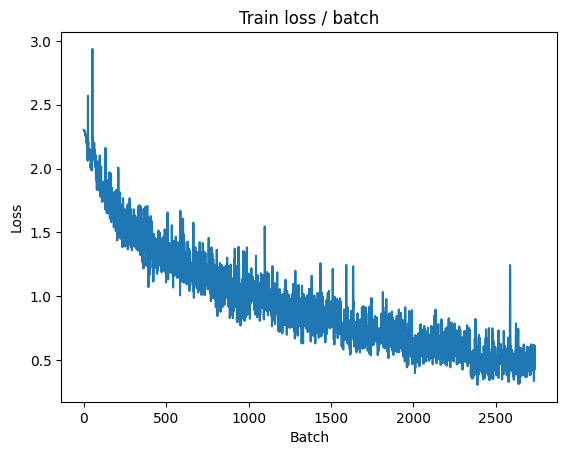

[TRAIN Batch 200/391]	Time 0.054s (0.044s)	Loss 0.3957 (0.3735)	Prec@1  88.3 ( 87.0)	Prec@5  99.2 ( 99.7)


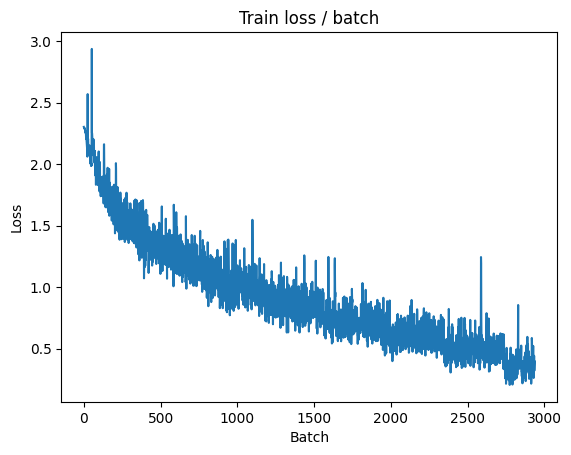


===============> Total time 15s	Avg loss 0.3902	Avg Prec@1 86.39 %	Avg Prec@5 99.65 %

[EVAL Batch 000/391]	Time 0.141s (0.141s)	Loss 0.2369 (0.2369)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.036s)	Loss 0.3392 (0.2426)	Prec@1  89.1 ( 92.4)	Prec@5 100.0 ( 99.9)

===============> Total time 12s	Avg loss 0.2424	Avg Prec@1 92.36 %	Avg Prec@5 99.90 %



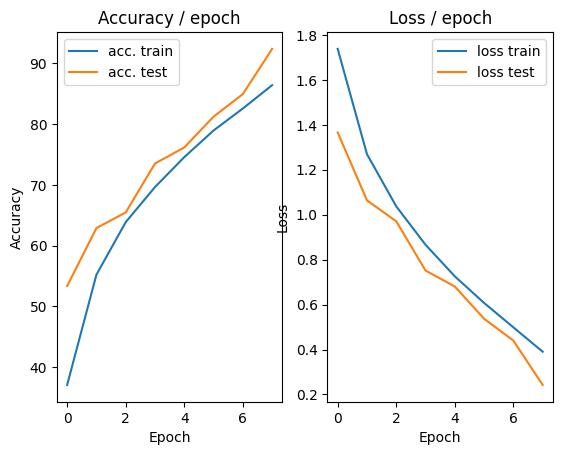

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.2388 (0.2388)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


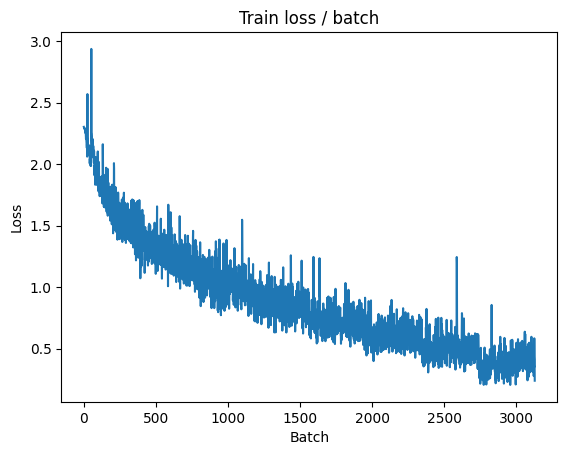

[TRAIN Batch 200/391]	Time 0.018s (0.038s)	Loss 0.3466 (0.2693)	Prec@1  87.5 ( 90.7)	Prec@5 100.0 ( 99.9)


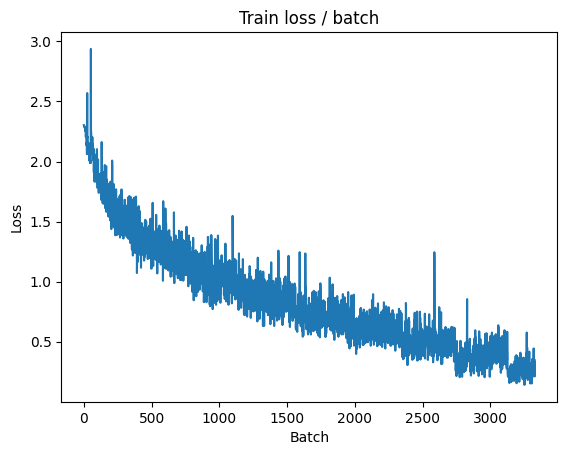


===============> Total time 14s	Avg loss 0.2876	Avg Prec@1 89.92 %	Avg Prec@5 99.86 %

[EVAL Batch 000/391]	Time 0.264s (0.264s)	Loss 0.2096 (0.2096)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.045s (0.032s)	Loss 0.2910 (0.2091)	Prec@1  93.0 ( 93.2)	Prec@5 100.0 ( 99.9)

===============> Total time 12s	Avg loss 0.2089	Avg Prec@1 93.10 %	Avg Prec@5 99.93 %



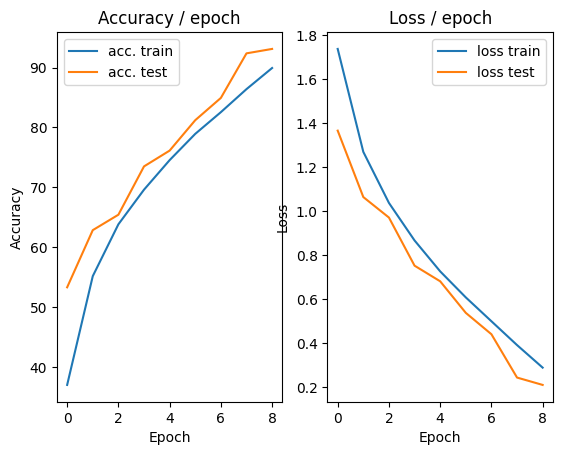

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.281s (0.281s)	Loss 0.2839 (0.2839)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


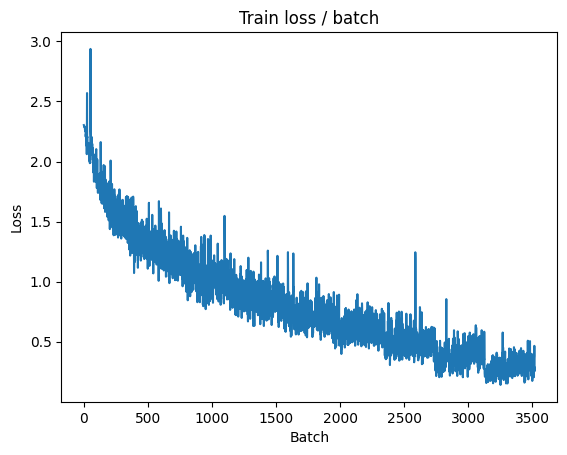

[TRAIN Batch 200/391]	Time 0.037s (0.035s)	Loss 0.1606 (0.1758)	Prec@1  95.3 ( 94.0)	Prec@5 100.0 ( 99.9)


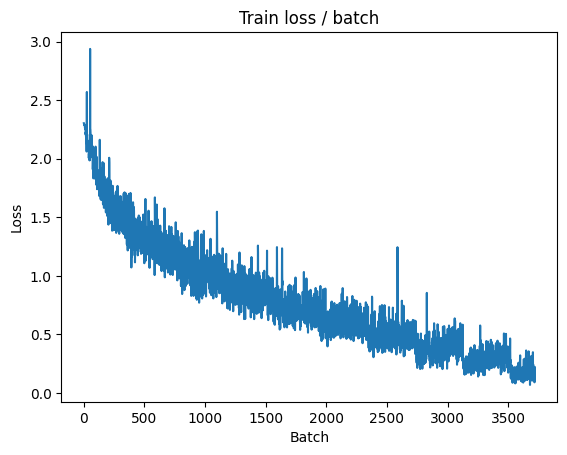


===============> Total time 15s	Avg loss 0.2064	Avg Prec@1 92.92 %	Avg Prec@5 99.93 %

[EVAL Batch 000/391]	Time 0.147s (0.147s)	Loss 0.1757 (0.1757)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.004s (0.036s)	Loss 0.2777 (0.2283)	Prec@1  89.8 ( 92.2)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.2256	Avg Prec@1 92.29 %	Avg Prec@5 99.98 %



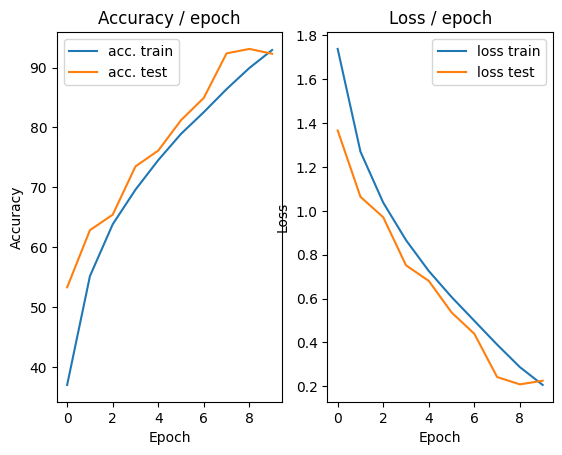

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.1669 (0.1669)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


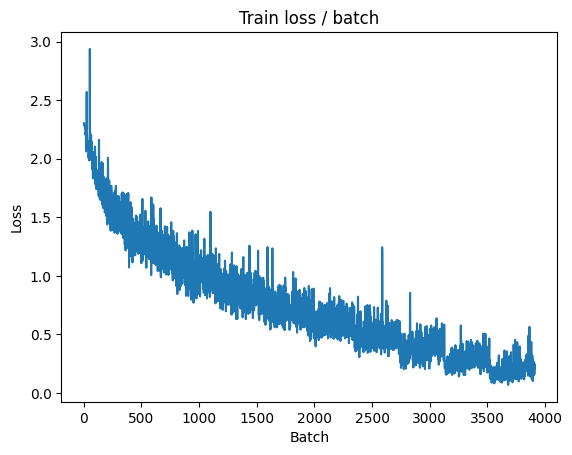

[TRAIN Batch 200/391]	Time 0.021s (0.033s)	Loss 0.1588 (0.1370)	Prec@1  93.8 ( 95.6)	Prec@5 100.0 (100.0)


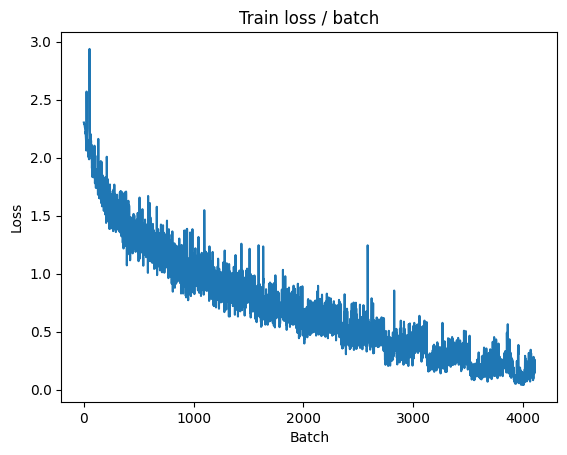


===============> Total time 13s	Avg loss 0.1554	Avg Prec@1 94.83 %	Avg Prec@5 99.97 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0481 (0.0481)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.030s)	Loss 0.1246 (0.1224)	Prec@1  96.1 ( 96.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.1262	Avg Prec@1 95.82 %	Avg Prec@5 99.99 %



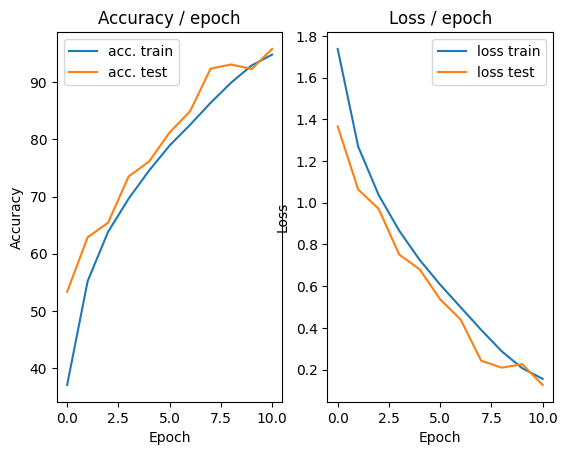

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.1140 (0.1140)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


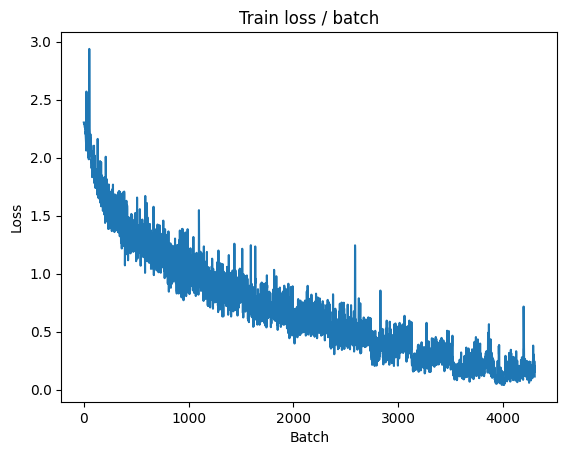

[TRAIN Batch 200/391]	Time 0.075s (0.038s)	Loss 0.0857 (0.0928)	Prec@1  97.7 ( 96.9)	Prec@5 100.0 (100.0)


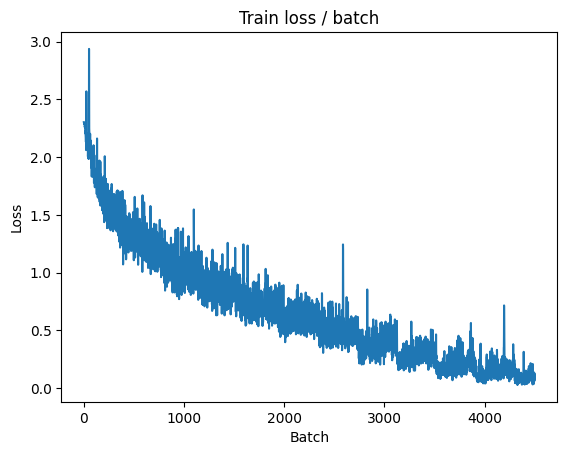


===============> Total time 14s	Avg loss 0.1077	Avg Prec@1 96.37 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.138s (0.138s)	Loss 0.0641 (0.0641)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.034s)	Loss 0.1479 (0.0863)	Prec@1  93.8 ( 97.1)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0867	Avg Prec@1 97.16 %	Avg Prec@5 100.00 %



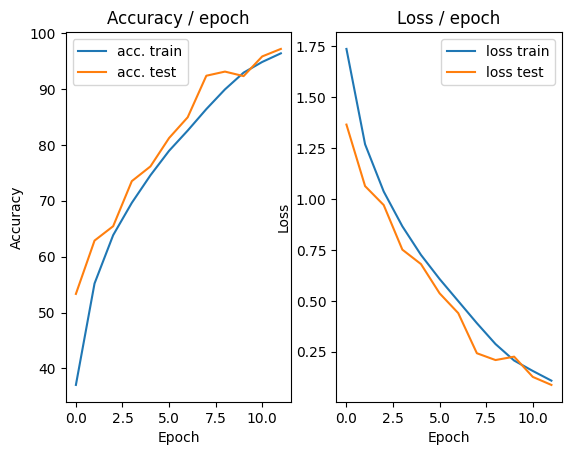

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.0579 (0.0579)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


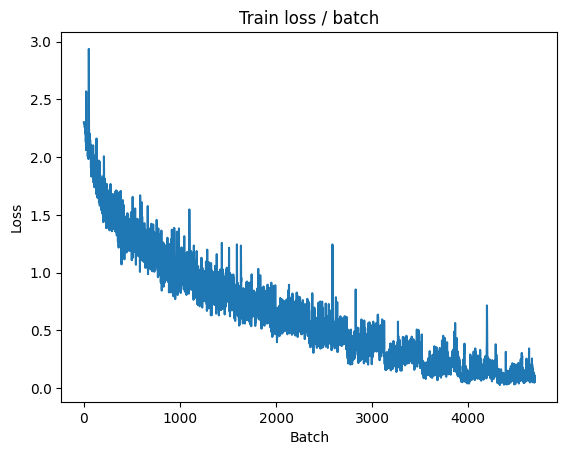

[TRAIN Batch 200/391]	Time 0.049s (0.039s)	Loss 0.0539 (0.0647)	Prec@1  97.7 ( 98.0)	Prec@5 100.0 (100.0)


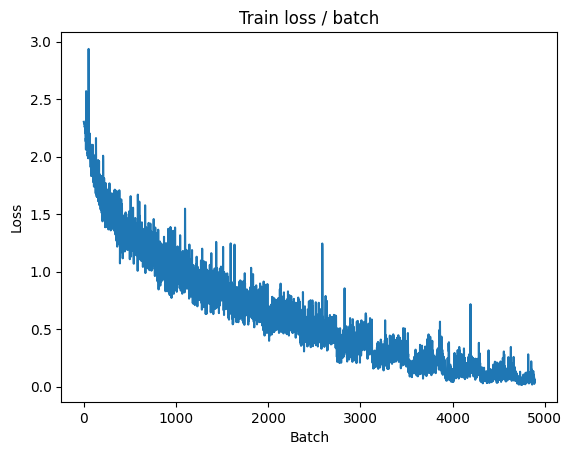


===============> Total time 14s	Avg loss 0.0876	Avg Prec@1 97.13 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0838 (0.0838)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.035s)	Loss 0.0967 (0.1375)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.1392	Avg Prec@1 95.91 %	Avg Prec@5 99.99 %



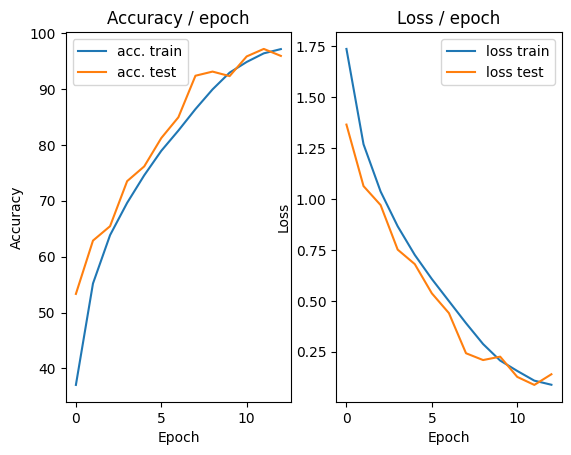

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.1578 (0.1578)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


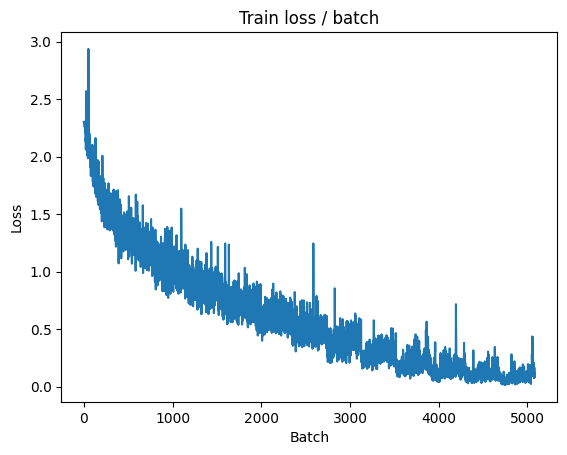

[TRAIN Batch 200/391]	Time 0.042s (0.039s)	Loss 0.1202 (0.0470)	Prec@1  96.1 ( 98.6)	Prec@5 100.0 (100.0)


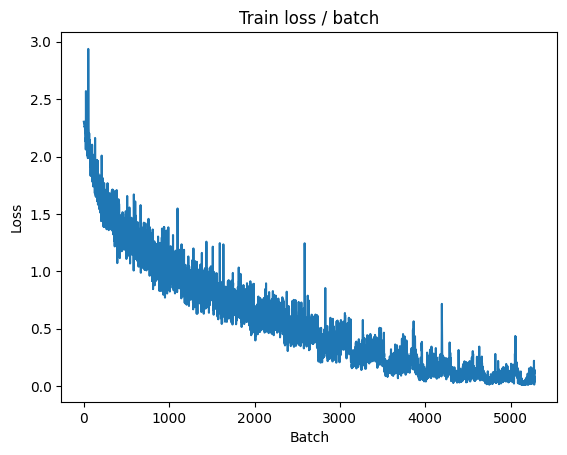


===============> Total time 14s	Avg loss 0.0627	Avg Prec@1 98.07 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.250s (0.250s)	Loss 0.1087 (0.1087)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.038s)	Loss 0.0885 (0.0972)	Prec@1  97.7 ( 96.9)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0962	Avg Prec@1 96.83 %	Avg Prec@5 99.99 %



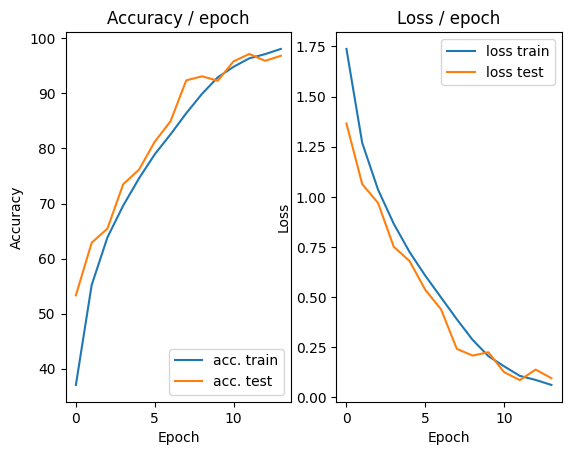

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.262s (0.262s)	Loss 0.0555 (0.0555)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


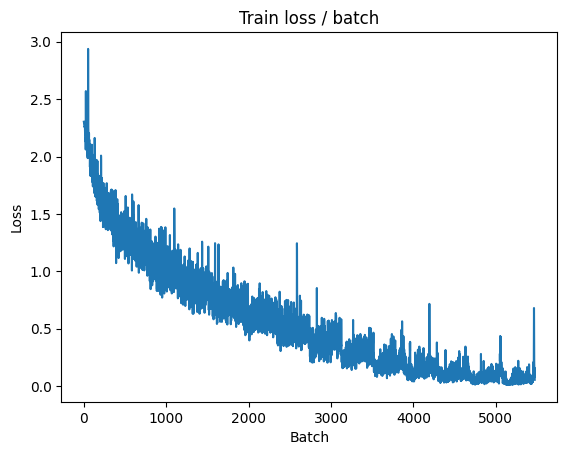

[TRAIN Batch 200/391]	Time 0.014s (0.035s)	Loss 0.0282 (0.0413)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


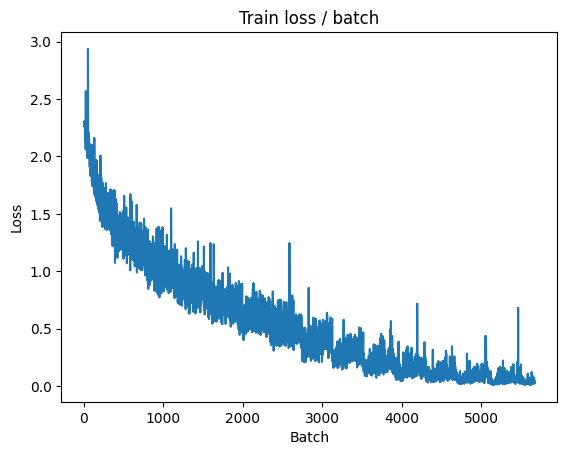


===============> Total time 14s	Avg loss 0.0485	Avg Prec@1 98.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.155s (0.155s)	Loss 0.0542 (0.0542)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.004s (0.030s)	Loss 0.0730 (0.0724)	Prec@1  98.4 ( 97.8)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0741	Avg Prec@1 97.68 %	Avg Prec@5 100.00 %



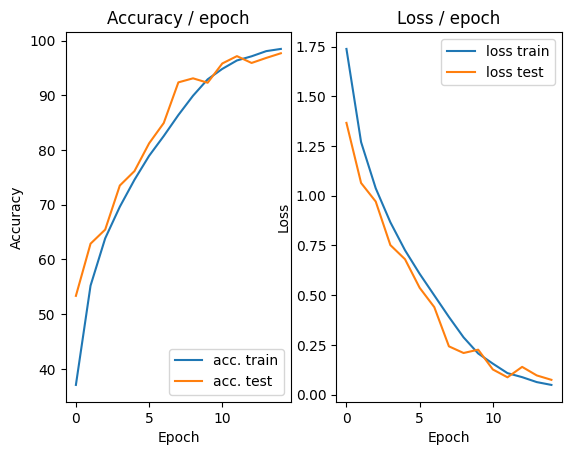

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.154s (0.154s)	Loss 0.1356 (0.1356)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


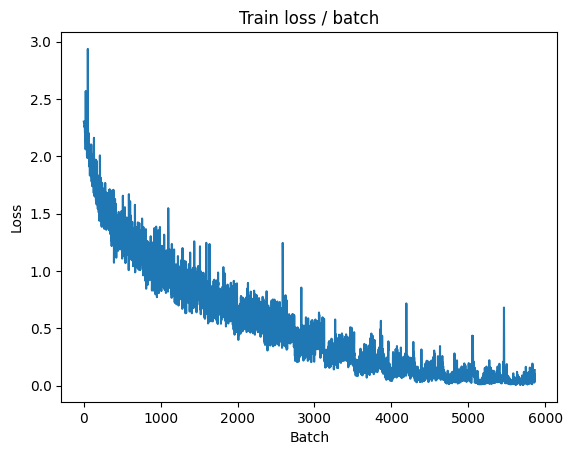

[TRAIN Batch 200/391]	Time 0.049s (0.033s)	Loss 0.0121 (0.0256)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


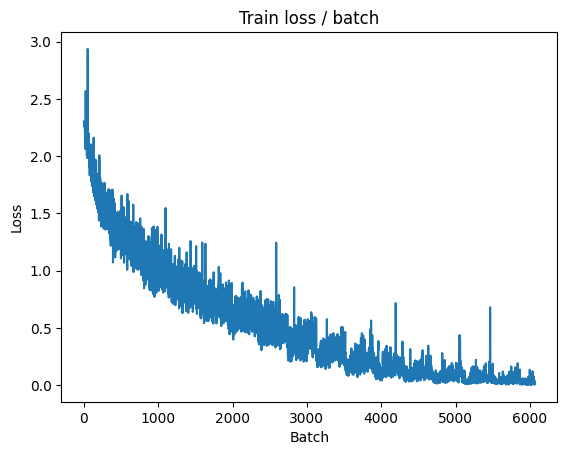


===============> Total time 13s	Avg loss 0.0347	Avg Prec@1 98.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.154s (0.154s)	Loss 0.0183 (0.0183)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.031s (0.035s)	Loss 0.0176 (0.0325)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0320	Avg Prec@1 99.00 %	Avg Prec@5 100.00 %



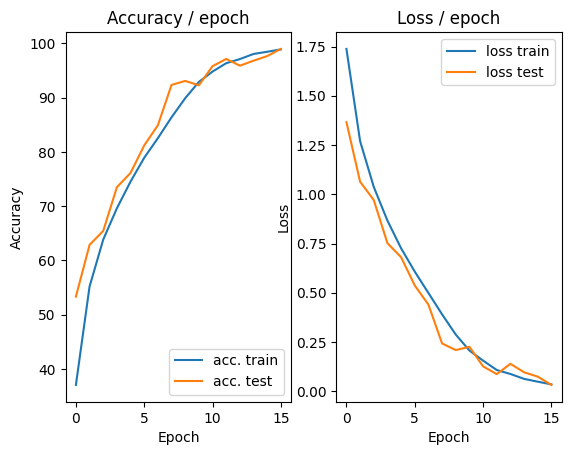

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0476 (0.0476)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


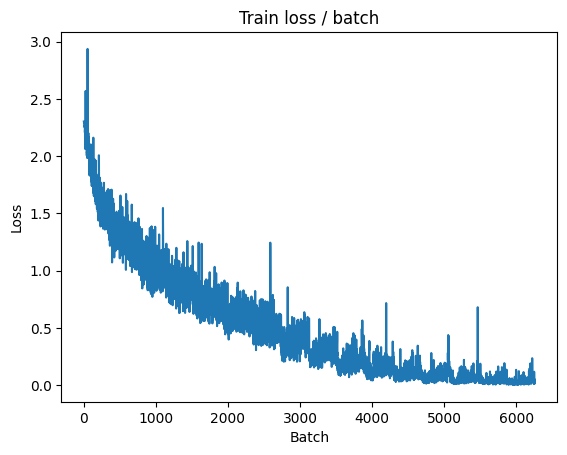

[TRAIN Batch 200/391]	Time 0.021s (0.035s)	Loss 0.1095 (0.0321)	Prec@1  96.9 ( 99.0)	Prec@5 100.0 (100.0)


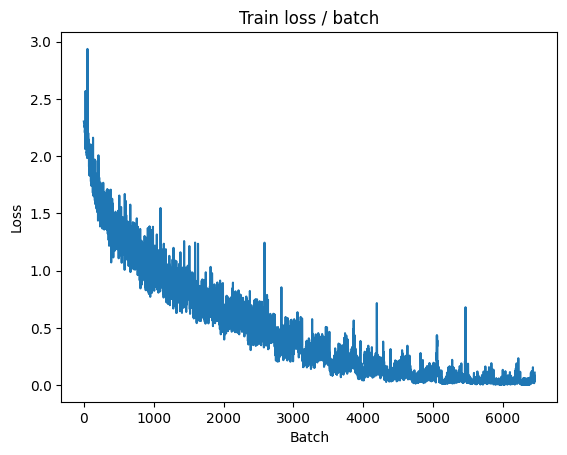


===============> Total time 13s	Avg loss 0.0513	Avg Prec@1 98.26 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.154s (0.154s)	Loss 0.0153 (0.0153)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.092s (0.034s)	Loss 0.0450 (0.0425)	Prec@1  99.2 ( 98.6)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0425	Avg Prec@1 98.67 %	Avg Prec@5 100.00 %



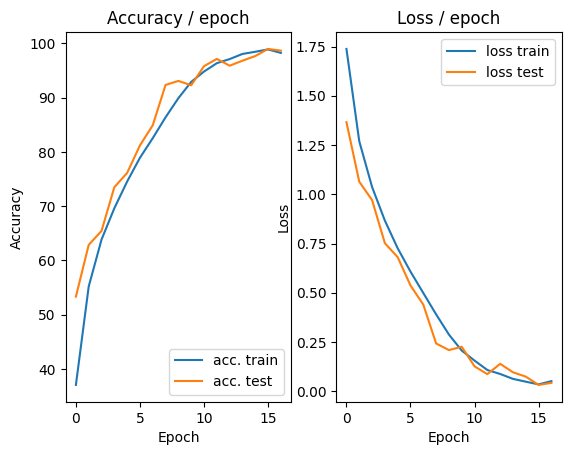

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.0416 (0.0416)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


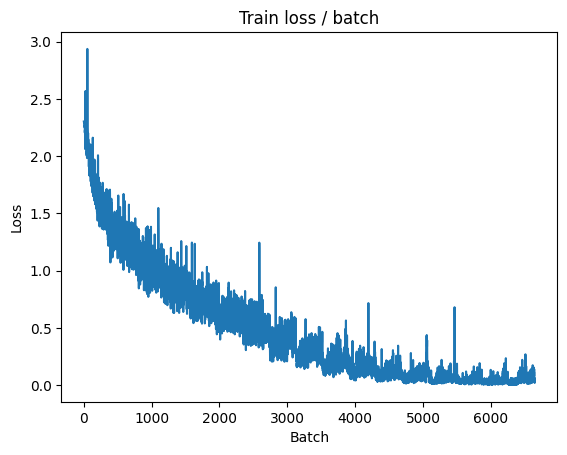

[TRAIN Batch 200/391]	Time 0.033s (0.038s)	Loss 0.0096 (0.0430)	Prec@1 100.0 ( 98.7)	Prec@5 100.0 (100.0)


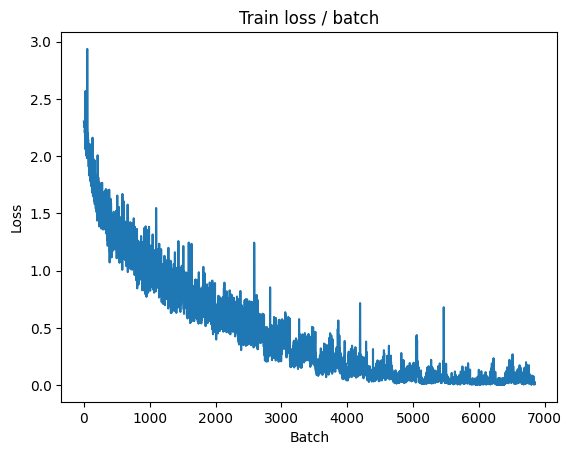


===============> Total time 13s	Avg loss 0.0563	Avg Prec@1 98.16 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0276 (0.0276)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.036s (0.035s)	Loss 0.0507 (0.0520)	Prec@1  98.4 ( 98.3)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0516	Avg Prec@1 98.33 %	Avg Prec@5 100.00 %



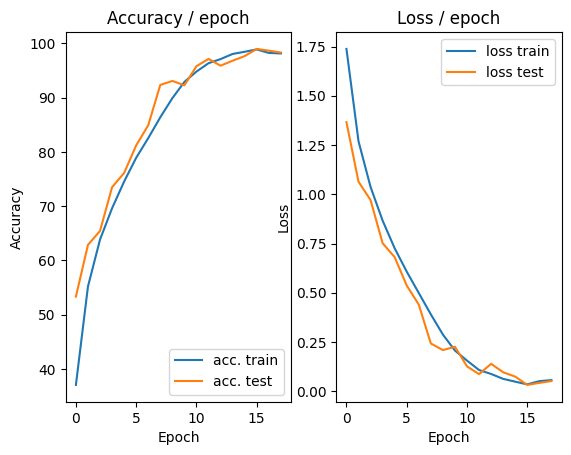

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0614 (0.0614)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


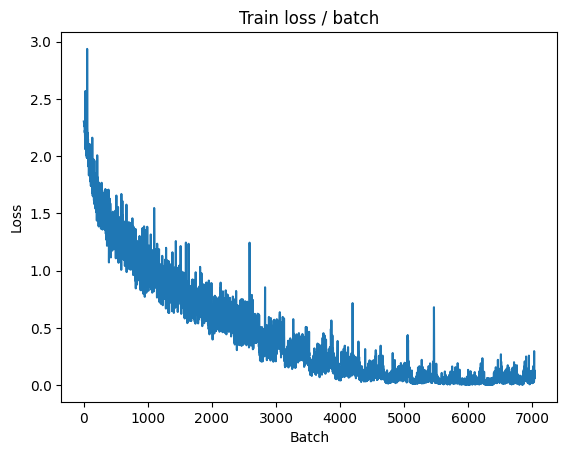

[TRAIN Batch 200/391]	Time 0.047s (0.038s)	Loss 0.0569 (0.0533)	Prec@1  96.9 ( 98.3)	Prec@5 100.0 (100.0)


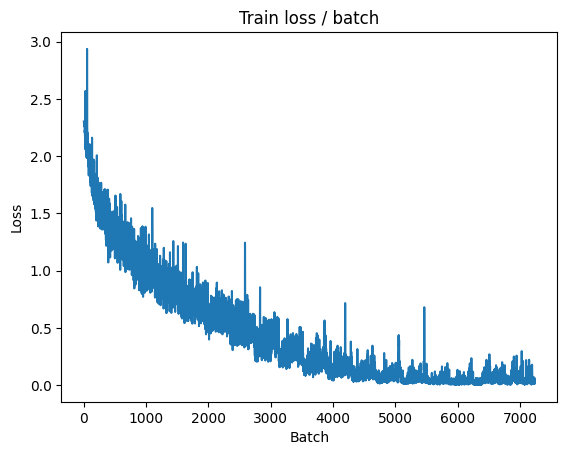


===============> Total time 14s	Avg loss 0.0601	Avg Prec@1 98.05 %	Avg Prec@5 99.99 %

[EVAL Batch 000/391]	Time 0.158s (0.158s)	Loss 0.0156 (0.0156)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.059s (0.035s)	Loss 0.0486 (0.0307)	Prec@1  98.4 ( 99.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0303	Avg Prec@1 99.06 %	Avg Prec@5 100.00 %



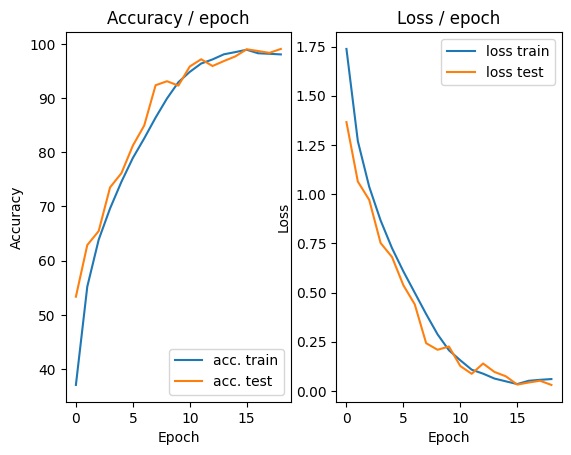

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0141 (0.0141)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


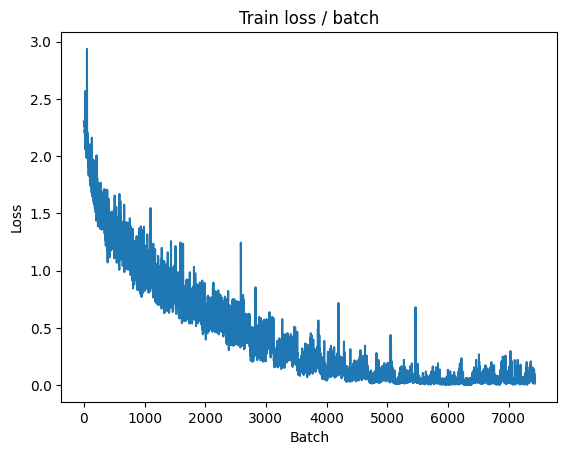

[TRAIN Batch 200/391]	Time 0.027s (0.039s)	Loss 0.0469 (0.0296)	Prec@1  98.4 ( 99.0)	Prec@5 100.0 (100.0)


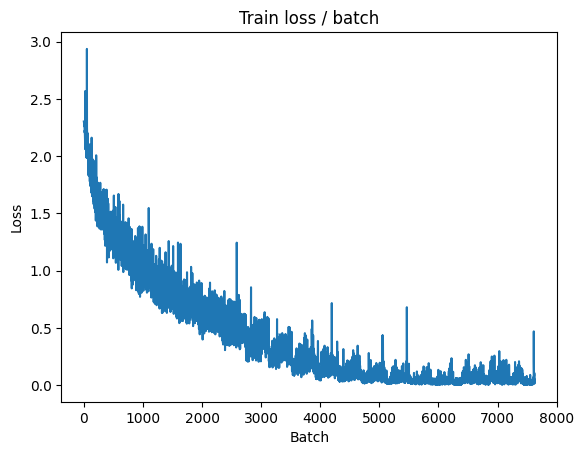


===============> Total time 16s	Avg loss 0.0413	Avg Prec@1 98.66 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.166s (0.166s)	Loss 0.1015 (0.1015)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.030s)	Loss 0.0697 (0.0346)	Prec@1  96.9 ( 98.9)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0344	Avg Prec@1 98.86 %	Avg Prec@5 100.00 %



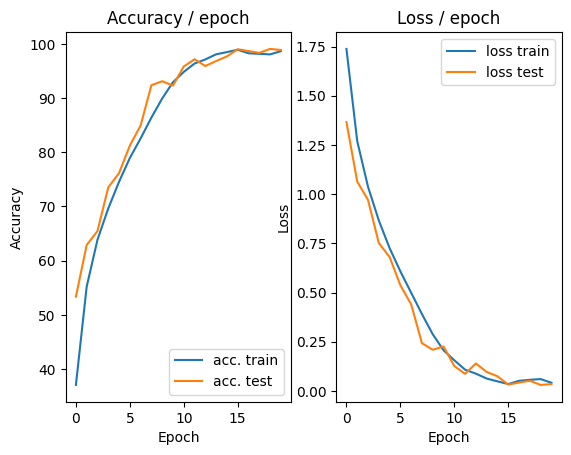

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.0256 (0.0256)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


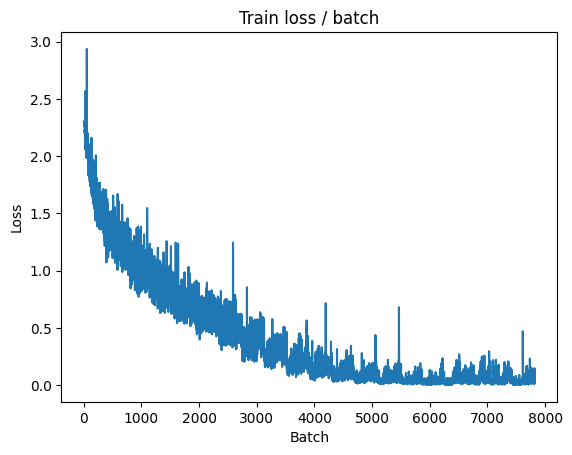

[TRAIN Batch 200/391]	Time 0.048s (0.034s)	Loss 0.0104 (0.0242)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


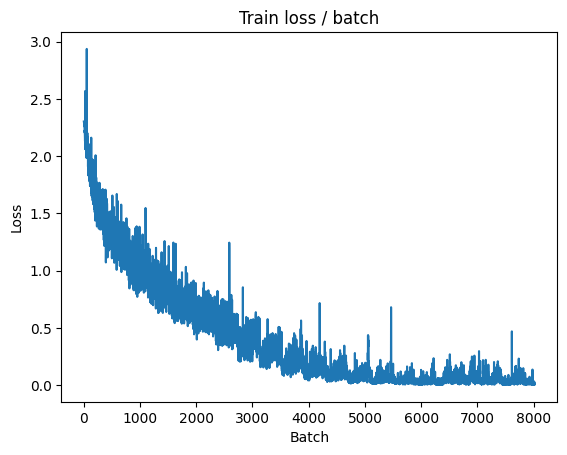


===============> Total time 14s	Avg loss 0.0279	Avg Prec@1 99.09 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 0.0634 (0.0634)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.052s (0.030s)	Loss 0.0346 (0.1189)	Prec@1  99.2 ( 97.2)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.1158	Avg Prec@1 97.26 %	Avg Prec@5 100.00 %



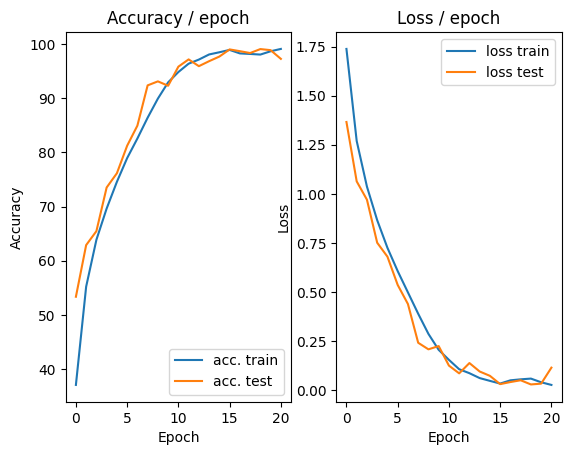

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.0721 (0.0721)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


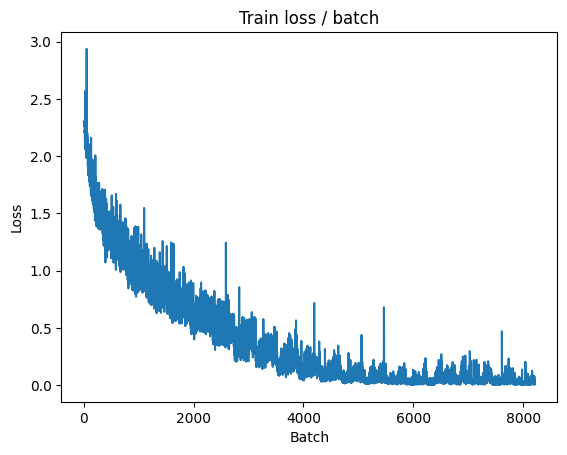

[TRAIN Batch 200/391]	Time 0.022s (0.035s)	Loss 0.0382 (0.0276)	Prec@1  98.4 ( 99.1)	Prec@5 100.0 (100.0)


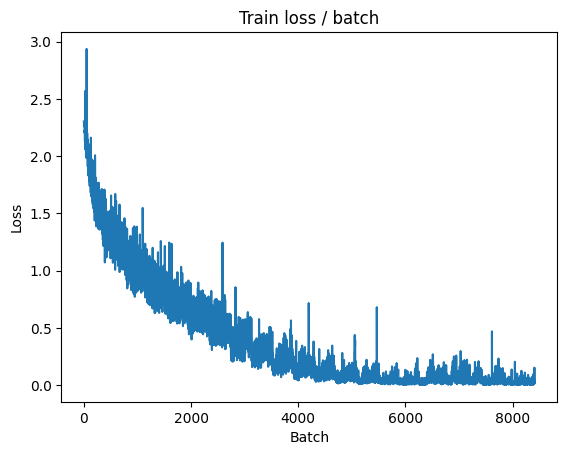


===============> Total time 14s	Avg loss 0.0335	Avg Prec@1 98.94 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.150s (0.150s)	Loss 0.0180 (0.0180)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.057s (0.030s)	Loss 0.0114 (0.0244)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0255	Avg Prec@1 99.18 %	Avg Prec@5 100.00 %



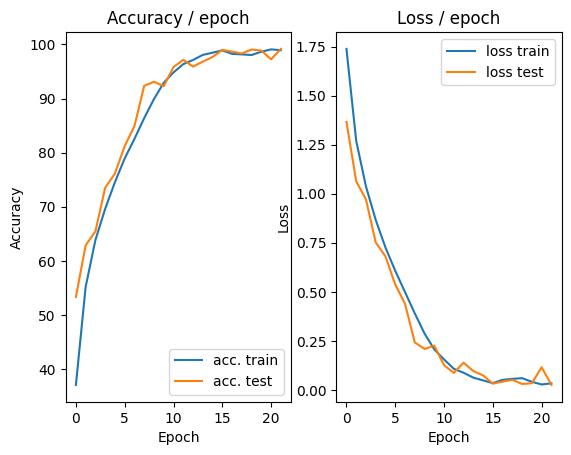

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.0363 (0.0363)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


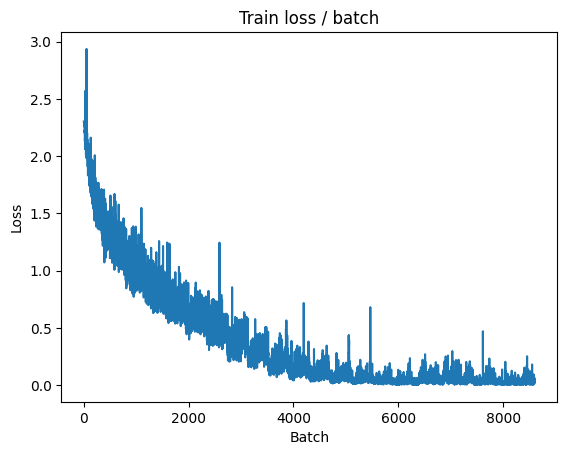

[TRAIN Batch 200/391]	Time 0.053s (0.042s)	Loss 0.0165 (0.0357)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


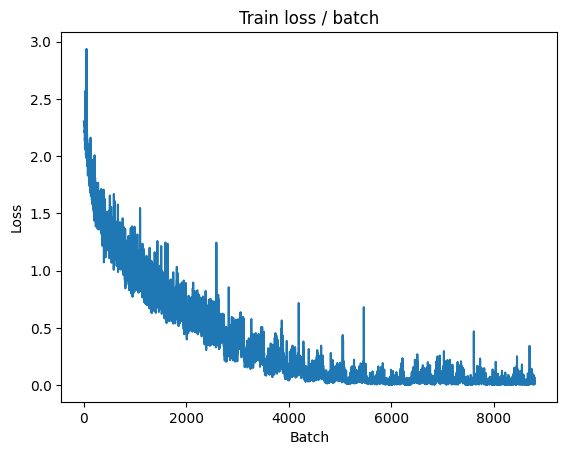


===============> Total time 14s	Avg loss 0.0357	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.149s (0.149s)	Loss 0.0166 (0.0166)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.006s (0.035s)	Loss 0.0345 (0.0179)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0187	Avg Prec@1 99.43 %	Avg Prec@5 100.00 %



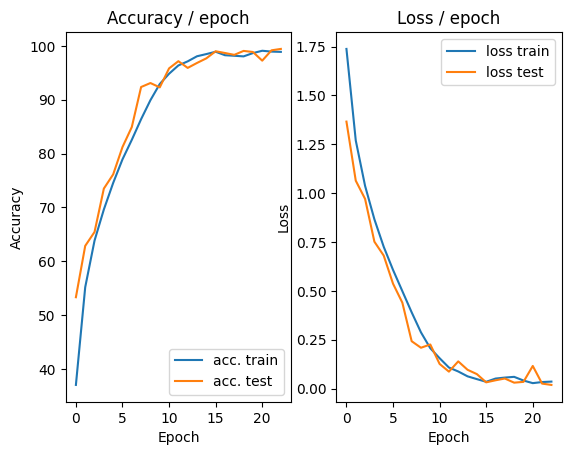

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.0359 (0.0359)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


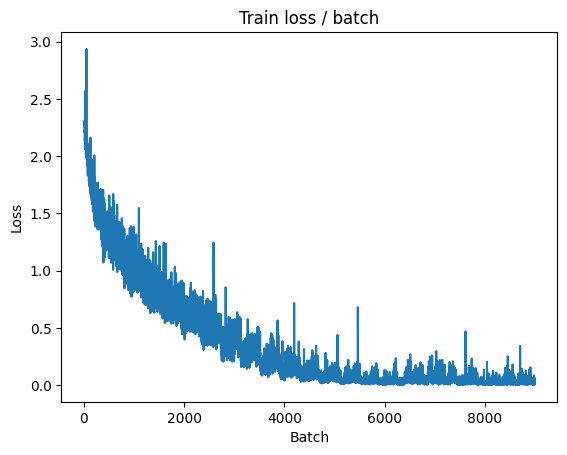

[TRAIN Batch 200/391]	Time 0.041s (0.040s)	Loss 0.0041 (0.0164)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


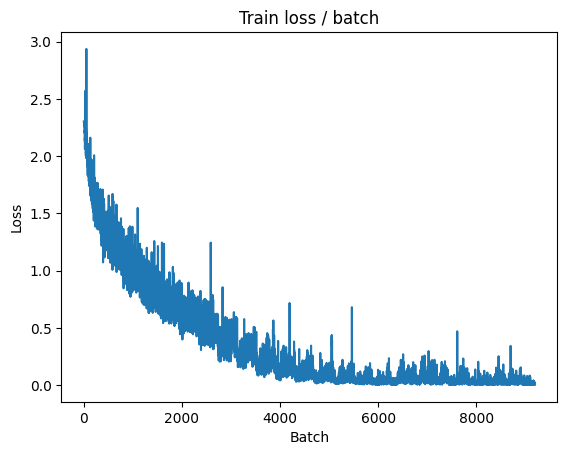


===============> Total time 14s	Avg loss 0.0187	Avg Prec@1 99.41 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.161s (0.161s)	Loss 0.1218 (0.1218)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.058s (0.036s)	Loss 0.0562 (0.0695)	Prec@1  99.2 ( 97.8)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0691	Avg Prec@1 97.85 %	Avg Prec@5 100.00 %



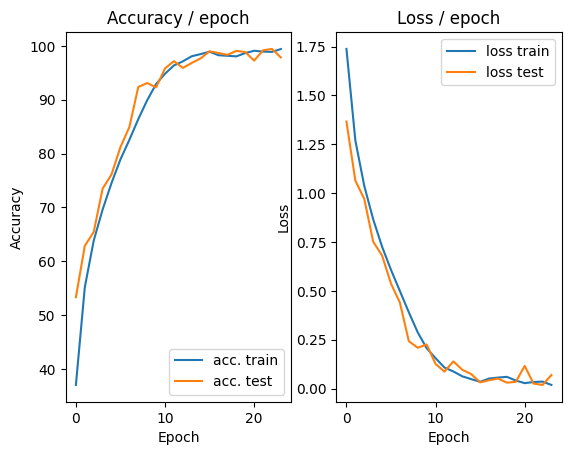

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.0168 (0.0168)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


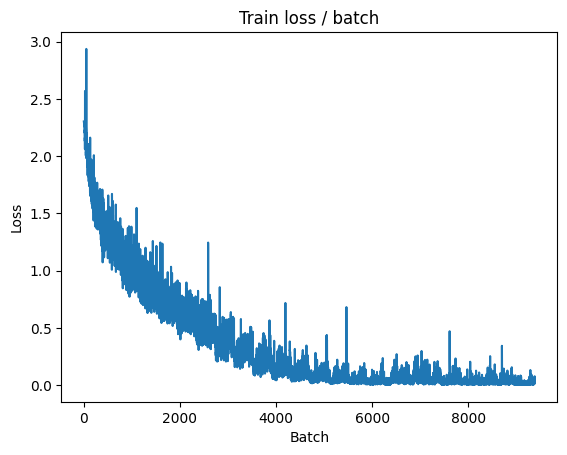

[TRAIN Batch 200/391]	Time 0.024s (0.045s)	Loss 0.0156 (0.0223)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


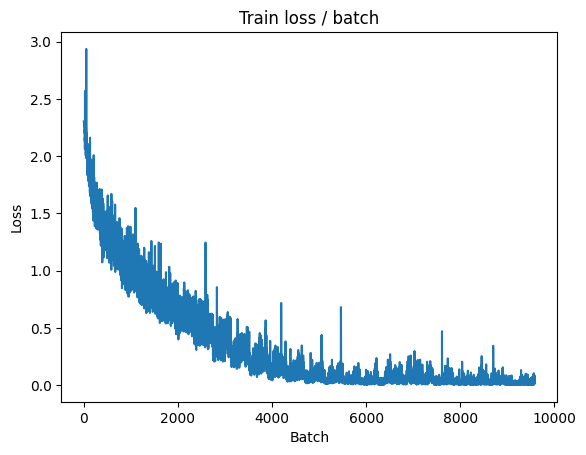


===============> Total time 15s	Avg loss 0.0277	Avg Prec@1 99.18 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.282s (0.282s)	Loss 0.0629 (0.0629)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.055s (0.035s)	Loss 0.0897 (0.0986)	Prec@1  96.9 ( 96.8)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0984	Avg Prec@1 96.88 %	Avg Prec@5 100.00 %



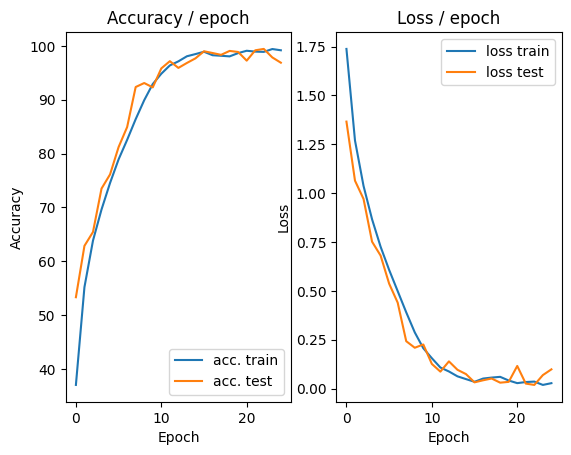

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0549 (0.0549)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


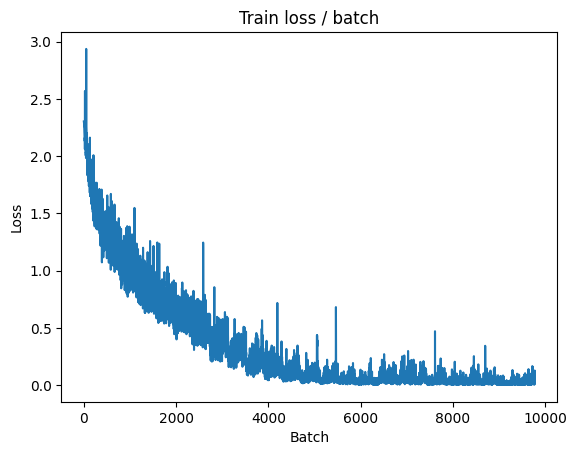

[TRAIN Batch 200/391]	Time 0.030s (0.037s)	Loss 0.0064 (0.0232)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)


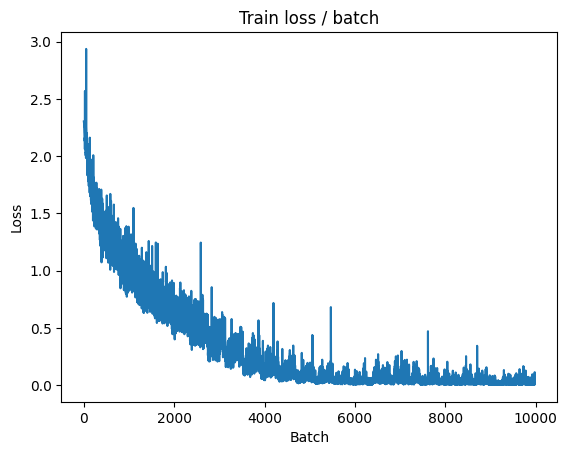


===============> Total time 14s	Avg loss 0.0345	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.161s (0.161s)	Loss 0.0187 (0.0187)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.012s (0.031s)	Loss 0.0679 (0.0475)	Prec@1  96.9 ( 98.5)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0524	Avg Prec@1 98.34 %	Avg Prec@5 100.00 %



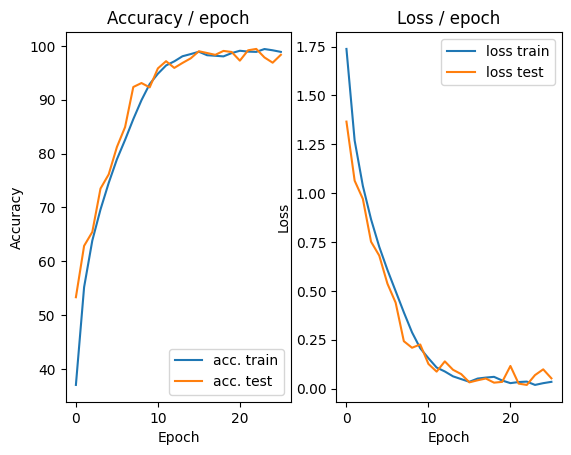

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.0304 (0.0304)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


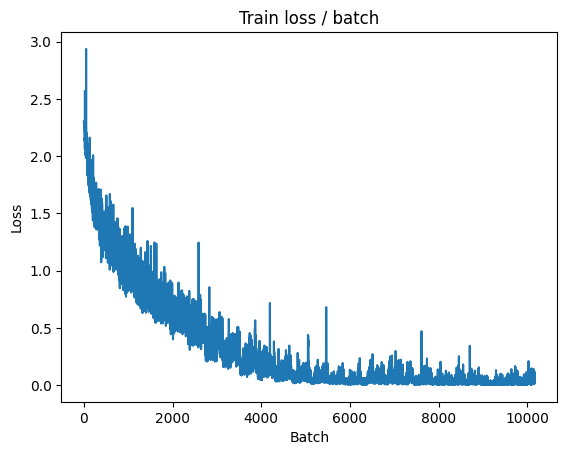

[TRAIN Batch 200/391]	Time 0.015s (0.040s)	Loss 0.0119 (0.0228)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


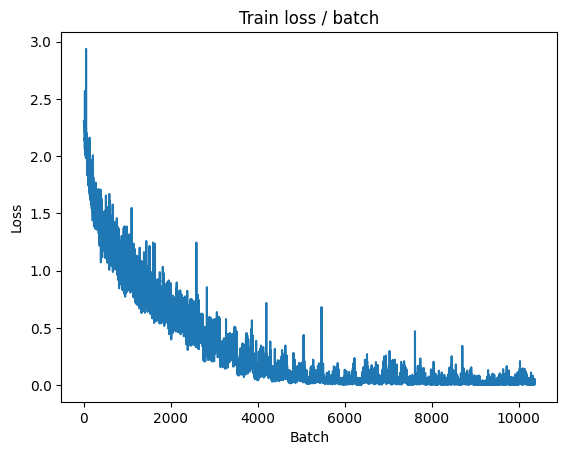


===============> Total time 15s	Avg loss 0.0191	Avg Prec@1 99.36 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0098 (0.0098)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.005s (0.031s)	Loss 0.0467 (0.0146)	Prec@1  98.4 ( 99.5)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0149	Avg Prec@1 99.54 %	Avg Prec@5 100.00 %



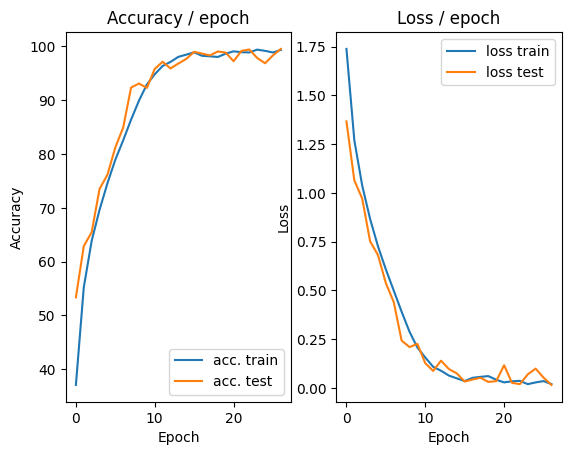

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.0047 (0.0047)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


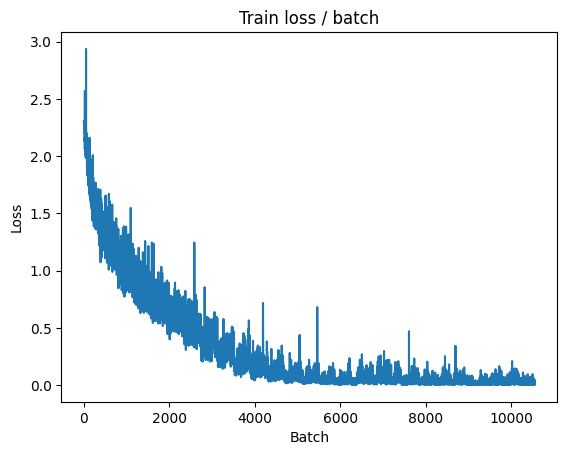

[TRAIN Batch 200/391]	Time 0.057s (0.039s)	Loss 0.0040 (0.0116)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


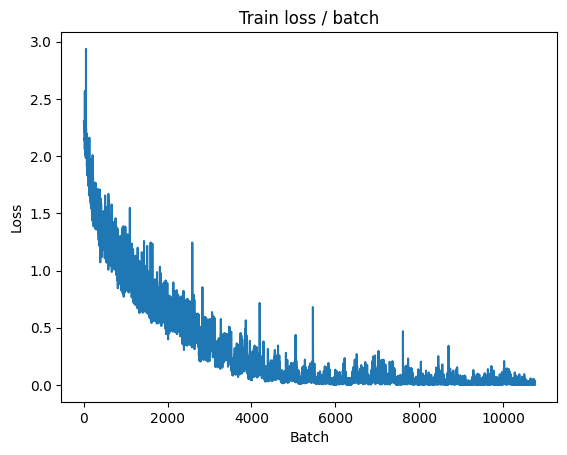


===============> Total time 14s	Avg loss 0.0130	Avg Prec@1 99.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.159s (0.159s)	Loss 0.0224 (0.0224)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.010s (0.034s)	Loss 0.0021 (0.0298)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0301	Avg Prec@1 99.05 %	Avg Prec@5 100.00 %



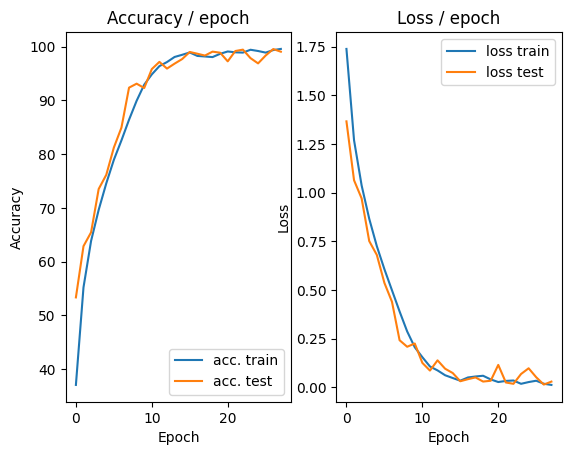

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.0343 (0.0343)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


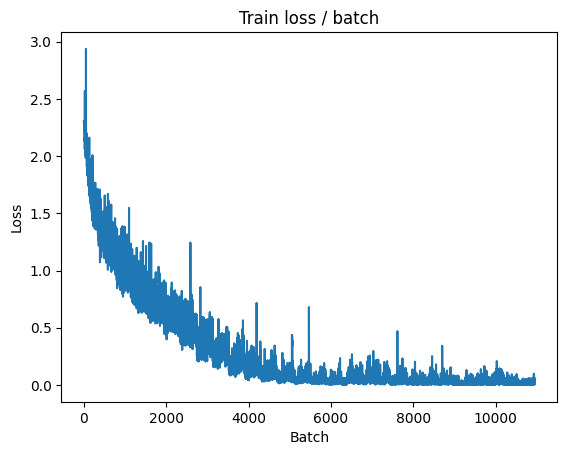

[TRAIN Batch 200/391]	Time 0.014s (0.045s)	Loss 0.0773 (0.0517)	Prec@1  97.7 ( 98.6)	Prec@5 100.0 (100.0)


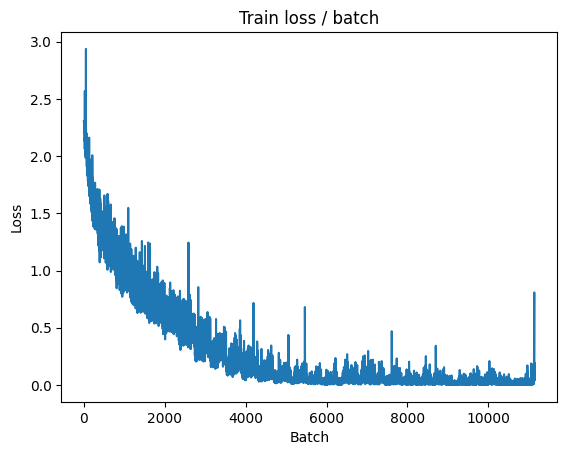


===============> Total time 15s	Avg loss 0.0501	Avg Prec@1 98.50 %	Avg Prec@5 99.99 %

[EVAL Batch 000/391]	Time 0.166s (0.166s)	Loss 0.0057 (0.0057)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.082s (0.040s)	Loss 0.0251 (0.0391)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)

===============> Total time 14s	Avg loss 0.0396	Avg Prec@1 98.67 %	Avg Prec@5 100.00 %



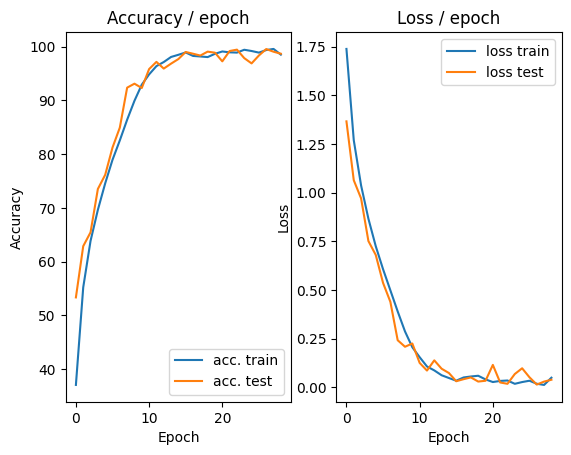

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.0182 (0.0182)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


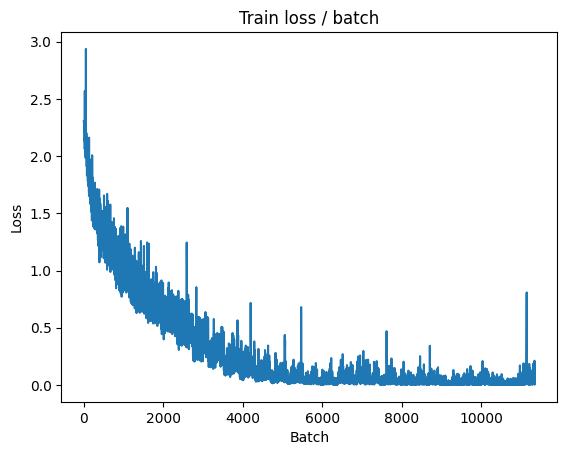

[TRAIN Batch 200/391]	Time 0.016s (0.035s)	Loss 0.0083 (0.0183)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


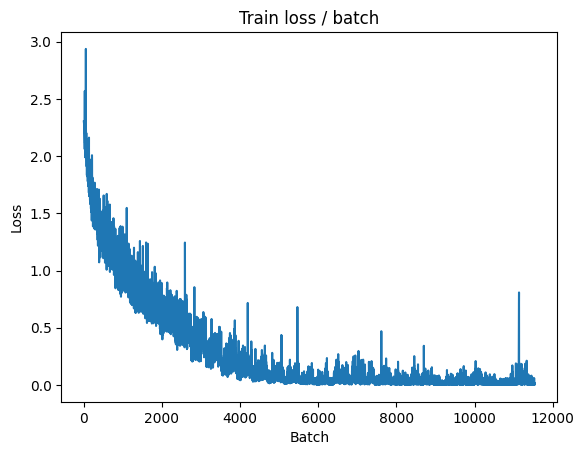


===============> Total time 14s	Avg loss 0.0243	Avg Prec@1 99.23 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.165s (0.165s)	Loss 0.1086 (0.1086)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.030s)	Loss 0.0495 (0.0528)	Prec@1  97.7 ( 98.4)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0566	Avg Prec@1 98.39 %	Avg Prec@5 100.00 %



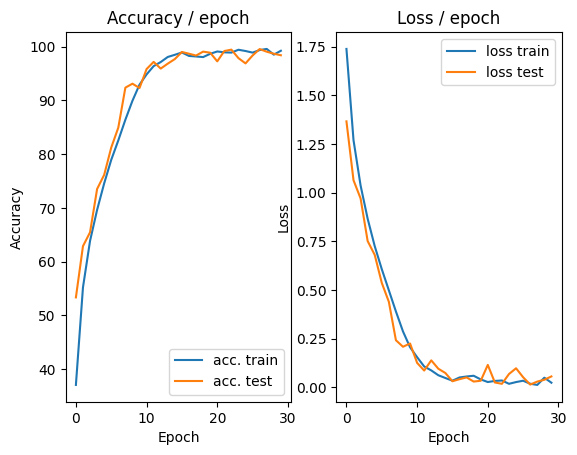

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.0784 (0.0784)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


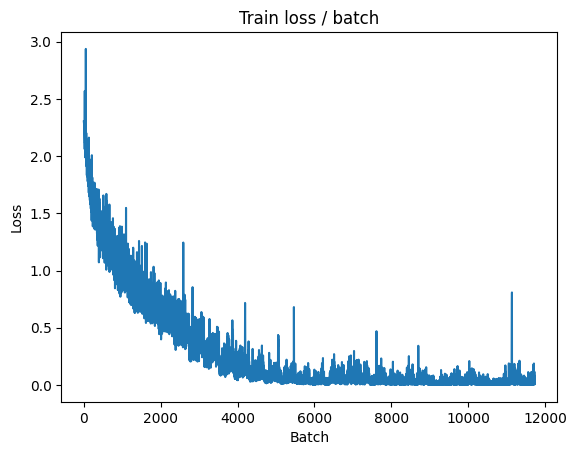

[TRAIN Batch 200/391]	Time 0.036s (0.033s)	Loss 0.0193 (0.0204)	Prec@1  99.2 ( 99.4)	Prec@5 100.0 (100.0)


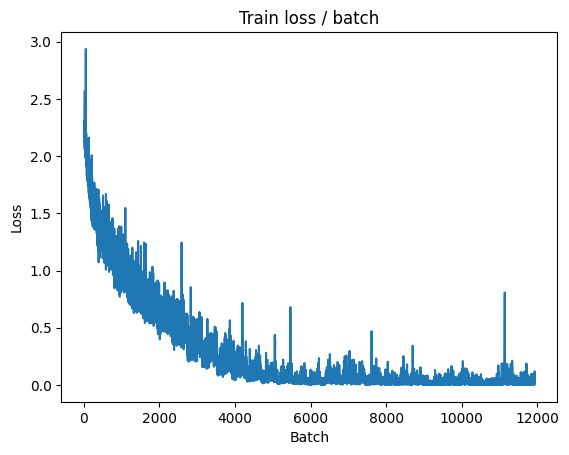


===============> Total time 14s	Avg loss 0.0270	Avg Prec@1 99.16 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0414 (0.0414)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.046s (0.030s)	Loss 0.1820 (0.0552)	Prec@1  98.4 ( 98.3)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0549	Avg Prec@1 98.30 %	Avg Prec@5 100.00 %



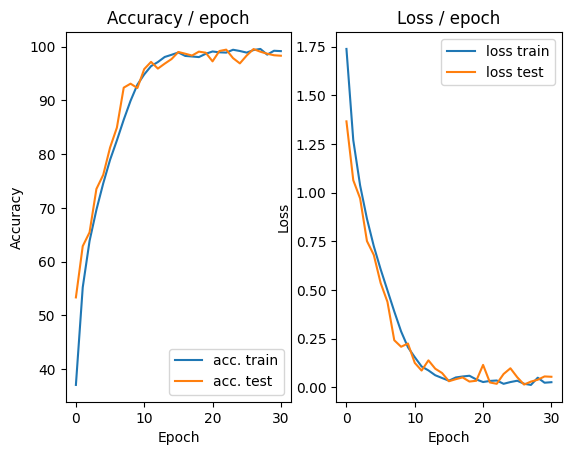

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.0644 (0.0644)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


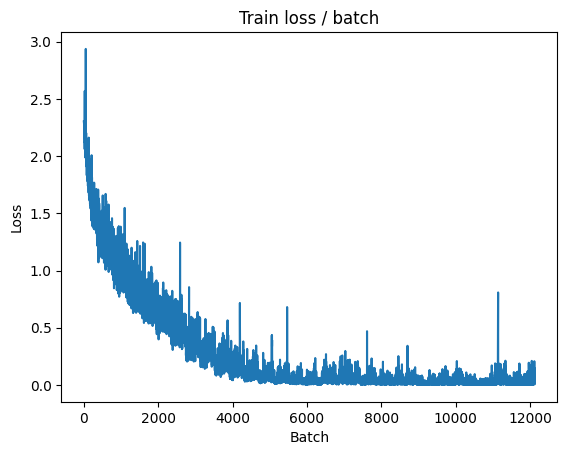

[TRAIN Batch 200/391]	Time 0.045s (0.034s)	Loss 0.0040 (0.0346)	Prec@1 100.0 ( 98.9)	Prec@5 100.0 (100.0)


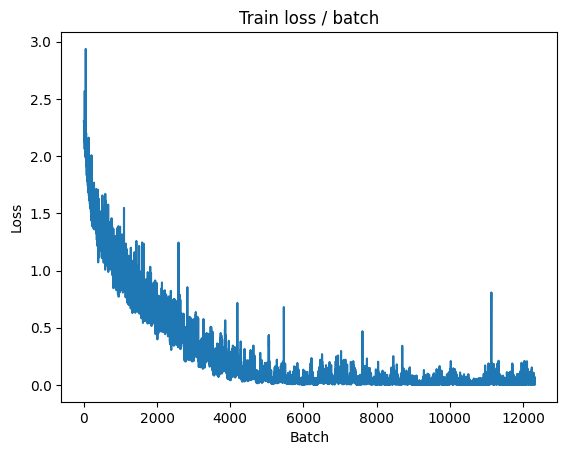


===============> Total time 13s	Avg loss 0.0335	Avg Prec@1 98.92 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.158s (0.158s)	Loss 0.0191 (0.0191)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.109s (0.033s)	Loss 0.0102 (0.0160)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0159	Avg Prec@1 99.50 %	Avg Prec@5 100.00 %



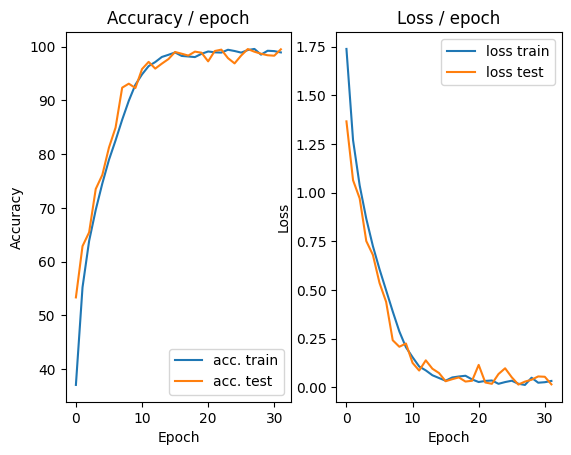

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.0269 (0.0269)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


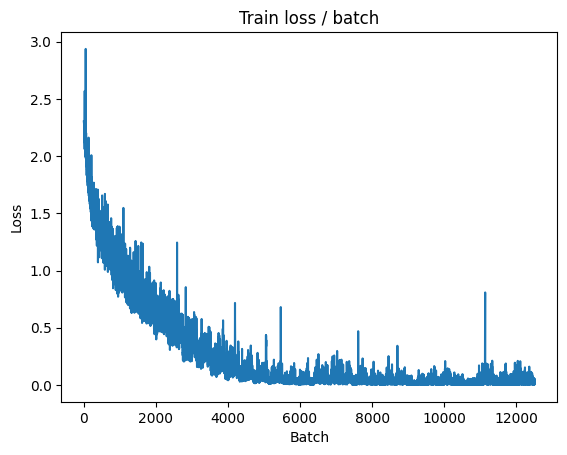

[TRAIN Batch 200/391]	Time 0.029s (0.039s)	Loss 0.0098 (0.0182)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


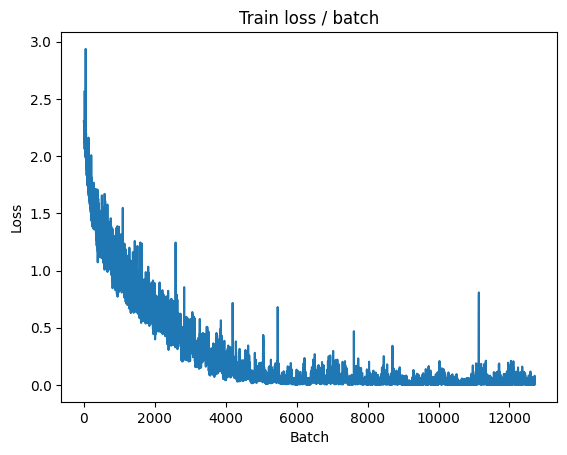


===============> Total time 15s	Avg loss 0.0362	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.155s (0.155s)	Loss 0.0439 (0.0439)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.052s (0.035s)	Loss 0.1134 (0.0401)	Prec@1  95.3 ( 98.6)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0424	Avg Prec@1 98.59 %	Avg Prec@5 100.00 %



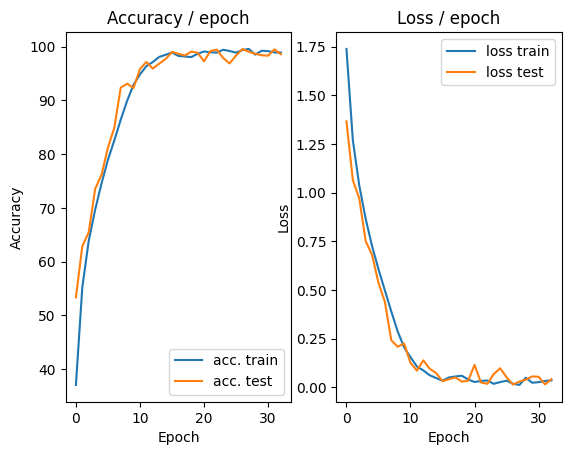

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.0494 (0.0494)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


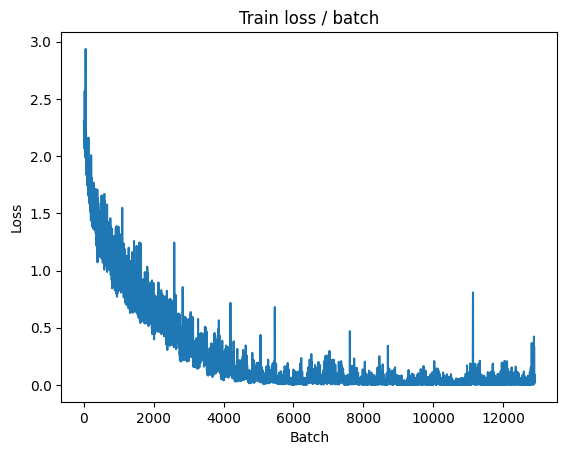

[TRAIN Batch 200/391]	Time 0.055s (0.040s)	Loss 0.0366 (0.0430)	Prec@1  98.4 ( 98.7)	Prec@5 100.0 (100.0)


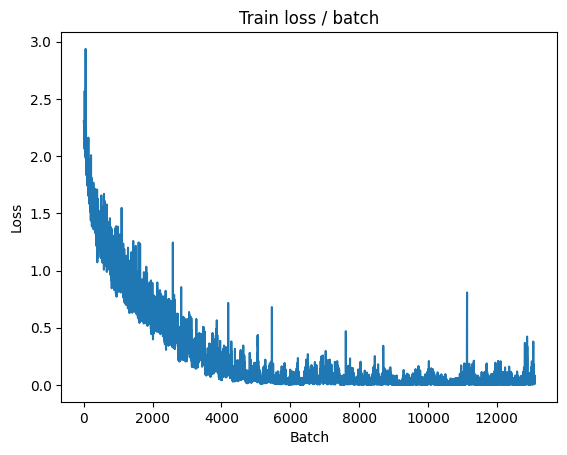


===============> Total time 14s	Avg loss 0.0352	Avg Prec@1 98.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.151s (0.151s)	Loss 0.0133 (0.0133)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.059s (0.035s)	Loss 0.0076 (0.0129)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0133	Avg Prec@1 99.63 %	Avg Prec@5 100.00 %



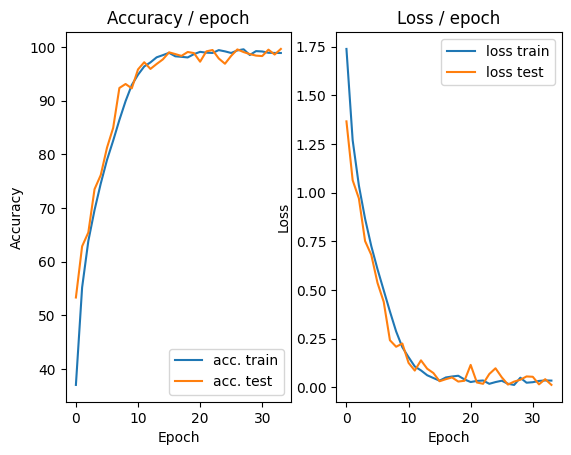

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.285s (0.285s)	Loss 0.0259 (0.0259)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


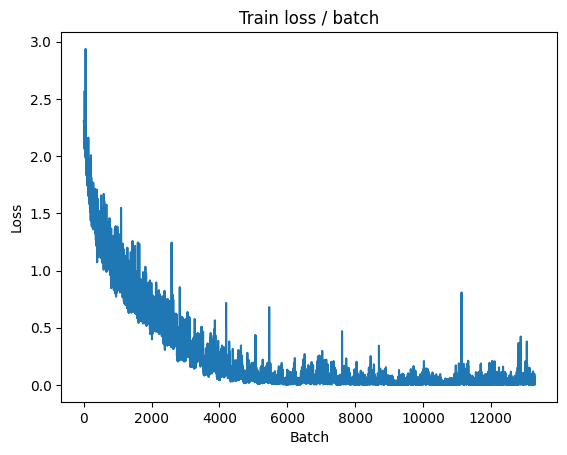

[TRAIN Batch 200/391]	Time 0.050s (0.038s)	Loss 0.0009 (0.0128)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


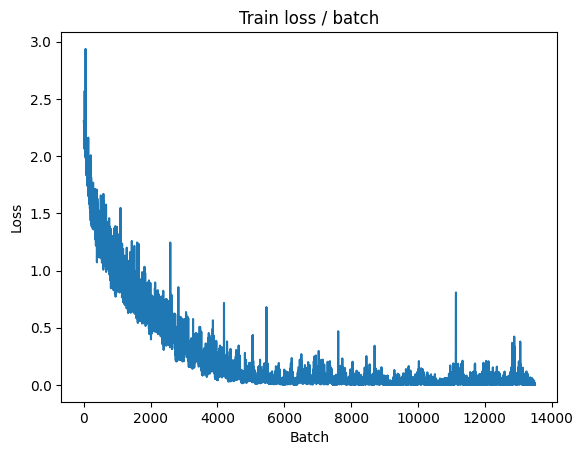


===============> Total time 15s	Avg loss 0.0123	Avg Prec@1 99.59 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.220s (0.220s)	Loss 0.0018 (0.0018)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.053s (0.031s)	Loss 0.0037 (0.0059)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0064	Avg Prec@1 99.81 %	Avg Prec@5 100.00 %



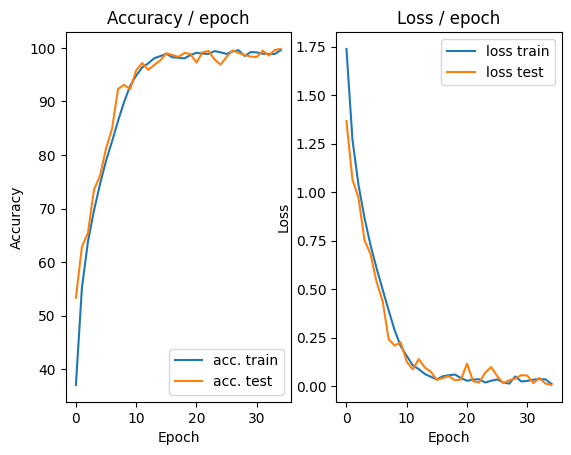

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.328s (0.328s)	Loss 0.0013 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


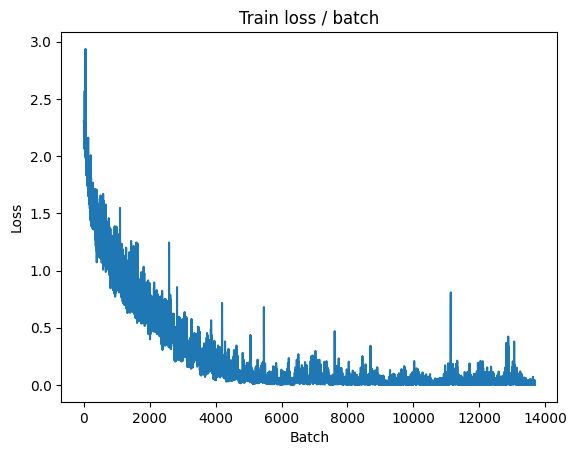

[TRAIN Batch 200/391]	Time 0.044s (0.035s)	Loss 0.0056 (0.0070)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


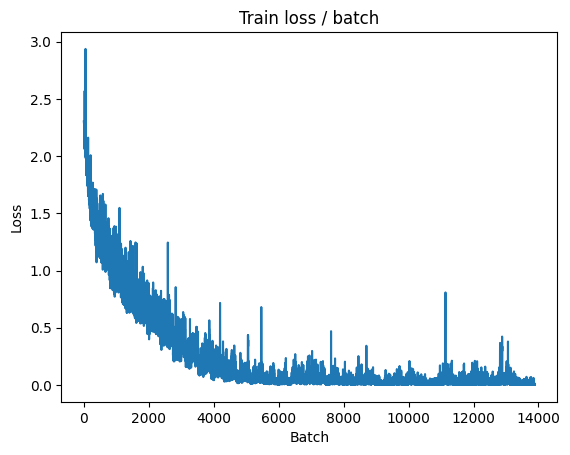


===============> Total time 14s	Avg loss 0.0071	Avg Prec@1 99.78 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0065 (0.0065)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.030s)	Loss 0.0029 (0.0037)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0040	Avg Prec@1 99.87 %	Avg Prec@5 100.00 %



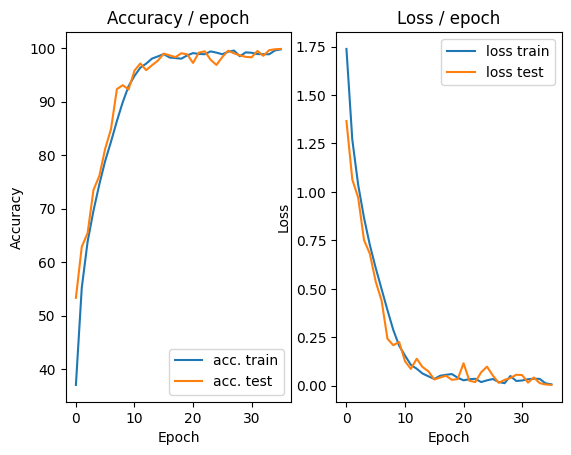

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


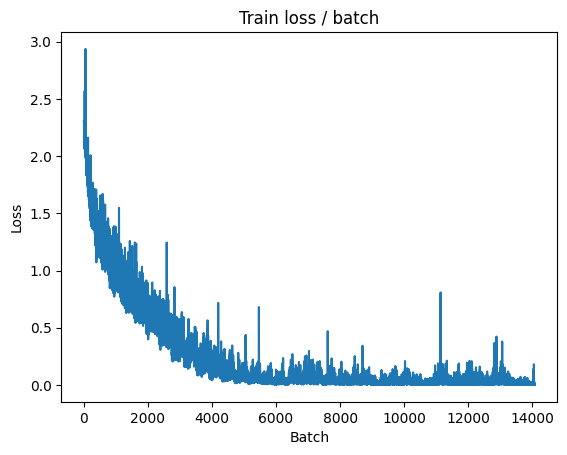

[TRAIN Batch 200/391]	Time 0.044s (0.034s)	Loss 0.0010 (0.0115)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


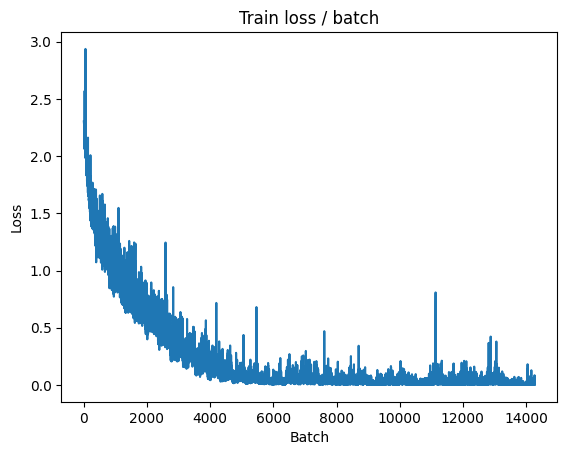


===============> Total time 14s	Avg loss 0.0108	Avg Prec@1 99.67 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.222s (0.222s)	Loss 0.0143 (0.0143)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.009s (0.031s)	Loss 0.0051 (0.0723)	Prec@1 100.0 ( 98.2)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0744	Avg Prec@1 98.11 %	Avg Prec@5 100.00 %



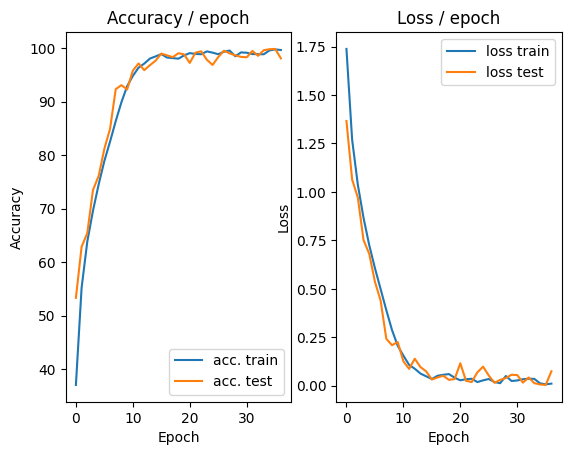

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.0560 (0.0560)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


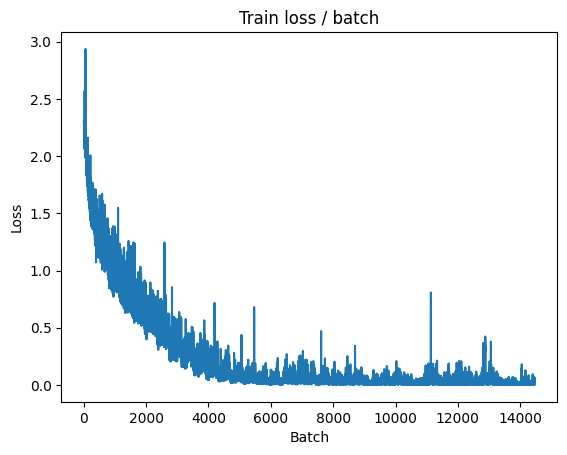

[TRAIN Batch 200/391]	Time 0.095s (0.034s)	Loss 0.0022 (0.0057)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)


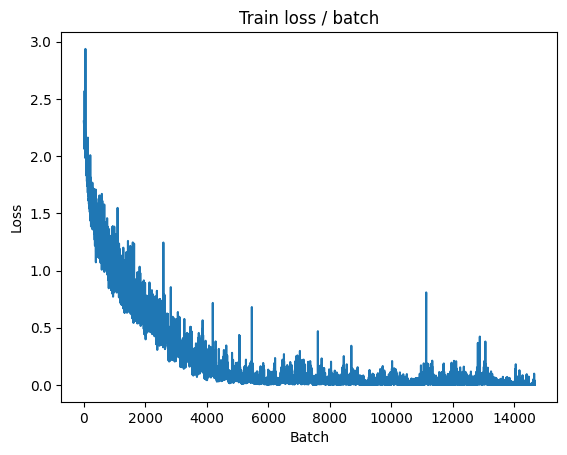


===============> Total time 13s	Avg loss 0.0047	Avg Prec@1 99.87 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.160s (0.160s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.077s (0.031s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0009	Avg Prec@1 99.98 %	Avg Prec@5 100.00 %



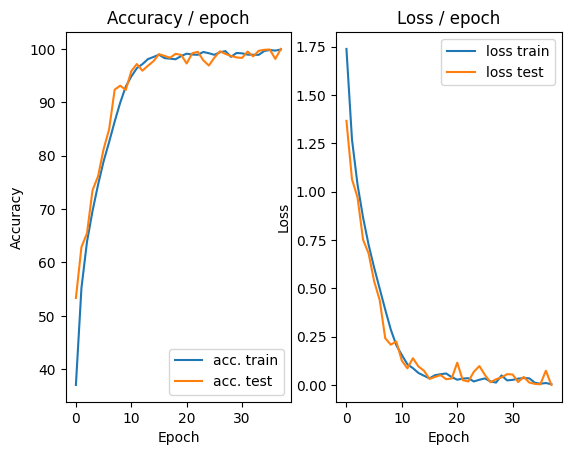

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


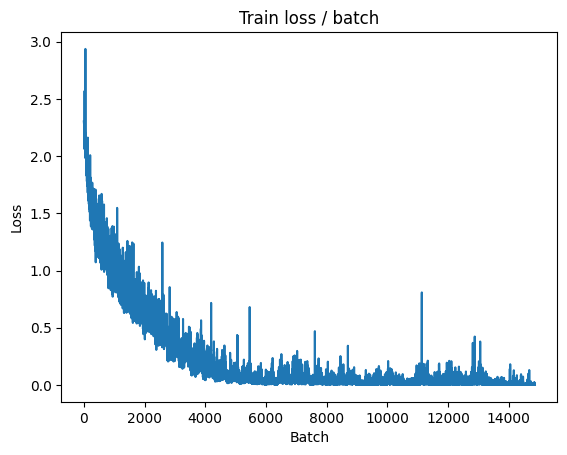

[TRAIN Batch 200/391]	Time 0.037s (0.040s)	Loss 0.0001 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


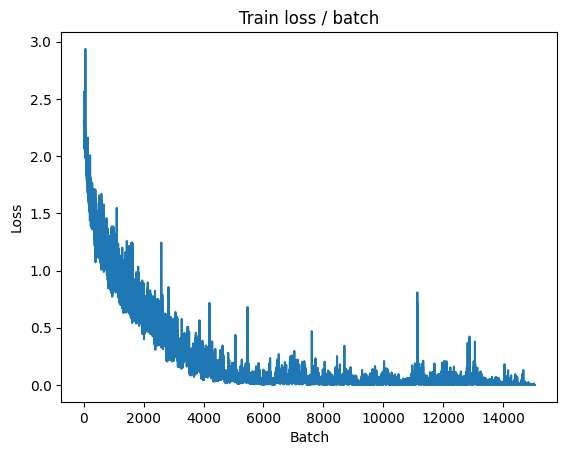


===============> Total time 15s	Avg loss 0.0007	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.056s (0.041s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



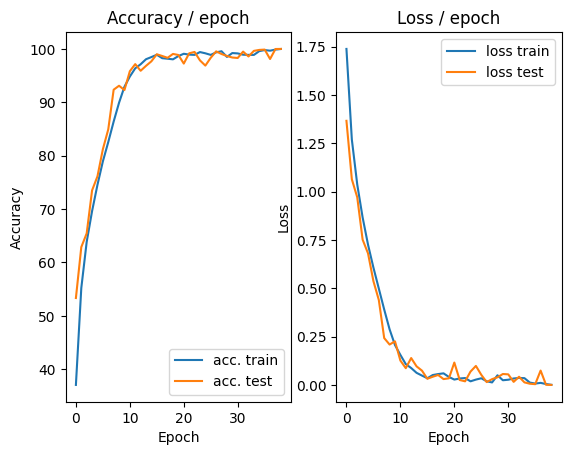

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.230s (0.230s)	Loss 0.0000 (0.0000)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


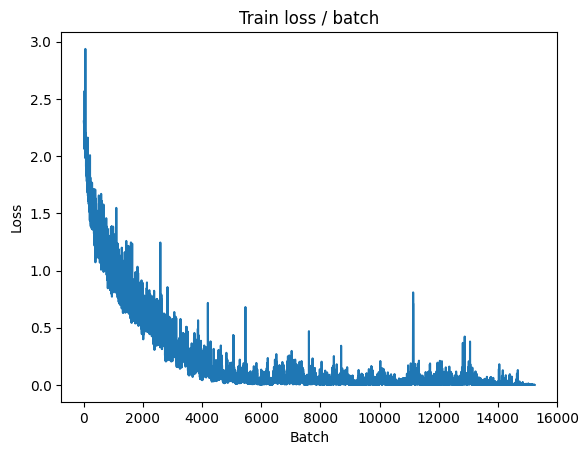

[TRAIN Batch 200/391]	Time 0.014s (0.038s)	Loss 0.0002 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


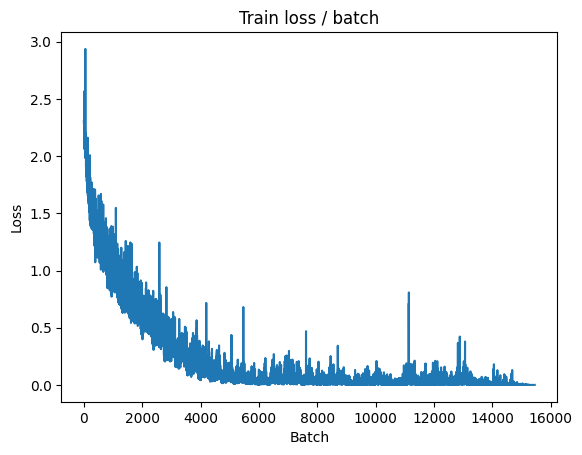


===============> Total time 14s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.258s (0.258s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.053s (0.034s)	Loss 0.0001 (0.0001)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0001	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



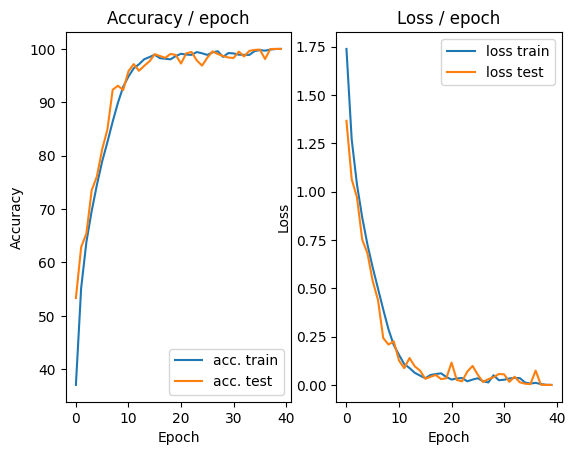

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True, get_dataset=get_dataset_normalized)

In [ ]:
def get_dataset_increased(batch_size, cuda=False):
    """
    This function loads the dataset and increase the data
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,transform=
        transforms.Compose([
            transforms.ToTensor(),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip()
        ]))


    val_dataset = datasets.CIFAR10(PATH, train=True, download=True,transform=
        transforms.Compose([
            transforms.ToTensor(),
            transforms.CenterCrop(28)

        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.455s (0.455s)	Loss 2.3023 (2.3023)	Prec@1  14.1 ( 14.1)	Prec@5  49.2 ( 49.2)


<Figure size 640x480 with 0 Axes>

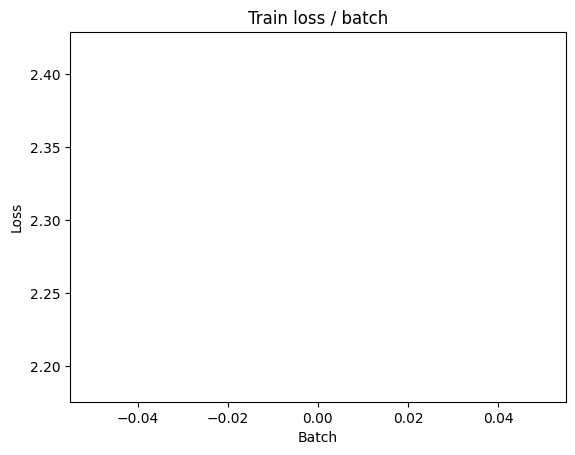

[TRAIN Batch 200/391]	Time 0.008s (0.040s)	Loss 2.2252 (2.2764)	Prec@1  14.1 ( 12.5)	Prec@5  64.8 ( 57.3)


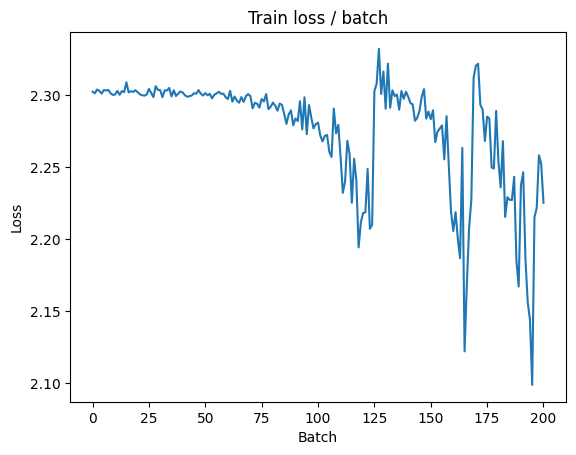


===============> Total time 14s	Avg loss 2.1878	Avg Prec@1 17.81 %	Avg Prec@5 65.21 %

[EVAL Batch 000/391]	Time 0.126s (0.126s)	Loss 2.0918 (2.0918)	Prec@1  27.3 ( 27.3)	Prec@5  72.7 ( 72.7)
[EVAL Batch 200/391]	Time 0.040s (0.029s)	Loss 2.0793 (2.0890)	Prec@1  21.9 ( 24.7)	Prec@5  74.2 ( 73.6)

===============> Total time 10s	Avg loss 2.0873	Avg Prec@1 24.61 %	Avg Prec@5 73.56 %



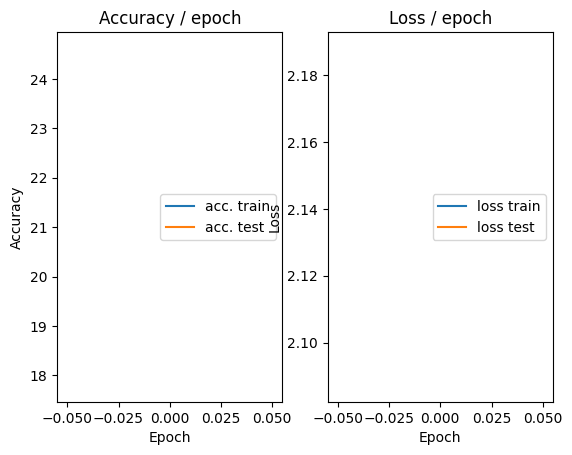

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 2.0871 (2.0871)	Prec@1  21.1 ( 21.1)	Prec@5  77.3 ( 77.3)


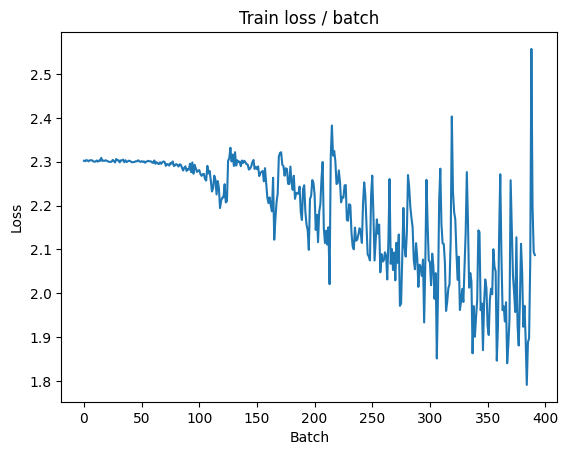

[TRAIN Batch 200/391]	Time 0.047s (0.039s)	Loss 1.8390 (1.8918)	Prec@1  34.4 ( 31.6)	Prec@5  80.5 ( 82.7)


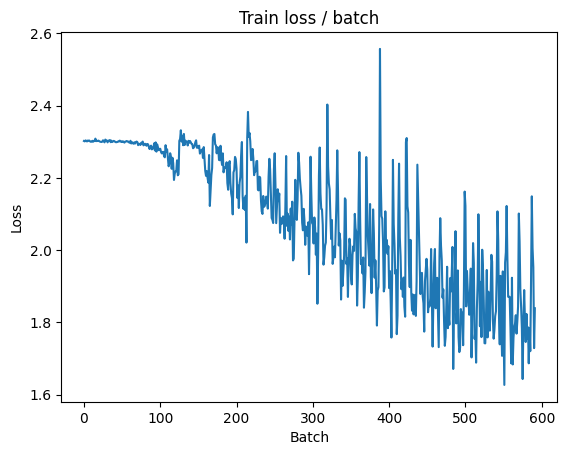


===============> Total time 14s	Avg loss 1.8179	Avg Prec@1 34.10 %	Avg Prec@5 84.84 %

[EVAL Batch 000/391]	Time 0.191s (0.191s)	Loss 1.5166 (1.5166)	Prec@1  40.6 ( 40.6)	Prec@5  91.4 ( 91.4)
[EVAL Batch 200/391]	Time 0.003s (0.036s)	Loss 1.5661 (1.6017)	Prec@1  42.2 ( 41.3)	Prec@5  89.1 ( 89.8)

===============> Total time 11s	Avg loss 1.6027	Avg Prec@1 41.33 %	Avg Prec@5 89.81 %



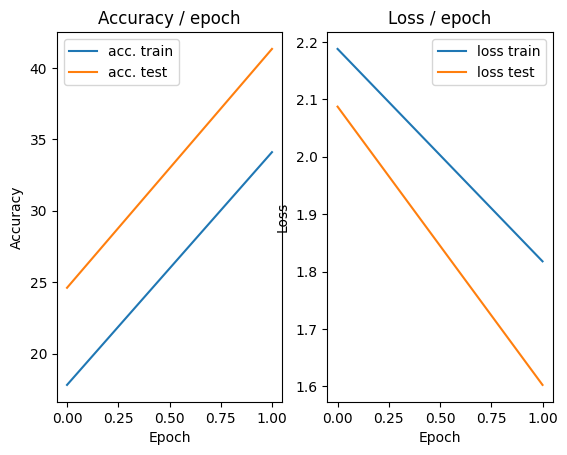

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 1.5857 (1.5857)	Prec@1  43.0 ( 43.0)	Prec@5  92.2 ( 92.2)


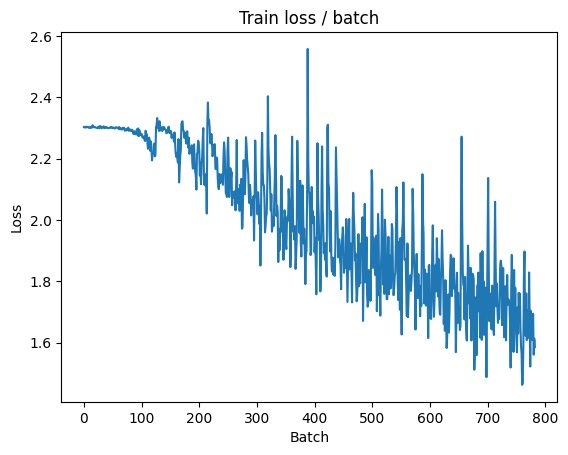

[TRAIN Batch 200/391]	Time 0.013s (0.040s)	Loss 1.7858 (1.6077)	Prec@1  34.4 ( 41.7)	Prec@5  85.2 ( 89.7)


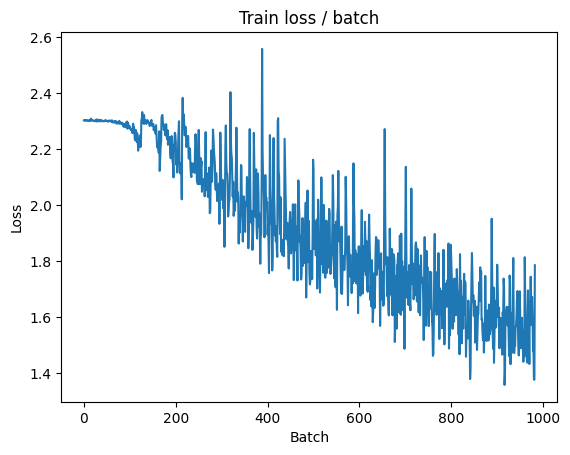


===============> Total time 14s	Avg loss 1.5705	Avg Prec@1 42.97 %	Avg Prec@5 90.39 %

[EVAL Batch 000/391]	Time 0.246s (0.246s)	Loss 1.6710 (1.6710)	Prec@1  37.5 ( 37.5)	Prec@5  88.3 ( 88.3)
[EVAL Batch 200/391]	Time 0.024s (0.028s)	Loss 1.6676 (1.6140)	Prec@1  42.2 ( 42.6)	Prec@5  86.7 ( 88.9)

===============> Total time 10s	Avg loss 1.6216	Avg Prec@1 42.11 %	Avg Prec@5 88.70 %



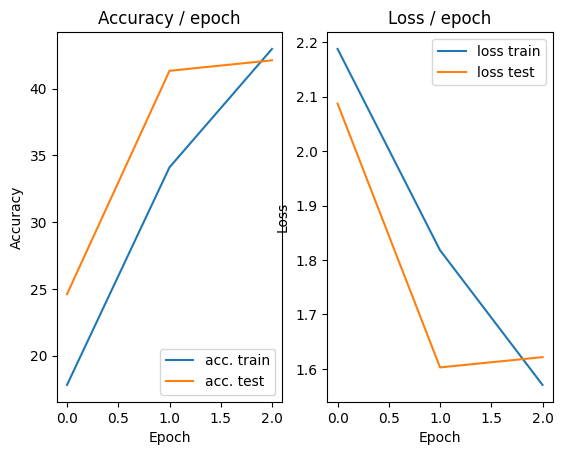

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 1.6269 (1.6269)	Prec@1  39.8 ( 39.8)	Prec@5  92.2 ( 92.2)


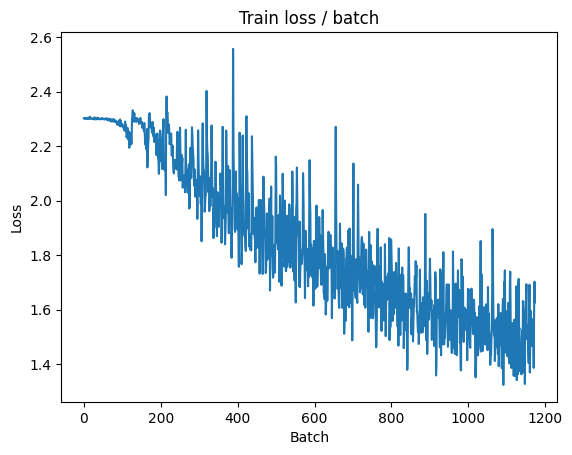

[TRAIN Batch 200/391]	Time 0.044s (0.044s)	Loss 1.4991 (1.4650)	Prec@1  46.9 ( 47.0)	Prec@5  93.8 ( 92.0)


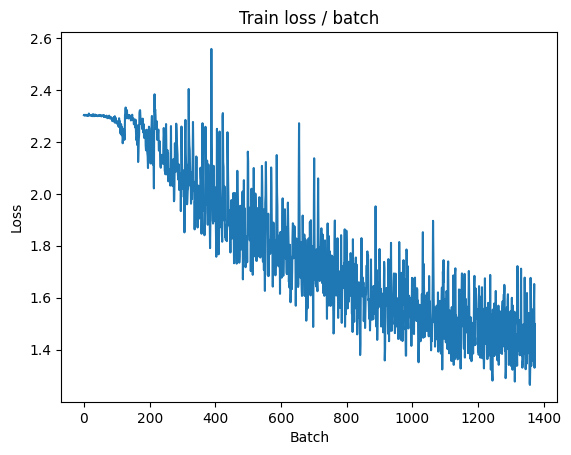


===============> Total time 15s	Avg loss 1.4311	Avg Prec@1 48.49 %	Avg Prec@5 92.46 %

[EVAL Batch 000/391]	Time 0.257s (0.257s)	Loss 1.4012 (1.4012)	Prec@1  50.0 ( 50.0)	Prec@5  95.3 ( 95.3)
[EVAL Batch 200/391]	Time 0.017s (0.029s)	Loss 1.3887 (1.3958)	Prec@1  43.8 ( 48.9)	Prec@5  92.2 ( 93.6)

===============> Total time 10s	Avg loss 1.3988	Avg Prec@1 48.70 %	Avg Prec@5 93.65 %



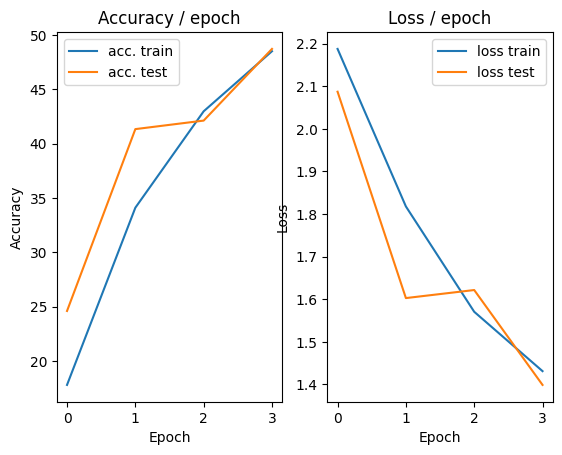

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.2513 (1.2513)	Prec@1  56.2 ( 56.2)	Prec@5  91.4 ( 91.4)


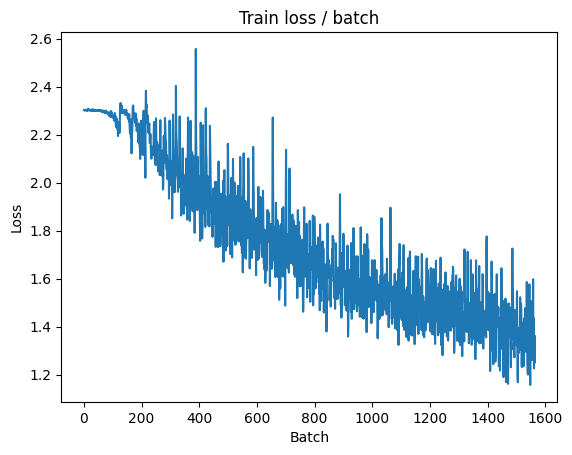

[TRAIN Batch 200/391]	Time 0.046s (0.039s)	Loss 1.1598 (1.3354)	Prec@1  60.2 ( 52.4)	Prec@5  95.3 ( 93.6)


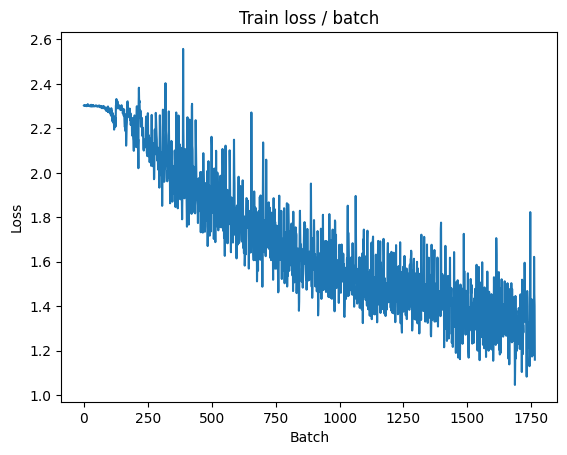


===============> Total time 14s	Avg loss 1.3164	Avg Prec@1 52.89 %	Avg Prec@5 93.93 %

[EVAL Batch 000/391]	Time 0.220s (0.220s)	Loss 1.1607 (1.1607)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)
[EVAL Batch 200/391]	Time 0.044s (0.026s)	Loss 1.2466 (1.2079)	Prec@1  57.0 ( 56.7)	Prec@5  93.8 ( 95.4)

===============> Total time 9s	Avg loss 1.2105	Avg Prec@1 56.63 %	Avg Prec@5 95.34 %



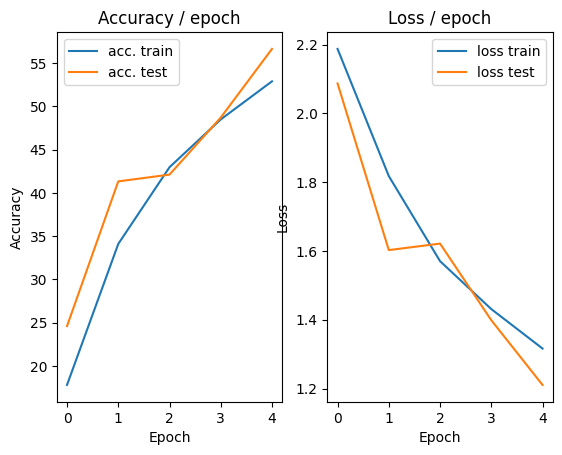

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 1.2015 (1.2015)	Prec@1  51.6 ( 51.6)	Prec@5  94.5 ( 94.5)


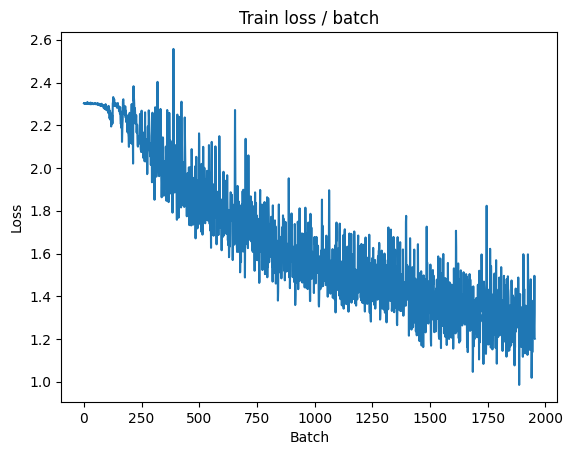

[TRAIN Batch 200/391]	Time 0.021s (0.039s)	Loss 1.2193 (1.2319)	Prec@1  50.0 ( 56.0)	Prec@5  95.3 ( 94.8)


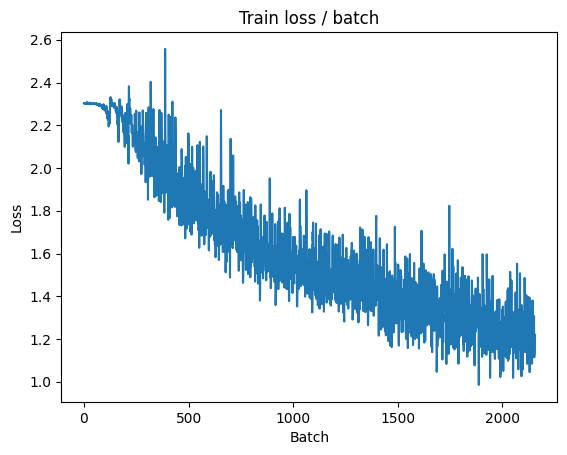


===============> Total time 14s	Avg loss 1.2178	Avg Prec@1 56.60 %	Avg Prec@5 94.98 %

[EVAL Batch 000/391]	Time 0.210s (0.210s)	Loss 1.0837 (1.0837)	Prec@1  54.7 ( 54.7)	Prec@5  97.7 ( 97.7)
[EVAL Batch 200/391]	Time 0.016s (0.031s)	Loss 1.1045 (1.1383)	Prec@1  59.4 ( 58.5)	Prec@5  95.3 ( 96.3)

===============> Total time 10s	Avg loss 1.1390	Avg Prec@1 58.65 %	Avg Prec@5 96.20 %



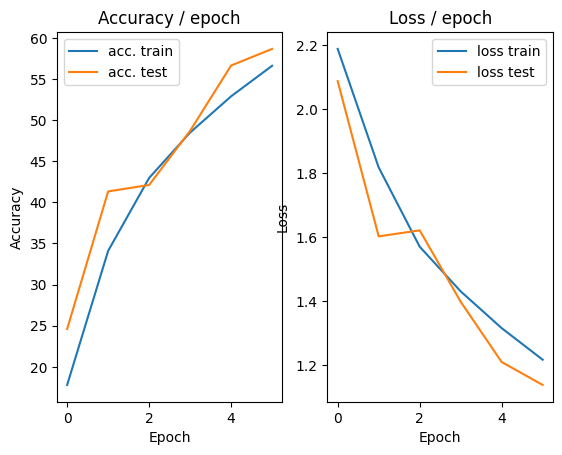

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 1.1740 (1.1740)	Prec@1  56.2 ( 56.2)	Prec@5  96.9 ( 96.9)


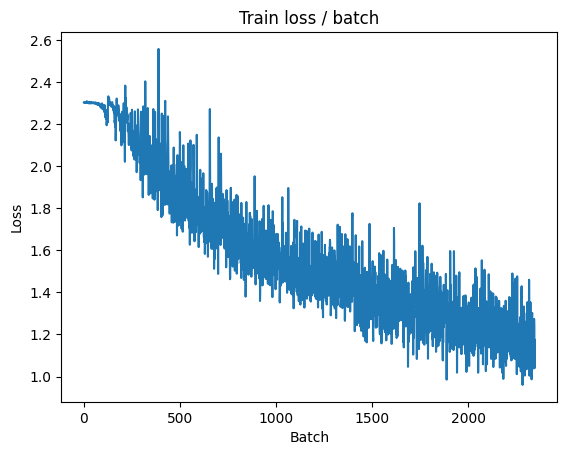

[TRAIN Batch 200/391]	Time 0.009s (0.038s)	Loss 0.9585 (1.1424)	Prec@1  71.1 ( 59.9)	Prec@5  96.9 ( 95.6)


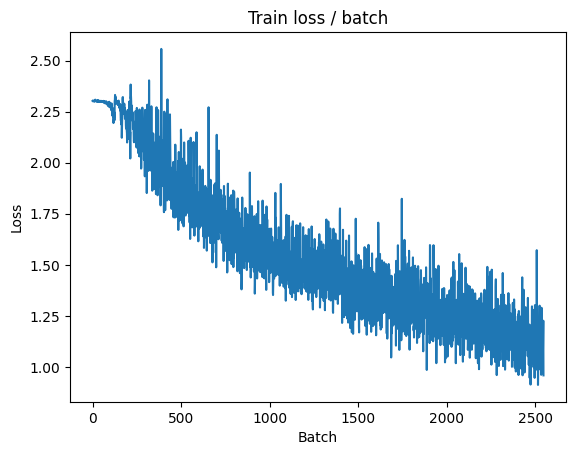


===============> Total time 14s	Avg loss 1.1243	Avg Prec@1 60.51 %	Avg Prec@5 95.66 %

[EVAL Batch 000/391]	Time 0.212s (0.212s)	Loss 0.8634 (0.8634)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/391]	Time 0.005s (0.024s)	Loss 1.0349 (0.9785)	Prec@1  61.7 ( 65.5)	Prec@5  95.3 ( 96.9)

===============> Total time 9s	Avg loss 0.9829	Avg Prec@1 65.27 %	Avg Prec@5 96.89 %



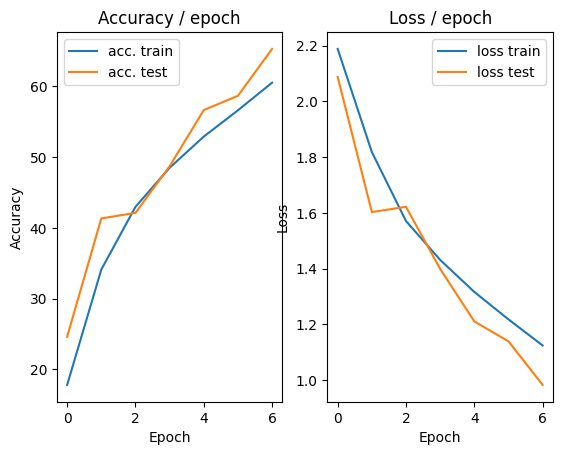

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 1.0887 (1.0887)	Prec@1  59.4 ( 59.4)	Prec@5  93.8 ( 93.8)


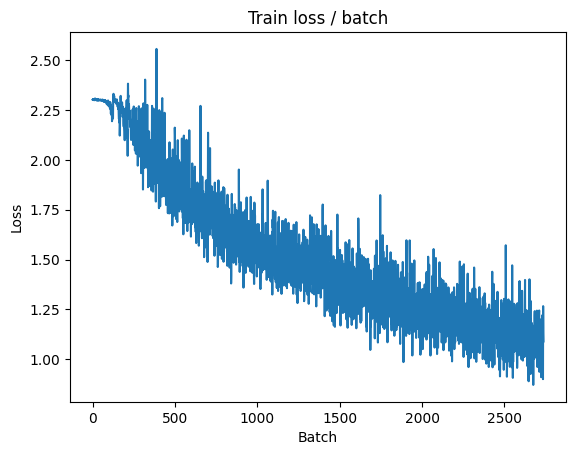

[TRAIN Batch 200/391]	Time 0.012s (0.039s)	Loss 1.0029 (1.0506)	Prec@1  61.7 ( 62.7)	Prec@5  98.4 ( 96.4)


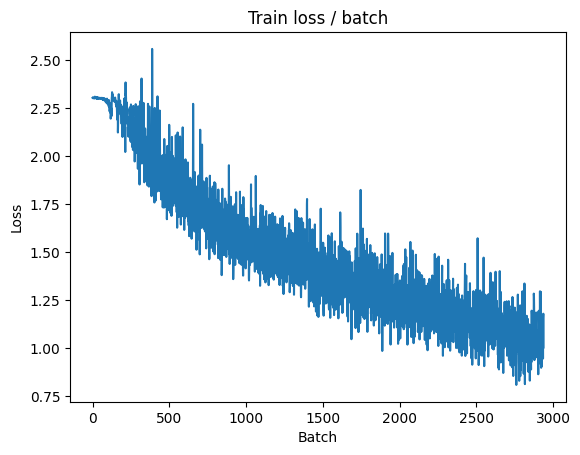


===============> Total time 14s	Avg loss 1.0379	Avg Prec@1 63.21 %	Avg Prec@5 96.49 %

[EVAL Batch 000/391]	Time 0.219s (0.219s)	Loss 0.9770 (0.9770)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/391]	Time 0.038s (0.025s)	Loss 0.9185 (1.0157)	Prec@1  68.8 ( 64.0)	Prec@5  95.3 ( 97.1)

===============> Total time 10s	Avg loss 1.0159	Avg Prec@1 64.04 %	Avg Prec@5 97.13 %



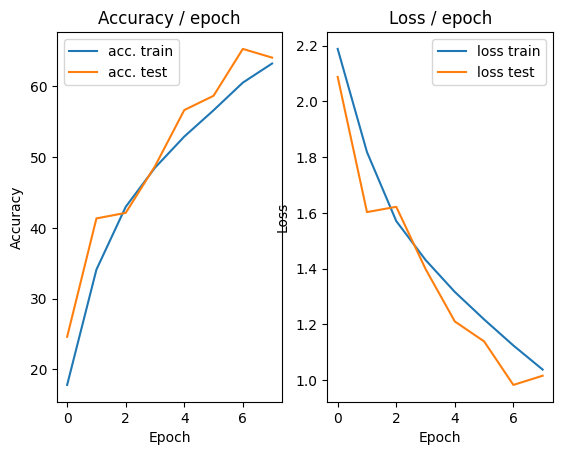

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 1.0630 (1.0630)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)


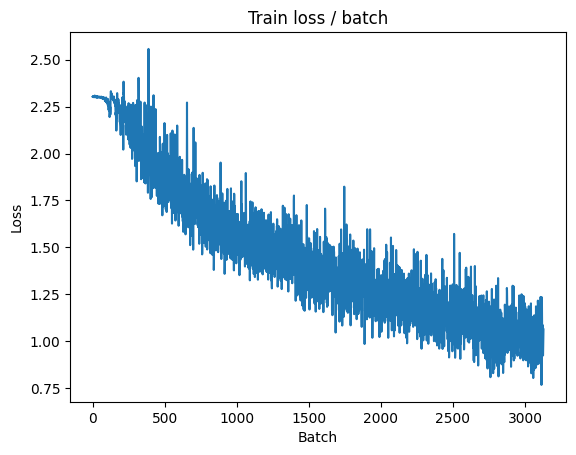

[TRAIN Batch 200/391]	Time 0.061s (0.039s)	Loss 0.9386 (0.9669)	Prec@1  67.2 ( 66.0)	Prec@5  98.4 ( 96.9)


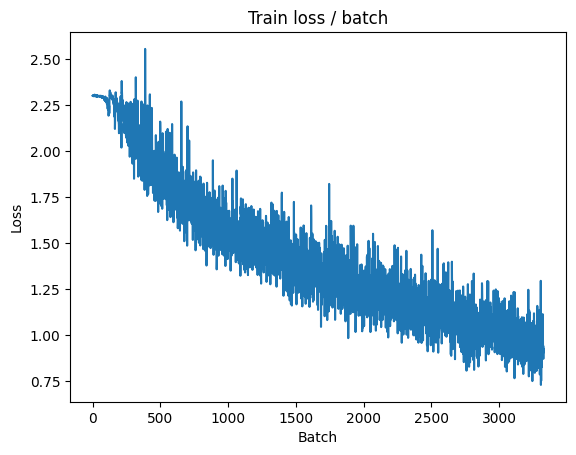


===============> Total time 15s	Avg loss 0.9659	Avg Prec@1 65.99 %	Avg Prec@5 96.94 %

[EVAL Batch 000/391]	Time 0.143s (0.143s)	Loss 1.0868 (1.0868)	Prec@1  57.8 ( 57.8)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/391]	Time 0.039s (0.024s)	Loss 1.1213 (1.1090)	Prec@1  57.0 ( 60.2)	Prec@5  96.1 ( 96.1)

===============> Total time 9s	Avg loss 1.1123	Avg Prec@1 60.02 %	Avg Prec@5 96.06 %



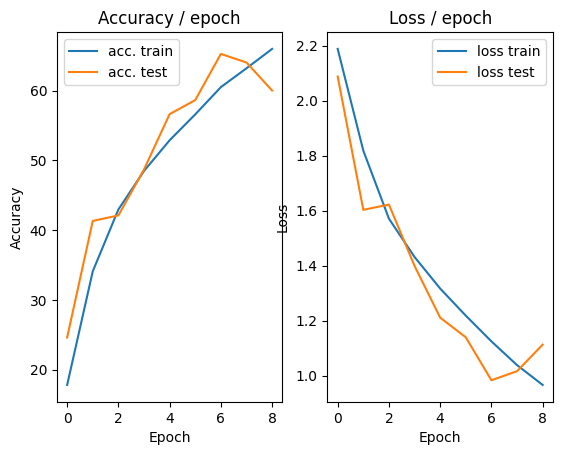

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 1.2364 (1.2364)	Prec@1  54.7 ( 54.7)	Prec@5  95.3 ( 95.3)


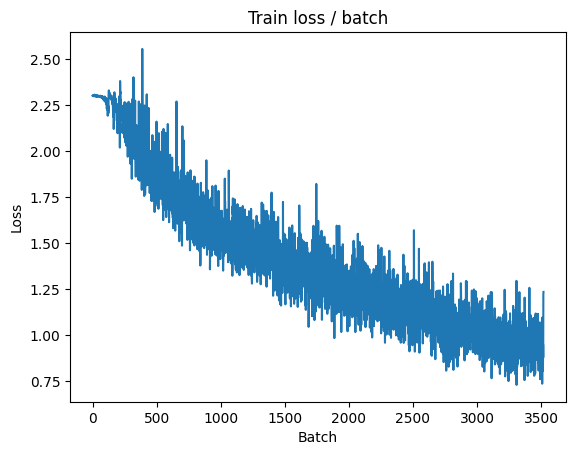

[TRAIN Batch 200/391]	Time 0.014s (0.037s)	Loss 1.1079 (0.9148)	Prec@1  64.8 ( 67.6)	Prec@5  96.9 ( 97.3)


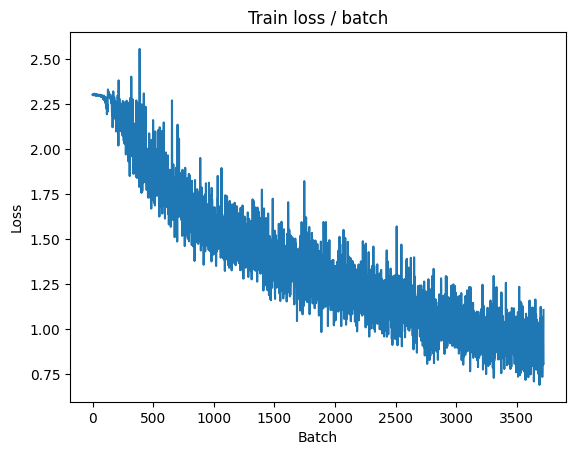


===============> Total time 15s	Avg loss 0.9036	Avg Prec@1 68.12 %	Avg Prec@5 97.36 %

[EVAL Batch 000/391]	Time 0.138s (0.138s)	Loss 0.8608 (0.8608)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)
[EVAL Batch 200/391]	Time 0.012s (0.024s)	Loss 0.9021 (0.8627)	Prec@1  71.9 ( 69.6)	Prec@5  94.5 ( 97.4)

===============> Total time 10s	Avg loss 0.8648	Avg Prec@1 69.55 %	Avg Prec@5 97.43 %



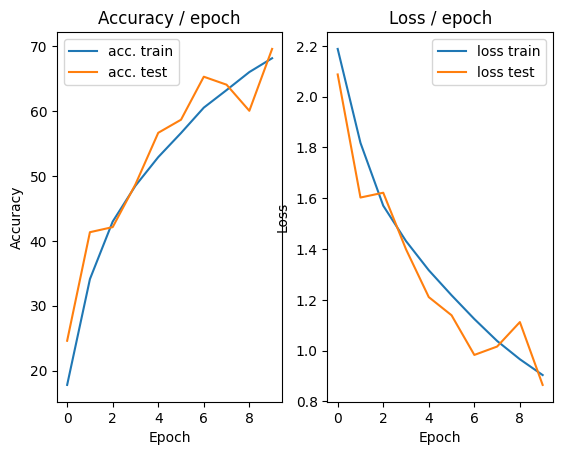

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 0.9687 (0.9687)	Prec@1  61.7 ( 61.7)	Prec@5  97.7 ( 97.7)


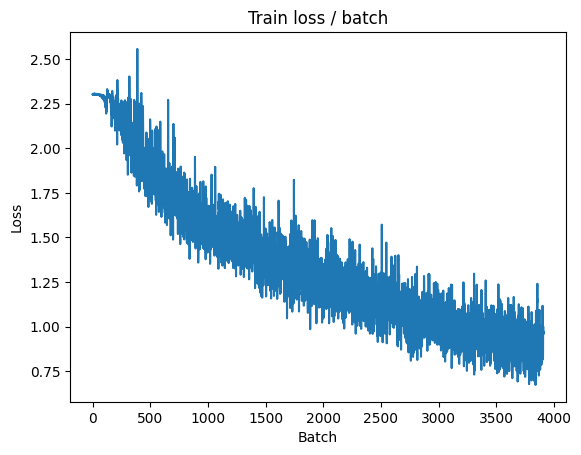

[TRAIN Batch 200/391]	Time 0.061s (0.035s)	Loss 0.8531 (0.8517)	Prec@1  68.0 ( 70.2)	Prec@5  96.9 ( 97.8)


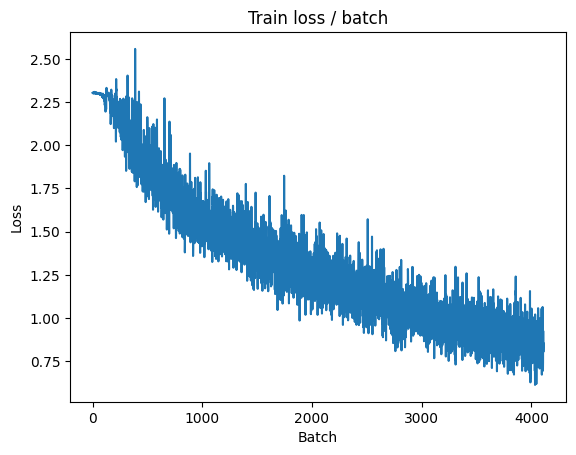


===============> Total time 14s	Avg loss 0.8569	Avg Prec@1 70.07 %	Avg Prec@5 97.67 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.6711 (0.6711)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.042s (0.024s)	Loss 0.7441 (0.8121)	Prec@1  71.9 ( 71.2)	Prec@5  96.1 ( 98.0)

===============> Total time 9s	Avg loss 0.8121	Avg Prec@1 71.23 %	Avg Prec@5 97.95 %



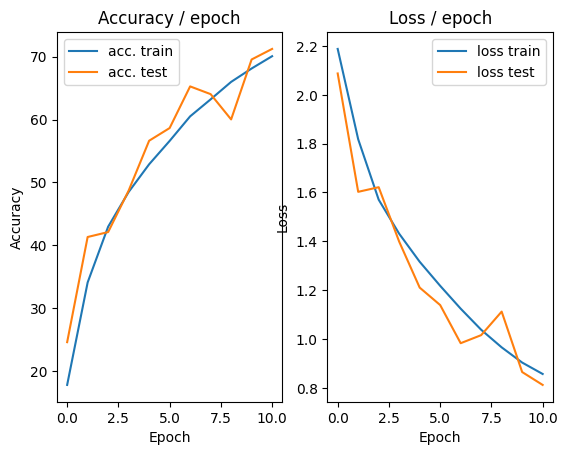

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.305s (0.305s)	Loss 0.7925 (0.7925)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


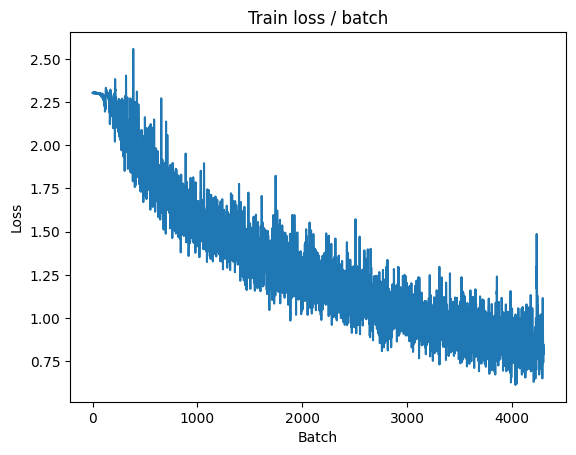

[TRAIN Batch 200/391]	Time 0.051s (0.036s)	Loss 0.8284 (0.8126)	Prec@1  67.2 ( 71.3)	Prec@5  99.2 ( 97.8)


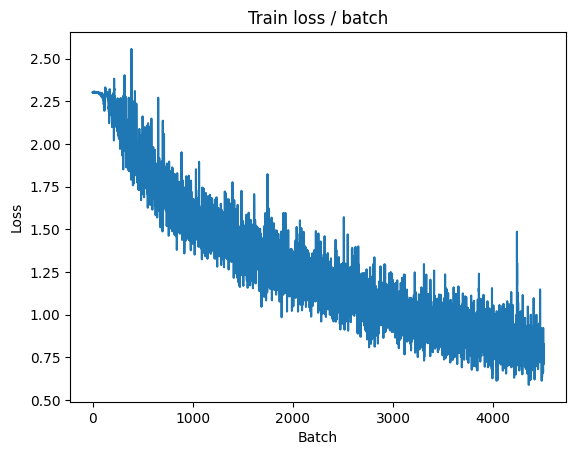


===============> Total time 14s	Avg loss 0.8079	Avg Prec@1 71.71 %	Avg Prec@5 97.89 %

[EVAL Batch 000/391]	Time 0.131s (0.131s)	Loss 0.5962 (0.5962)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.003s (0.024s)	Loss 0.6508 (0.6971)	Prec@1  78.1 ( 75.1)	Prec@5  99.2 ( 98.6)

===============> Total time 9s	Avg loss 0.6962	Avg Prec@1 75.18 %	Avg Prec@5 98.63 %



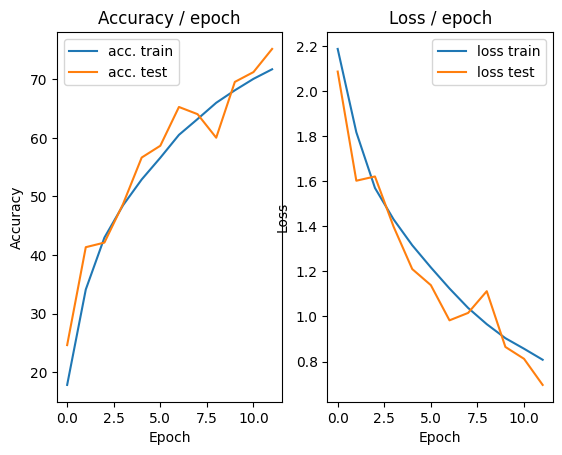

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.8391 (0.8391)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)


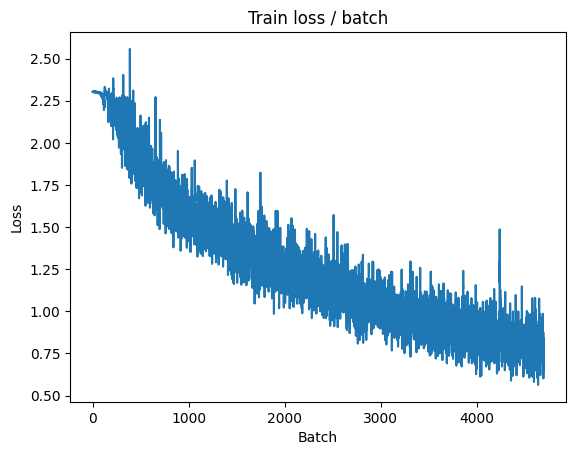

[TRAIN Batch 200/391]	Time 0.060s (0.042s)	Loss 0.6445 (0.7569)	Prec@1  76.6 ( 73.4)	Prec@5  98.4 ( 98.3)


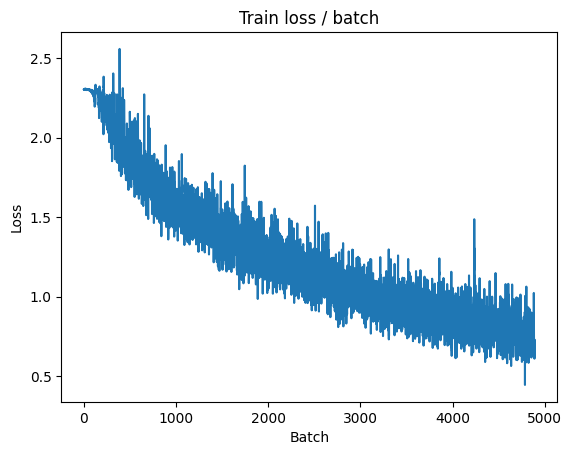


===============> Total time 15s	Avg loss 0.7574	Avg Prec@1 73.46 %	Avg Prec@5 98.26 %

[EVAL Batch 000/391]	Time 0.233s (0.233s)	Loss 0.7005 (0.7005)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.047s (0.025s)	Loss 0.7948 (0.7450)	Prec@1  67.2 ( 73.8)	Prec@5  96.9 ( 98.4)

===============> Total time 9s	Avg loss 0.7472	Avg Prec@1 73.81 %	Avg Prec@5 98.36 %



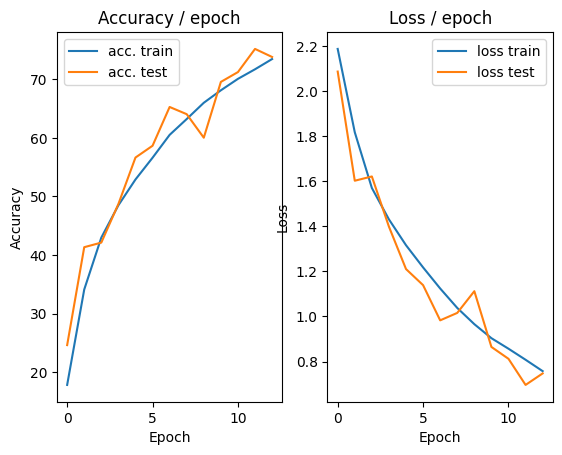

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.9509 (0.9509)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


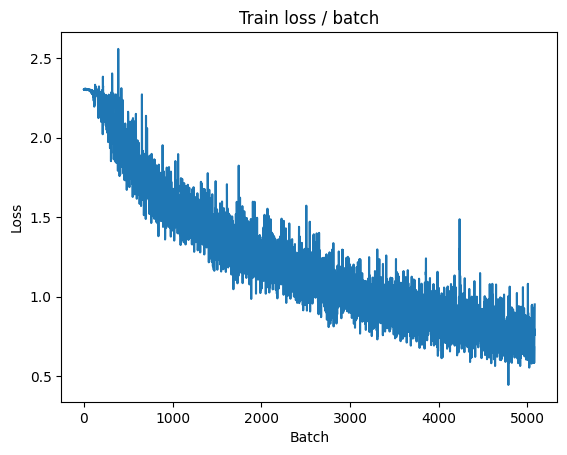

[TRAIN Batch 200/391]	Time 0.015s (0.038s)	Loss 0.5487 (0.7256)	Prec@1  80.5 ( 74.6)	Prec@5 100.0 ( 98.4)


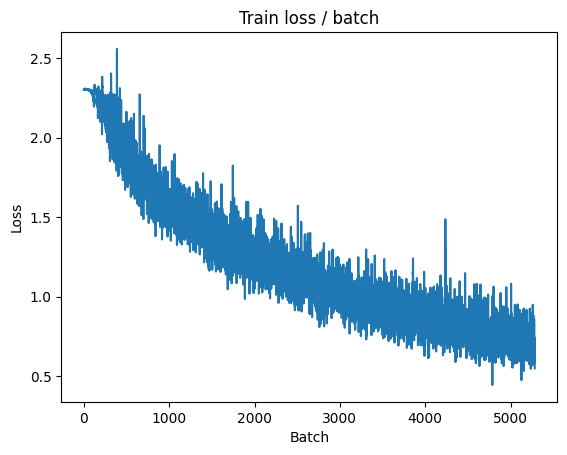


===============> Total time 15s	Avg loss 0.7203	Avg Prec@1 74.66 %	Avg Prec@5 98.40 %

[EVAL Batch 000/391]	Time 0.155s (0.155s)	Loss 0.6663 (0.6663)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.023s (0.024s)	Loss 0.8095 (0.7352)	Prec@1  70.3 ( 73.8)	Prec@5  97.7 ( 98.5)

===============> Total time 9s	Avg loss 0.7364	Avg Prec@1 73.86 %	Avg Prec@5 98.55 %



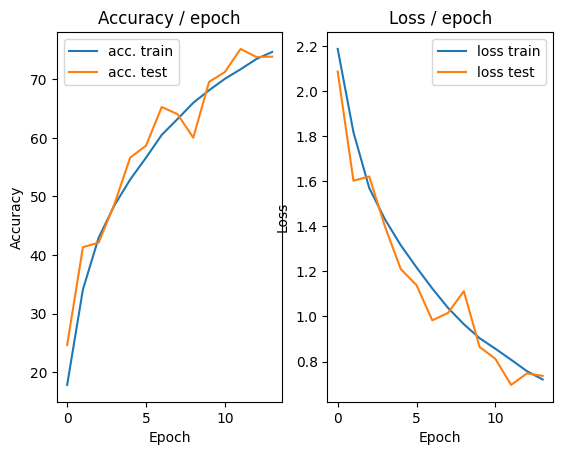

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.8548 (0.8548)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)


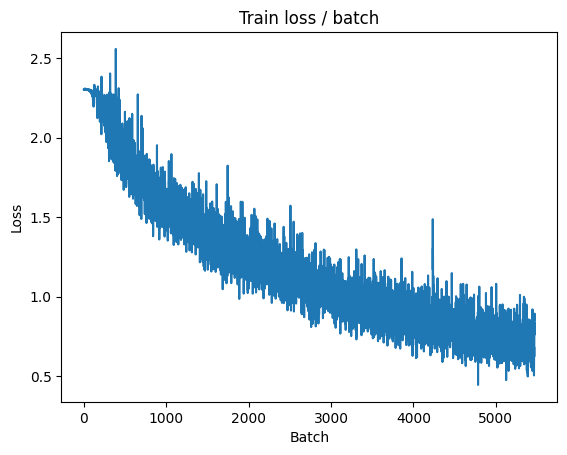

[TRAIN Batch 200/391]	Time 0.039s (0.044s)	Loss 0.7002 (0.6875)	Prec@1  73.4 ( 76.2)	Prec@5 100.0 ( 98.5)


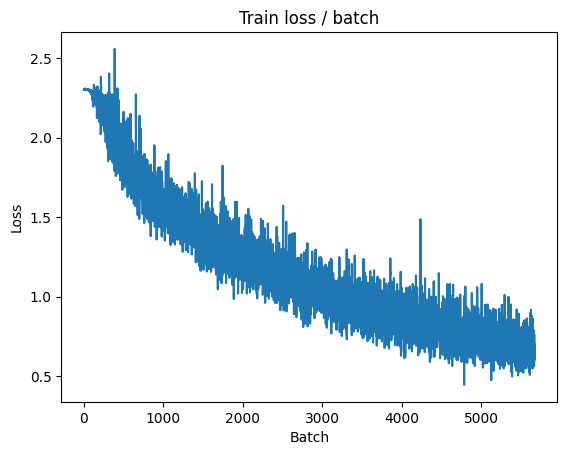


===============> Total time 15s	Avg loss 0.6911	Avg Prec@1 76.11 %	Avg Prec@5 98.50 %

[EVAL Batch 000/391]	Time 0.147s (0.147s)	Loss 0.5586 (0.5586)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)
[EVAL Batch 200/391]	Time 0.046s (0.024s)	Loss 0.5877 (0.5890)	Prec@1  76.6 ( 79.5)	Prec@5  99.2 ( 99.0)

===============> Total time 9s	Avg loss 0.5910	Avg Prec@1 79.47 %	Avg Prec@5 98.98 %



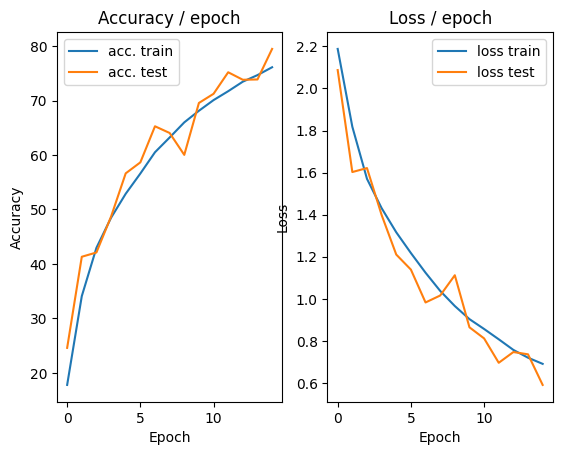

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.6700 (0.6700)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)


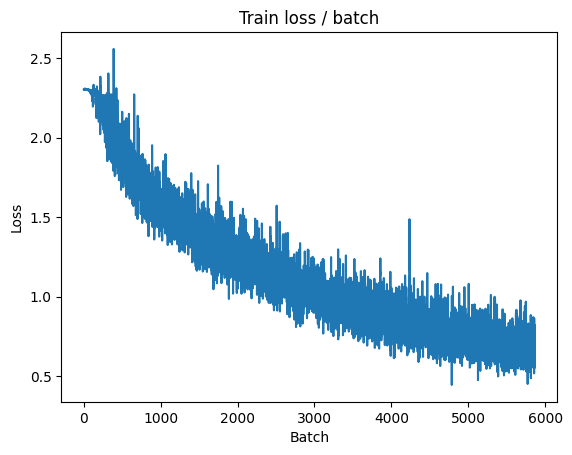

[TRAIN Batch 200/391]	Time 0.008s (0.039s)	Loss 0.7923 (0.6537)	Prec@1  72.7 ( 77.1)	Prec@5  98.4 ( 98.7)


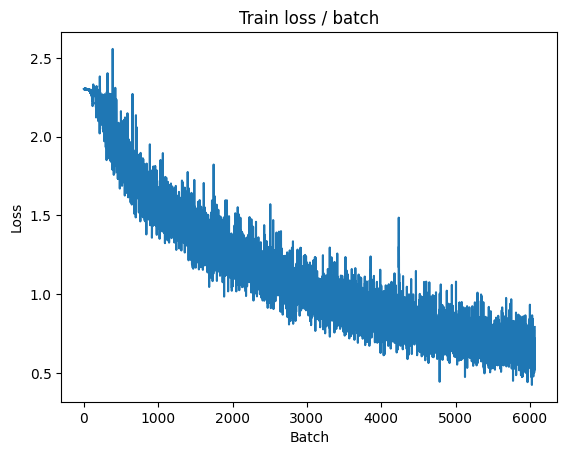


===============> Total time 15s	Avg loss 0.6550	Avg Prec@1 77.11 %	Avg Prec@5 98.68 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 0.5240 (0.5240)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.014s (0.024s)	Loss 0.6172 (0.5825)	Prec@1  74.2 ( 79.8)	Prec@5  99.2 ( 99.0)

===============> Total time 9s	Avg loss 0.5813	Avg Prec@1 79.80 %	Avg Prec@5 99.02 %



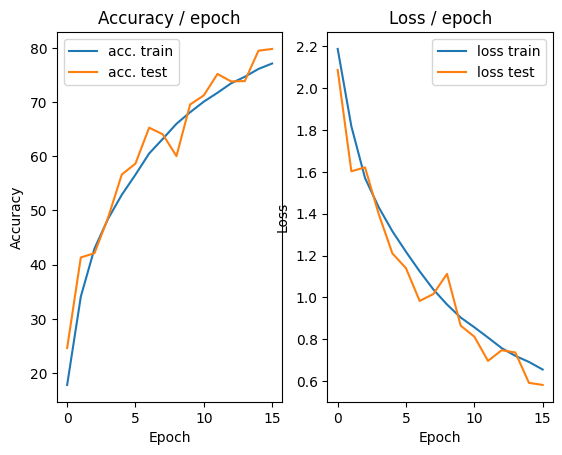

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.6846 (0.6846)	Prec@1  71.9 ( 71.9)	Prec@5 100.0 (100.0)


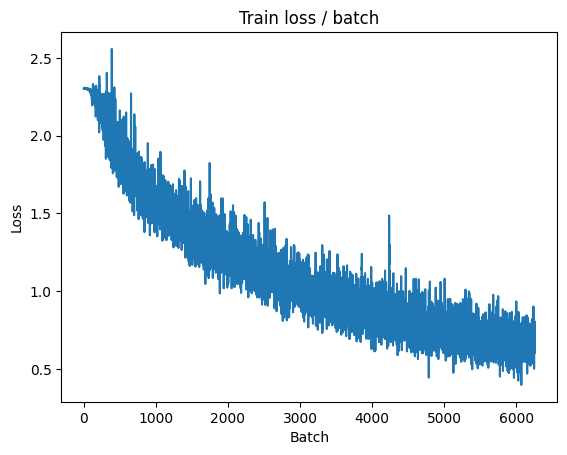

[TRAIN Batch 200/391]	Time 0.047s (0.044s)	Loss 0.5850 (0.6427)	Prec@1  82.8 ( 77.5)	Prec@5  99.2 ( 98.7)


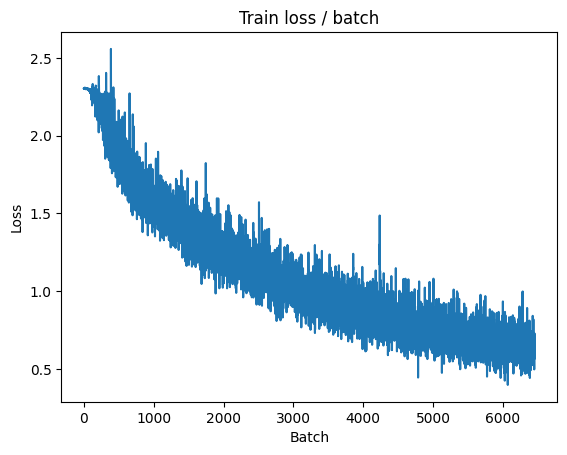


===============> Total time 16s	Avg loss 0.6349	Avg Prec@1 77.67 %	Avg Prec@5 98.76 %

[EVAL Batch 000/391]	Time 0.139s (0.139s)	Loss 0.5173 (0.5173)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.004s (0.024s)	Loss 0.5267 (0.5020)	Prec@1  81.2 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 9s	Avg loss 0.5017	Avg Prec@1 82.90 %	Avg Prec@5 99.27 %



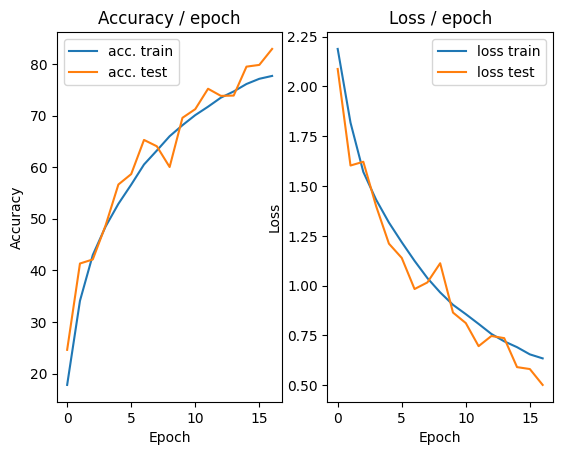

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.5146 (0.5146)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


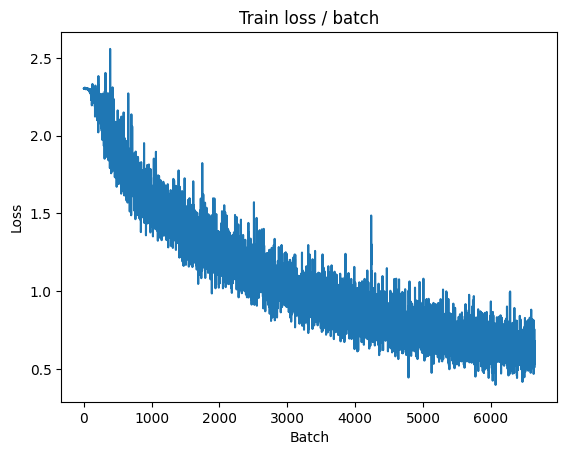

[TRAIN Batch 200/391]	Time 0.016s (0.036s)	Loss 0.5478 (0.6114)	Prec@1  82.0 ( 78.5)	Prec@5  99.2 ( 98.9)


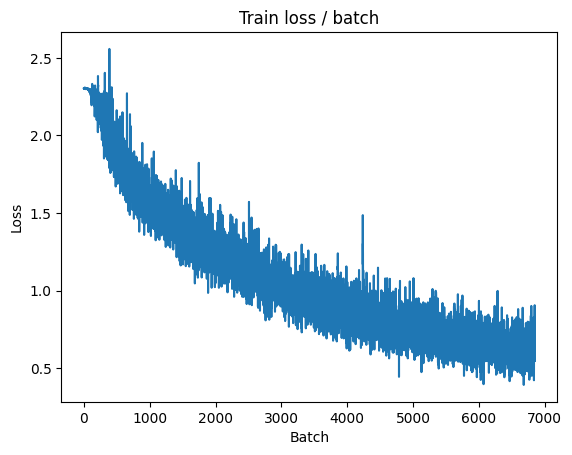


===============> Total time 14s	Avg loss 0.6018	Avg Prec@1 78.90 %	Avg Prec@5 98.96 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 0.4742 (0.4742)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.038s (0.024s)	Loss 0.4912 (0.5114)	Prec@1  81.2 ( 82.0)	Prec@5  99.2 ( 99.3)

===============> Total time 9s	Avg loss 0.5079	Avg Prec@1 82.21 %	Avg Prec@5 99.28 %



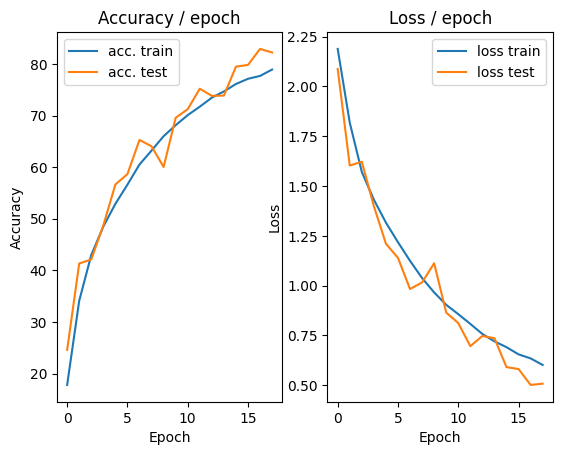

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.6526 (0.6526)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


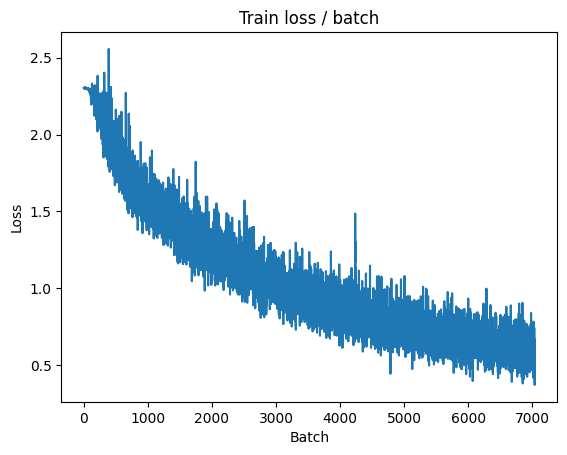

[TRAIN Batch 200/391]	Time 0.014s (0.037s)	Loss 0.5963 (0.5722)	Prec@1  81.2 ( 79.8)	Prec@5  98.4 ( 99.1)


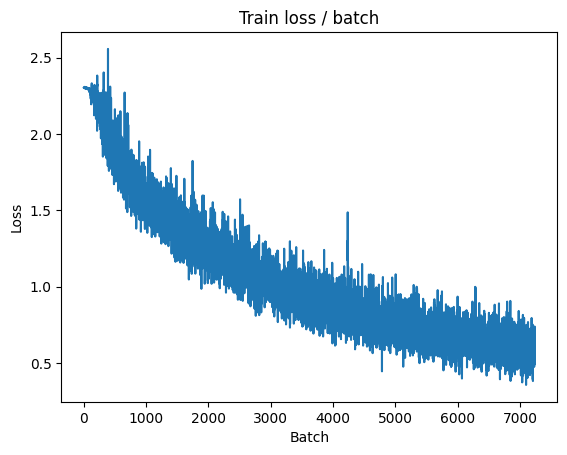


===============> Total time 15s	Avg loss 0.5764	Avg Prec@1 79.82 %	Avg Prec@5 99.10 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 0.4771 (0.4771)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)
[EVAL Batch 200/391]	Time 0.038s (0.024s)	Loss 0.5453 (0.4944)	Prec@1  82.8 ( 83.1)	Prec@5  99.2 ( 99.3)

===============> Total time 9s	Avg loss 0.4962	Avg Prec@1 83.05 %	Avg Prec@5 99.34 %



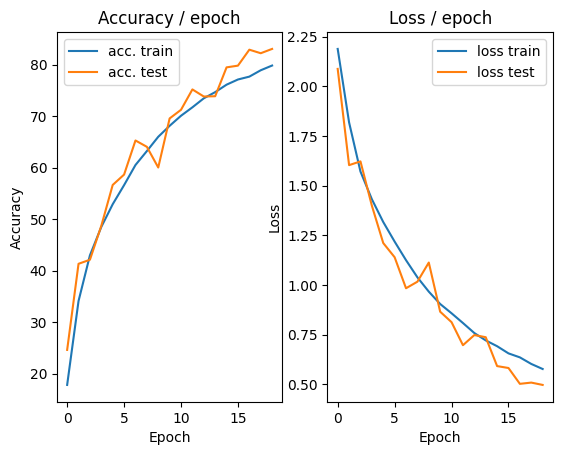

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.231s (0.231s)	Loss 0.4544 (0.4544)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


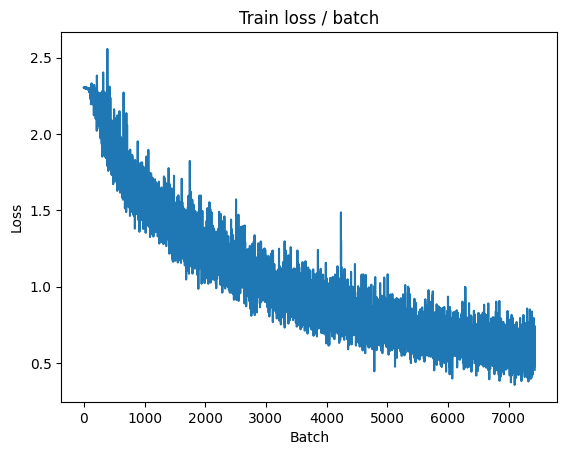

[TRAIN Batch 200/391]	Time 0.040s (0.035s)	Loss 0.4833 (0.5476)	Prec@1  82.8 ( 80.9)	Prec@5  99.2 ( 99.1)


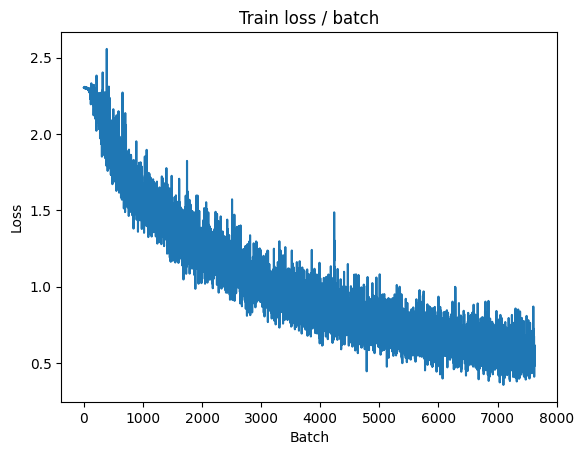


===============> Total time 14s	Avg loss 0.5516	Avg Prec@1 80.65 %	Avg Prec@5 99.12 %

[EVAL Batch 000/391]	Time 0.139s (0.139s)	Loss 0.4096 (0.4096)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.043s (0.024s)	Loss 0.4252 (0.4314)	Prec@1  85.9 ( 85.1)	Prec@5  99.2 ( 99.5)

===============> Total time 9s	Avg loss 0.4283	Avg Prec@1 85.24 %	Avg Prec@5 99.54 %



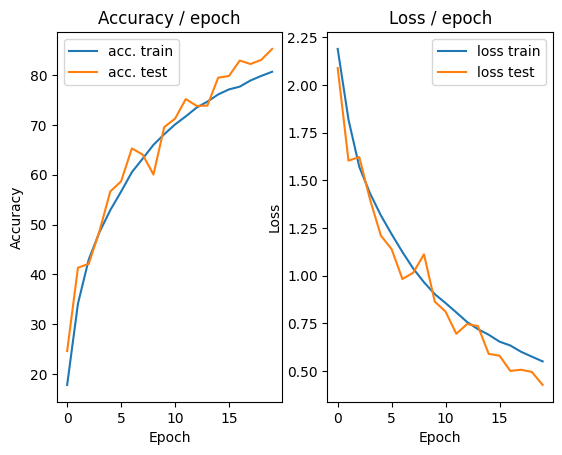

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.3285 (0.3285)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


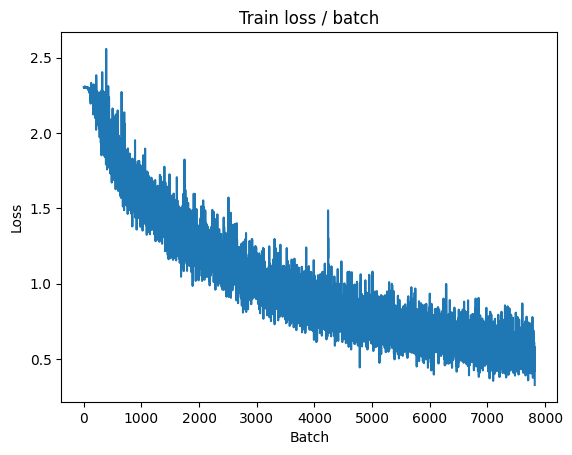

[TRAIN Batch 200/391]	Time 0.060s (0.036s)	Loss 0.3743 (0.5248)	Prec@1  87.5 ( 81.6)	Prec@5 100.0 ( 99.1)


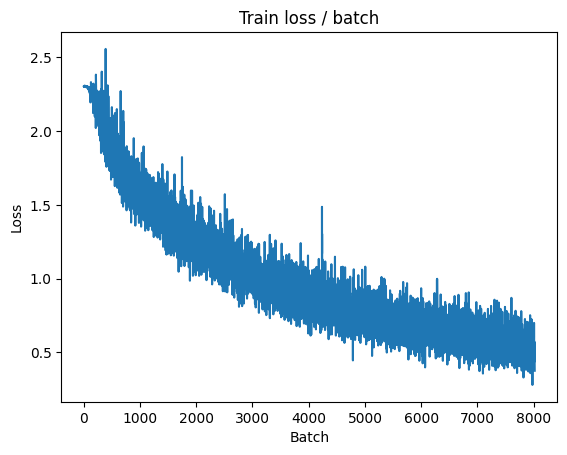


===============> Total time 15s	Avg loss 0.5322	Avg Prec@1 81.29 %	Avg Prec@5 99.18 %

[EVAL Batch 000/391]	Time 0.151s (0.151s)	Loss 0.3827 (0.3827)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.022s (0.024s)	Loss 0.4277 (0.4327)	Prec@1  79.7 ( 84.8)	Prec@5 100.0 ( 99.5)

===============> Total time 9s	Avg loss 0.4341	Avg Prec@1 84.79 %	Avg Prec@5 99.52 %



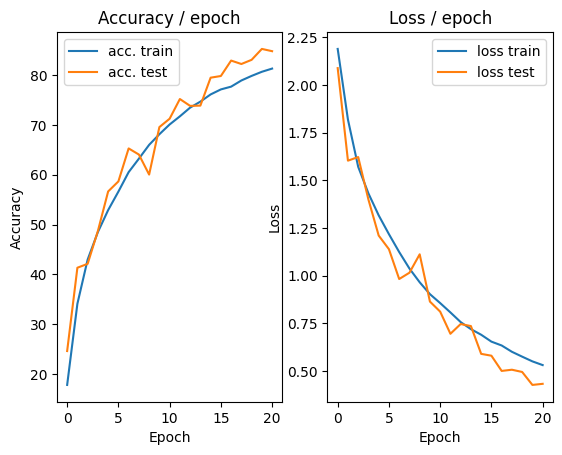

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.284s (0.284s)	Loss 0.6305 (0.6305)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)


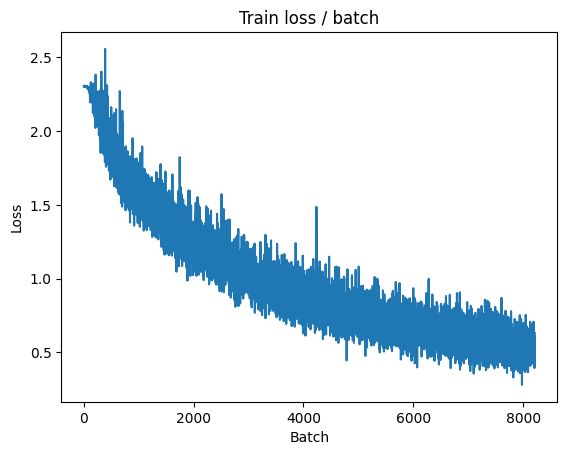

[TRAIN Batch 200/391]	Time 0.052s (0.039s)	Loss 0.4444 (0.5078)	Prec@1  81.2 ( 82.4)	Prec@5 100.0 ( 99.3)


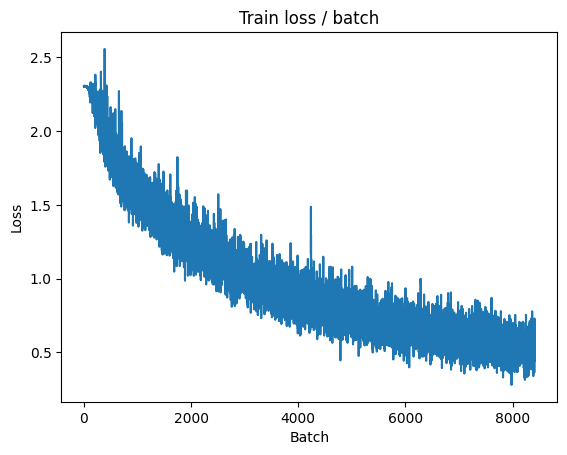


===============> Total time 15s	Avg loss 0.5125	Avg Prec@1 82.03 %	Avg Prec@5 99.25 %

[EVAL Batch 000/391]	Time 0.150s (0.150s)	Loss 0.3612 (0.3612)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.038s (0.024s)	Loss 0.3665 (0.4065)	Prec@1  87.5 ( 86.0)	Prec@5  99.2 ( 99.7)

===============> Total time 9s	Avg loss 0.4041	Avg Prec@1 86.14 %	Avg Prec@5 99.61 %



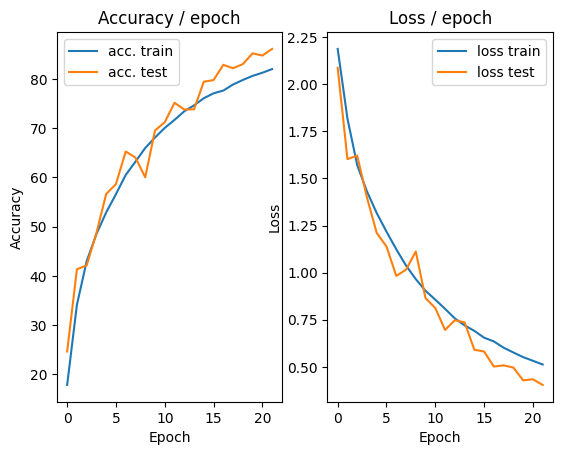

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.220s (0.220s)	Loss 0.3686 (0.3686)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


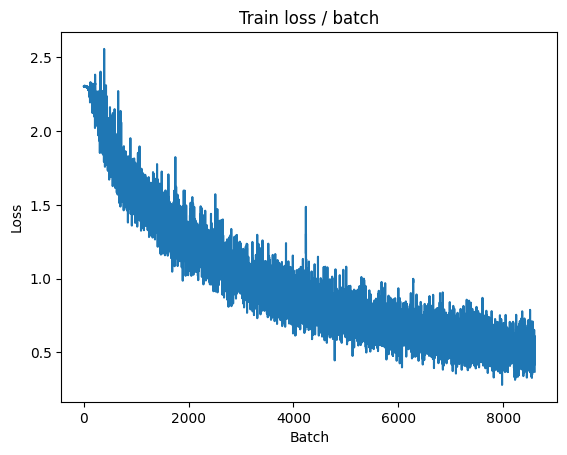

[TRAIN Batch 200/391]	Time 0.015s (0.039s)	Loss 0.5840 (0.4874)	Prec@1  81.2 ( 82.8)	Prec@5 100.0 ( 99.4)


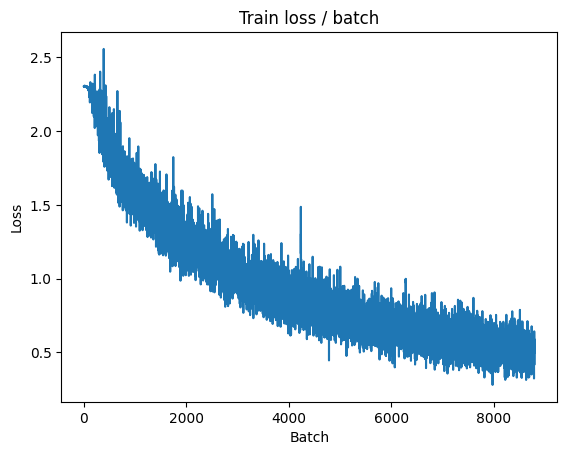


===============> Total time 15s	Avg loss 0.4896	Avg Prec@1 82.90 %	Avg Prec@5 99.35 %

[EVAL Batch 000/391]	Time 0.263s (0.263s)	Loss 0.3391 (0.3391)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.029s)	Loss 0.3807 (0.3881)	Prec@1  85.2 ( 86.6)	Prec@5 100.0 ( 99.6)

===============> Total time 10s	Avg loss 0.3866	Avg Prec@1 86.76 %	Avg Prec@5 99.65 %



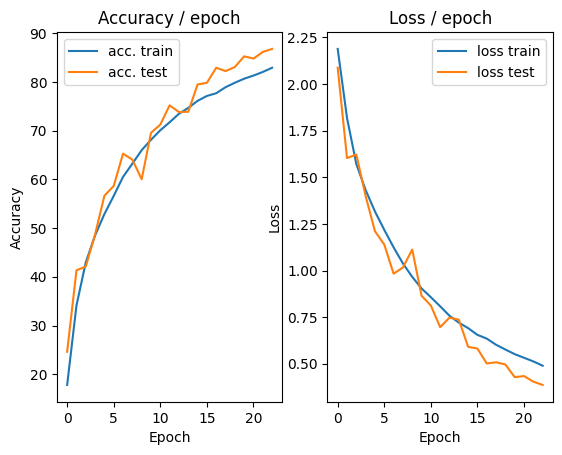

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.4861 (0.4861)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


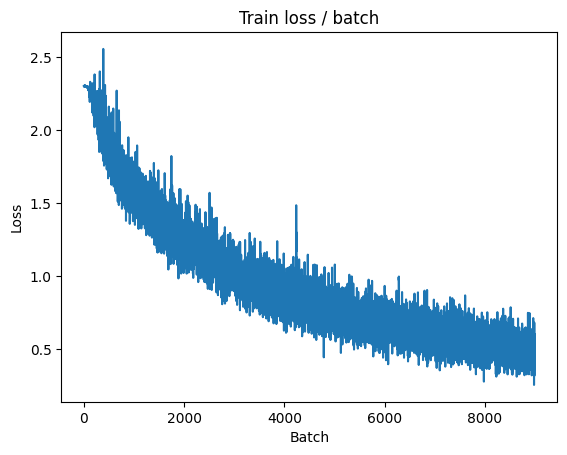

[TRAIN Batch 200/391]	Time 0.018s (0.039s)	Loss 0.5008 (0.4677)	Prec@1  78.9 ( 83.7)	Prec@5 100.0 ( 99.4)


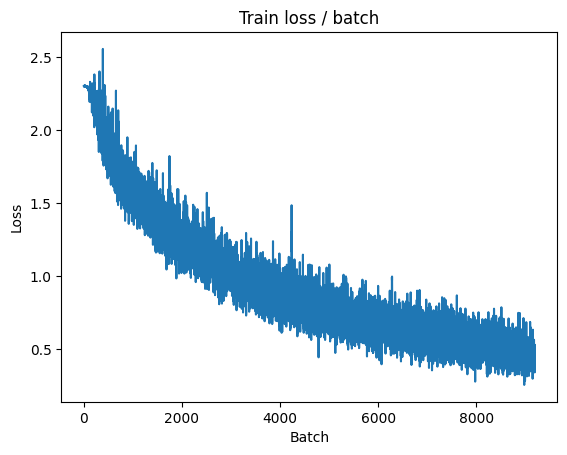


===============> Total time 14s	Avg loss 0.4713	Avg Prec@1 83.45 %	Avg Prec@5 99.41 %

[EVAL Batch 000/391]	Time 0.206s (0.206s)	Loss 0.3322 (0.3322)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.006s (0.033s)	Loss 0.3509 (0.3973)	Prec@1  87.5 ( 86.2)	Prec@5 100.0 ( 99.7)

===============> Total time 11s	Avg loss 0.3929	Avg Prec@1 86.40 %	Avg Prec@5 99.67 %



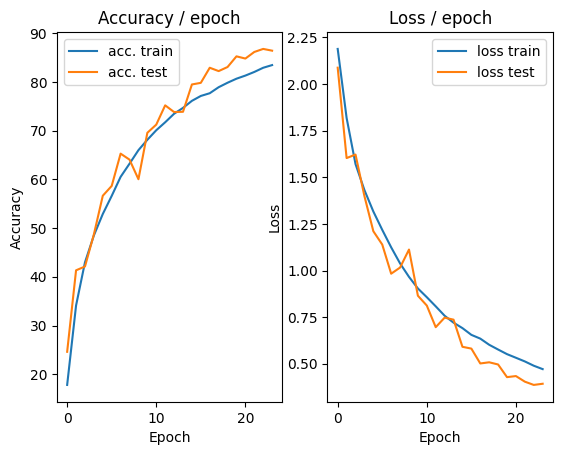

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.4000 (0.4000)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


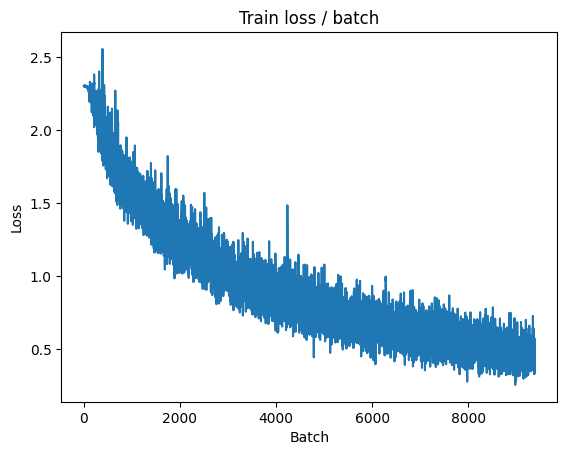

[TRAIN Batch 200/391]	Time 0.047s (0.039s)	Loss 0.3853 (0.4417)	Prec@1  83.6 ( 84.3)	Prec@5 100.0 ( 99.5)


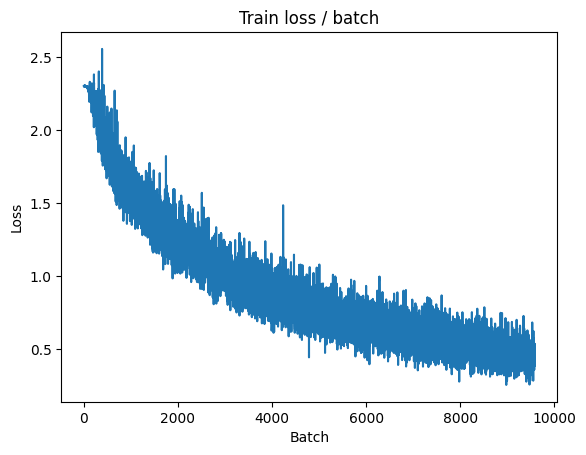


===============> Total time 14s	Avg loss 0.4548	Avg Prec@1 84.04 %	Avg Prec@5 99.43 %

[EVAL Batch 000/391]	Time 0.238s (0.238s)	Loss 0.4020 (0.4020)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.043s (0.033s)	Loss 0.5327 (0.4365)	Prec@1  78.9 ( 84.1)	Prec@5 100.0 ( 99.6)

===============> Total time 10s	Avg loss 0.4335	Avg Prec@1 84.29 %	Avg Prec@5 99.57 %



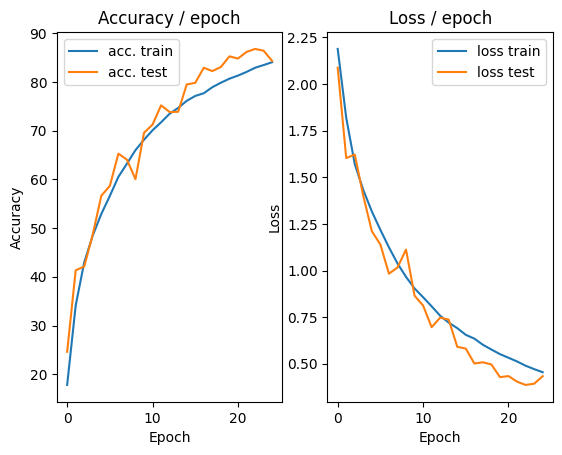

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.4728 (0.4728)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


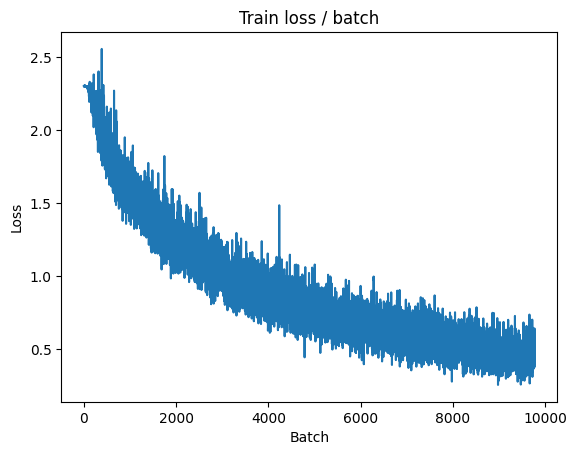

[TRAIN Batch 200/391]	Time 0.048s (0.040s)	Loss 0.2989 (0.4268)	Prec@1  89.1 ( 84.9)	Prec@5 100.0 ( 99.5)


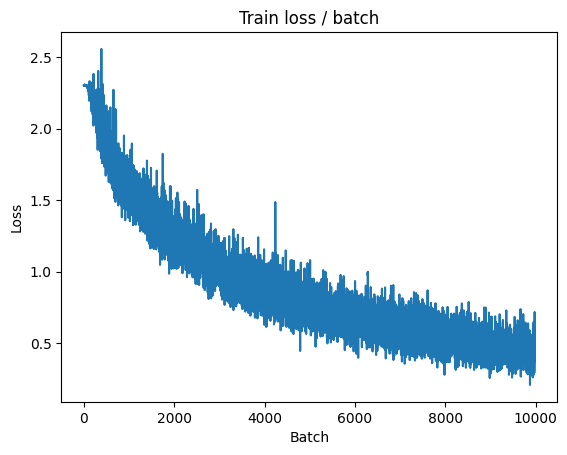


===============> Total time 14s	Avg loss 0.4333	Avg Prec@1 84.69 %	Avg Prec@5 99.52 %

[EVAL Batch 000/391]	Time 0.149s (0.149s)	Loss 0.3521 (0.3521)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.034s (0.029s)	Loss 0.3860 (0.3932)	Prec@1  85.2 ( 86.2)	Prec@5 100.0 ( 99.7)

===============> Total time 10s	Avg loss 0.3950	Avg Prec@1 86.12 %	Avg Prec@5 99.69 %



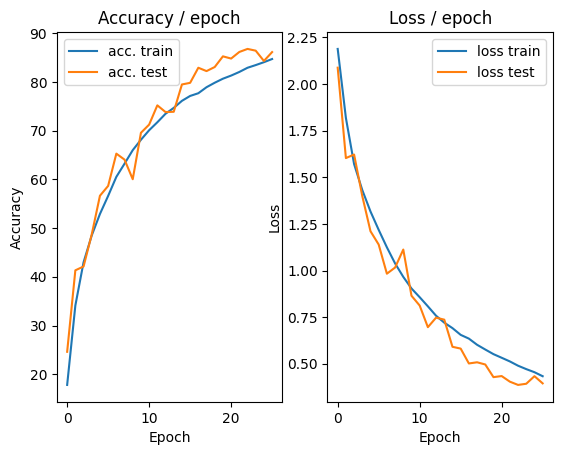

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.4403 (0.4403)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


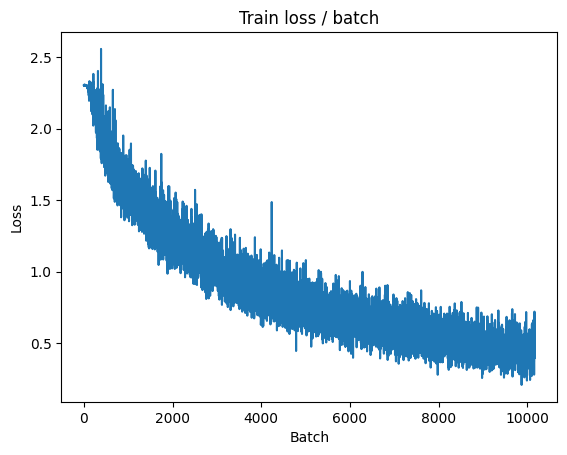

[TRAIN Batch 200/391]	Time 0.011s (0.040s)	Loss 0.3527 (0.4096)	Prec@1  91.4 ( 85.8)	Prec@5  99.2 ( 99.6)


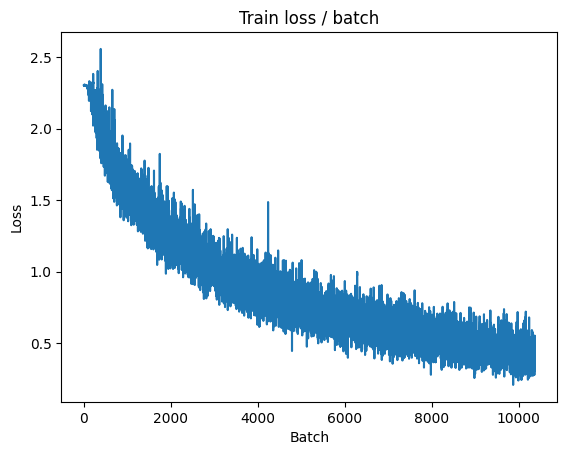


===============> Total time 14s	Avg loss 0.4160	Avg Prec@1 85.37 %	Avg Prec@5 99.63 %

[EVAL Batch 000/391]	Time 0.152s (0.152s)	Loss 0.2942 (0.2942)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.010s (0.036s)	Loss 0.3970 (0.3210)	Prec@1  85.9 ( 88.8)	Prec@5 100.0 ( 99.8)

===============> Total time 11s	Avg loss 0.3183	Avg Prec@1 88.91 %	Avg Prec@5 99.77 %



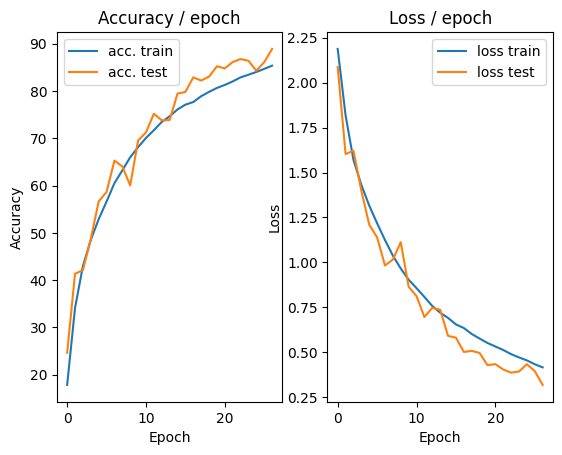

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.4661 (0.4661)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


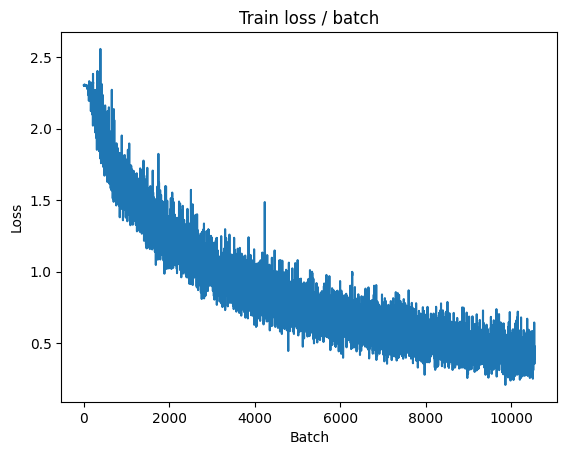

[TRAIN Batch 200/391]	Time 0.021s (0.039s)	Loss 0.4263 (0.4012)	Prec@1  81.2 ( 86.0)	Prec@5 100.0 ( 99.6)


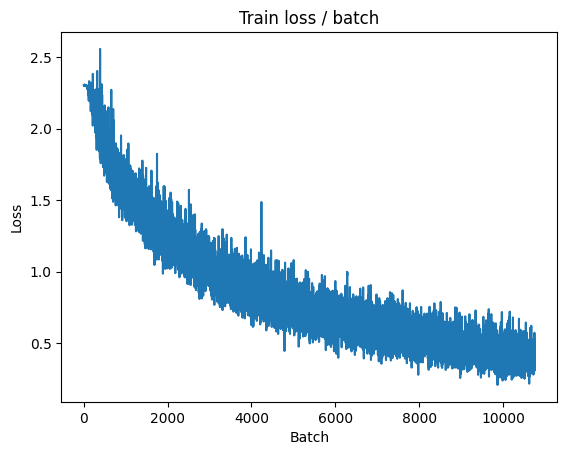


===============> Total time 14s	Avg loss 0.4087	Avg Prec@1 85.63 %	Avg Prec@5 99.63 %

[EVAL Batch 000/391]	Time 0.152s (0.152s)	Loss 0.3061 (0.3061)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.046s (0.028s)	Loss 0.3951 (0.3515)	Prec@1  82.8 ( 87.2)	Prec@5 100.0 ( 99.8)

===============> Total time 10s	Avg loss 0.3485	Avg Prec@1 87.57 %	Avg Prec@5 99.75 %



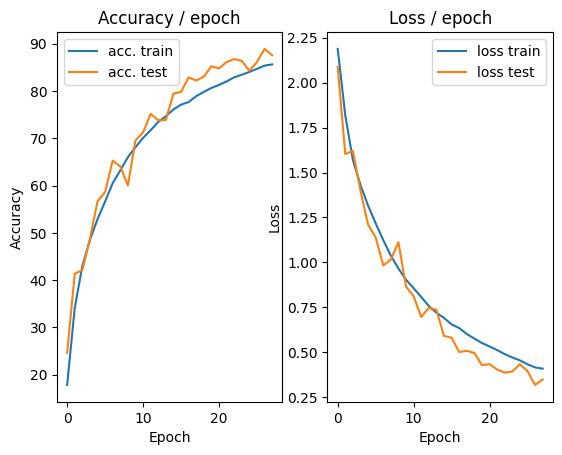

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.5091 (0.5091)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)


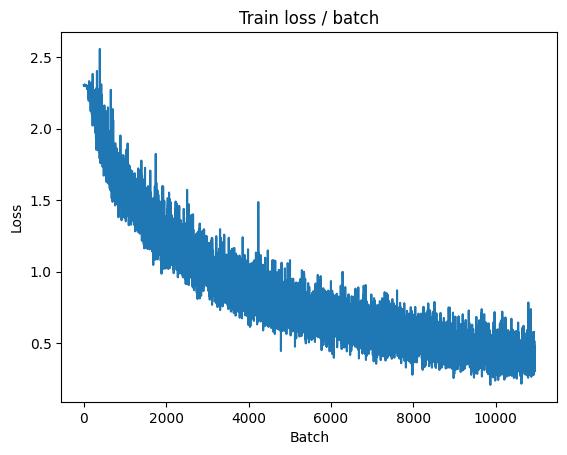

[TRAIN Batch 200/391]	Time 0.018s (0.039s)	Loss 0.4880 (0.3750)	Prec@1  79.7 ( 86.7)	Prec@5 100.0 ( 99.7)


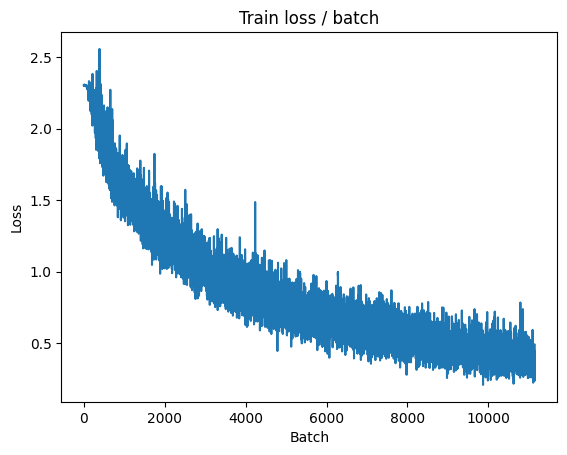


===============> Total time 14s	Avg loss 0.3822	Avg Prec@1 86.50 %	Avg Prec@5 99.68 %

[EVAL Batch 000/391]	Time 0.167s (0.167s)	Loss 0.2279 (0.2279)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.019s (0.037s)	Loss 0.2887 (0.3147)	Prec@1  89.8 ( 88.8)	Prec@5 100.0 ( 99.8)

===============> Total time 11s	Avg loss 0.3105	Avg Prec@1 89.02 %	Avg Prec@5 99.78 %



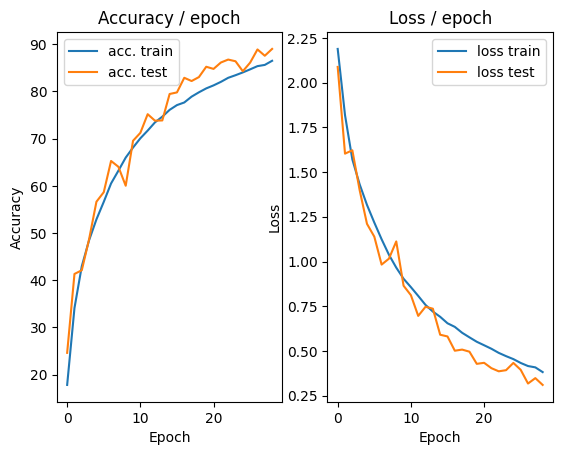

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.235s (0.235s)	Loss 0.3498 (0.3498)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


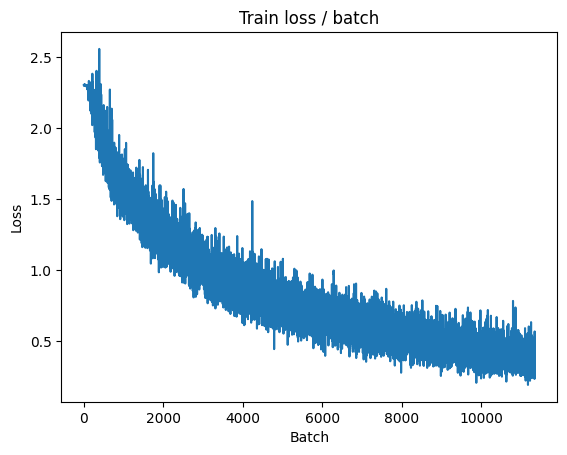

[TRAIN Batch 200/391]	Time 0.009s (0.039s)	Loss 0.2735 (0.3619)	Prec@1  89.8 ( 87.1)	Prec@5  99.2 ( 99.7)


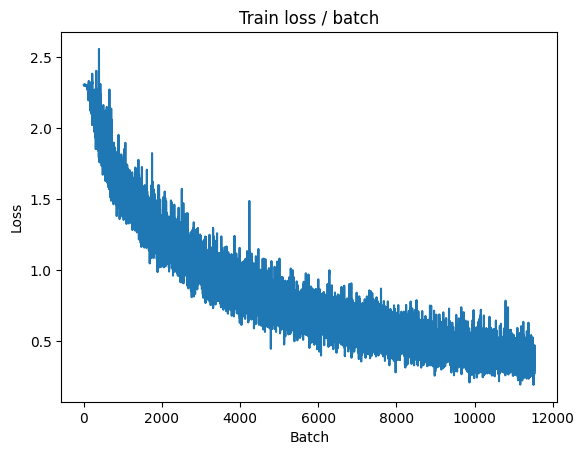


===============> Total time 14s	Avg loss 0.3749	Avg Prec@1 86.80 %	Avg Prec@5 99.69 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.3590 (0.3590)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.039s (0.029s)	Loss 0.4326 (0.3587)	Prec@1  81.2 ( 87.4)	Prec@5 100.0 ( 99.8)

===============> Total time 10s	Avg loss 0.3571	Avg Prec@1 87.44 %	Avg Prec@5 99.75 %



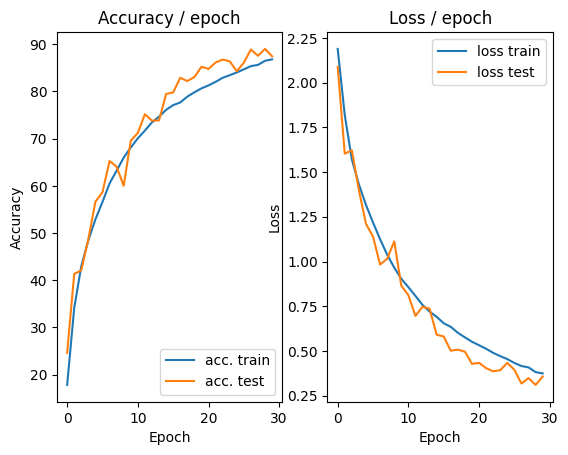

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.5153 (0.5153)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


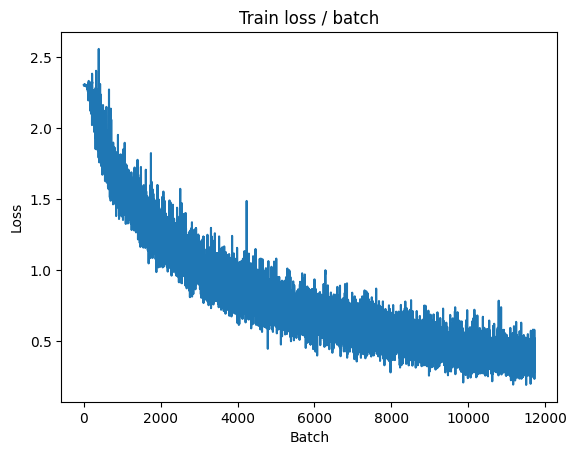

[TRAIN Batch 200/391]	Time 0.058s (0.040s)	Loss 0.4576 (0.3475)	Prec@1  84.4 ( 87.8)	Prec@5  98.4 ( 99.7)


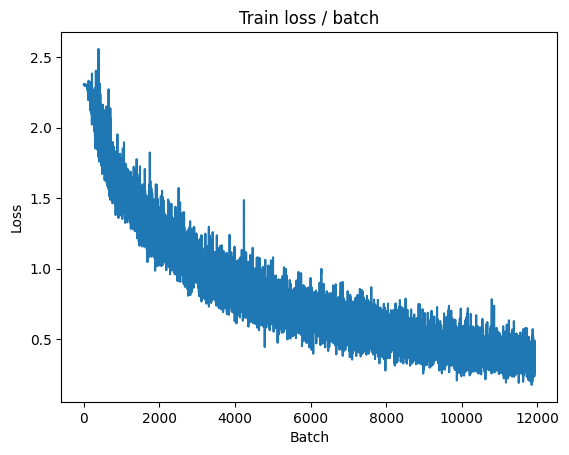


===============> Total time 14s	Avg loss 0.3596	Avg Prec@1 87.37 %	Avg Prec@5 99.65 %

[EVAL Batch 000/391]	Time 0.151s (0.151s)	Loss 0.4044 (0.4044)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.048s (0.036s)	Loss 0.4354 (0.3956)	Prec@1  85.2 ( 85.6)	Prec@5 100.0 ( 99.7)

===============> Total time 11s	Avg loss 0.3903	Avg Prec@1 85.93 %	Avg Prec@5 99.71 %



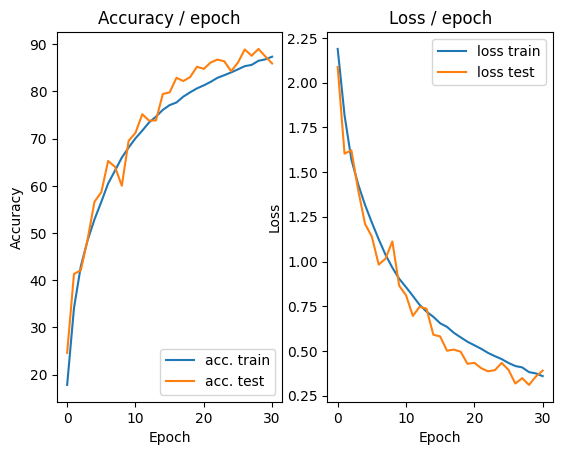

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.4570 (0.4570)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


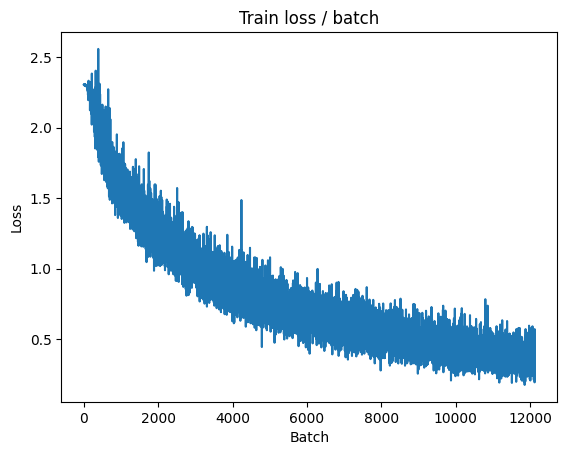

[TRAIN Batch 200/391]	Time 0.043s (0.040s)	Loss 0.2929 (0.3367)	Prec@1  90.6 ( 88.2)	Prec@5 100.0 ( 99.7)


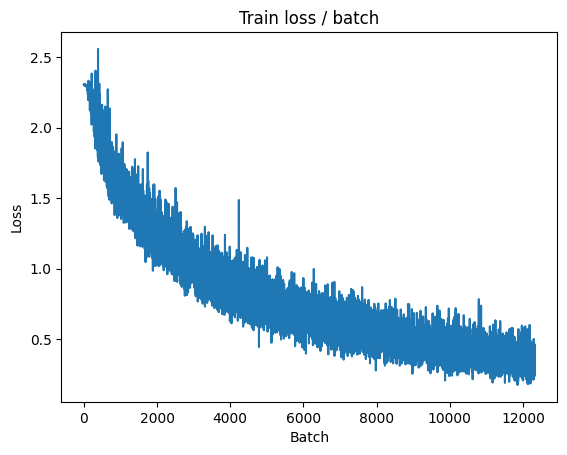


===============> Total time 14s	Avg loss 0.3433	Avg Prec@1 87.99 %	Avg Prec@5 99.72 %

[EVAL Batch 000/391]	Time 0.175s (0.175s)	Loss 0.3195 (0.3195)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.044s (0.029s)	Loss 0.2594 (0.2619)	Prec@1  88.3 ( 90.8)	Prec@5 100.0 ( 99.9)

===============> Total time 10s	Avg loss 0.2589	Avg Prec@1 90.92 %	Avg Prec@5 99.86 %



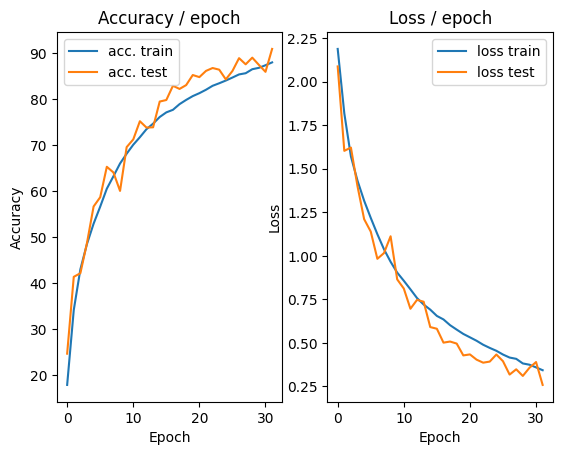

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 0.3795 (0.3795)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


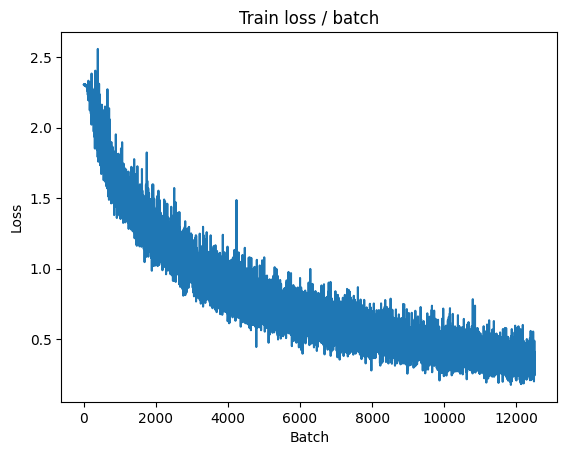

[TRAIN Batch 200/391]	Time 0.028s (0.040s)	Loss 0.2781 (0.3301)	Prec@1  89.8 ( 88.3)	Prec@5  99.2 ( 99.7)


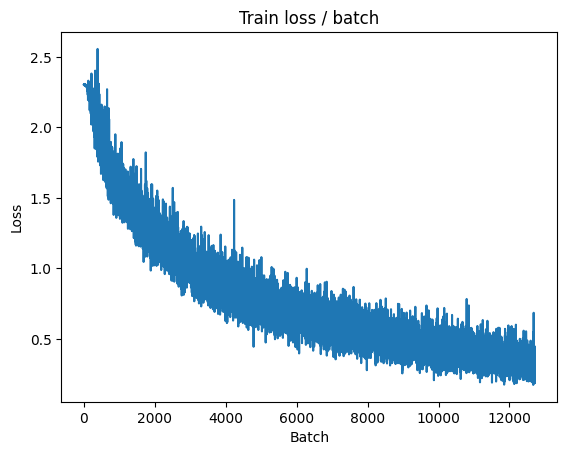


===============> Total time 14s	Avg loss 0.3343	Avg Prec@1 88.17 %	Avg Prec@5 99.72 %

[EVAL Batch 000/391]	Time 0.173s (0.173s)	Loss 0.2095 (0.2095)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.034s)	Loss 0.2481 (0.2208)	Prec@1  88.3 ( 92.6)	Prec@5 100.0 ( 99.9)

===============> Total time 11s	Avg loss 0.2170	Avg Prec@1 92.72 %	Avg Prec@5 99.92 %



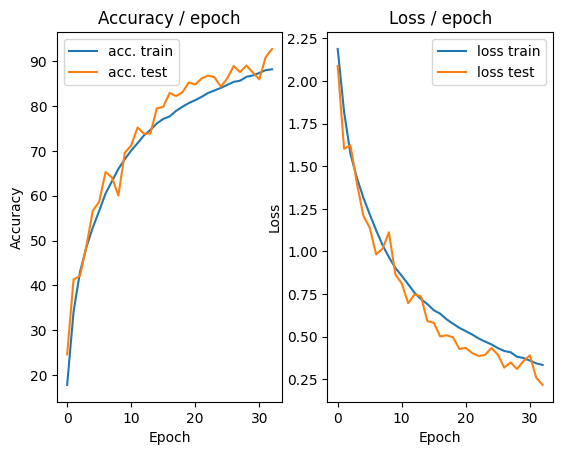

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.2846 (0.2846)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


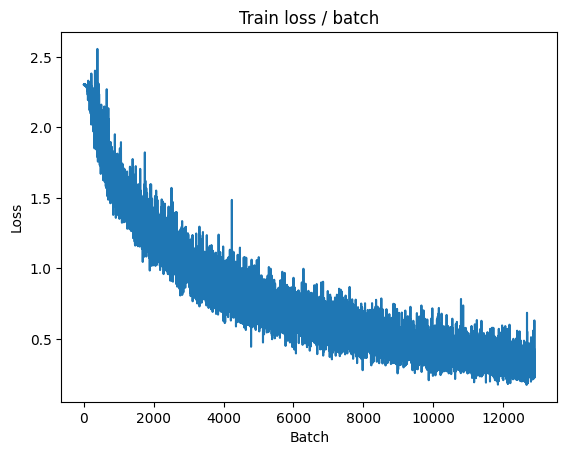

[TRAIN Batch 200/391]	Time 0.013s (0.038s)	Loss 0.2463 (0.3098)	Prec@1  90.6 ( 89.2)	Prec@5 100.0 ( 99.8)


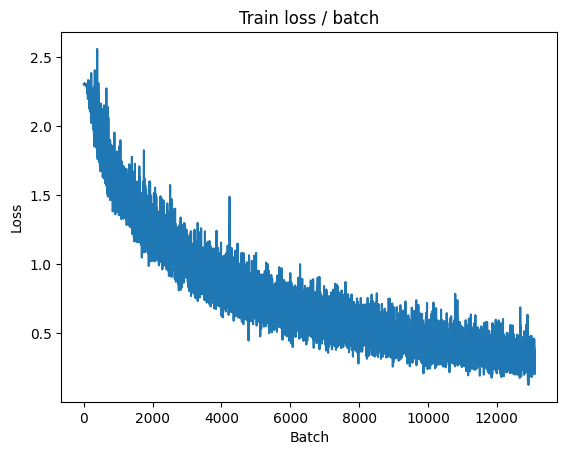


===============> Total time 15s	Avg loss 0.3194	Avg Prec@1 88.77 %	Avg Prec@5 99.77 %

[EVAL Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2369 (0.2369)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.029s)	Loss 0.2646 (0.2505)	Prec@1  93.0 ( 91.3)	Prec@5 100.0 ( 99.9)

===============> Total time 10s	Avg loss 0.2470	Avg Prec@1 91.42 %	Avg Prec@5 99.84 %



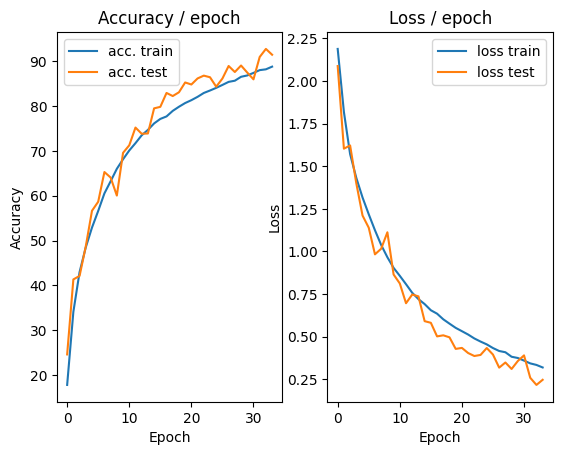

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.2467 (0.2467)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


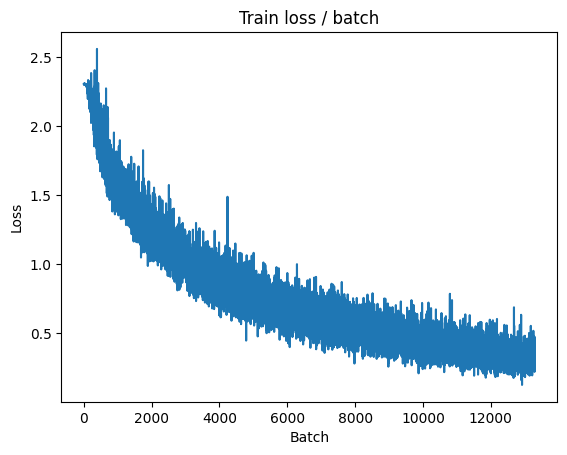

[TRAIN Batch 200/391]	Time 0.013s (0.039s)	Loss 0.2294 (0.2979)	Prec@1  93.8 ( 89.6)	Prec@5  98.4 ( 99.9)


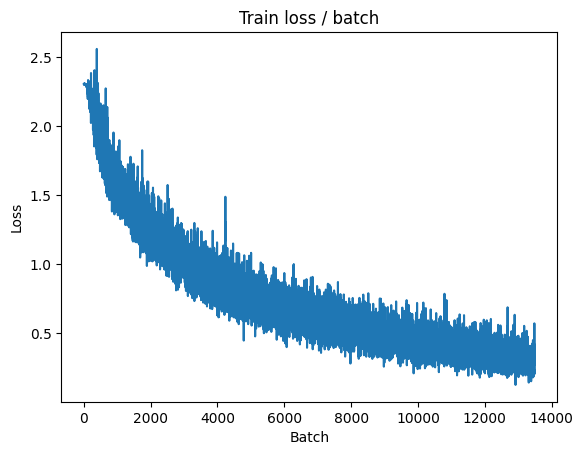


===============> Total time 14s	Avg loss 0.3099	Avg Prec@1 89.14 %	Avg Prec@5 99.82 %

[EVAL Batch 000/391]	Time 0.143s (0.143s)	Loss 0.2401 (0.2401)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.007s (0.032s)	Loss 0.1962 (0.2131)	Prec@1  94.5 ( 92.7)	Prec@5  99.2 ( 99.9)

===============> Total time 11s	Avg loss 0.2090	Avg Prec@1 92.98 %	Avg Prec@5 99.93 %



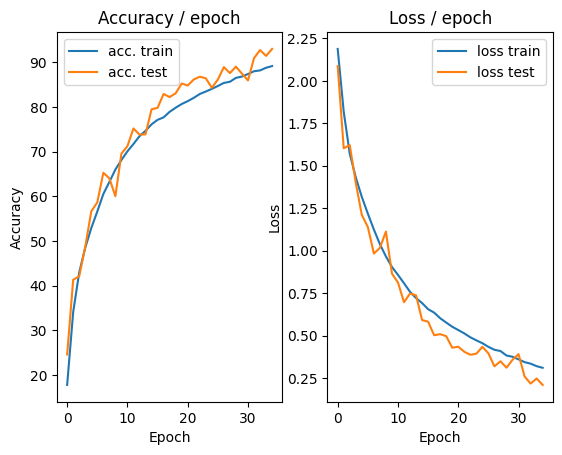

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.224s (0.224s)	Loss 0.2429 (0.2429)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


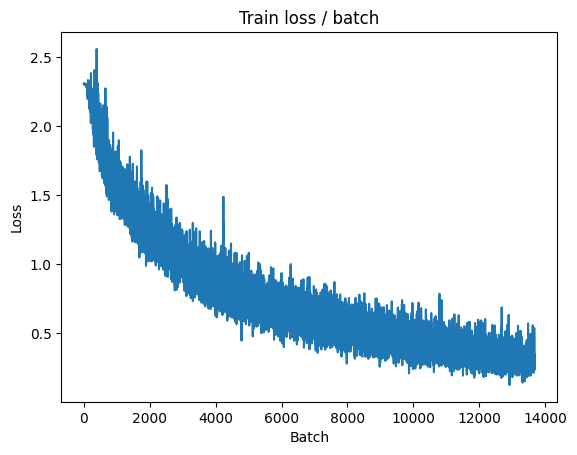

[TRAIN Batch 200/391]	Time 0.016s (0.039s)	Loss 0.2327 (0.2820)	Prec@1  89.8 ( 89.9)	Prec@5 100.0 ( 99.8)


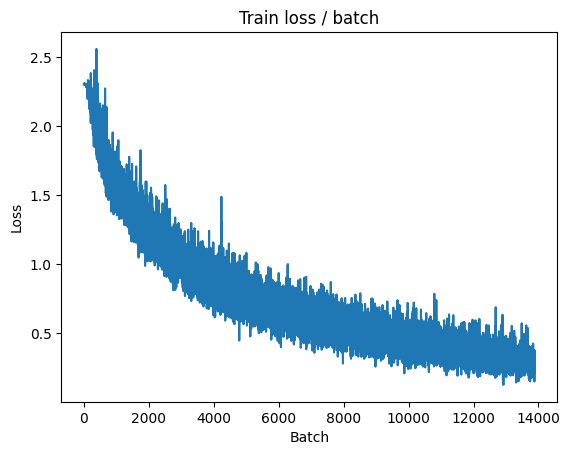


===============> Total time 14s	Avg loss 0.2952	Avg Prec@1 89.43 %	Avg Prec@5 99.78 %

[EVAL Batch 000/391]	Time 0.159s (0.159s)	Loss 0.2493 (0.2493)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.005s (0.028s)	Loss 0.2124 (0.2411)	Prec@1  91.4 ( 91.9)	Prec@5 100.0 ( 99.9)

===============> Total time 10s	Avg loss 0.2425	Avg Prec@1 91.85 %	Avg Prec@5 99.93 %



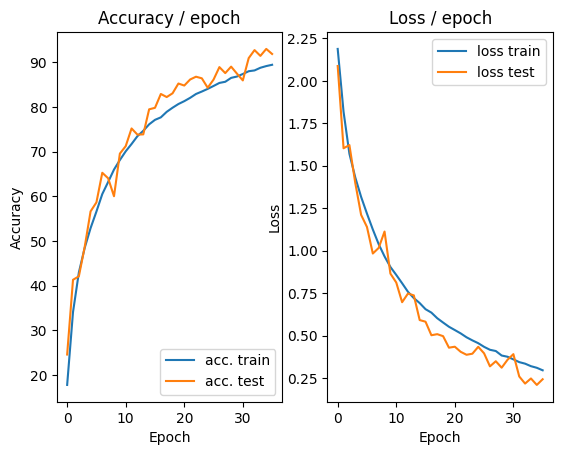

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.4148 (0.4148)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


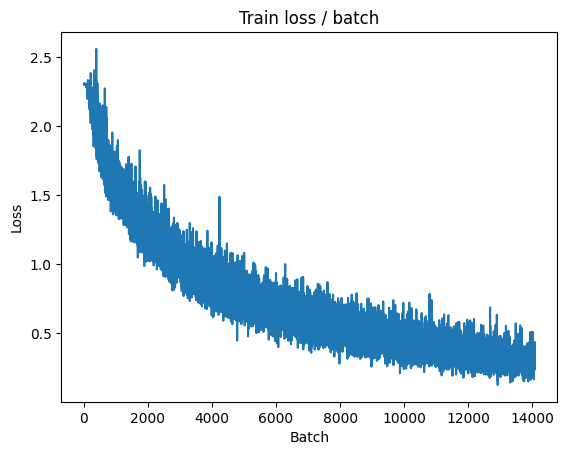

[TRAIN Batch 200/391]	Time 0.107s (0.038s)	Loss 0.3332 (0.2850)	Prec@1  84.4 ( 90.0)	Prec@5 100.0 ( 99.8)


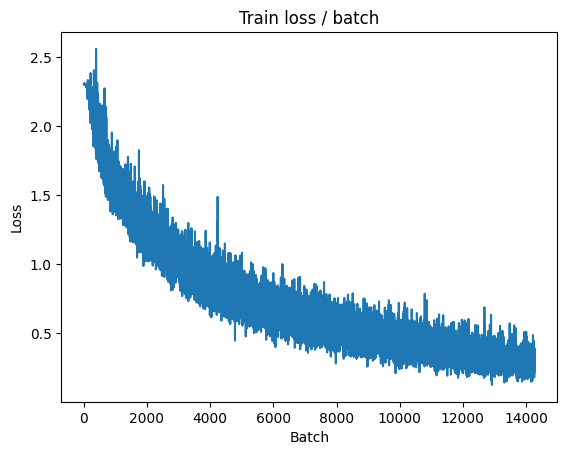


===============> Total time 14s	Avg loss 0.2886	Avg Prec@1 89.92 %	Avg Prec@5 99.81 %

[EVAL Batch 000/391]	Time 0.167s (0.167s)	Loss 0.1542 (0.1542)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.087s (0.029s)	Loss 0.1530 (0.1679)	Prec@1  95.3 ( 94.4)	Prec@5 100.0 ( 99.9)

===============> Total time 11s	Avg loss 0.1659	Avg Prec@1 94.57 %	Avg Prec@5 99.95 %



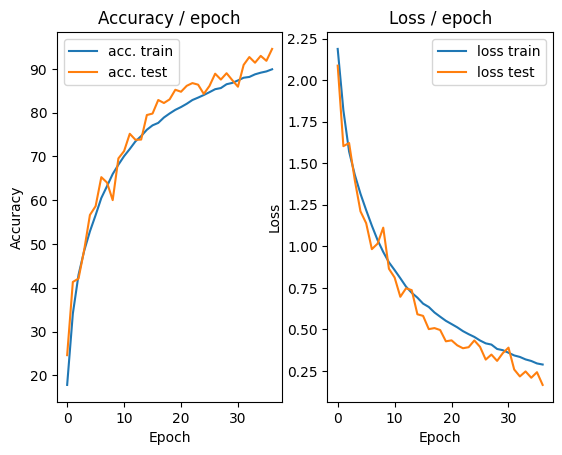

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.237s (0.237s)	Loss 0.2116 (0.2116)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


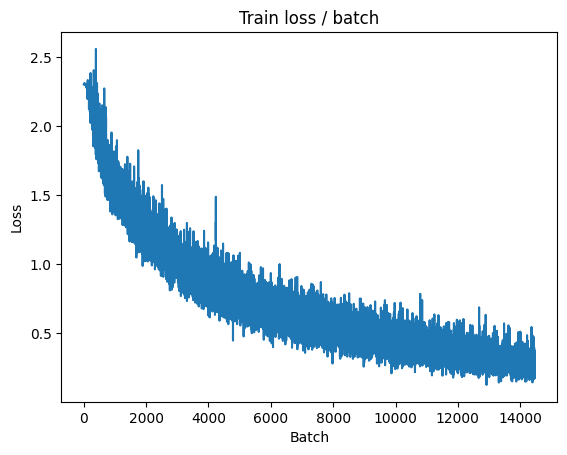

[TRAIN Batch 200/391]	Time 0.020s (0.035s)	Loss 0.2903 (0.2675)	Prec@1  89.1 ( 90.8)	Prec@5 100.0 ( 99.8)


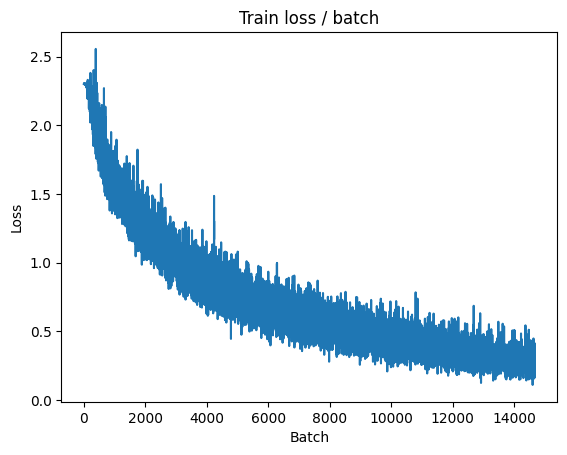


===============> Total time 14s	Avg loss 0.2749	Avg Prec@1 90.43 %	Avg Prec@5 99.83 %

[EVAL Batch 000/391]	Time 0.160s (0.160s)	Loss 0.2180 (0.2180)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.024s)	Loss 0.2669 (0.2553)	Prec@1  89.1 ( 91.2)	Prec@5 100.0 ( 99.9)

===============> Total time 10s	Avg loss 0.2514	Avg Prec@1 91.31 %	Avg Prec@5 99.90 %



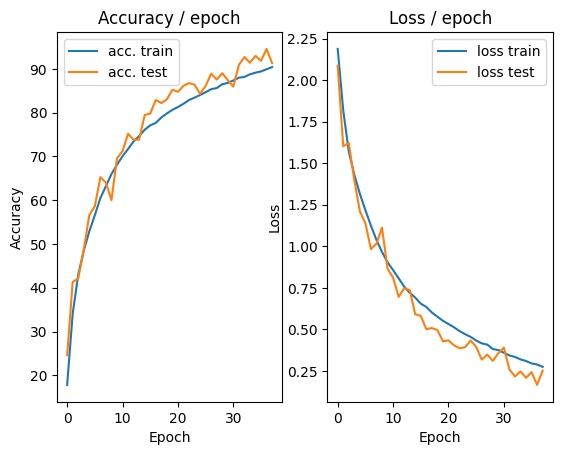

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.4984 (0.4984)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


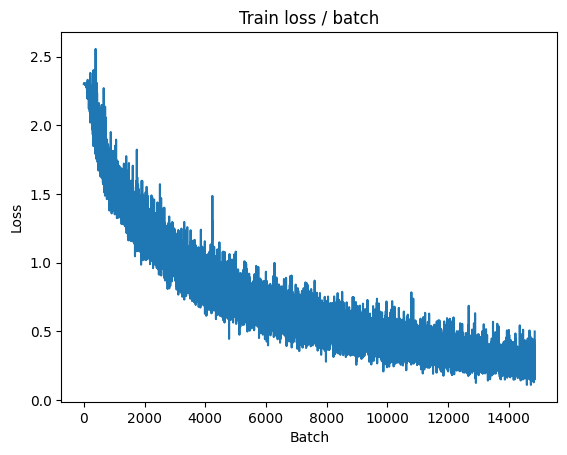

[TRAIN Batch 200/391]	Time 0.021s (0.035s)	Loss 0.4382 (0.2594)	Prec@1  85.2 ( 90.8)	Prec@5  97.7 ( 99.9)


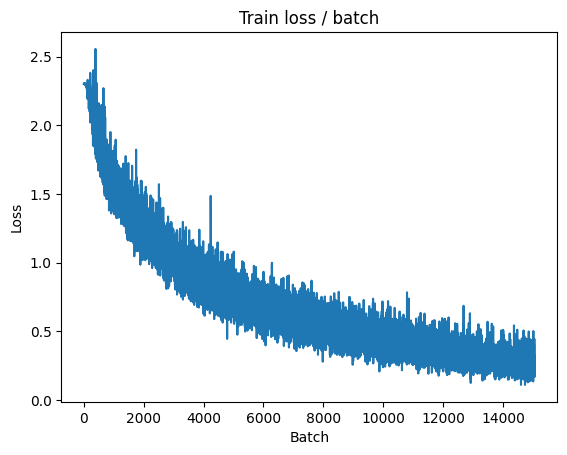


===============> Total time 14s	Avg loss 0.2706	Avg Prec@1 90.44 %	Avg Prec@5 99.87 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.1488 (0.1488)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.002s (0.027s)	Loss 0.1232 (0.1778)	Prec@1  96.1 ( 94.0)	Prec@5 100.0 ( 99.9)

===============> Total time 11s	Avg loss 0.1755	Avg Prec@1 94.10 %	Avg Prec@5 99.95 %



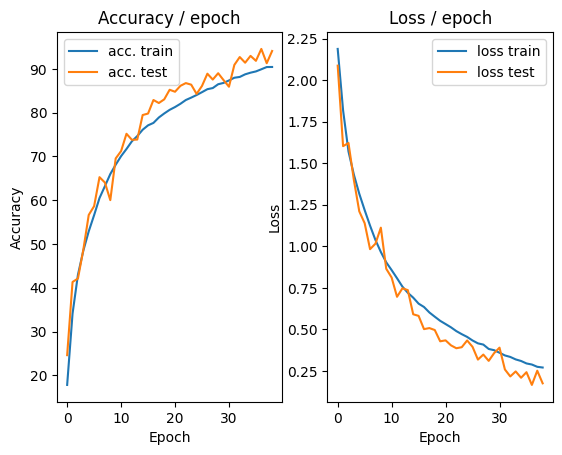

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.2430 (0.2430)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


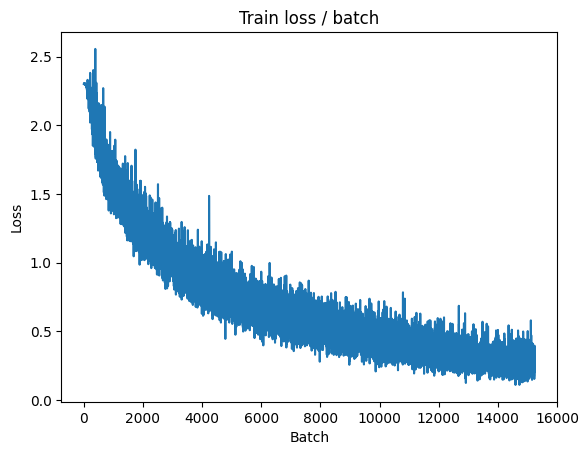

[TRAIN Batch 200/391]	Time 0.008s (0.035s)	Loss 0.1954 (0.2555)	Prec@1  93.8 ( 91.0)	Prec@5 100.0 ( 99.9)


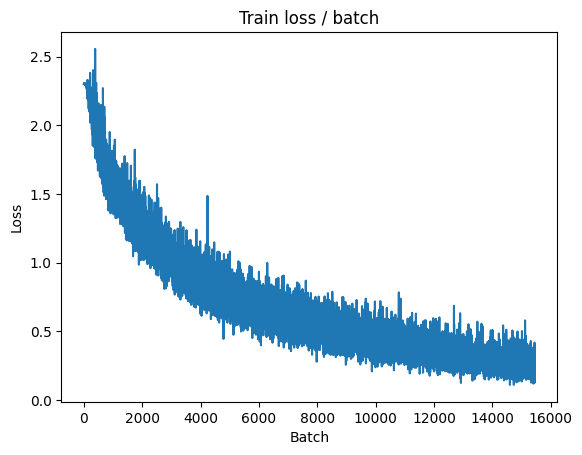


===============> Total time 14s	Avg loss 0.2607	Avg Prec@1 90.87 %	Avg Prec@5 99.84 %

[EVAL Batch 000/391]	Time 0.152s (0.152s)	Loss 0.1577 (0.1577)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.024s)	Loss 0.1529 (0.1612)	Prec@1  94.5 ( 94.6)	Prec@5 100.0 (100.0)

===============> Total time 10s	Avg loss 0.1608	Avg Prec@1 94.66 %	Avg Prec@5 99.97 %



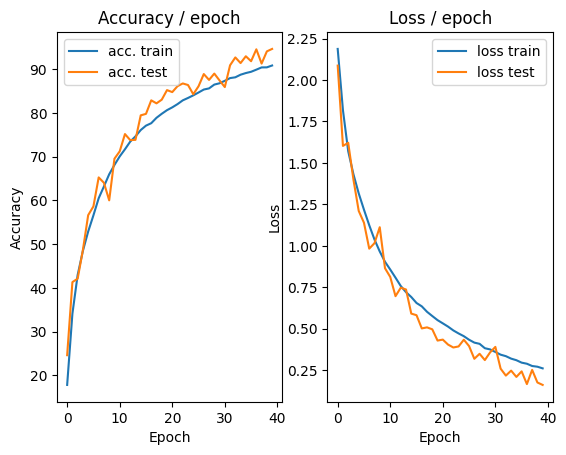

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True, get_dataset=get_dataset_increased, model=ConvNet(True))

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.682s (0.682s)	Loss 2.3065 (2.3065)	Prec@1   9.4 (  9.4)	Prec@5  44.5 ( 44.5)


<Figure size 640x480 with 0 Axes>

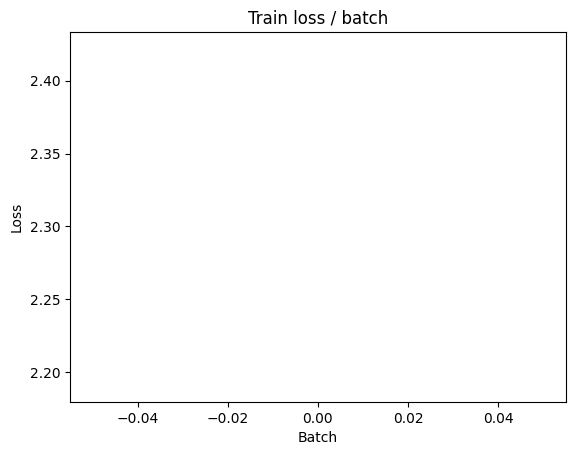

[TRAIN Batch 200/391]	Time 0.042s (0.040s)	Loss 1.6766 (1.9512)	Prec@1  43.8 ( 28.9)	Prec@5  89.8 ( 78.7)


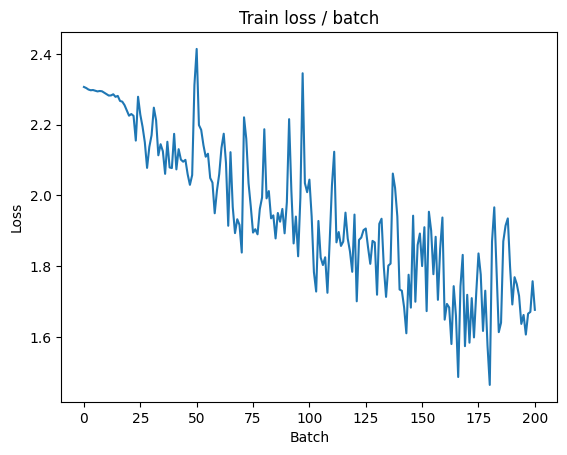


===============> Total time 15s	Avg loss 1.7573	Avg Prec@1 36.13 %	Avg Prec@5 84.59 %

[EVAL Batch 000/391]	Time 0.154s (0.154s)	Loss 1.3658 (1.3658)	Prec@1  50.8 ( 50.8)	Prec@5  93.8 ( 93.8)
[EVAL Batch 200/391]	Time 0.004s (0.033s)	Loss 1.4794 (1.4189)	Prec@1  44.5 ( 48.1)	Prec@5  92.2 ( 93.5)

===============> Total time 12s	Avg loss 1.4283	Avg Prec@1 47.71 %	Avg Prec@5 93.40 %



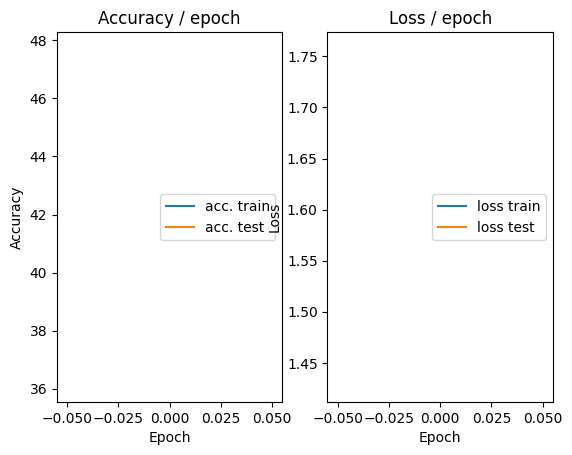

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 1.4065 (1.4065)	Prec@1  48.4 ( 48.4)	Prec@5  93.8 ( 93.8)


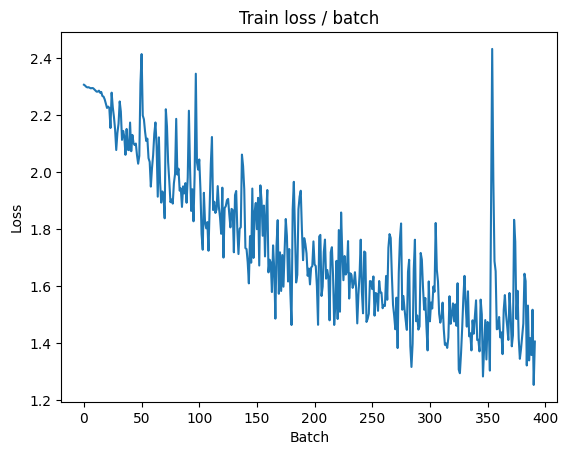

[TRAIN Batch 200/391]	Time 0.031s (0.037s)	Loss 1.4946 (1.3523)	Prec@1  43.0 ( 51.9)	Prec@5  95.3 ( 93.8)


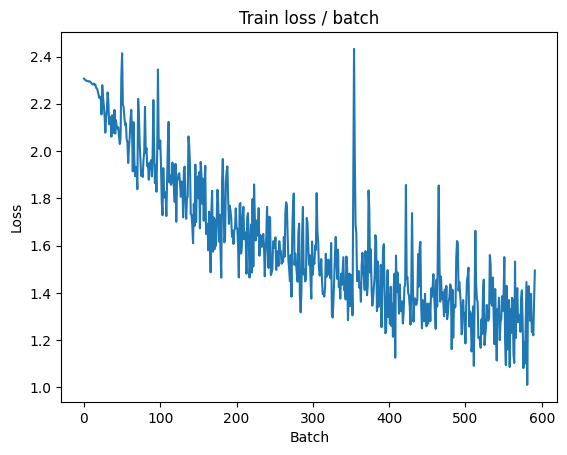


===============> Total time 14s	Avg loss 1.2942	Avg Prec@1 54.10 %	Avg Prec@5 94.36 %

[EVAL Batch 000/391]	Time 0.140s (0.140s)	Loss 1.1001 (1.1001)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)
[EVAL Batch 200/391]	Time 0.007s (0.031s)	Loss 1.1532 (1.1790)	Prec@1  61.7 ( 59.2)	Prec@5  96.9 ( 95.7)

===============> Total time 11s	Avg loss 1.1800	Avg Prec@1 59.23 %	Avg Prec@5 95.64 %



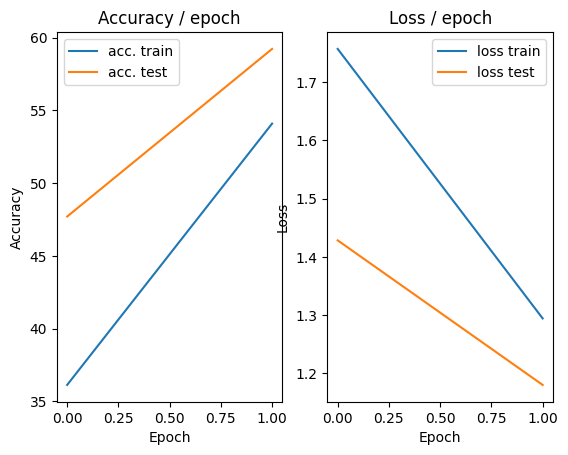

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 1.1455 (1.1455)	Prec@1  60.2 ( 60.2)	Prec@5  96.9 ( 96.9)


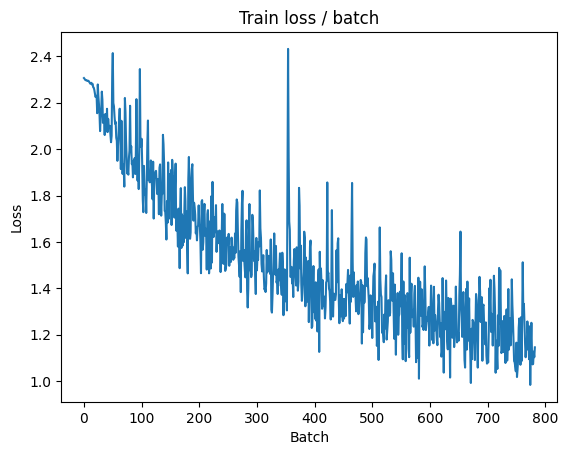

[TRAIN Batch 200/391]	Time 0.052s (0.040s)	Loss 0.9420 (1.0817)	Prec@1  67.2 ( 62.1)	Prec@5 100.0 ( 96.5)


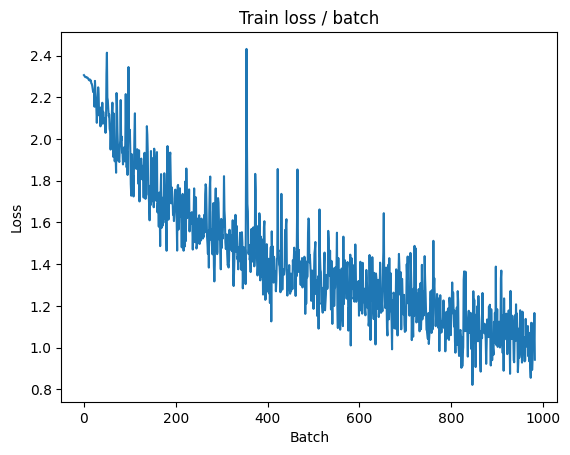


===============> Total time 15s	Avg loss 1.0452	Avg Prec@1 63.31 %	Avg Prec@5 96.52 %

[EVAL Batch 000/391]	Time 0.138s (0.138s)	Loss 0.8828 (0.8828)	Prec@1  71.1 ( 71.1)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.047s (0.028s)	Loss 0.9427 (0.9038)	Prec@1  68.0 ( 68.6)	Prec@5  96.9 ( 97.4)

===============> Total time 12s	Avg loss 0.9023	Avg Prec@1 68.66 %	Avg Prec@5 97.39 %



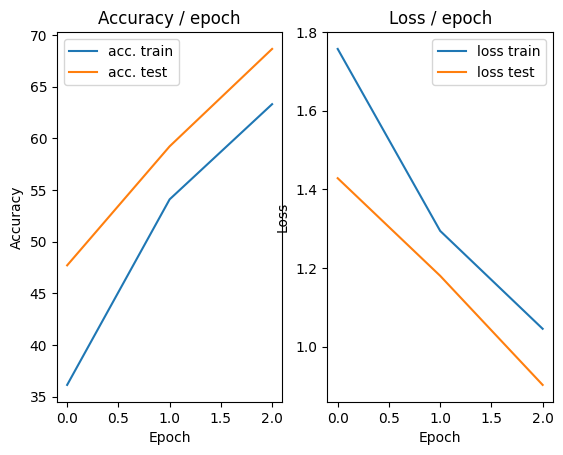

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.8453 (0.8453)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)


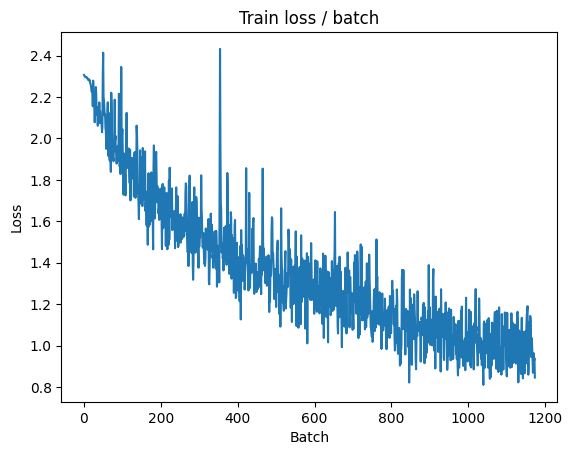

[TRAIN Batch 200/391]	Time 0.015s (0.033s)	Loss 0.9216 (0.8839)	Prec@1  66.4 ( 69.1)	Prec@5  96.9 ( 97.6)


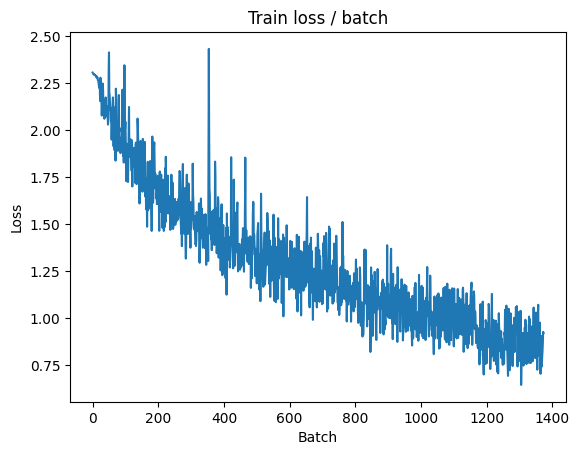


===============> Total time 13s	Avg loss 0.8659	Avg Prec@1 69.69 %	Avg Prec@5 97.71 %

[EVAL Batch 000/391]	Time 0.128s (0.128s)	Loss 0.6846 (0.6846)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)
[EVAL Batch 200/391]	Time 0.013s (0.030s)	Loss 0.9013 (0.7566)	Prec@1  69.5 ( 73.1)	Prec@5  96.1 ( 98.4)

===============> Total time 12s	Avg loss 0.7610	Avg Prec@1 73.02 %	Avg Prec@5 98.28 %



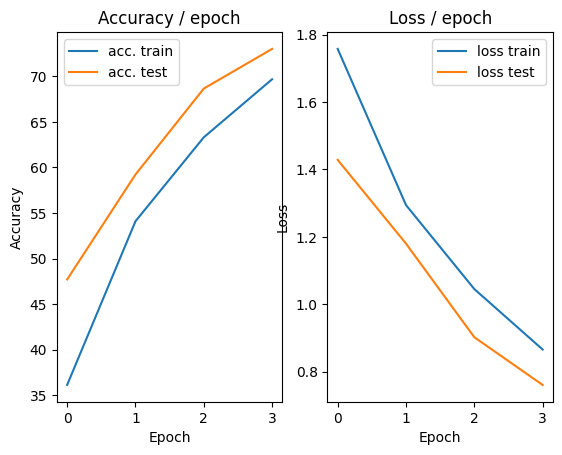

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.6796 (0.6796)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


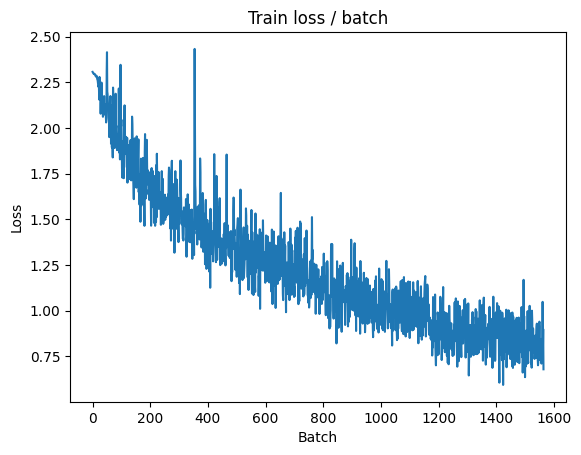

[TRAIN Batch 200/391]	Time 0.036s (0.045s)	Loss 0.8055 (0.7234)	Prec@1  68.0 ( 75.2)	Prec@5 100.0 ( 98.5)


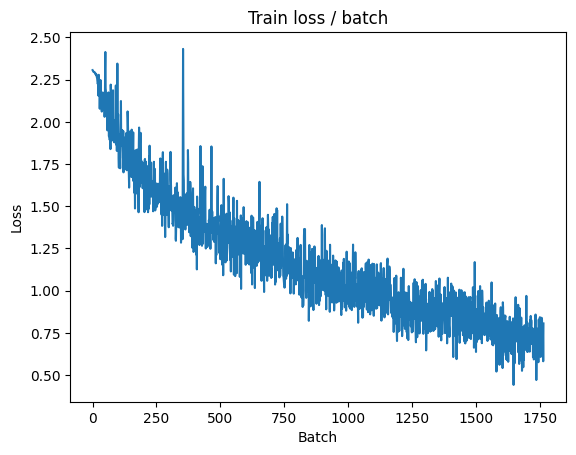


===============> Total time 15s	Avg loss 0.7210	Avg Prec@1 75.16 %	Avg Prec@5 98.49 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.5132 (0.5132)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.003s (0.031s)	Loss 0.5648 (0.5796)	Prec@1  80.5 ( 80.4)	Prec@5  99.2 ( 99.2)

===============> Total time 12s	Avg loss 0.5771	Avg Prec@1 80.56 %	Avg Prec@5 99.15 %



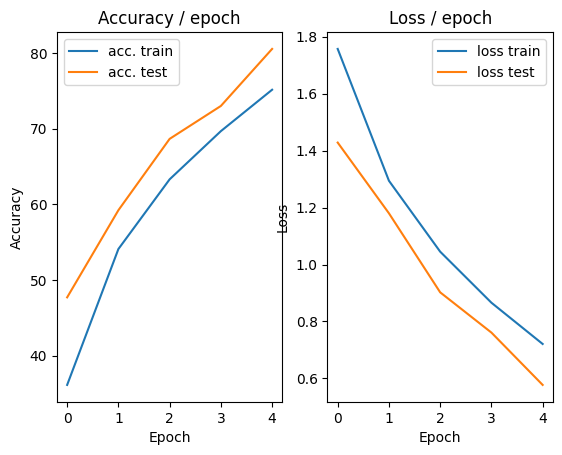

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.5358 (0.5358)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


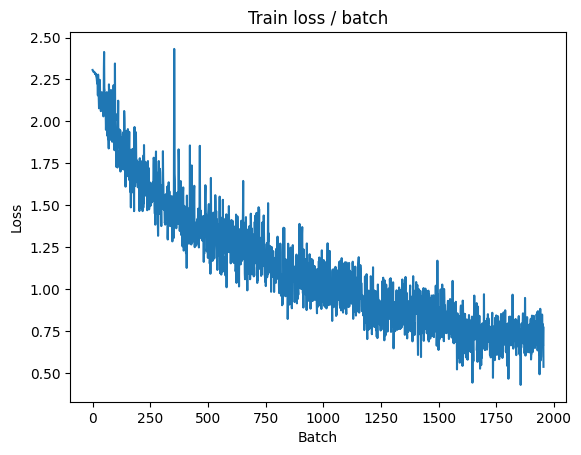

[TRAIN Batch 200/391]	Time 0.004s (0.037s)	Loss 0.5680 (0.5931)	Prec@1  76.6 ( 79.4)	Prec@5 100.0 ( 99.0)


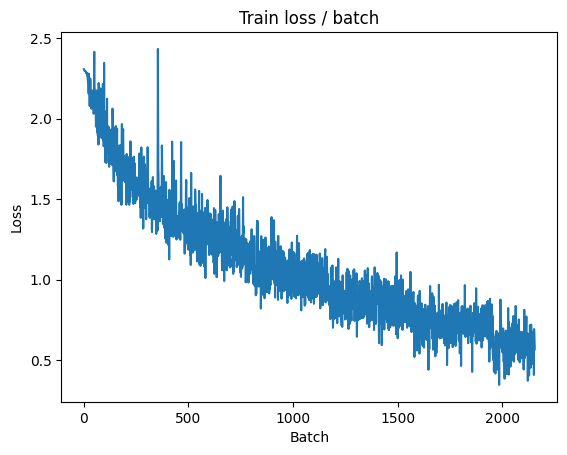


===============> Total time 13s	Avg loss 0.5994	Avg Prec@1 78.99 %	Avg Prec@5 98.97 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.4978 (0.4978)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.054s (0.034s)	Loss 0.5272 (0.5262)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 99.3)

===============> Total time 13s	Avg loss 0.5223	Avg Prec@1 82.02 %	Avg Prec@5 99.33 %



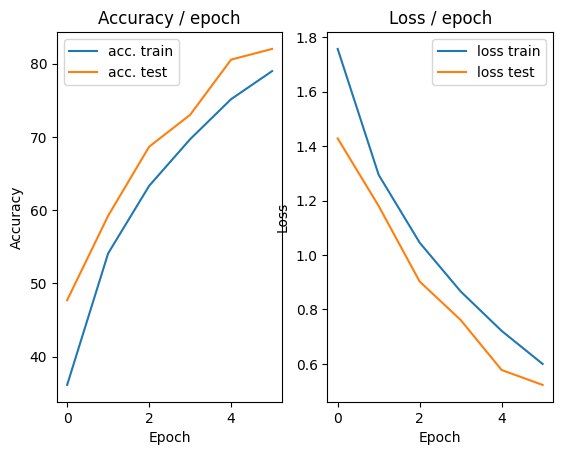

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.151s (0.151s)	Loss 0.5447 (0.5447)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


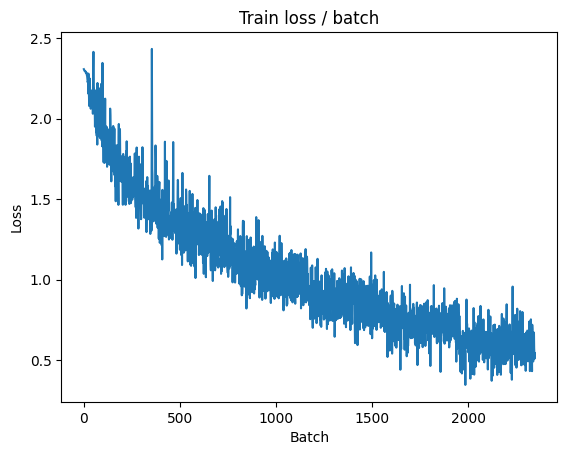

[TRAIN Batch 200/391]	Time 0.049s (0.037s)	Loss 0.4496 (0.4833)	Prec@1  85.2 ( 83.0)	Prec@5 100.0 ( 99.4)


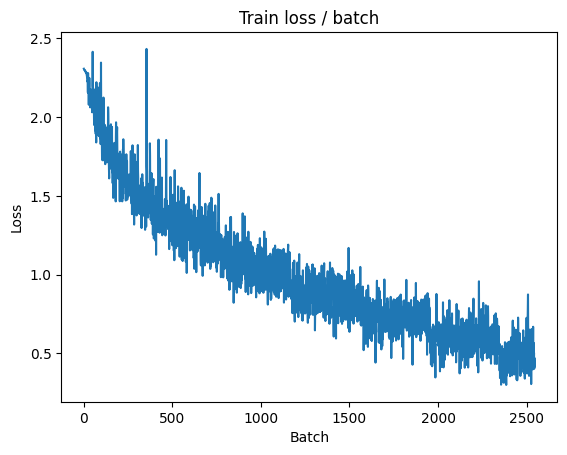


===============> Total time 13s	Avg loss 0.4900	Avg Prec@1 82.73 %	Avg Prec@5 99.35 %

[EVAL Batch 000/391]	Time 0.144s (0.144s)	Loss 0.3255 (0.3255)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.033s)	Loss 0.4914 (0.3877)	Prec@1  85.2 ( 86.9)	Prec@5  99.2 ( 99.6)

===============> Total time 11s	Avg loss 0.3876	Avg Prec@1 86.74 %	Avg Prec@5 99.64 %



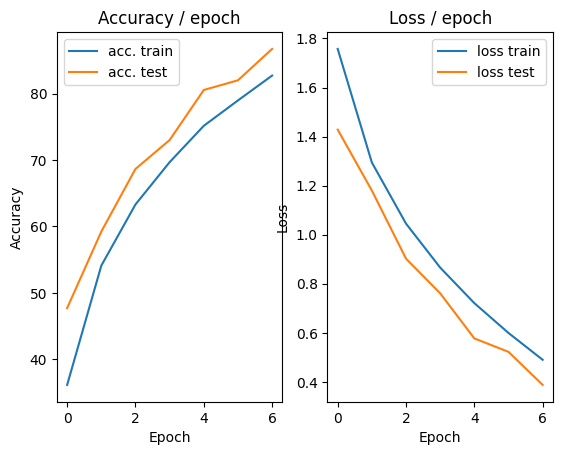

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.3220 (0.3220)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


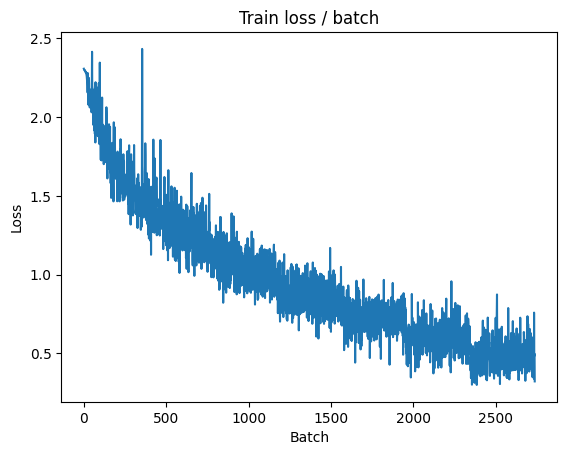

[TRAIN Batch 200/391]	Time 0.059s (0.037s)	Loss 0.3029 (0.3600)	Prec@1  90.6 ( 87.2)	Prec@5 100.0 ( 99.7)


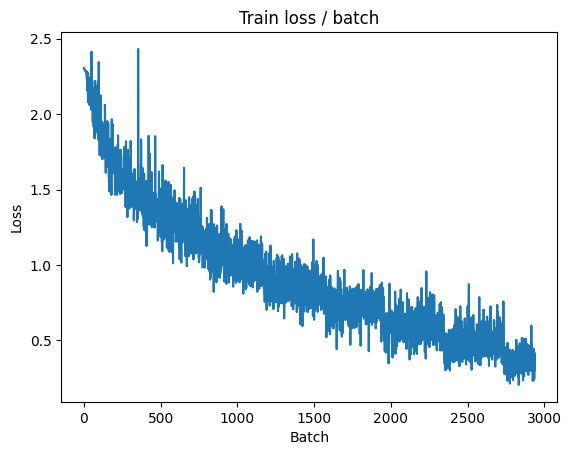


===============> Total time 13s	Avg loss 0.3792	Avg Prec@1 86.71 %	Avg Prec@5 99.68 %

[EVAL Batch 000/391]	Time 0.138s (0.138s)	Loss 0.3240 (0.3240)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)
[EVAL Batch 200/391]	Time 0.044s (0.034s)	Loss 0.4958 (0.3637)	Prec@1  85.9 ( 87.1)	Prec@5  99.2 ( 99.8)

===============> Total time 13s	Avg loss 0.3621	Avg Prec@1 87.13 %	Avg Prec@5 99.78 %



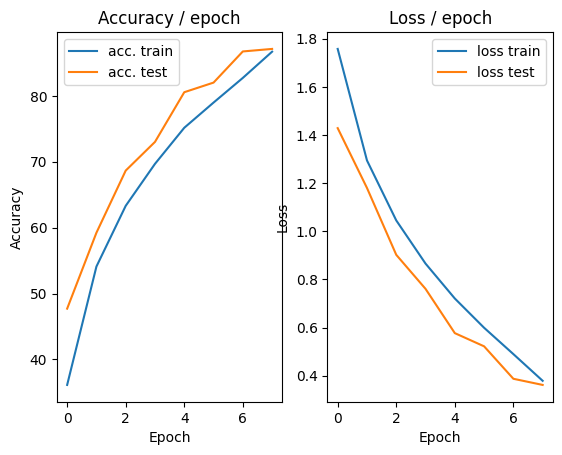

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 0.3835 (0.3835)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


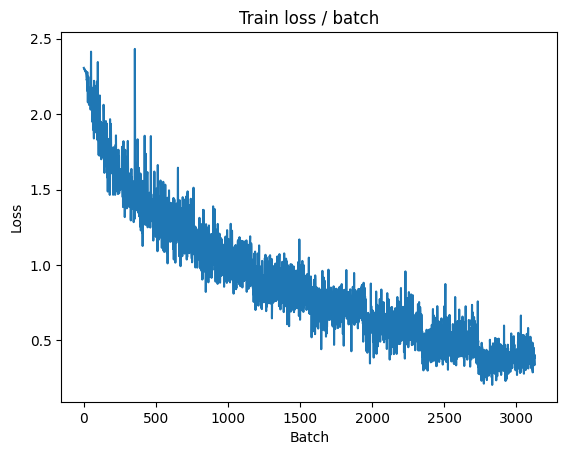

[TRAIN Batch 200/391]	Time 0.015s (0.038s)	Loss 0.2694 (0.2616)	Prec@1  90.6 ( 91.3)	Prec@5 100.0 ( 99.9)


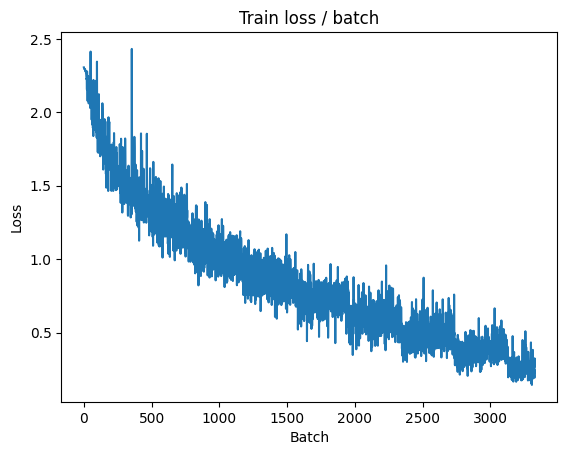


===============> Total time 14s	Avg loss 0.2794	Avg Prec@1 90.59 %	Avg Prec@5 99.84 %

[EVAL Batch 000/391]	Time 0.252s (0.252s)	Loss 0.2072 (0.2072)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.018s (0.031s)	Loss 0.2713 (0.1963)	Prec@1  91.4 ( 93.7)	Prec@5 100.0 ( 99.9)

===============> Total time 12s	Avg loss 0.1936	Avg Prec@1 93.79 %	Avg Prec@5 99.94 %



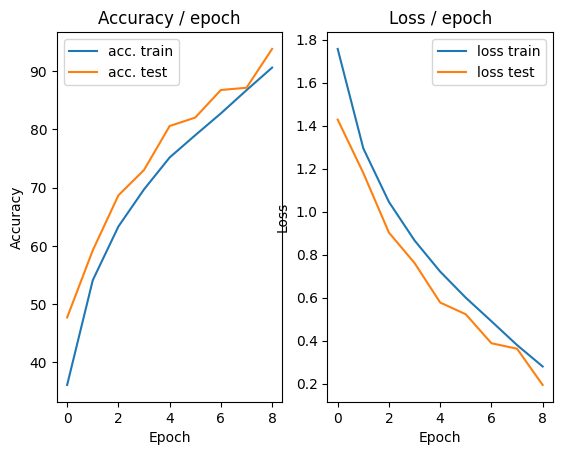

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.1698 (0.1698)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


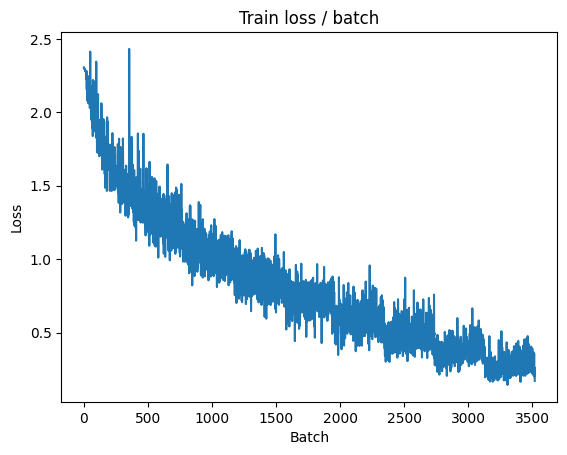

[TRAIN Batch 200/391]	Time 0.034s (0.034s)	Loss 0.1361 (0.1770)	Prec@1  94.5 ( 94.2)	Prec@5 100.0 ( 99.9)


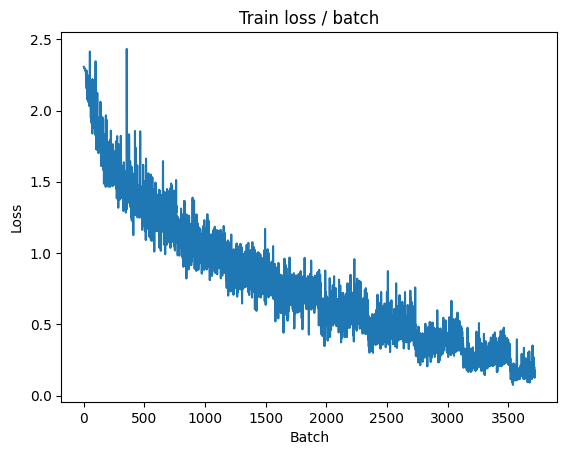


===============> Total time 13s	Avg loss 0.1920	Avg Prec@1 93.62 %	Avg Prec@5 99.92 %

[EVAL Batch 000/391]	Time 0.144s (0.144s)	Loss 0.1262 (0.1262)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.046s (0.034s)	Loss 0.1542 (0.1218)	Prec@1  95.3 ( 96.6)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.1193	Avg Prec@1 96.72 %	Avg Prec@5 99.98 %



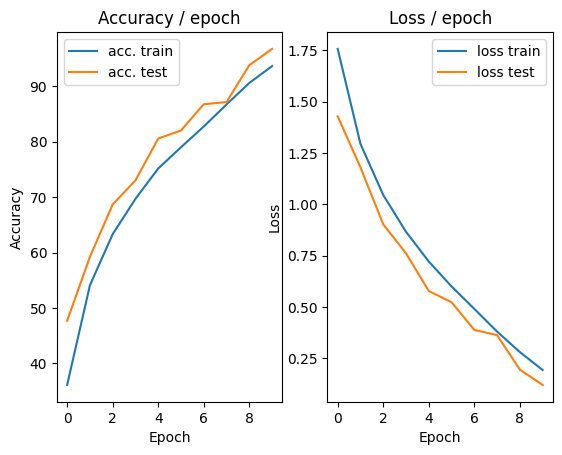

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.1737 (0.1737)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


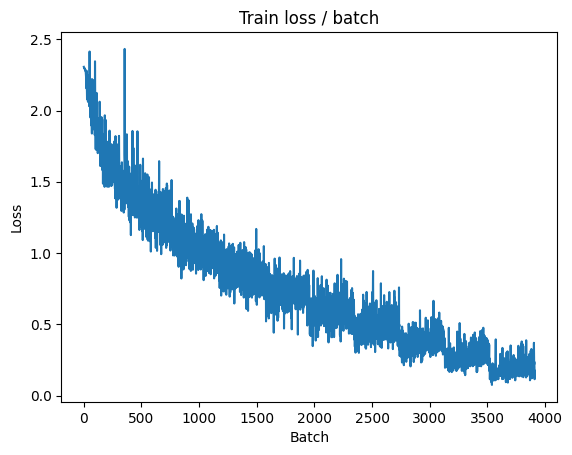

[TRAIN Batch 200/391]	Time 0.039s (0.035s)	Loss 0.0713 (0.1021)	Prec@1  98.4 ( 96.8)	Prec@5 100.0 (100.0)


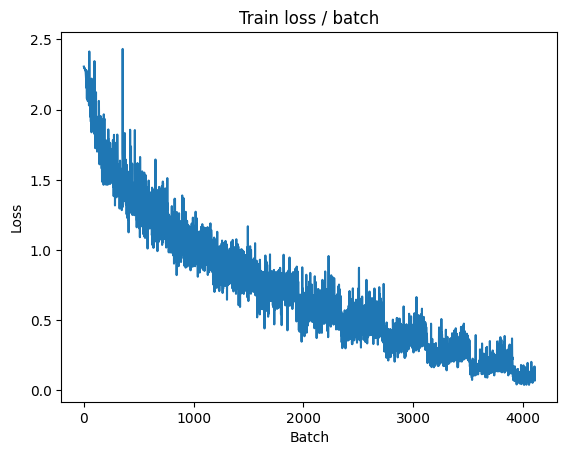


===============> Total time 13s	Avg loss 0.1187	Avg Prec@1 96.13 %	Avg Prec@5 99.98 %

[EVAL Batch 000/391]	Time 0.144s (0.144s)	Loss 0.0813 (0.0813)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.032s)	Loss 0.0972 (0.0748)	Prec@1  96.9 ( 98.1)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0738	Avg Prec@1 98.11 %	Avg Prec@5 100.00 %



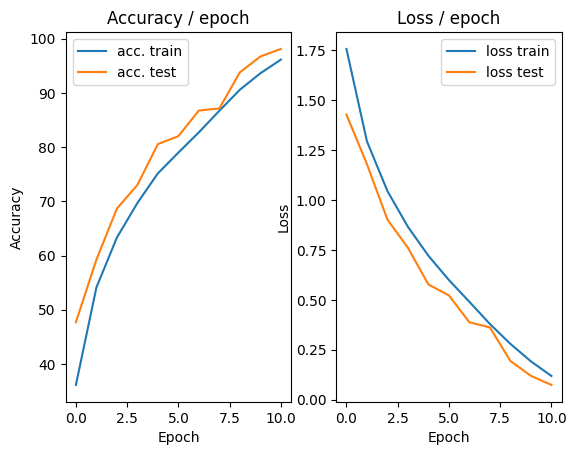

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.0900 (0.0900)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


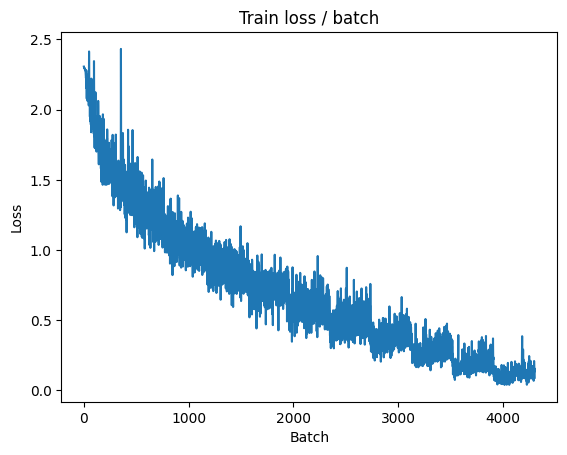

[TRAIN Batch 200/391]	Time 0.016s (0.036s)	Loss 0.0639 (0.0531)	Prec@1  98.4 ( 98.7)	Prec@5 100.0 (100.0)


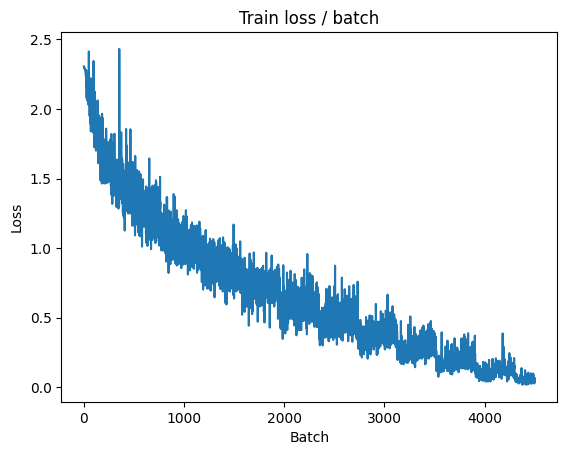


===============> Total time 15s	Avg loss 0.0605	Avg Prec@1 98.31 %	Avg Prec@5 99.99 %

[EVAL Batch 000/391]	Time 0.136s (0.136s)	Loss 0.0258 (0.0258)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.012s (0.035s)	Loss 0.0338 (0.0366)	Prec@1 100.0 ( 99.3)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0367	Avg Prec@1 99.22 %	Avg Prec@5 100.00 %



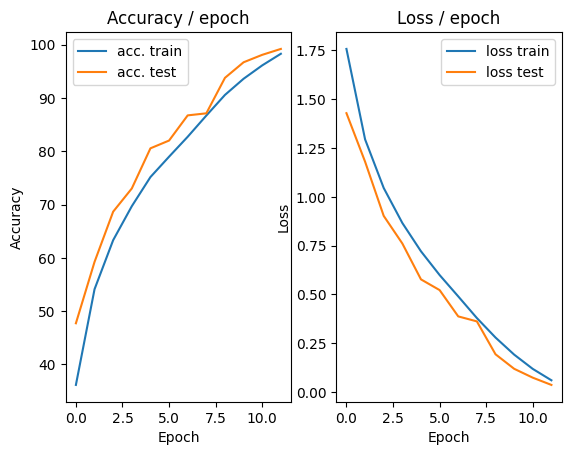

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.159s (0.159s)	Loss 0.0490 (0.0490)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


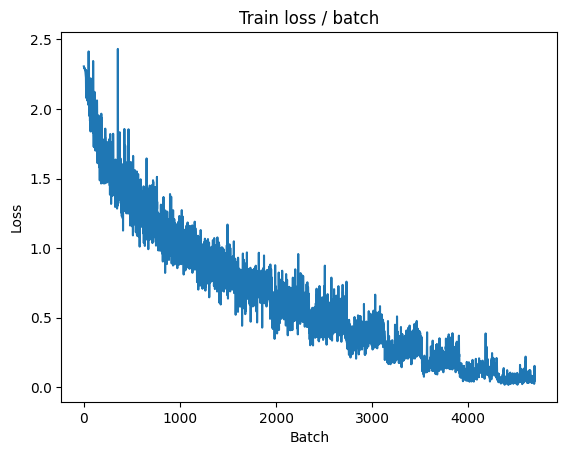

[TRAIN Batch 200/391]	Time 0.010s (0.037s)	Loss 0.0444 (0.0222)	Prec@1  98.4 ( 99.7)	Prec@5 100.0 (100.0)


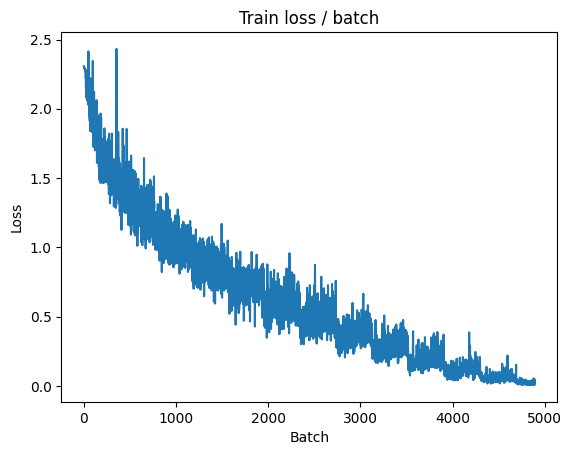


===============> Total time 13s	Avg loss 0.0248	Avg Prec@1 99.51 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.135s (0.135s)	Loss 0.0198 (0.0198)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.004s (0.034s)	Loss 0.0128 (0.0143)	Prec@1 100.0 ( 99.8)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0141	Avg Prec@1 99.80 %	Avg Prec@5 100.00 %



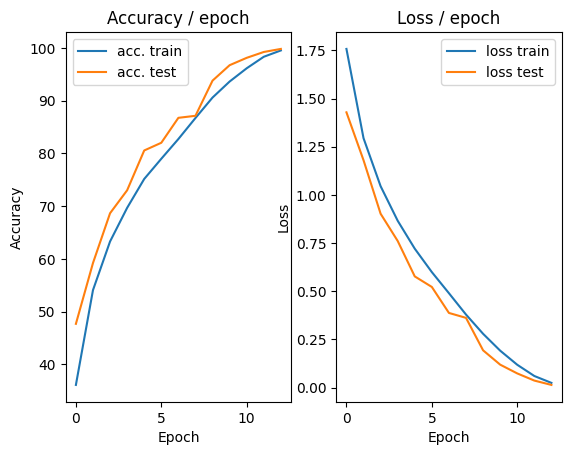

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.0072 (0.0072)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


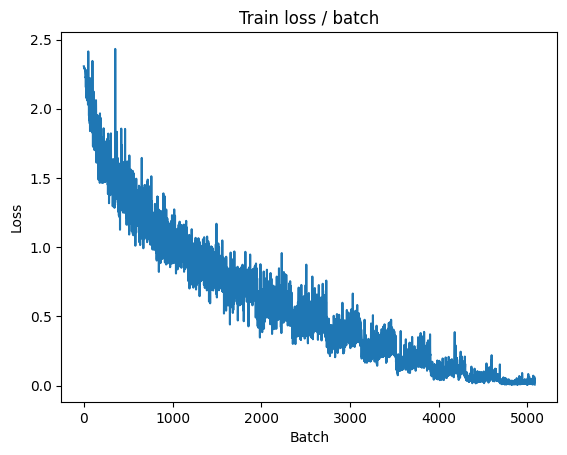

[TRAIN Batch 200/391]	Time 0.071s (0.044s)	Loss 0.0051 (0.0093)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


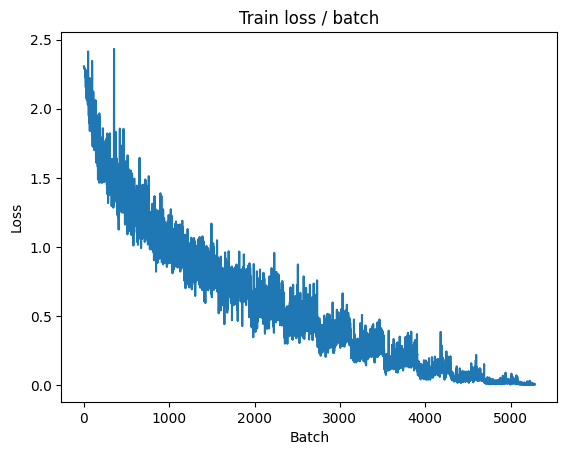


===============> Total time 16s	Avg loss 0.0093	Avg Prec@1 99.90 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.229s (0.229s)	Loss 0.0027 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.030s)	Loss 0.0083 (0.0067)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0062	Avg Prec@1 99.94 %	Avg Prec@5 100.00 %



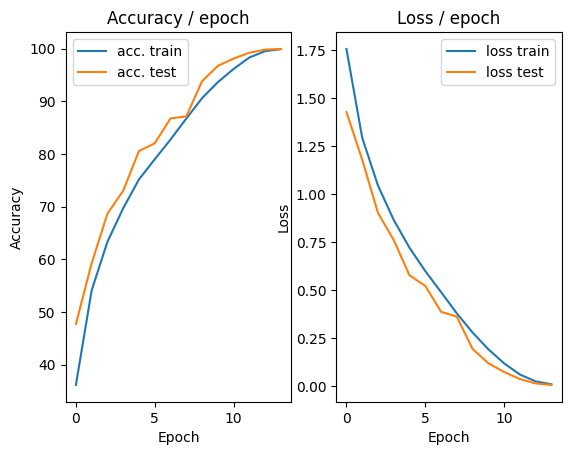

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.0040 (0.0040)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


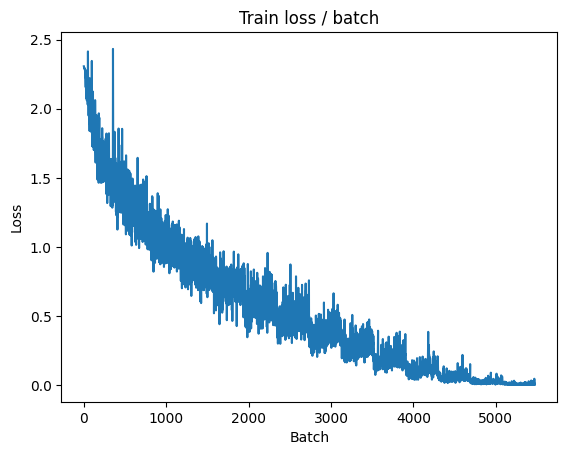

[TRAIN Batch 200/391]	Time 0.044s (0.034s)	Loss 0.0021 (0.0044)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


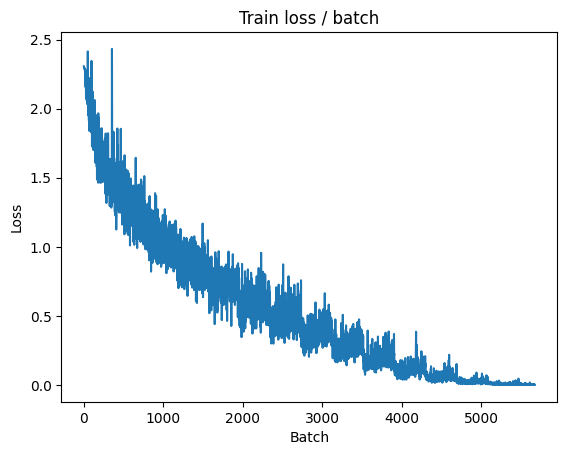


===============> Total time 14s	Avg loss 0.0039	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.143s (0.143s)	Loss 0.0016 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.036s (0.029s)	Loss 0.0028 (0.0023)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0023	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



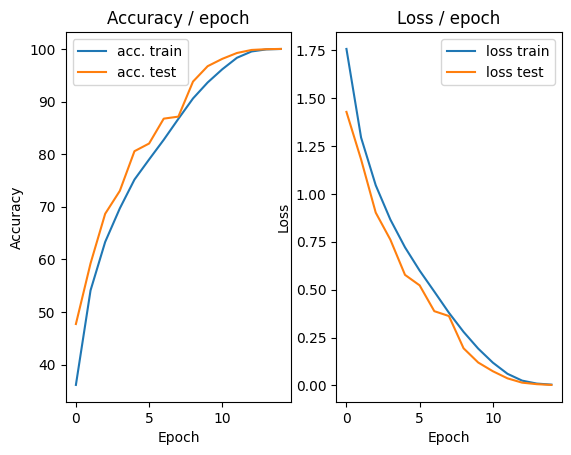

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.0034 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


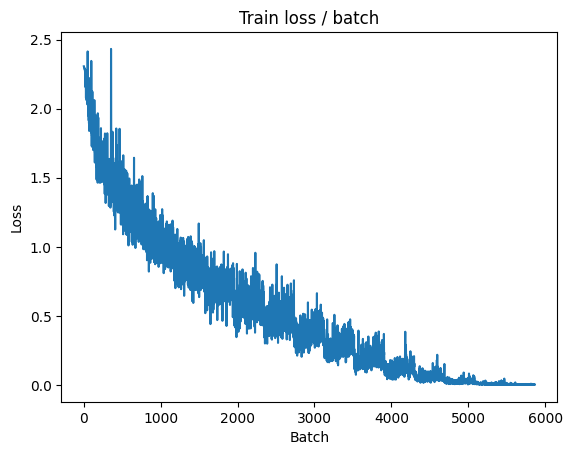

[TRAIN Batch 200/391]	Time 0.017s (0.043s)	Loss 0.0011 (0.0022)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


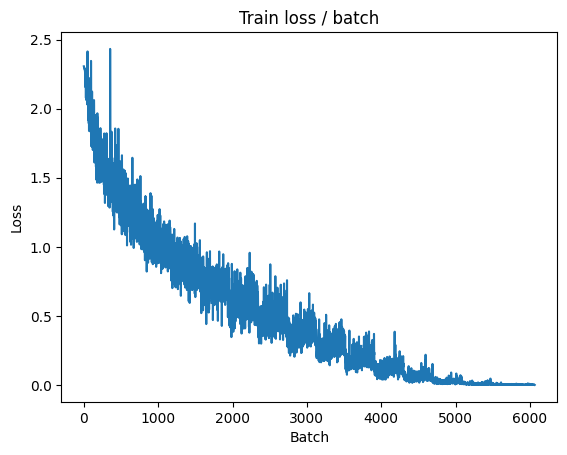


===============> Total time 16s	Avg loss 0.0021	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.154s (0.154s)	Loss 0.0010 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.004s (0.036s)	Loss 0.0030 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0016	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



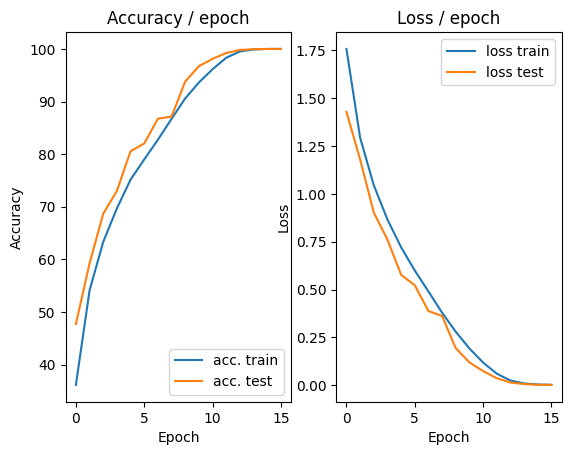

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.0012 (0.0012)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


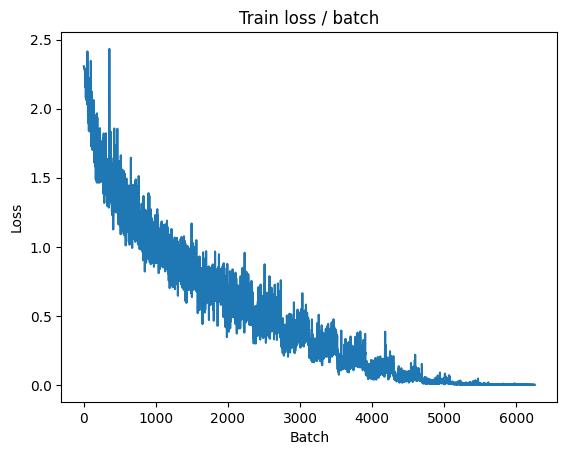

[TRAIN Batch 200/391]	Time 0.015s (0.038s)	Loss 0.0024 (0.0016)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


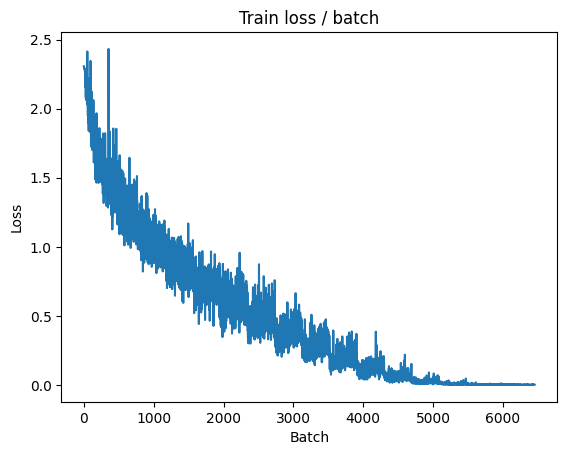


===============> Total time 14s	Avg loss 0.0016	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.132s (0.132s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.057s (0.035s)	Loss 0.0020 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0013	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



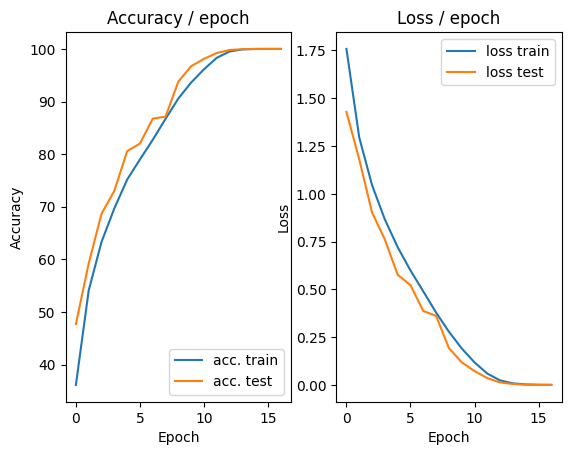

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


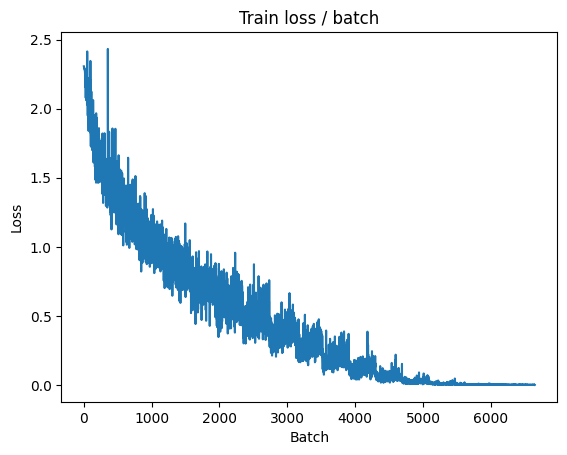

[TRAIN Batch 200/391]	Time 0.035s (0.038s)	Loss 0.0012 (0.0013)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


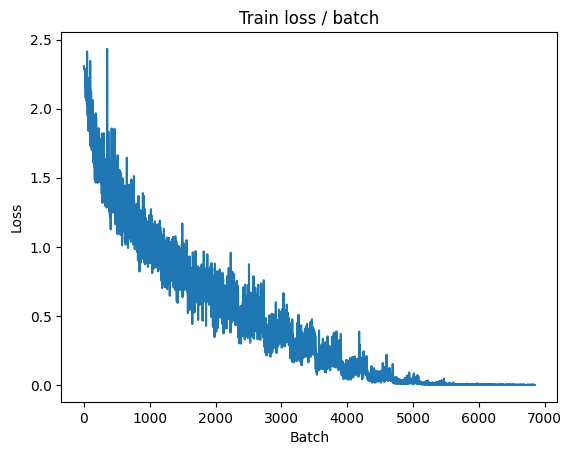


===============> Total time 15s	Avg loss 0.0013	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.254s (0.254s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.002s (0.031s)	Loss 0.0017 (0.0012)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0011	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



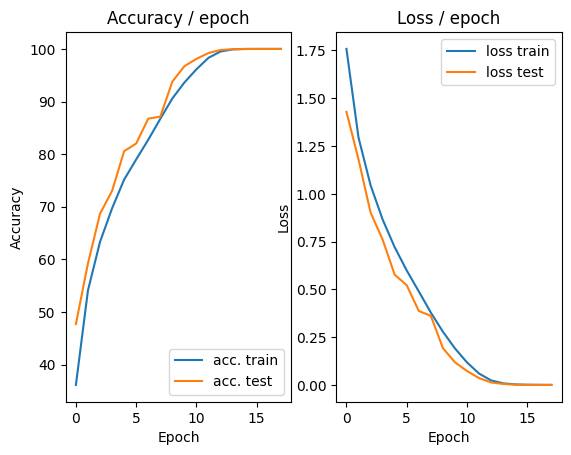

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.287s (0.287s)	Loss 0.0011 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


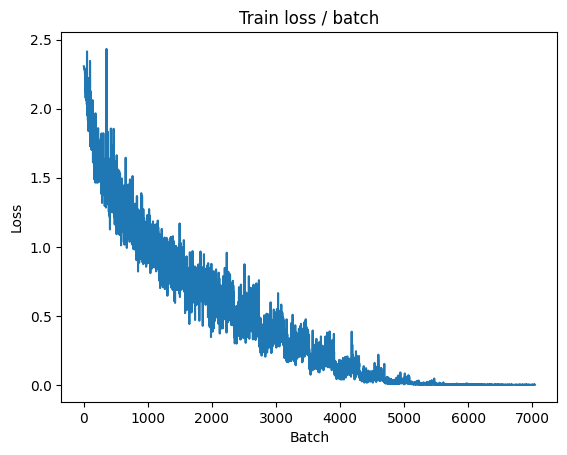

[TRAIN Batch 200/391]	Time 0.023s (0.034s)	Loss 0.0013 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


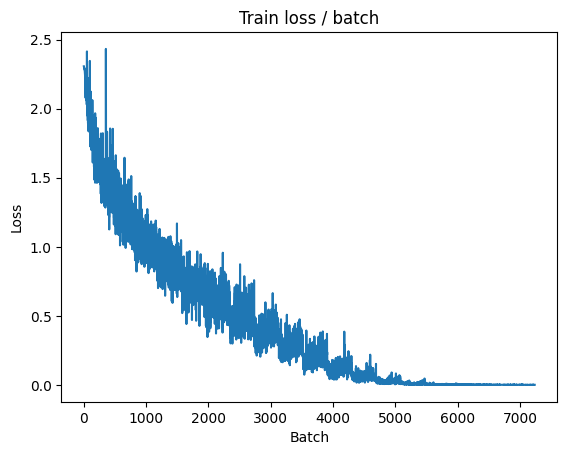


===============> Total time 14s	Avg loss 0.0011	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.144s (0.144s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.051s (0.034s)	Loss 0.0017 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0010	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



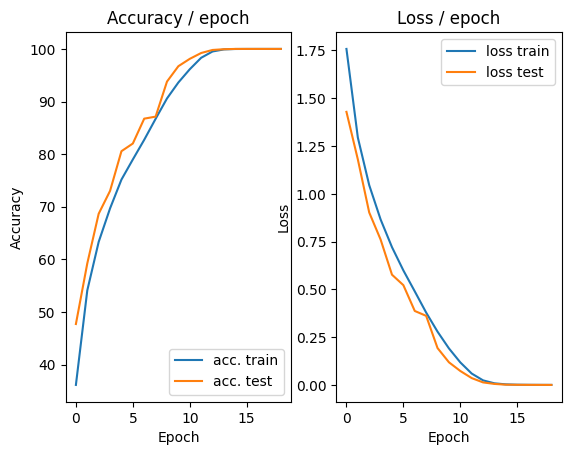

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0009 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


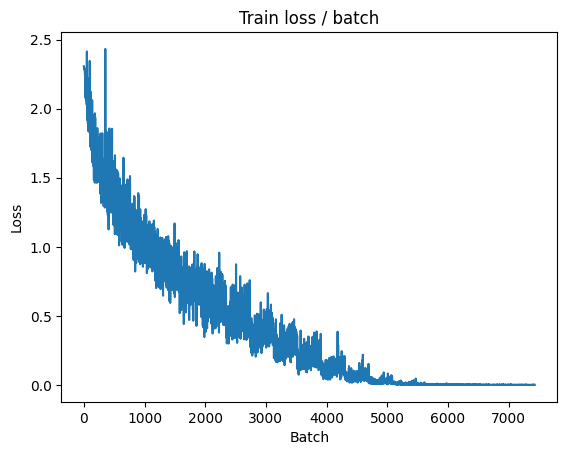

[TRAIN Batch 200/391]	Time 0.009s (0.034s)	Loss 0.0012 (0.0010)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


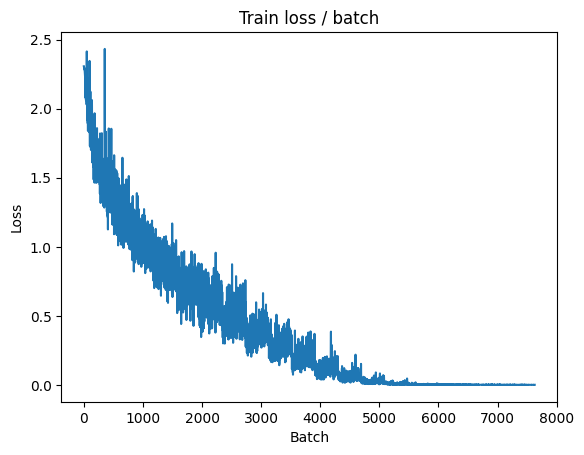


===============> Total time 14s	Avg loss 0.0010	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.142s (0.142s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.058s (0.030s)	Loss 0.0011 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0009	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



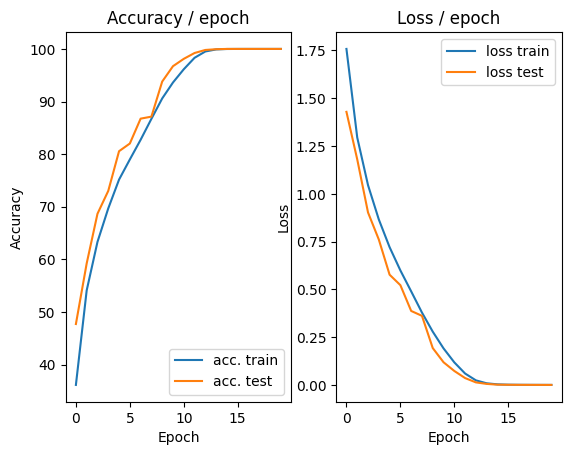

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.0011 (0.0011)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


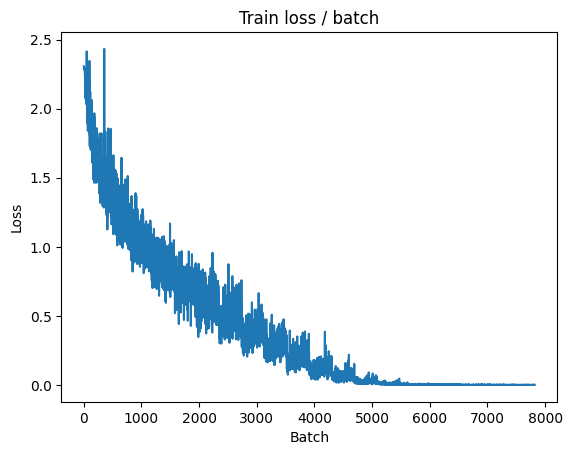

[TRAIN Batch 200/391]	Time 0.066s (0.040s)	Loss 0.0015 (0.0009)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


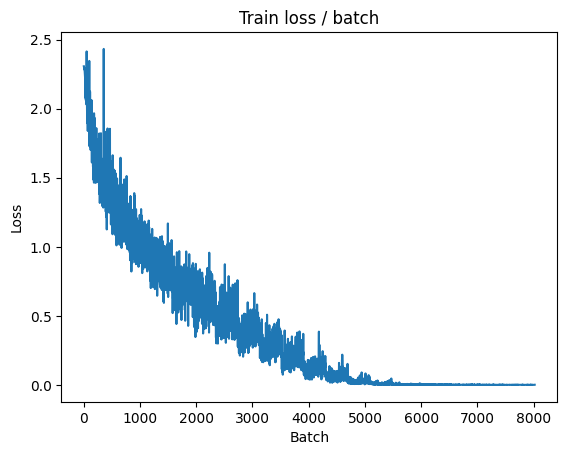


===============> Total time 16s	Avg loss 0.0009	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.047s (0.034s)	Loss 0.0010 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0008	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



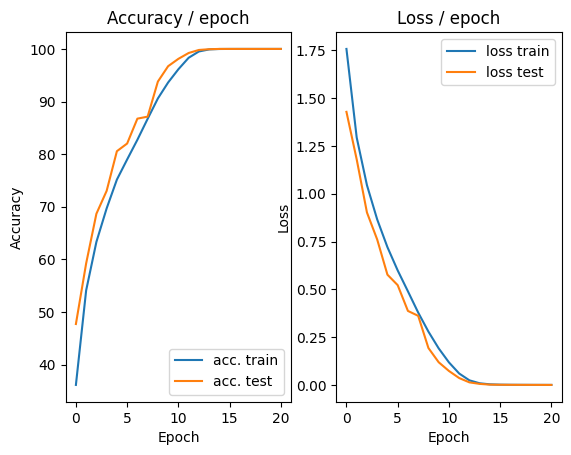

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


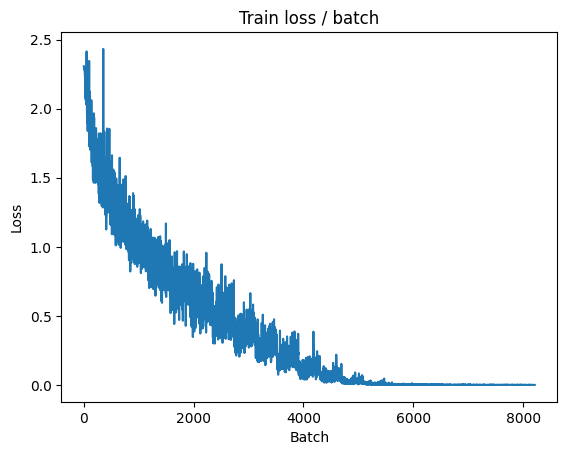

[TRAIN Batch 200/391]	Time 0.054s (0.040s)	Loss 0.0012 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


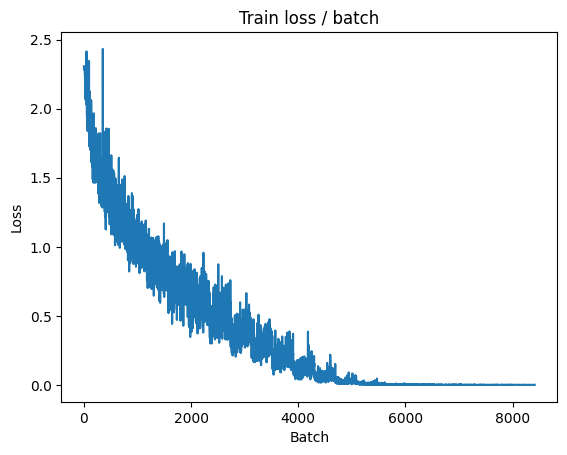


===============> Total time 14s	Avg loss 0.0008	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.215s (0.215s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.075s (0.035s)	Loss 0.0010 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



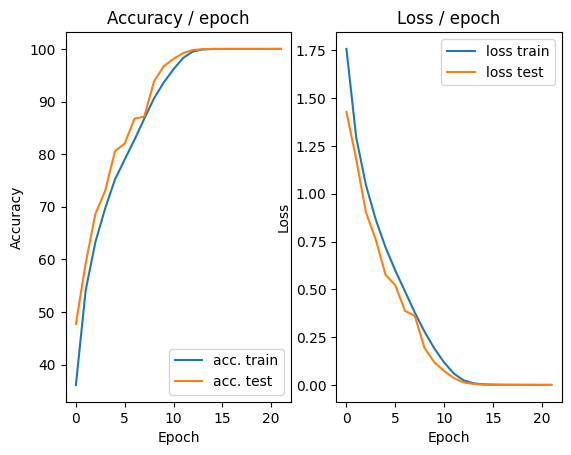

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.249s (0.249s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


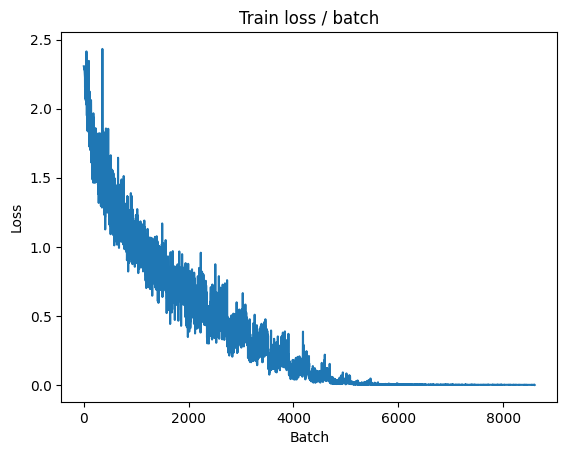

[TRAIN Batch 200/391]	Time 0.046s (0.042s)	Loss 0.0005 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


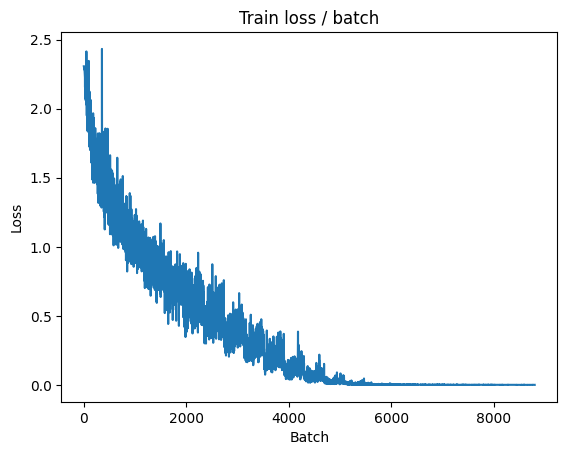


===============> Total time 16s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.150s (0.150s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.035s (0.031s)	Loss 0.0009 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



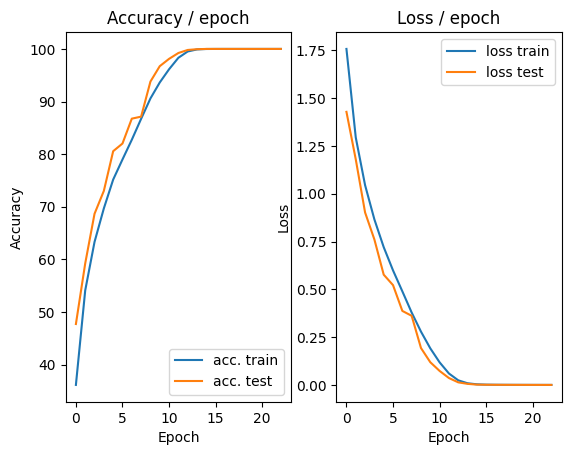

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


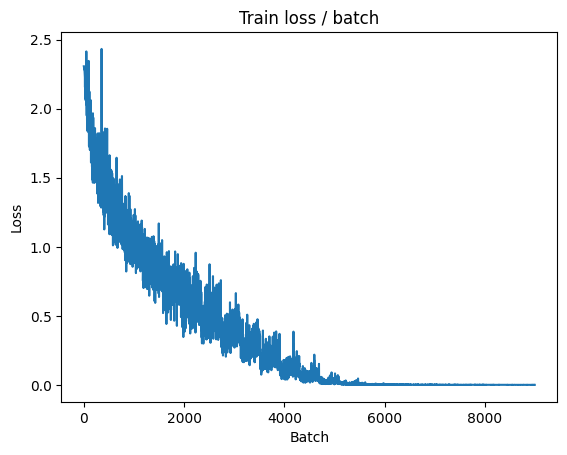

[TRAIN Batch 200/391]	Time 0.019s (0.037s)	Loss 0.0010 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


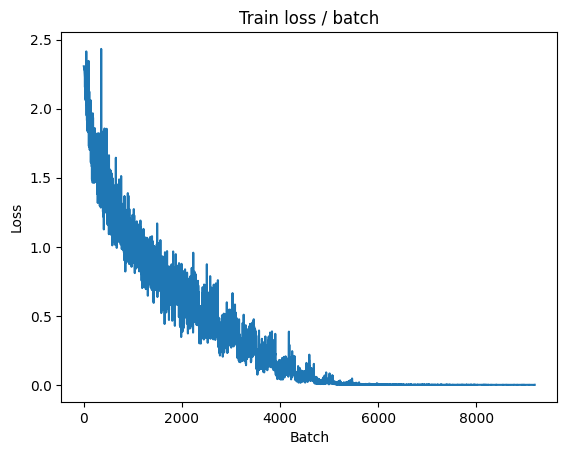


===============> Total time 15s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.198s (0.198s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.039s)	Loss 0.0008 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 14s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



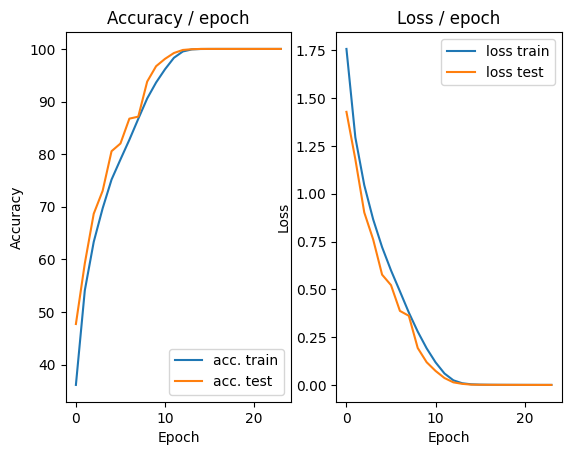

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.0008 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


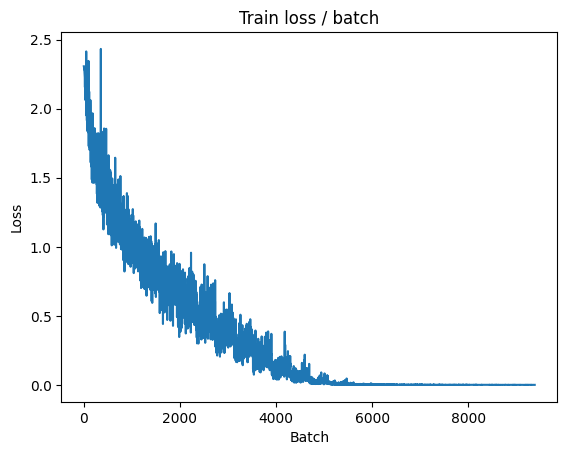

[TRAIN Batch 200/391]	Time 0.052s (0.039s)	Loss 0.0005 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


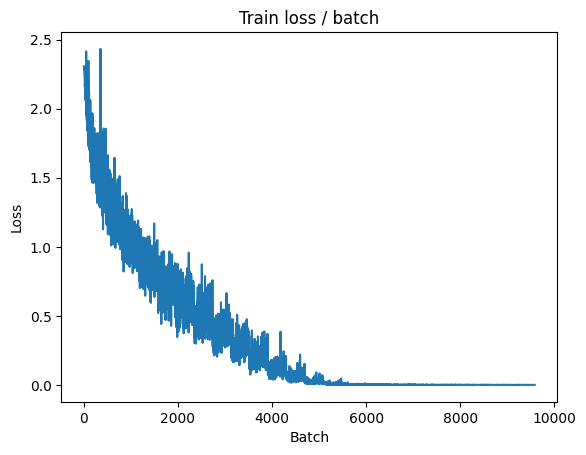


===============> Total time 14s	Avg loss 0.0007	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.140s (0.140s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.035s)	Loss 0.0008 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



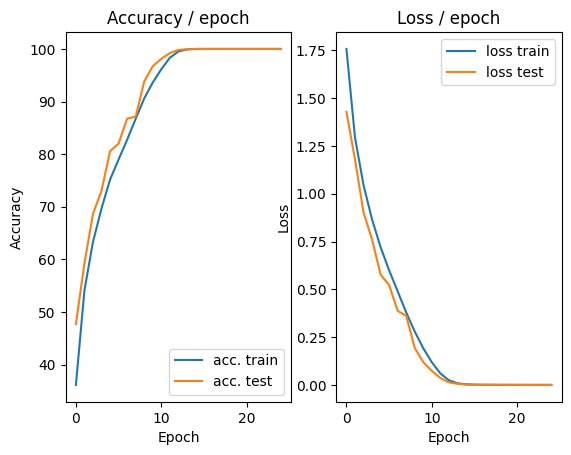

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


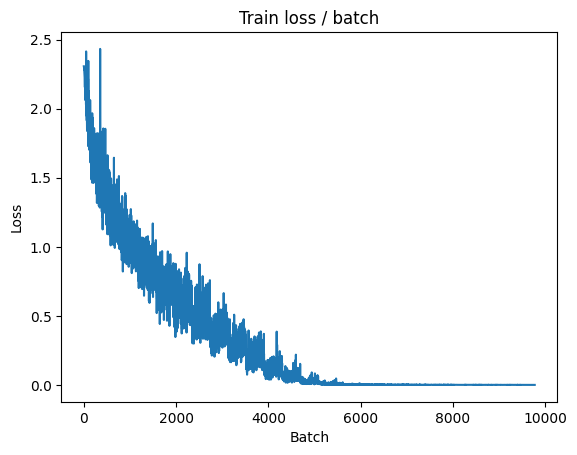

[TRAIN Batch 200/391]	Time 0.016s (0.038s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


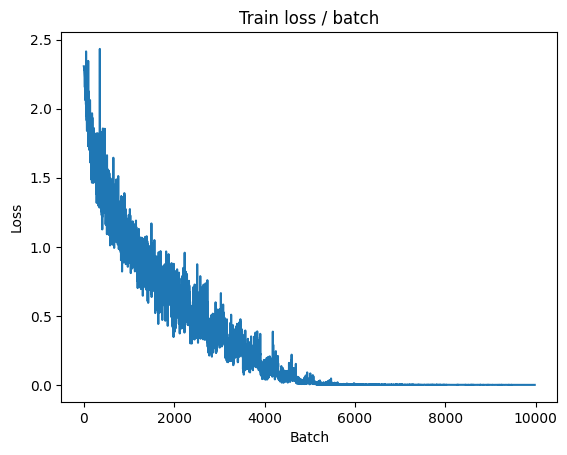


===============> Total time 14s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.194s (0.194s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.047s (0.035s)	Loss 0.0008 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 14s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



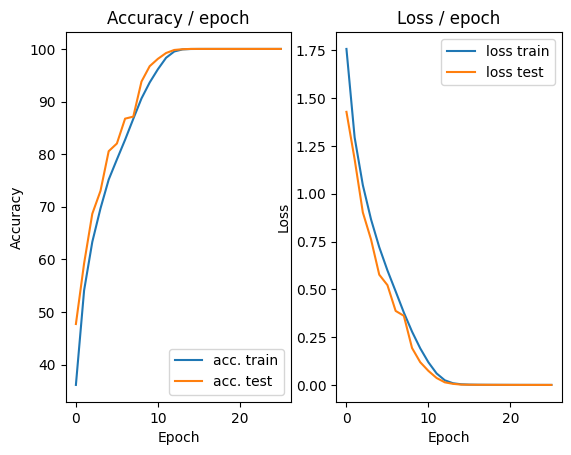

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


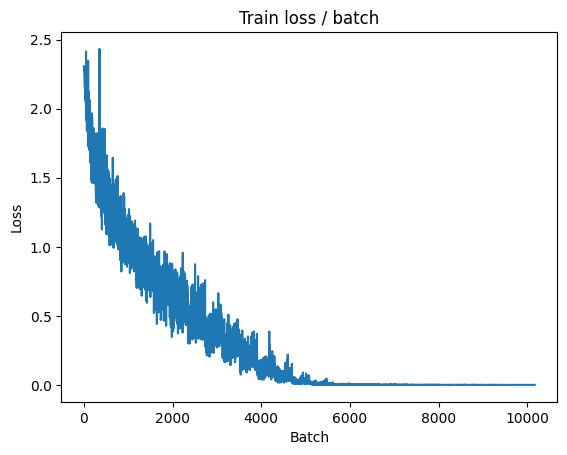

[TRAIN Batch 200/391]	Time 0.014s (0.041s)	Loss 0.0005 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


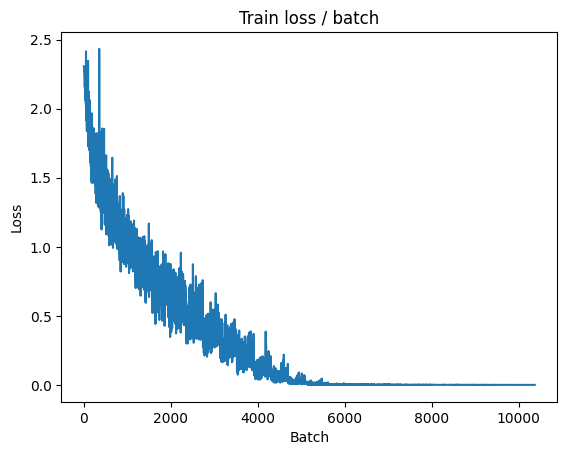


===============> Total time 15s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.028s (0.029s)	Loss 0.0008 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



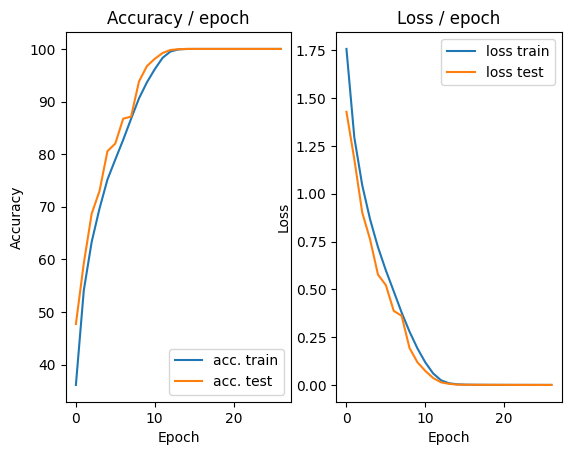

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


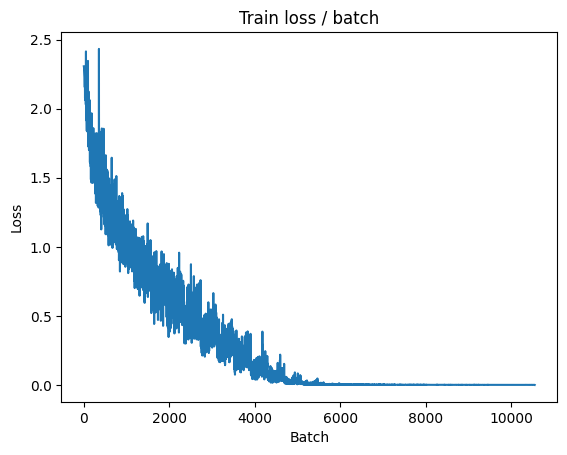

[TRAIN Batch 200/391]	Time 0.114s (0.036s)	Loss 0.0004 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


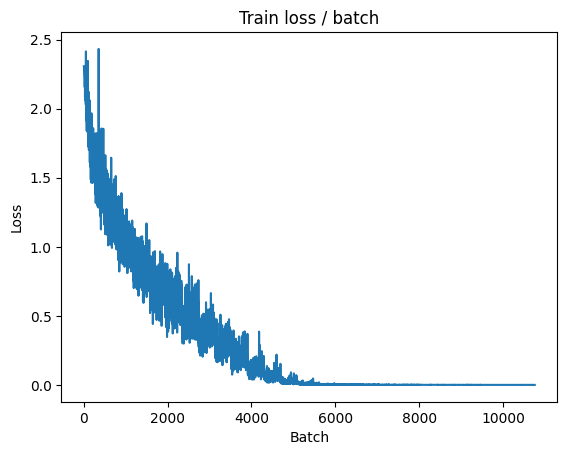


===============> Total time 15s	Avg loss 0.0006	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.192s (0.192s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.003s (0.036s)	Loss 0.0008 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



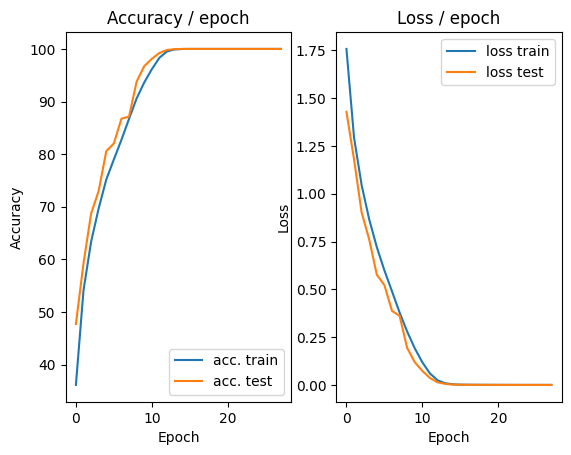

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


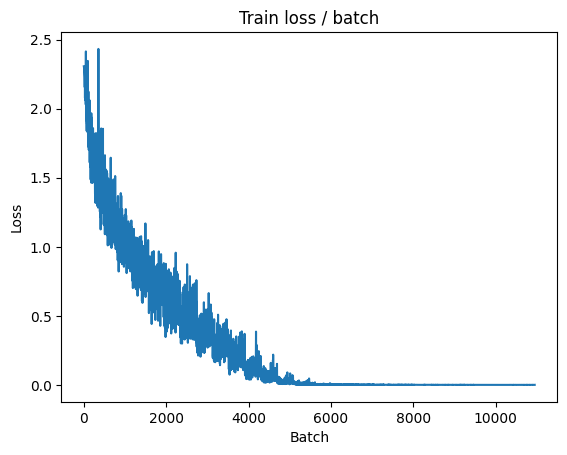

[TRAIN Batch 200/391]	Time 0.050s (0.040s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


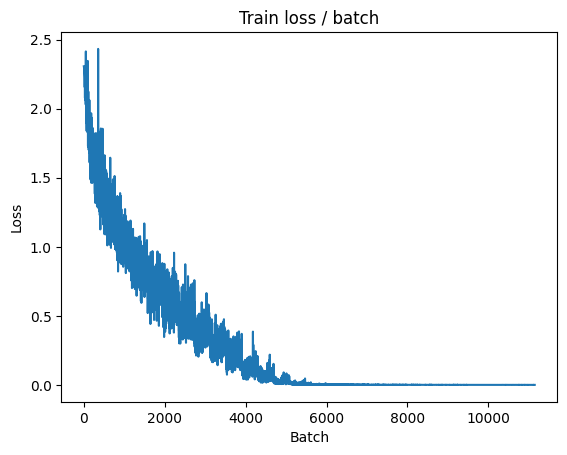


===============> Total time 14s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.153s (0.153s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.008s (0.038s)	Loss 0.0007 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



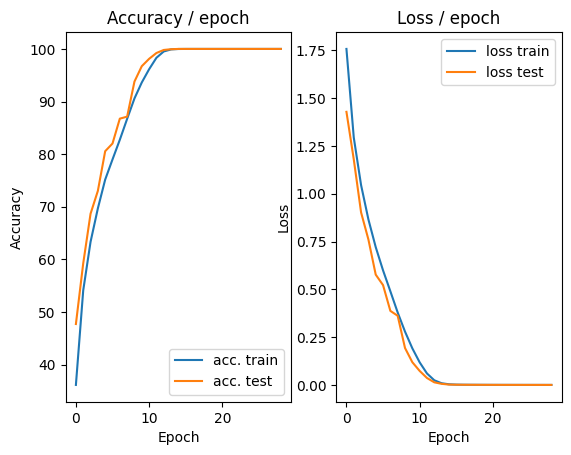

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.203s (0.203s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


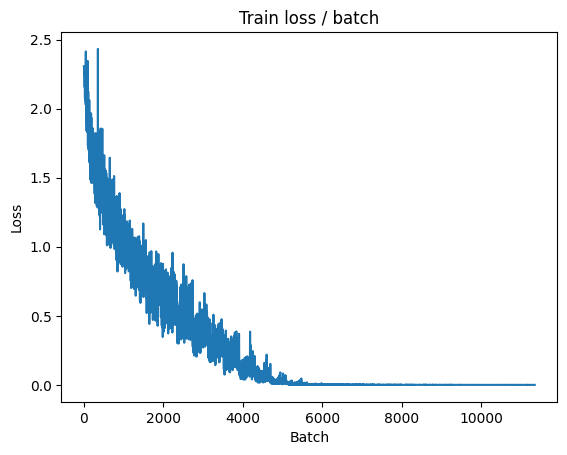

[TRAIN Batch 200/391]	Time 0.050s (0.042s)	Loss 0.0004 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


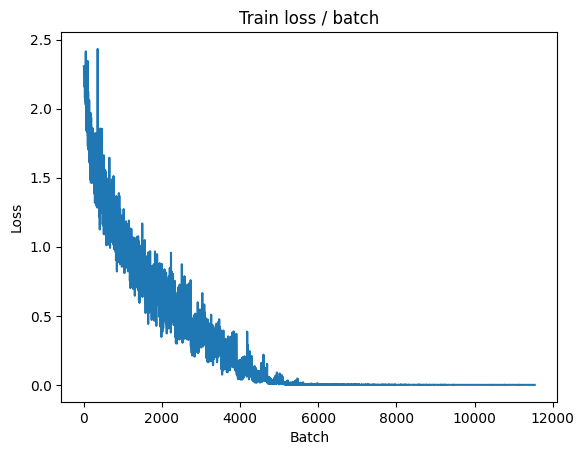


===============> Total time 15s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.152s (0.152s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.054s (0.030s)	Loss 0.0007 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



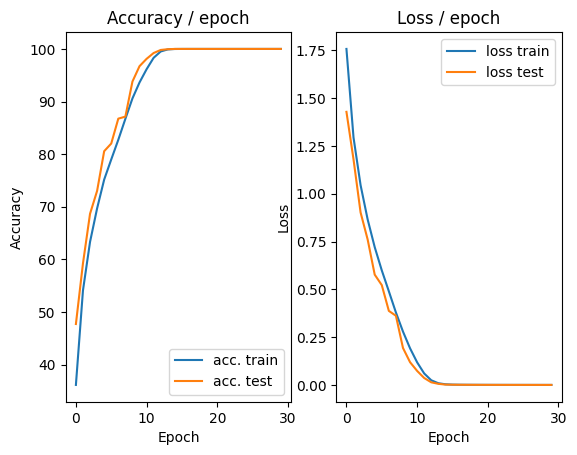

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


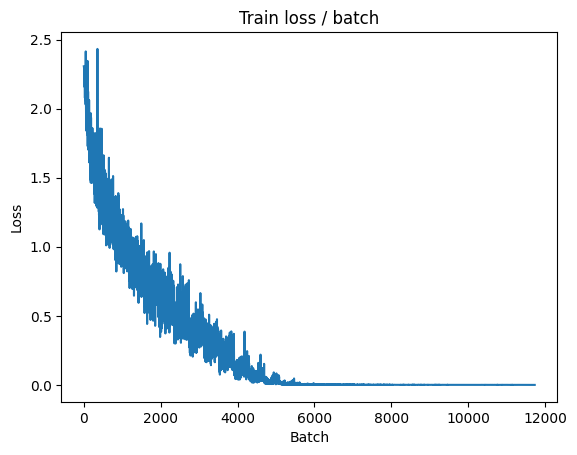

[TRAIN Batch 200/391]	Time 0.036s (0.033s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


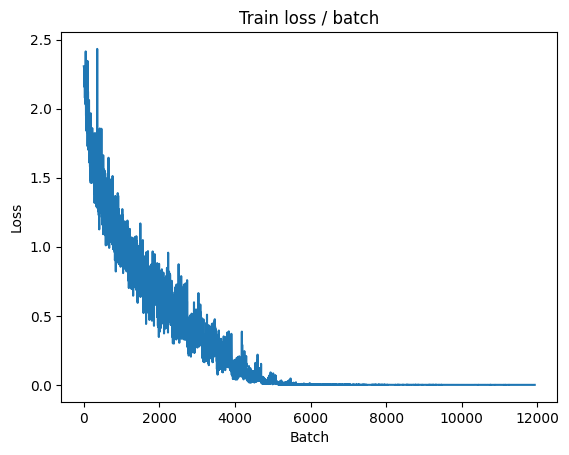


===============> Total time 13s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.148s (0.148s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.033s (0.030s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



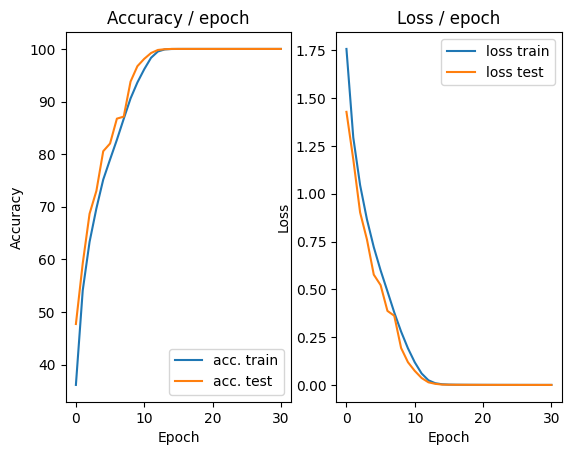

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


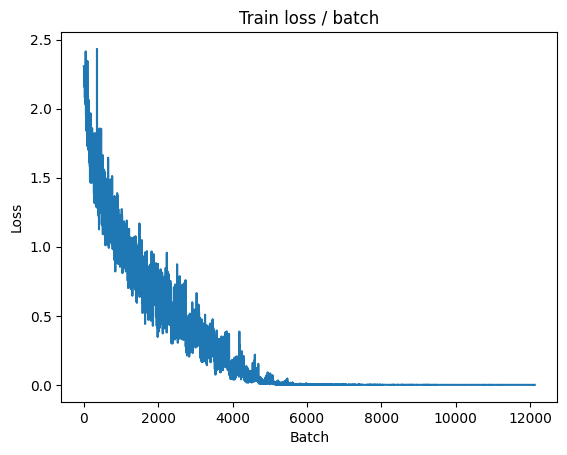

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


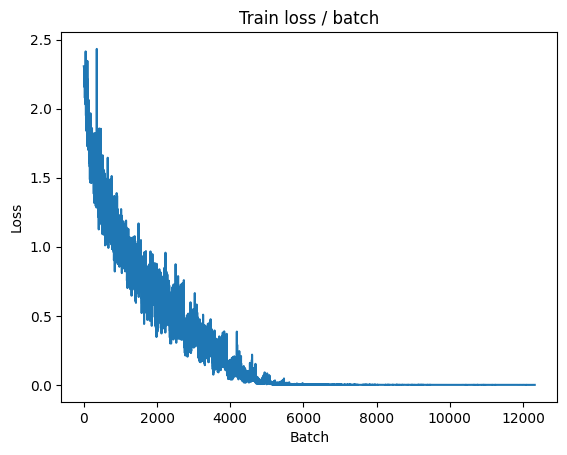


===============> Total time 16s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.149s (0.149s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.059s (0.035s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



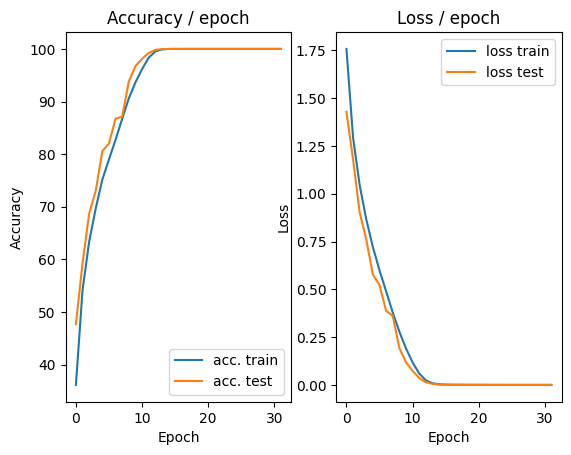

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


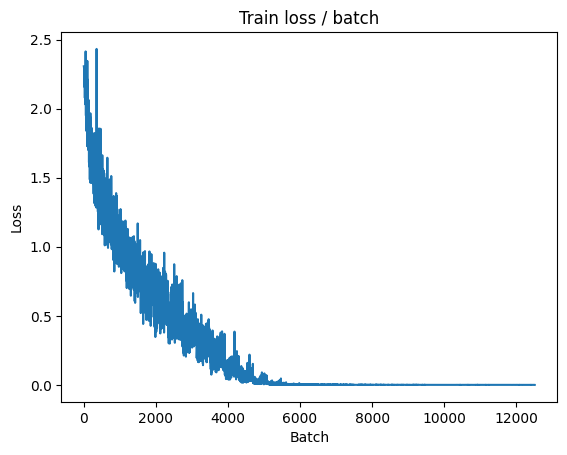

[TRAIN Batch 200/391]	Time 0.049s (0.038s)	Loss 0.0003 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


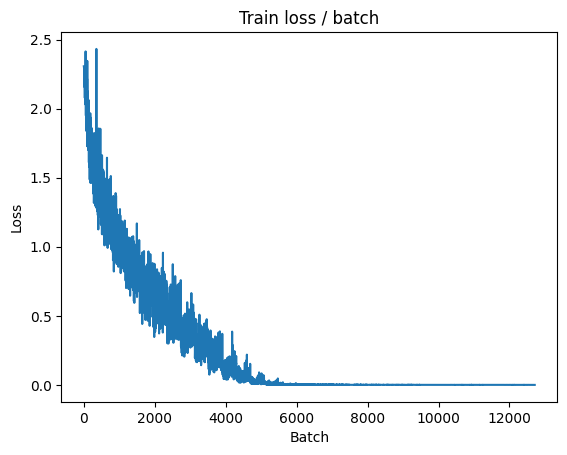


===============> Total time 13s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.143s (0.143s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.056s (0.036s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



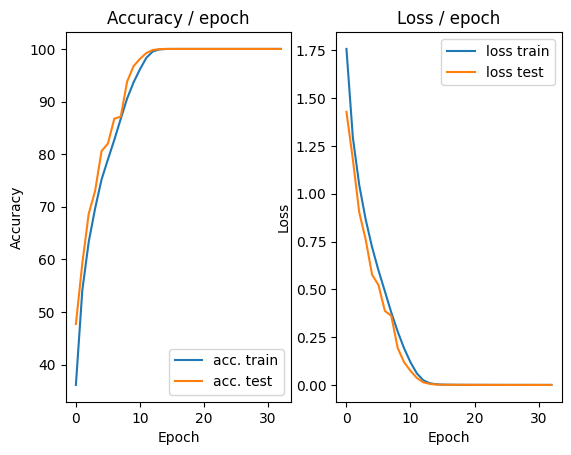

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


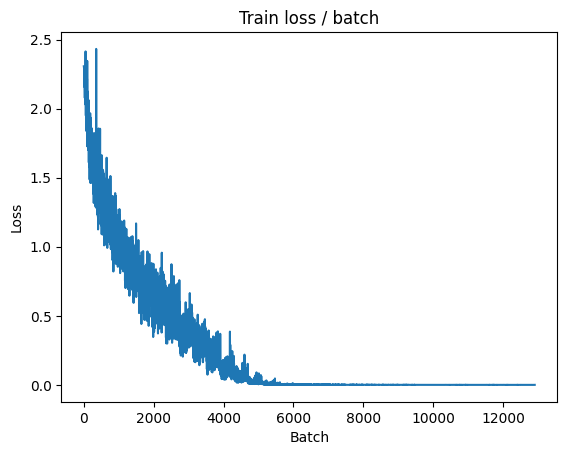

[TRAIN Batch 200/391]	Time 0.055s (0.044s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


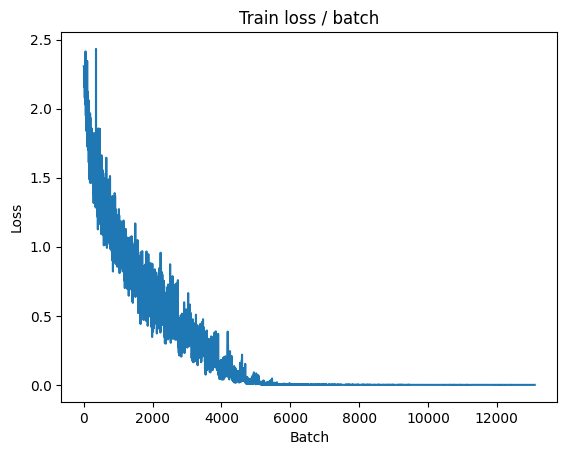


===============> Total time 15s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.058s (0.030s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



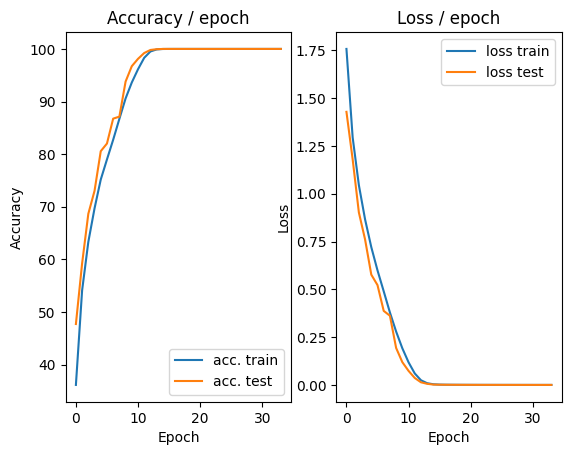

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


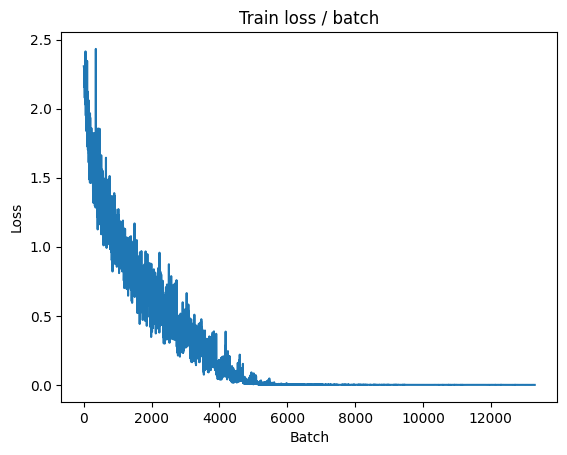

[TRAIN Batch 200/391]	Time 0.036s (0.034s)	Loss 0.0006 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


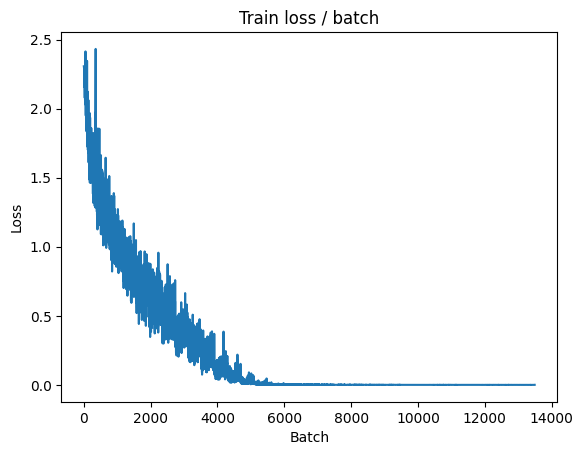


===============> Total time 14s	Avg loss 0.0005	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.152s (0.152s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.008s (0.030s)	Loss 0.0006 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



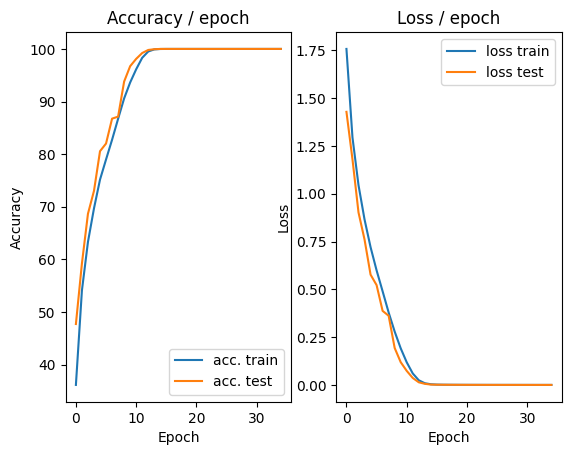

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


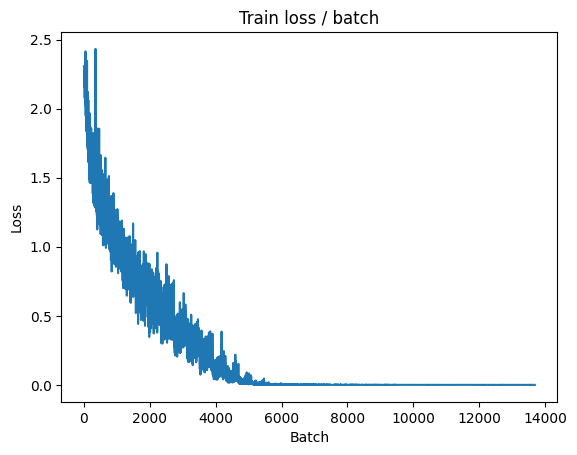

[TRAIN Batch 200/391]	Time 0.044s (0.037s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


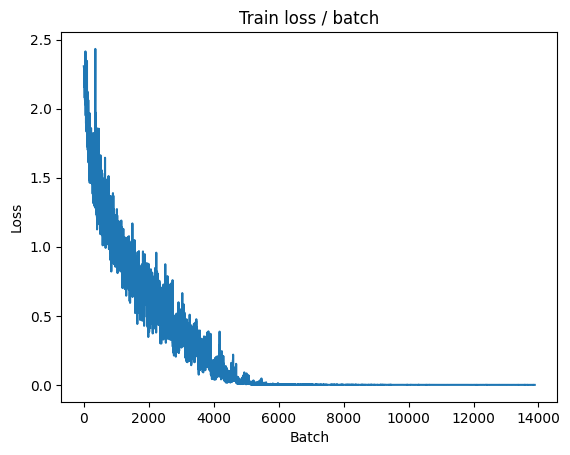


===============> Total time 14s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.170s (0.170s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.092s (0.031s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



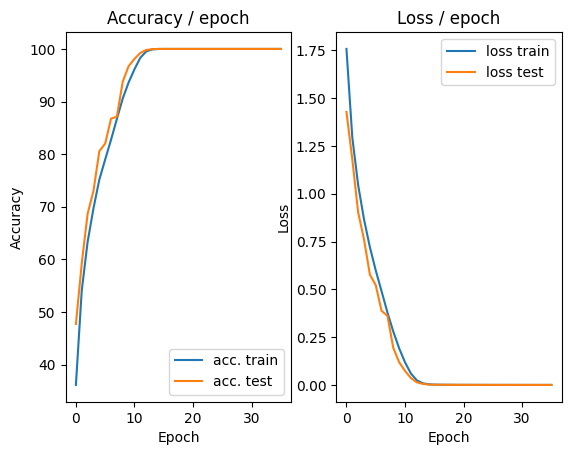

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


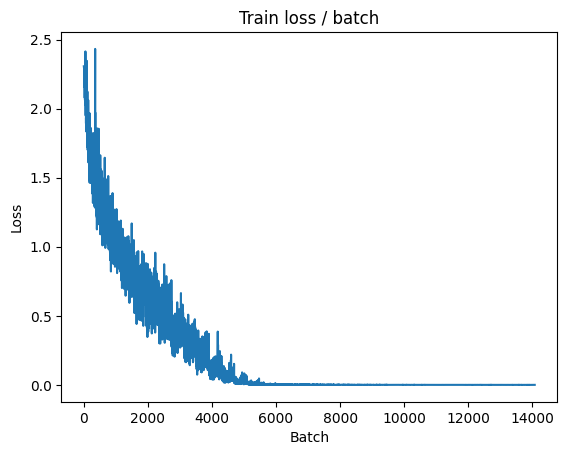

[TRAIN Batch 200/391]	Time 0.017s (0.039s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


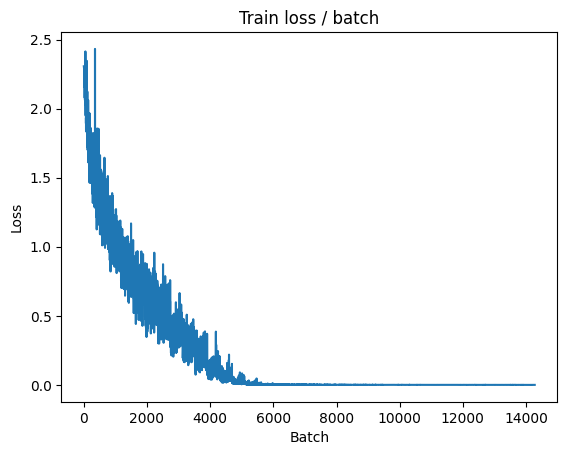


===============> Total time 14s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.146s (0.146s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.006s (0.035s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



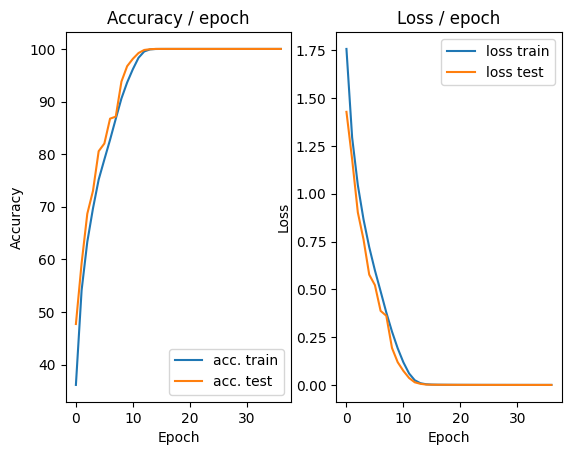

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


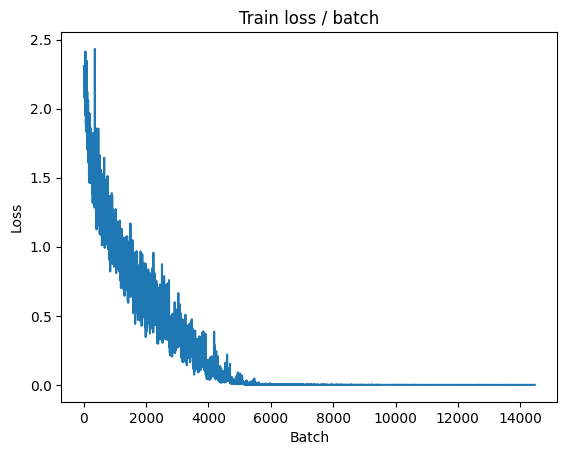

[TRAIN Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


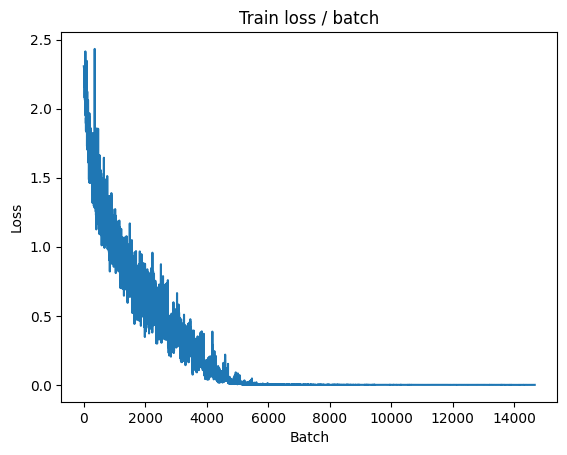


===============> Total time 13s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.164s (0.164s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.044s (0.036s)	Loss 0.0006 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



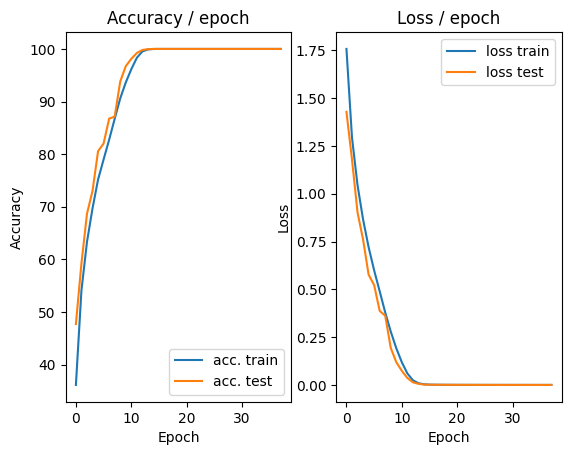

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.196s (0.196s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


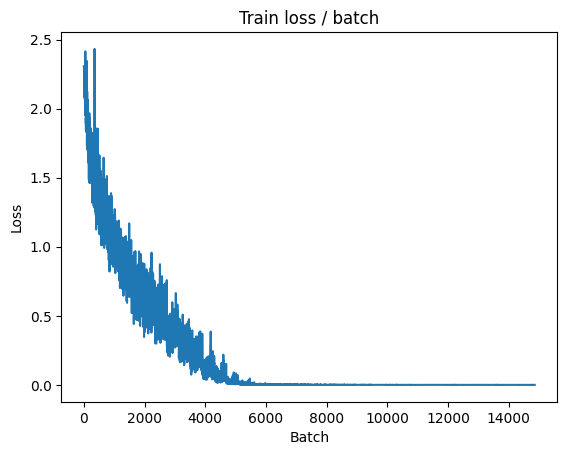

[TRAIN Batch 200/391]	Time 0.051s (0.038s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


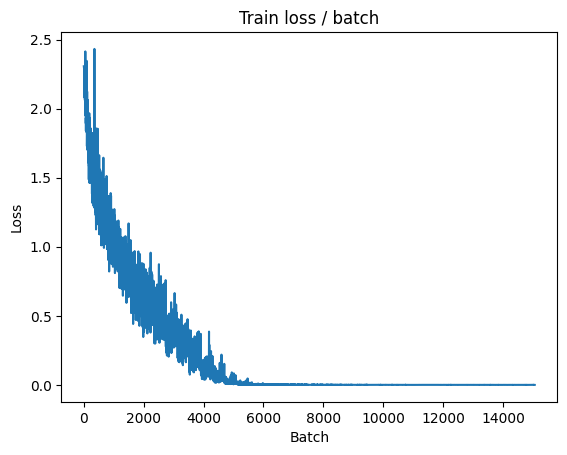


===============> Total time 14s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.257s (0.257s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.054s (0.038s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 13s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



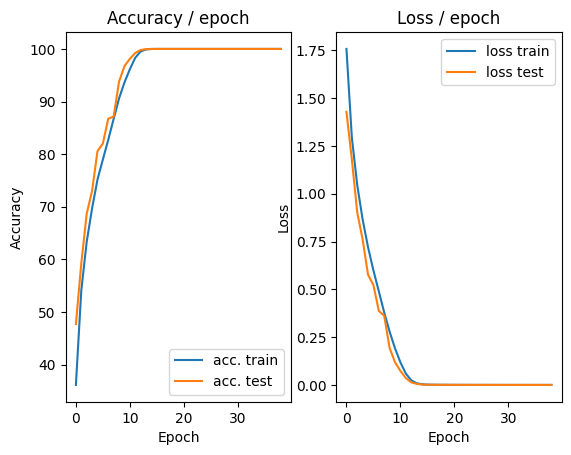

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.0007 (0.0007)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


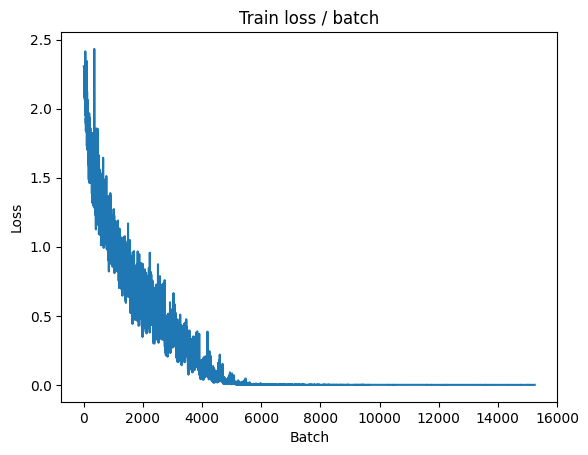

[TRAIN Batch 200/391]	Time 0.015s (0.033s)	Loss 0.0003 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


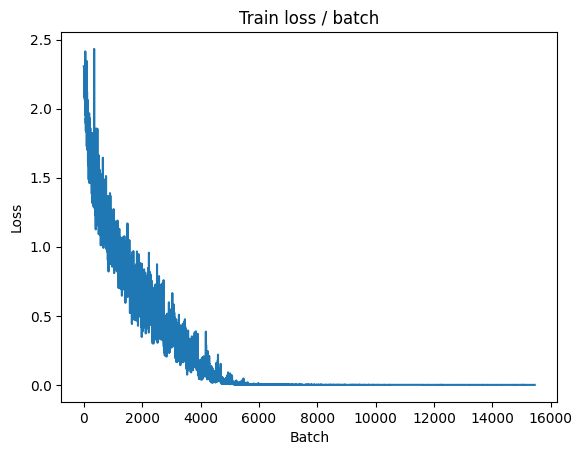


===============> Total time 13s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/391]	Time 0.147s (0.147s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)
[EVAL Batch 200/391]	Time 0.030s (0.030s)	Loss 0.0005 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 12s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %



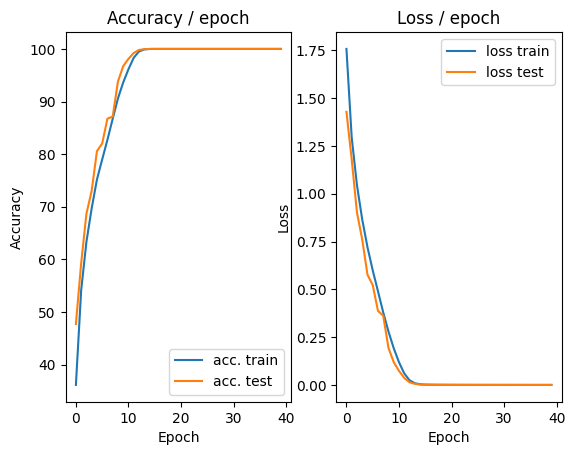

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True, scheduler=True, get_dataset=get_dataset_normalized, model=ConvNet(False))

In [ ]:
class ConvNetDropOut(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self, p=0.5):
        super(ConvNetDropOut, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0, ceil_mode=True),
        )

        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.Dropout(p=p),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 2.3006 (2.3006)	Prec@1  14.8 ( 14.8)	Prec@5  50.0 ( 50.0)


<Figure size 640x480 with 0 Axes>

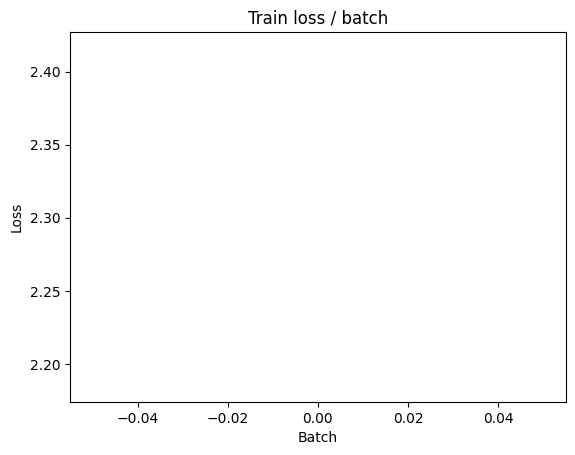

[TRAIN Batch 200/391]	Time 0.014s (0.026s)	Loss 2.0914 (2.2288)	Prec@1  20.3 ( 16.4)	Prec@5  78.1 ( 63.1)


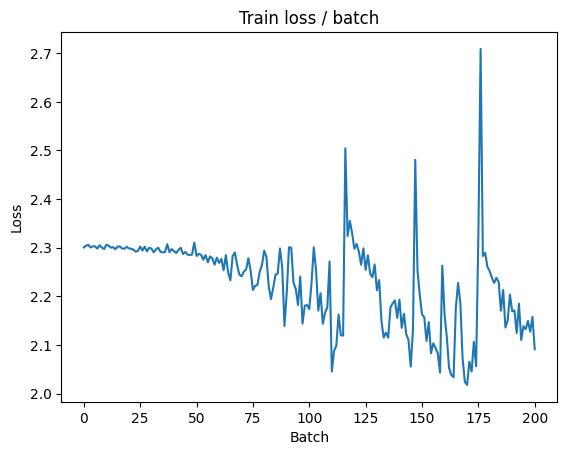


===============> Total time 9s	Avg loss 2.1382	Avg Prec@1 21.31 %	Avg Prec@5 70.03 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.8048 (1.8048)	Prec@1  42.2 ( 42.2)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.8462	Avg Prec@1 34.59 %	Avg Prec@5 83.69 %



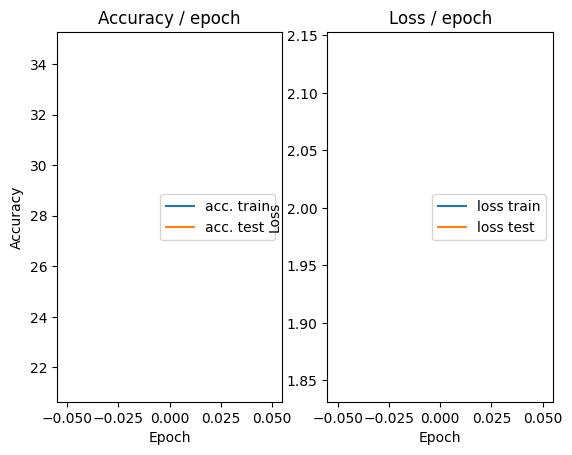

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 1.8219 (1.8219)	Prec@1  28.9 ( 28.9)	Prec@5  85.2 ( 85.2)


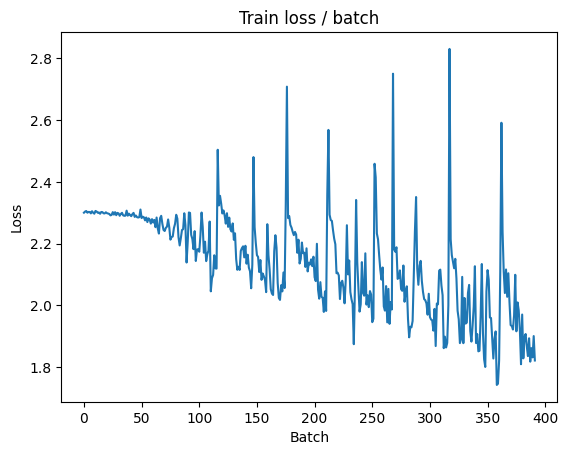

[TRAIN Batch 200/391]	Time 0.074s (0.027s)	Loss 1.6696 (1.7785)	Prec@1  38.3 ( 35.4)	Prec@5  92.2 ( 86.2)


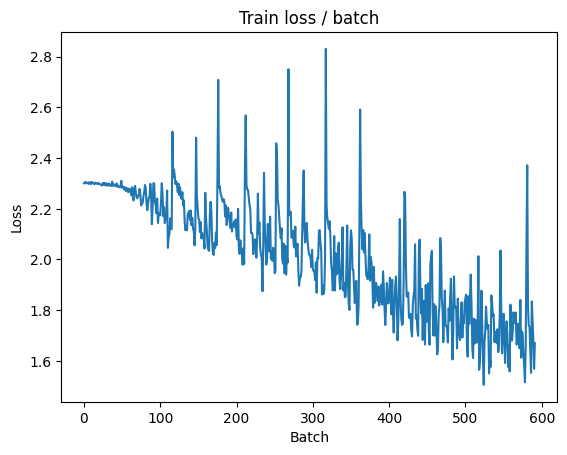


===============> Total time 10s	Avg loss 1.7040	Avg Prec@1 38.28 %	Avg Prec@5 87.75 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 1.5260 (1.5260)	Prec@1  46.9 ( 46.9)	Prec@5  90.6 ( 90.6)

===============> Total time 2s	Avg loss 1.5592	Avg Prec@1 43.04 %	Avg Prec@5 90.58 %



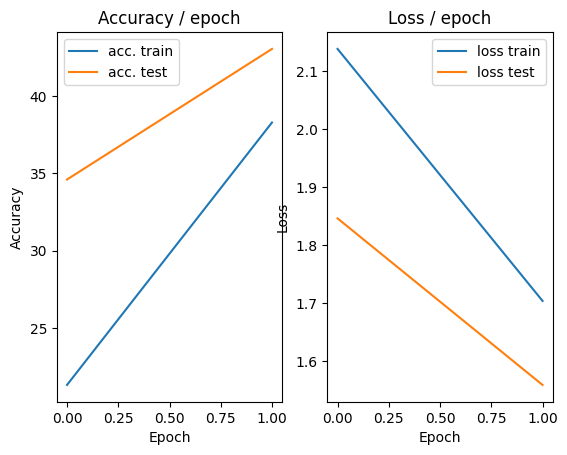

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 1.7281 (1.7281)	Prec@1  32.8 ( 32.8)	Prec@5  92.2 ( 92.2)


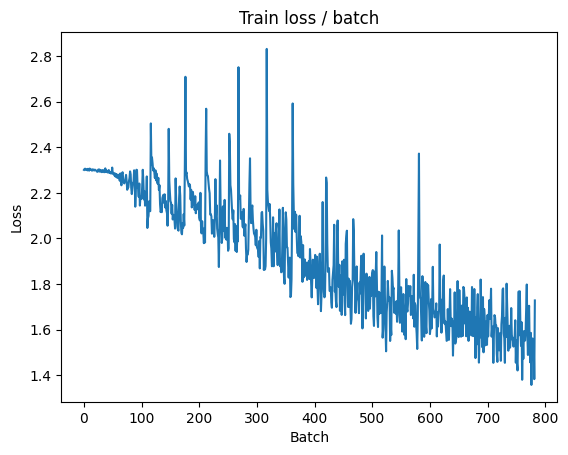

[TRAIN Batch 200/391]	Time 0.014s (0.025s)	Loss 1.4330 (1.4972)	Prec@1  49.2 ( 46.1)	Prec@5  93.8 ( 91.6)


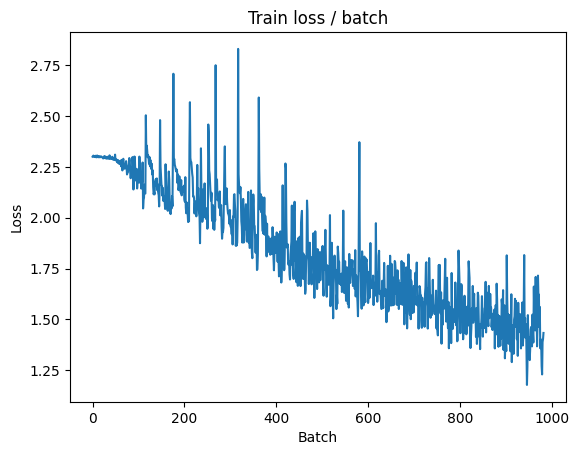


===============> Total time 9s	Avg loss 1.4630	Avg Prec@1 47.46 %	Avg Prec@5 91.99 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 1.2477 (1.2477)	Prec@1  63.3 ( 63.3)	Prec@5  95.3 ( 95.3)

===============> Total time 2s	Avg loss 1.3115	Avg Prec@1 52.69 %	Avg Prec@5 94.35 %



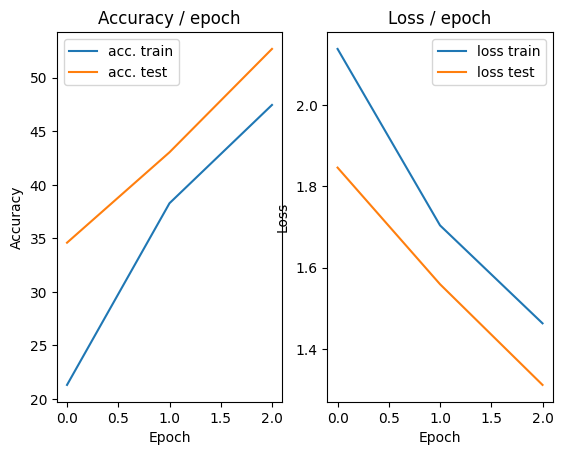

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.268s (0.268s)	Loss 1.3776 (1.3776)	Prec@1  54.7 ( 54.7)	Prec@5  91.4 ( 91.4)


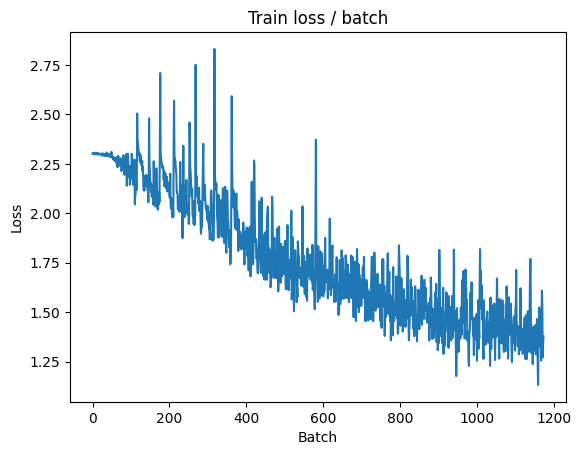

[TRAIN Batch 200/391]	Time 0.020s (0.031s)	Loss 1.3205 (1.3437)	Prec@1  53.1 ( 51.9)	Prec@5  93.0 ( 93.6)


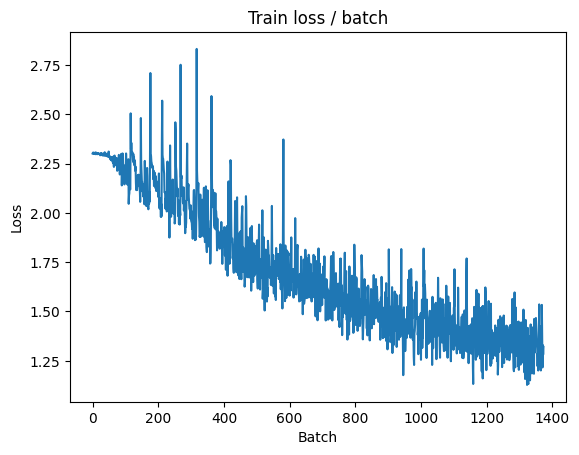


===============> Total time 11s	Avg loss 1.3083	Avg Prec@1 53.17 %	Avg Prec@5 94.04 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.1548 (1.1548)	Prec@1  62.5 ( 62.5)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2129	Avg Prec@1 56.62 %	Avg Prec@5 95.09 %



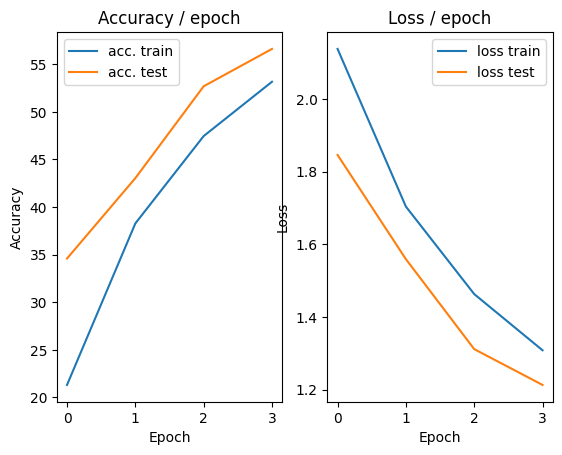

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.232s (0.232s)	Loss 1.3639 (1.3639)	Prec@1  50.8 ( 50.8)	Prec@5  93.8 ( 93.8)


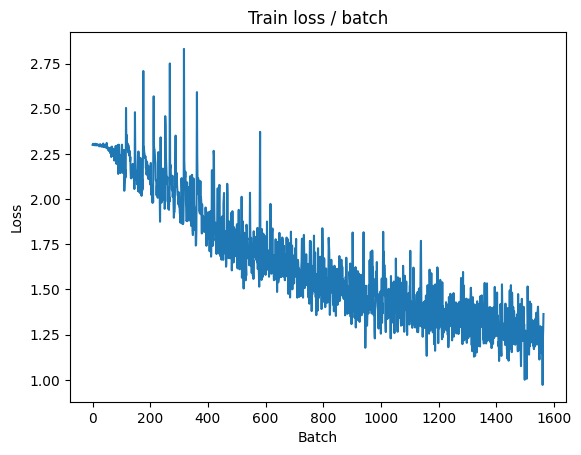

[TRAIN Batch 200/391]	Time 0.024s (0.028s)	Loss 1.0027 (1.1986)	Prec@1  66.4 ( 57.0)	Prec@5  97.7 ( 95.1)


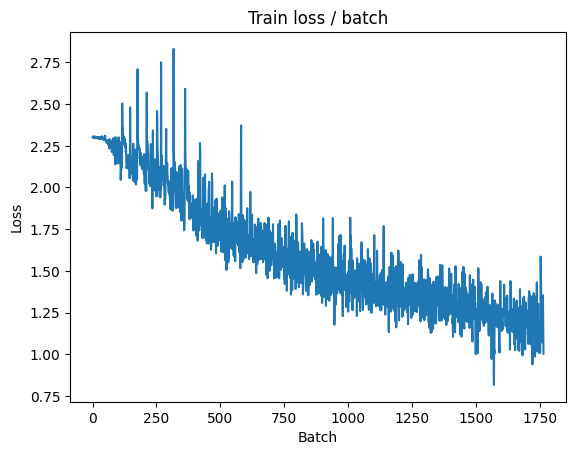


===============> Total time 10s	Avg loss 1.1765	Avg Prec@1 57.89 %	Avg Prec@5 95.36 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.0950 (1.0950)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2019	Avg Prec@1 56.33 %	Avg Prec@5 95.66 %



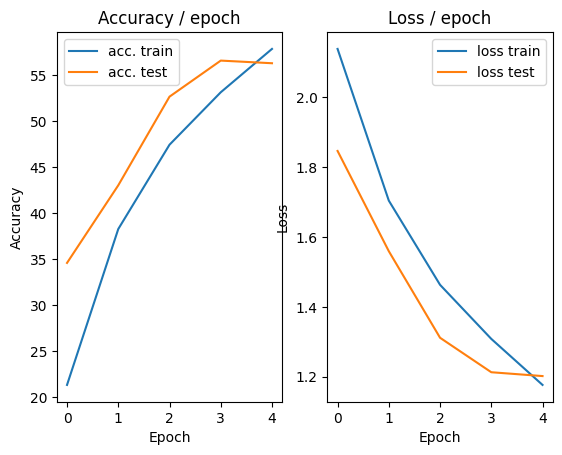

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.242s (0.242s)	Loss 1.0642 (1.0642)	Prec@1  60.9 ( 60.9)	Prec@5  98.4 ( 98.4)


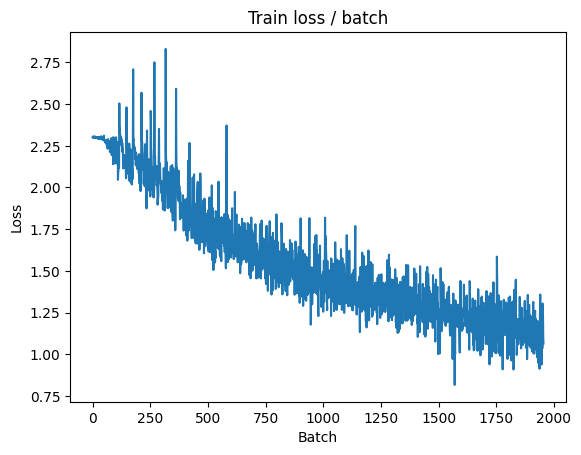

[TRAIN Batch 200/391]	Time 0.016s (0.027s)	Loss 1.0446 (1.0804)	Prec@1  64.8 ( 61.8)	Prec@5  96.1 ( 96.1)


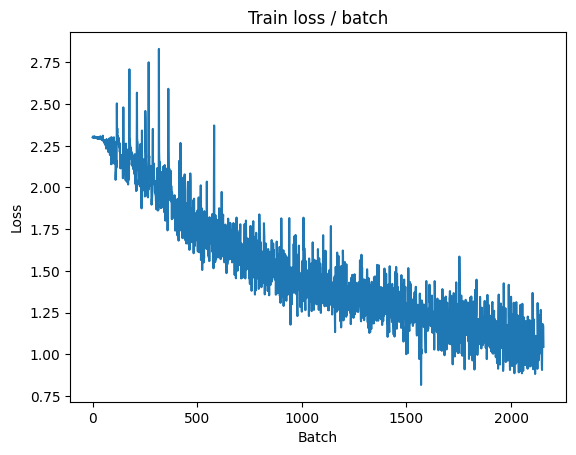


===============> Total time 9s	Avg loss 1.0595	Avg Prec@1 62.40 %	Avg Prec@5 96.38 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.9076 (0.9076)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9977	Avg Prec@1 65.44 %	Avg Prec@5 96.48 %



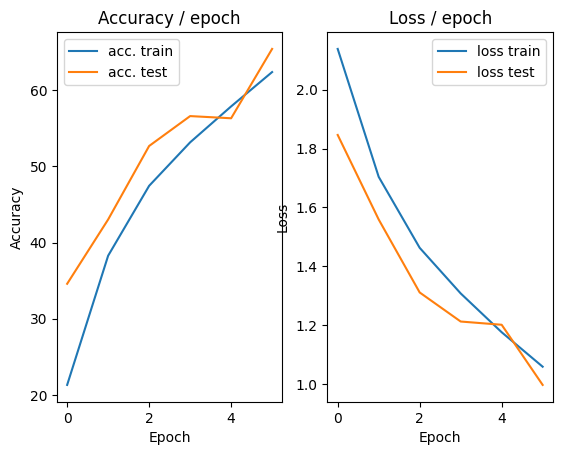

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.9908 (0.9908)	Prec@1  65.6 ( 65.6)	Prec@5  99.2 ( 99.2)


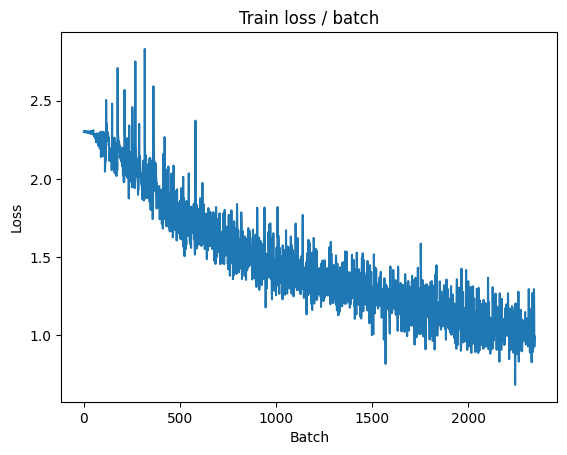

[TRAIN Batch 200/391]	Time 0.015s (0.029s)	Loss 0.9787 (0.9804)	Prec@1  59.4 ( 65.3)	Prec@5  99.2 ( 96.9)


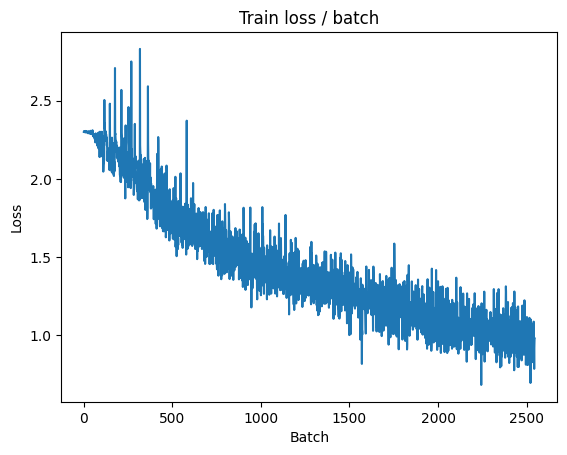


===============> Total time 10s	Avg loss 0.9674	Avg Prec@1 65.81 %	Avg Prec@5 96.98 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.8733 (0.8733)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9868	Avg Prec@1 65.03 %	Avg Prec@5 96.95 %



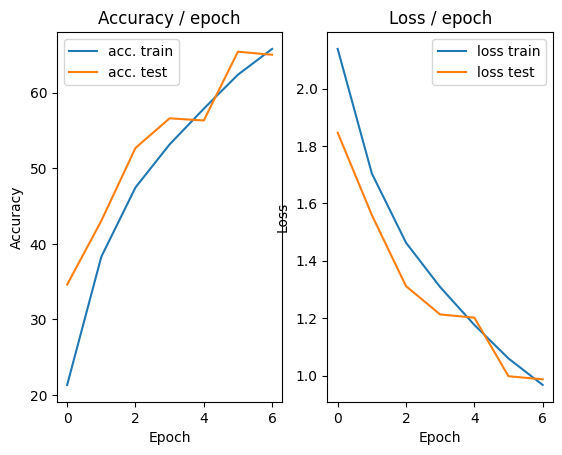

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.9304 (0.9304)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)


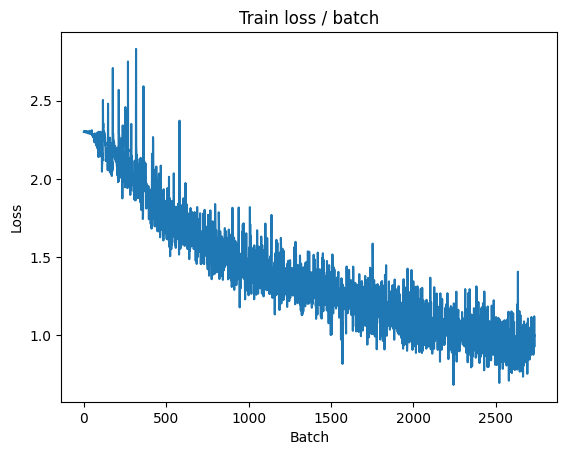

[TRAIN Batch 200/391]	Time 0.029s (0.029s)	Loss 0.9593 (0.8819)	Prec@1  66.4 ( 69.0)	Prec@5  98.4 ( 97.5)


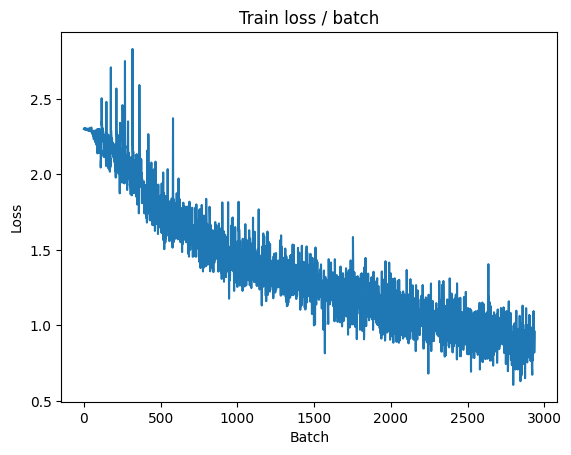


===============> Total time 10s	Avg loss 0.8744	Avg Prec@1 69.28 %	Avg Prec@5 97.61 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.8349 (0.8349)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8952	Avg Prec@1 68.96 %	Avg Prec@5 97.10 %



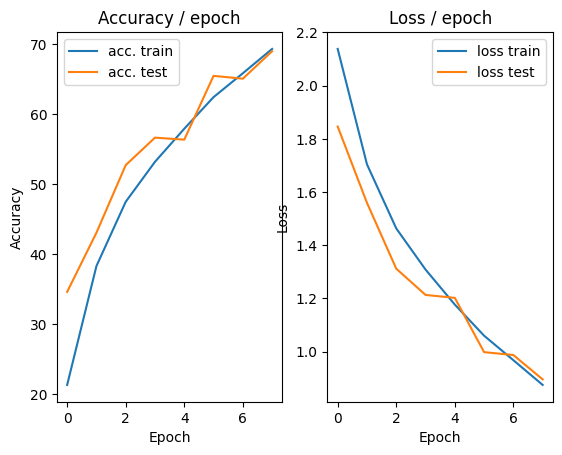

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.155s (0.155s)	Loss 0.8898 (0.8898)	Prec@1  71.9 ( 71.9)	Prec@5  96.1 ( 96.1)


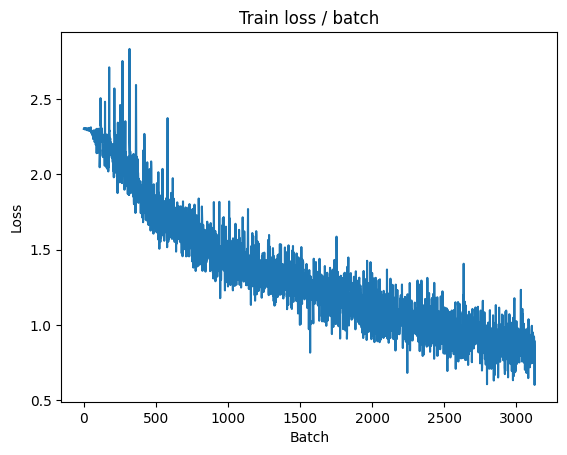

[TRAIN Batch 200/391]	Time 0.041s (0.035s)	Loss 0.7660 (0.8197)	Prec@1  74.2 ( 71.0)	Prec@5  97.7 ( 98.0)


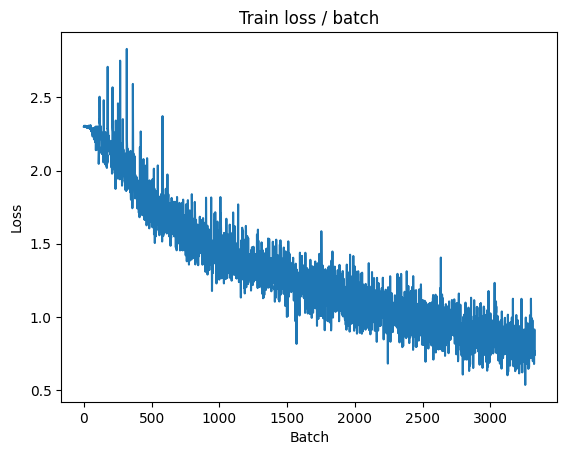


===============> Total time 11s	Avg loss 0.8093	Avg Prec@1 71.62 %	Avg Prec@5 98.05 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 0.8495 (0.8495)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8713	Avg Prec@1 69.65 %	Avg Prec@5 97.42 %



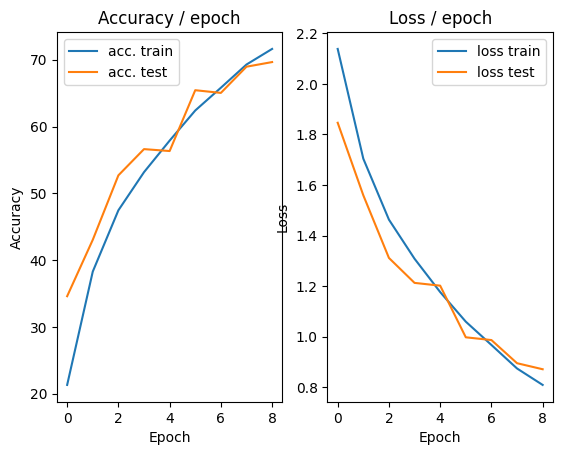

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.8209 (0.8209)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)


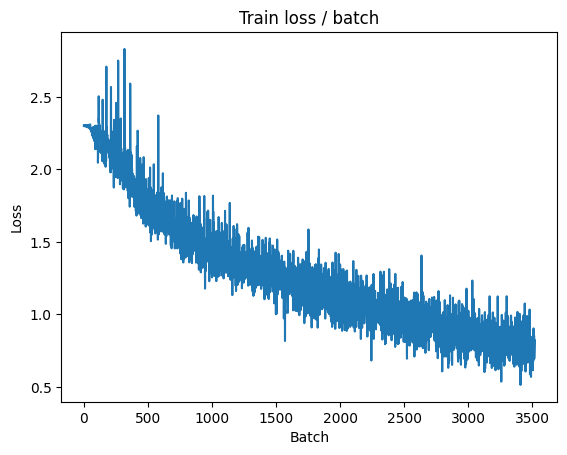

[TRAIN Batch 200/391]	Time 0.029s (0.034s)	Loss 0.7034 (0.7325)	Prec@1  75.8 ( 74.2)	Prec@5 100.0 ( 98.4)


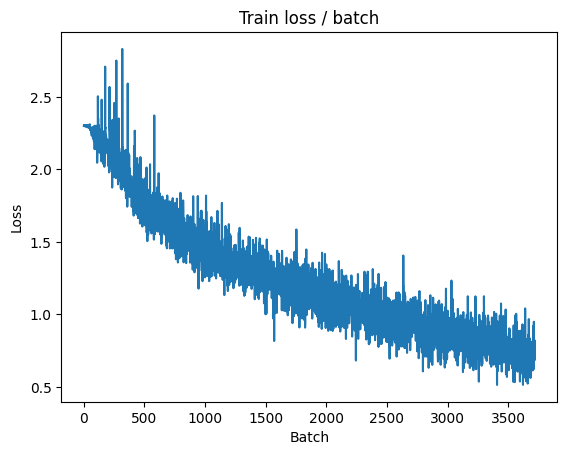


===============> Total time 11s	Avg loss 0.7399	Avg Prec@1 73.84 %	Avg Prec@5 98.40 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 0.8193 (0.8193)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9039	Avg Prec@1 68.34 %	Avg Prec@5 97.29 %



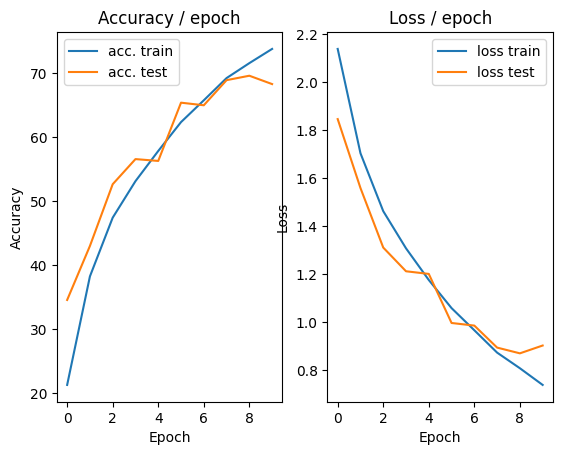

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.8412 (0.8412)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)


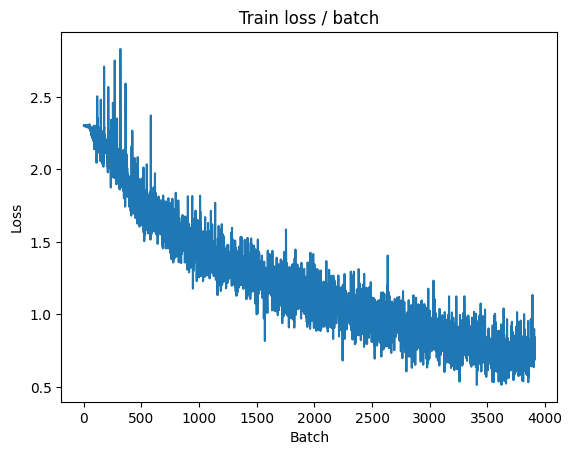

[TRAIN Batch 200/391]	Time 0.020s (0.030s)	Loss 0.5743 (0.6626)	Prec@1  81.2 ( 76.6)	Prec@5  97.7 ( 98.8)


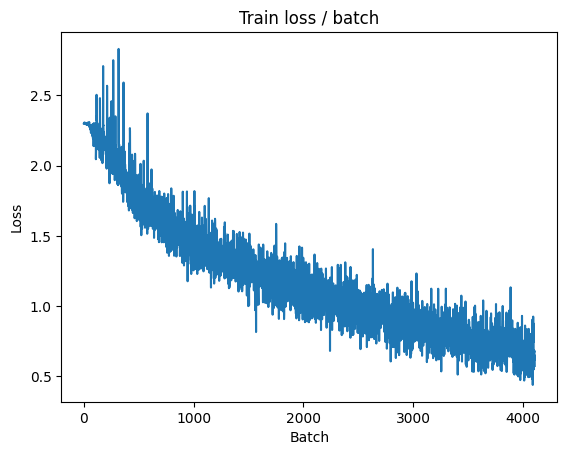


===============> Total time 10s	Avg loss 0.6708	Avg Prec@1 76.47 %	Avg Prec@5 98.73 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.8301 (0.8301)	Prec@1  65.6 ( 65.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8972	Avg Prec@1 69.39 %	Avg Prec@5 97.27 %



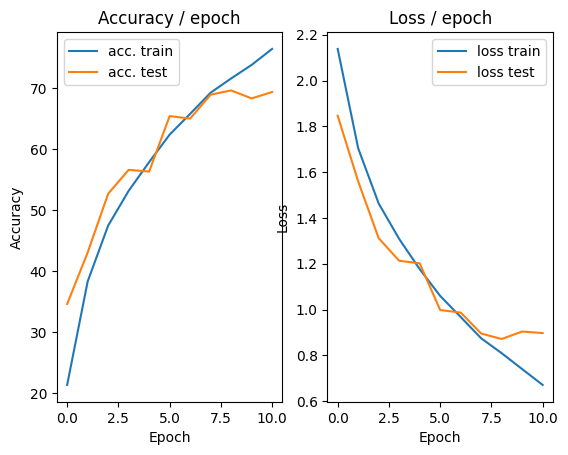

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.6960 (0.6960)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


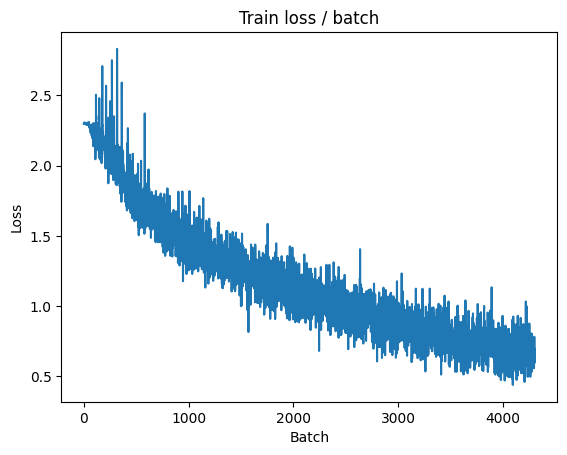

[TRAIN Batch 200/391]	Time 0.041s (0.029s)	Loss 0.5723 (0.6093)	Prec@1  78.9 ( 78.8)	Prec@5  99.2 ( 99.0)


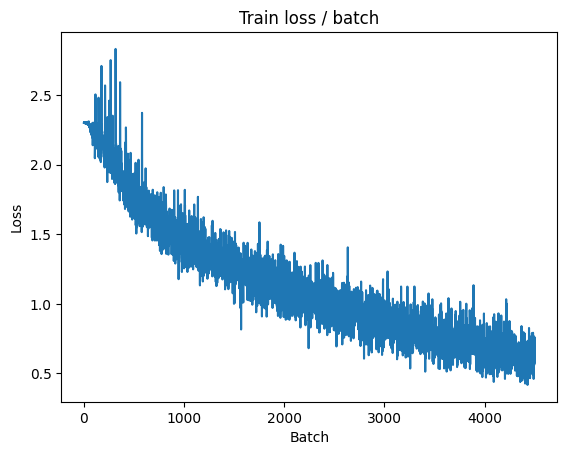


===============> Total time 10s	Avg loss 0.6167	Avg Prec@1 78.47 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.9038 (0.9038)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8688	Avg Prec@1 70.84 %	Avg Prec@5 97.47 %



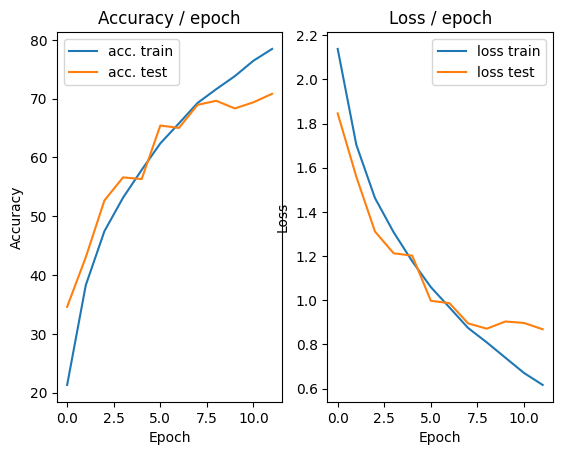

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.4746 (0.4746)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


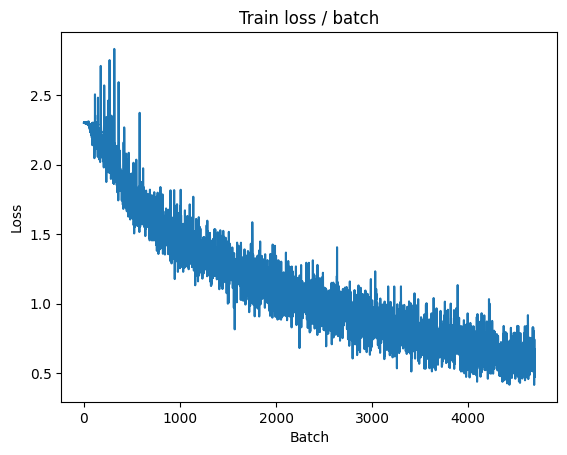

[TRAIN Batch 200/391]	Time 0.037s (0.030s)	Loss 0.5855 (0.5432)	Prec@1  78.9 ( 81.2)	Prec@5  98.4 ( 99.2)


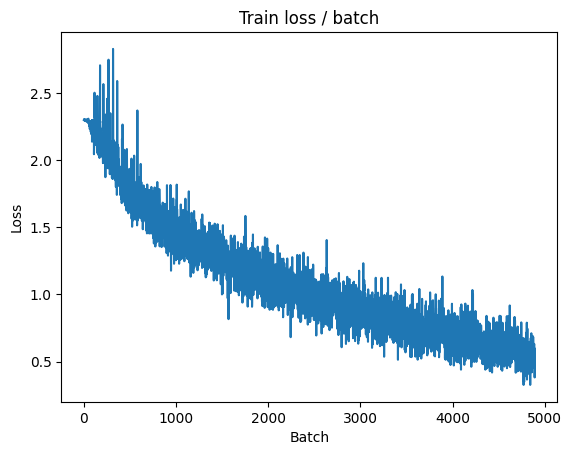


===============> Total time 10s	Avg loss 0.5547	Avg Prec@1 80.62 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 0.7969 (0.7969)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8288	Avg Prec@1 72.45 %	Avg Prec@5 97.77 %



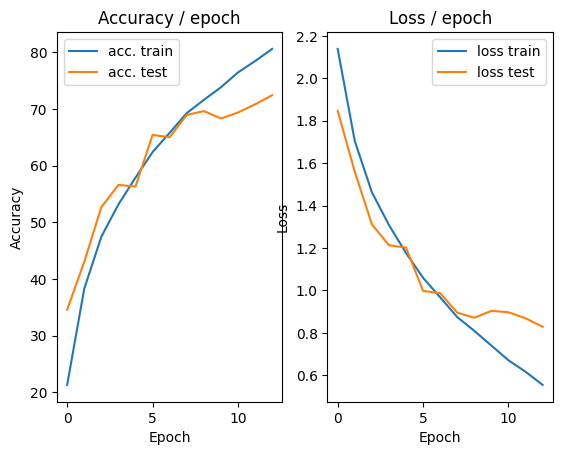

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.5125 (0.5125)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


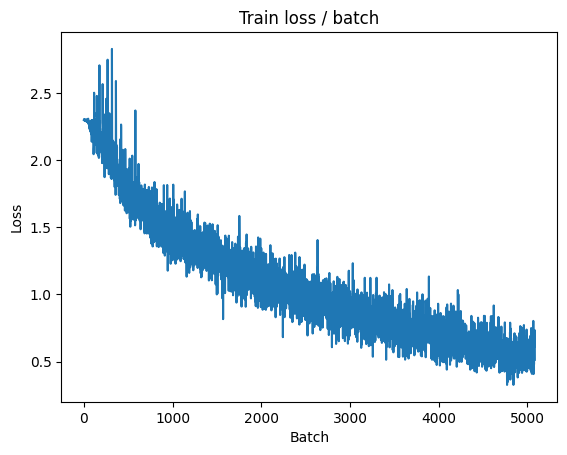

[TRAIN Batch 200/391]	Time 0.025s (0.036s)	Loss 0.5832 (0.4941)	Prec@1  82.8 ( 82.6)	Prec@5  99.2 ( 99.4)


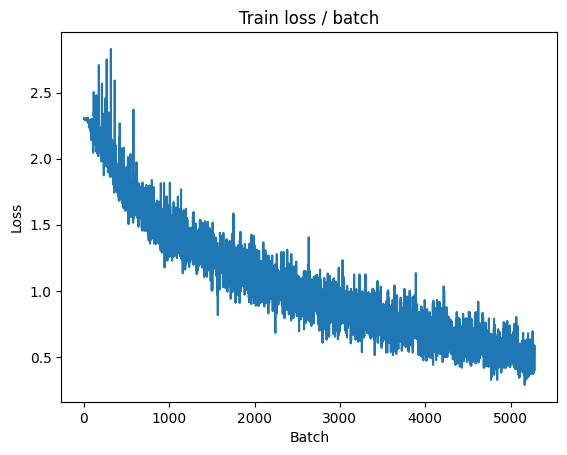


===============> Total time 11s	Avg loss 0.5135	Avg Prec@1 81.87 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.9305 (0.9305)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9106	Avg Prec@1 69.82 %	Avg Prec@5 97.05 %



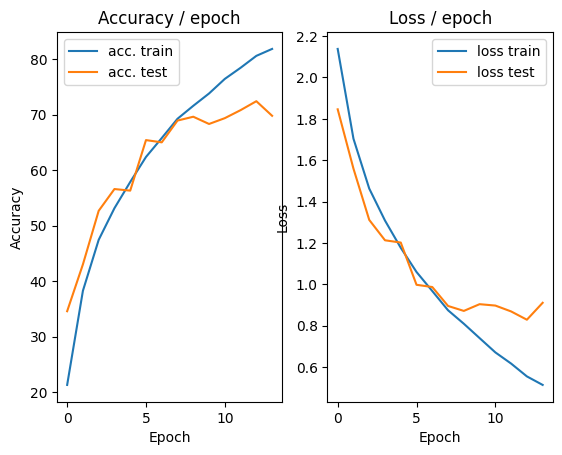

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.5986 (0.5986)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


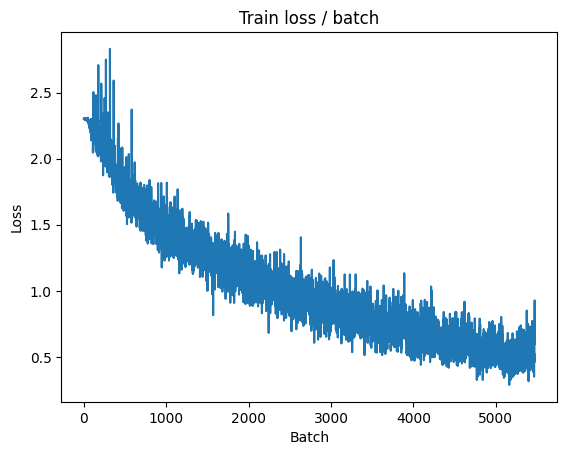

[TRAIN Batch 200/391]	Time 0.037s (0.030s)	Loss 0.4862 (0.4441)	Prec@1  82.8 ( 84.5)	Prec@5  99.2 ( 99.6)


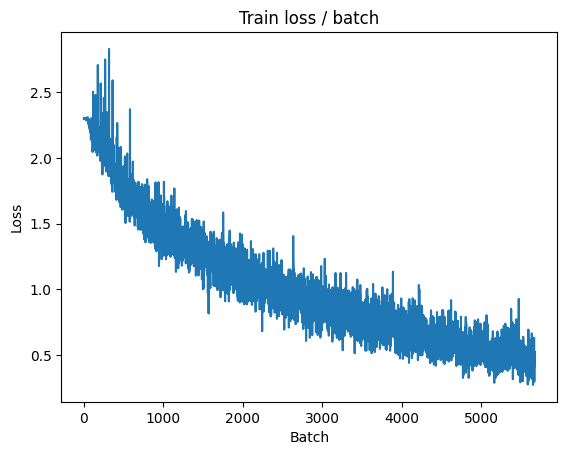


===============> Total time 10s	Avg loss 0.4593	Avg Prec@1 83.70 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 0.8544 (0.8544)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8266	Avg Prec@1 73.11 %	Avg Prec@5 97.86 %



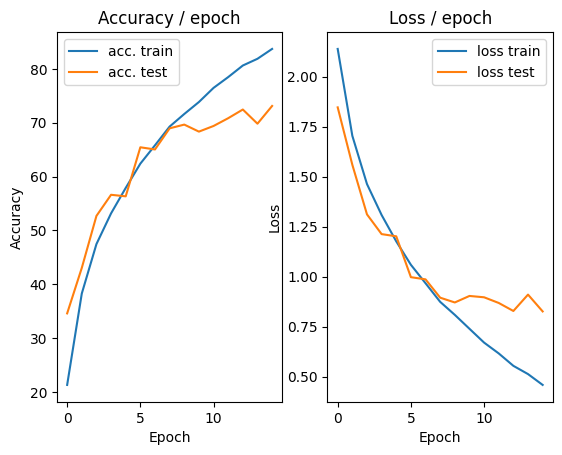

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.3463 (0.3463)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


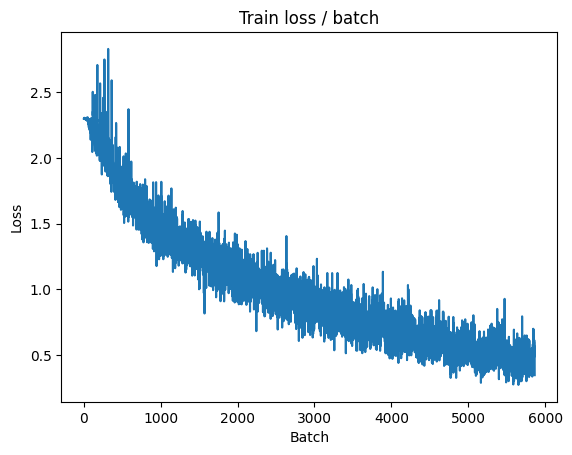

[TRAIN Batch 200/391]	Time 0.025s (0.030s)	Loss 0.3781 (0.4017)	Prec@1  89.8 ( 85.8)	Prec@5  99.2 ( 99.7)


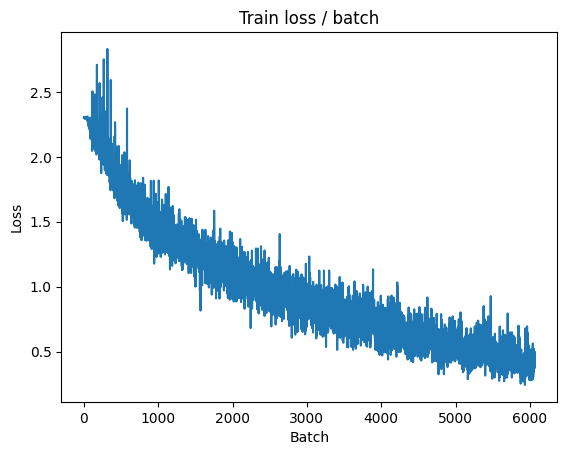


===============> Total time 10s	Avg loss 0.4177	Avg Prec@1 85.13 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.8247 (0.8247)	Prec@1  78.9 ( 78.9)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8245	Avg Prec@1 73.56 %	Avg Prec@5 97.94 %



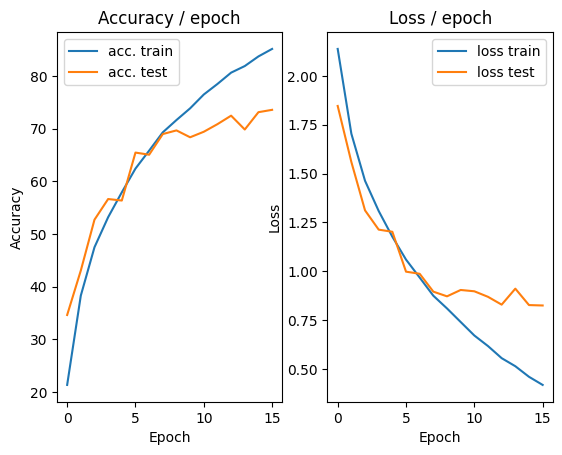

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.3168 (0.3168)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


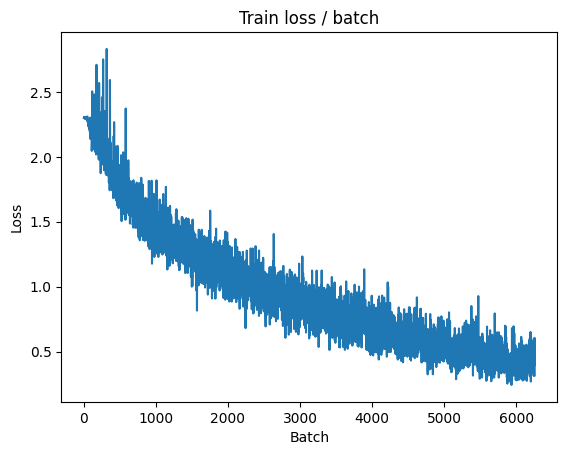

[TRAIN Batch 200/391]	Time 0.059s (0.028s)	Loss 0.4011 (0.3503)	Prec@1  83.6 ( 87.5)	Prec@5 100.0 ( 99.8)


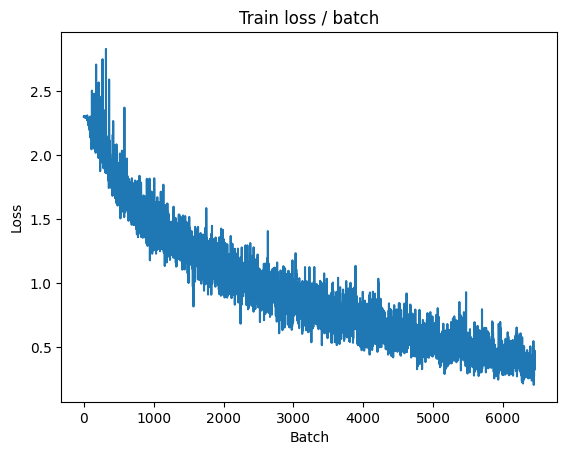


===============> Total time 10s	Avg loss 0.3655	Avg Prec@1 86.98 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.7920 (0.7920)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8448	Avg Prec@1 73.40 %	Avg Prec@5 97.98 %



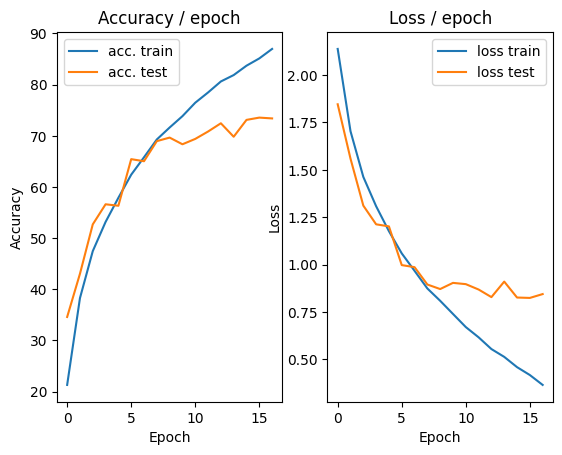

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.2891 (0.2891)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


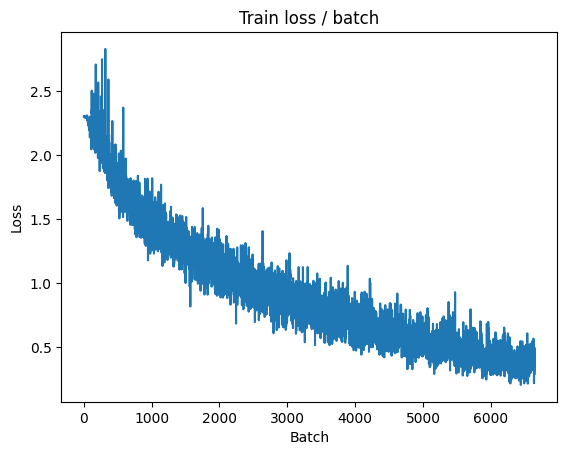

[TRAIN Batch 200/391]	Time 0.052s (0.029s)	Loss 0.3302 (0.3077)	Prec@1  85.9 ( 89.2)	Prec@5 100.0 ( 99.9)


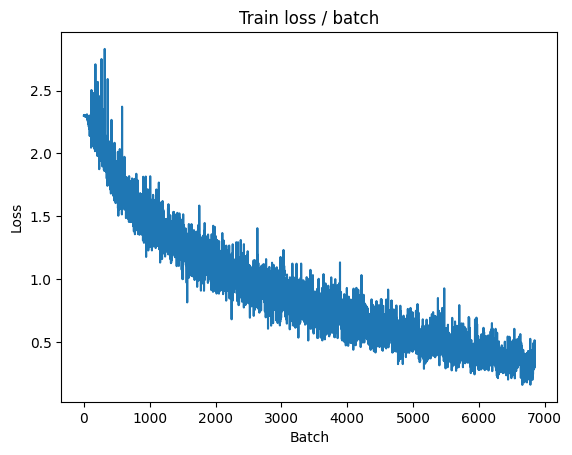


===============> Total time 10s	Avg loss 0.3268	Avg Prec@1 88.47 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.8572 (0.8572)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8746	Avg Prec@1 73.70 %	Avg Prec@5 97.90 %



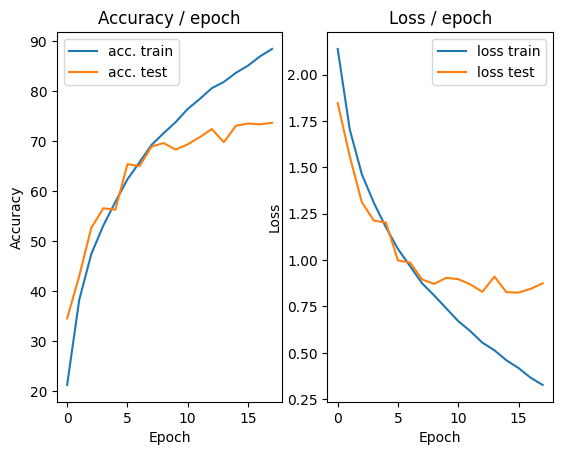

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.2716 (0.2716)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


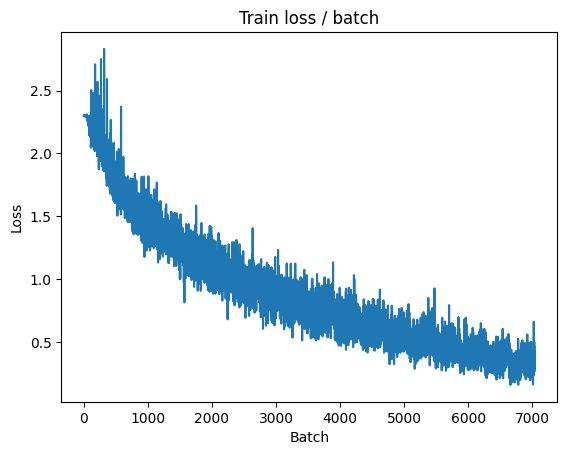

[TRAIN Batch 200/391]	Time 0.064s (0.028s)	Loss 0.3520 (0.2746)	Prec@1  88.3 ( 90.1)	Prec@5 100.0 ( 99.9)


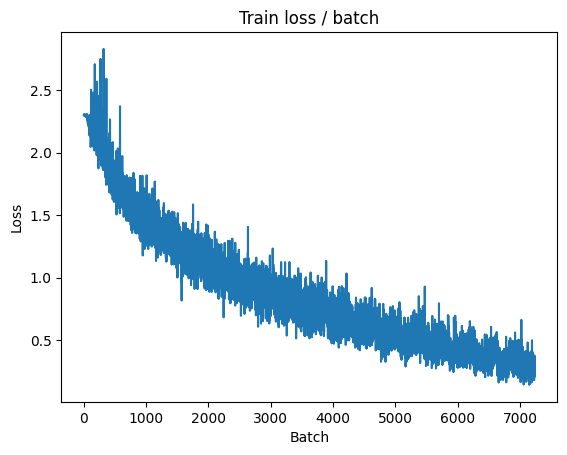


===============> Total time 11s	Avg loss 0.2922	Avg Prec@1 89.51 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.9213 (0.9213)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9452	Avg Prec@1 72.72 %	Avg Prec@5 97.91 %



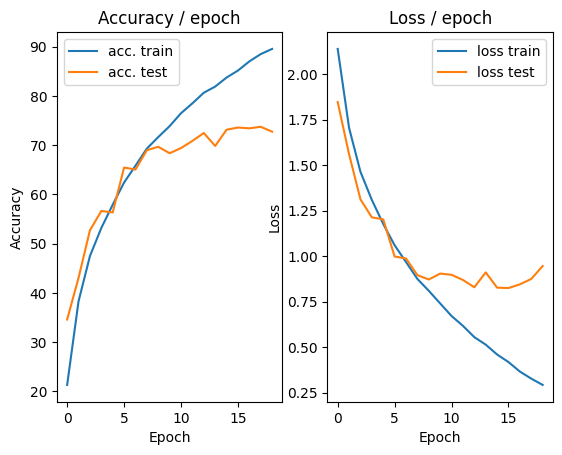

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.2081 (0.2081)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


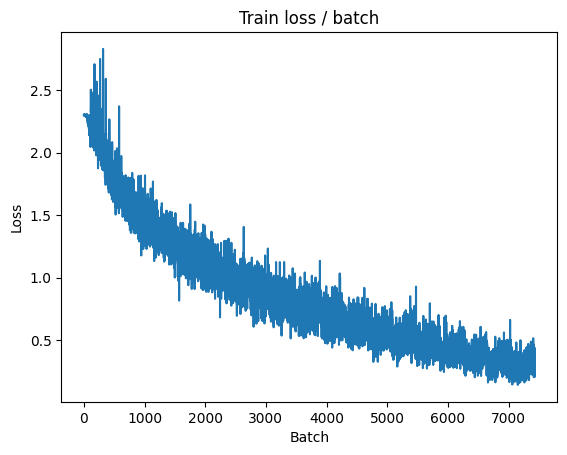

[TRAIN Batch 200/391]	Time 0.021s (0.030s)	Loss 0.2158 (0.2449)	Prec@1  93.0 ( 91.3)	Prec@5 100.0 ( 99.9)


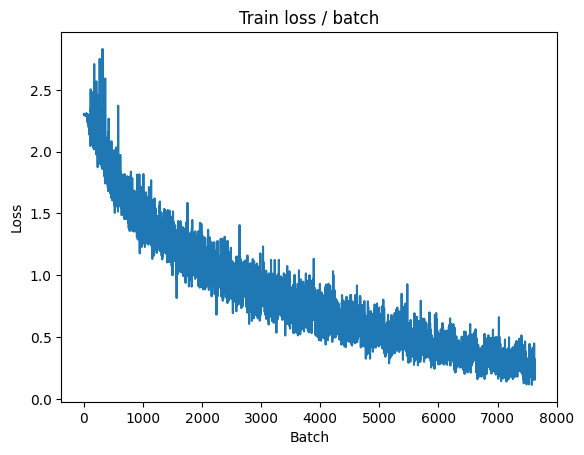


===============> Total time 10s	Avg loss 0.2631	Avg Prec@1 90.72 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 0.9568 (0.9568)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9744	Avg Prec@1 73.13 %	Avg Prec@5 97.77 %



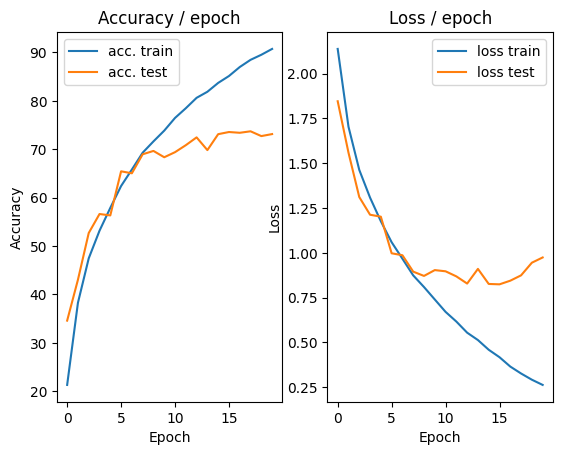

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.2843 (0.2843)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


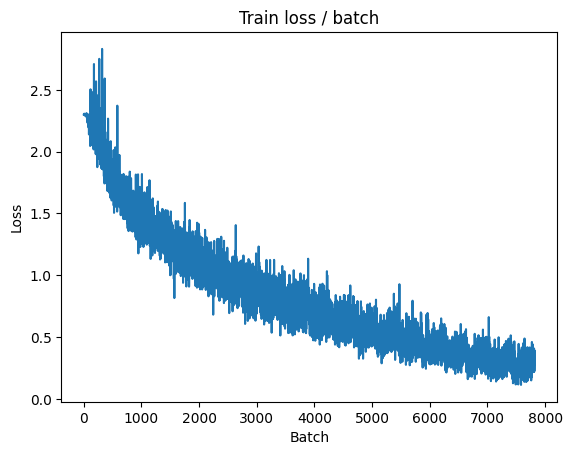

[TRAIN Batch 200/391]	Time 0.064s (0.030s)	Loss 0.1889 (0.2226)	Prec@1  94.5 ( 92.2)	Prec@5 100.0 (100.0)


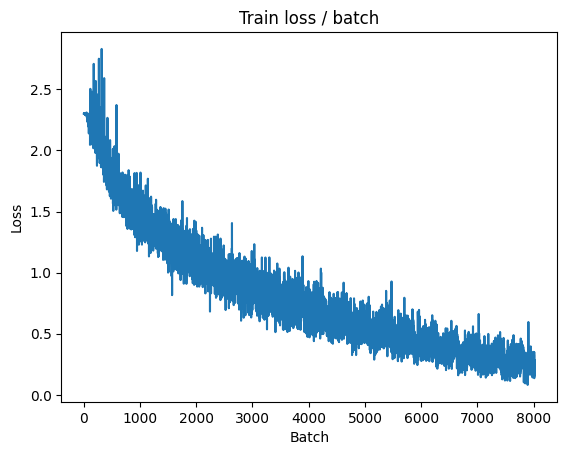


===============> Total time 10s	Avg loss 0.2382	Avg Prec@1 91.64 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 1.0468 (1.0468)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0335	Avg Prec@1 72.71 %	Avg Prec@5 97.33 %



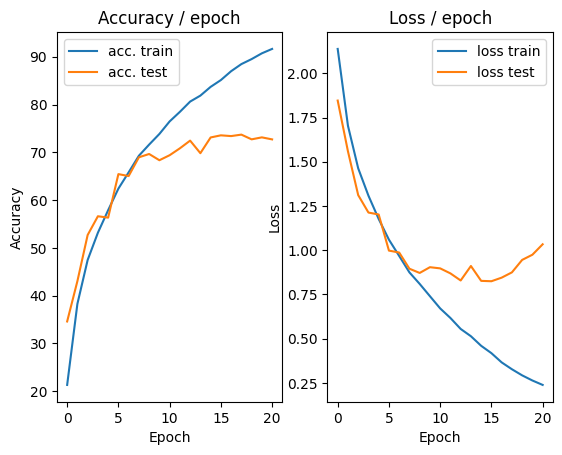

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.3254 (0.3254)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


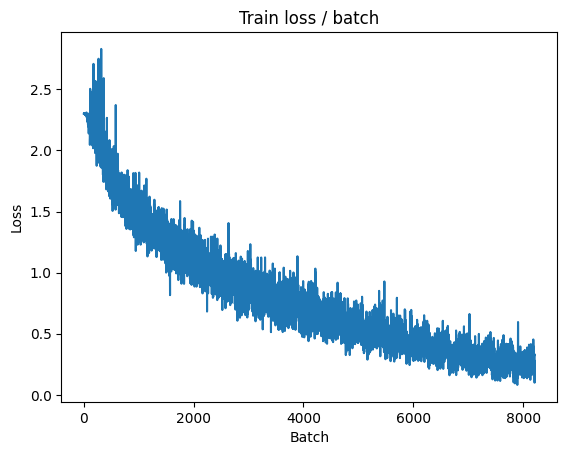

[TRAIN Batch 200/391]	Time 0.021s (0.028s)	Loss 0.1183 (0.2006)	Prec@1  98.4 ( 92.8)	Prec@5 100.0 (100.0)


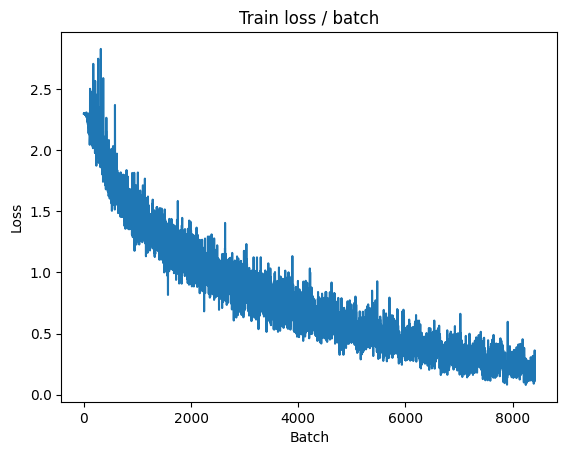


===============> Total time 10s	Avg loss 0.2147	Avg Prec@1 92.33 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.0403 (1.0403)	Prec@1  75.0 ( 75.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0555	Avg Prec@1 73.60 %	Avg Prec@5 97.93 %



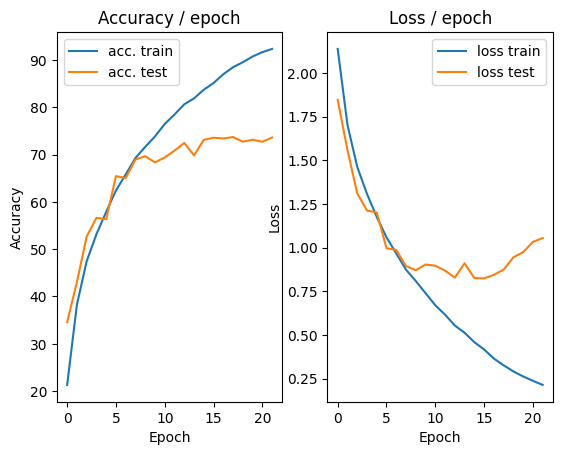

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.1962 (0.1962)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


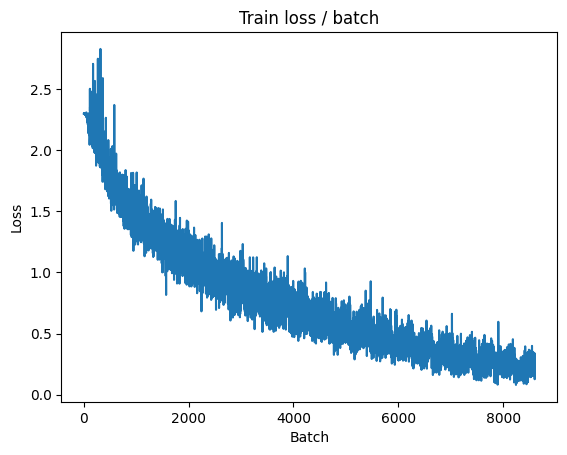

[TRAIN Batch 200/391]	Time 0.021s (0.026s)	Loss 0.2246 (0.1883)	Prec@1  90.6 ( 93.4)	Prec@5 100.0 (100.0)


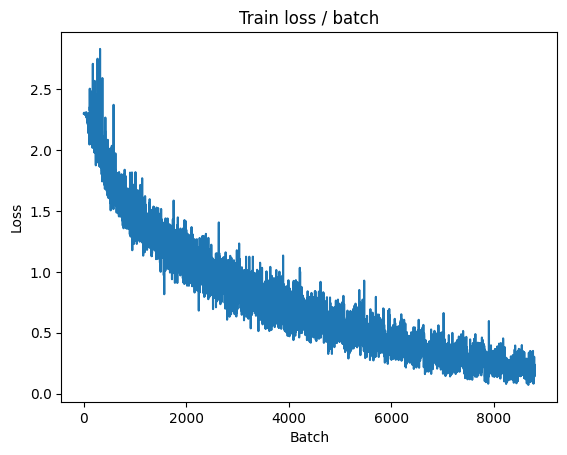


===============> Total time 10s	Avg loss 0.1986	Avg Prec@1 92.90 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.3270 (1.3270)	Prec@1  75.0 ( 75.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1200	Avg Prec@1 72.53 %	Avg Prec@5 97.72 %



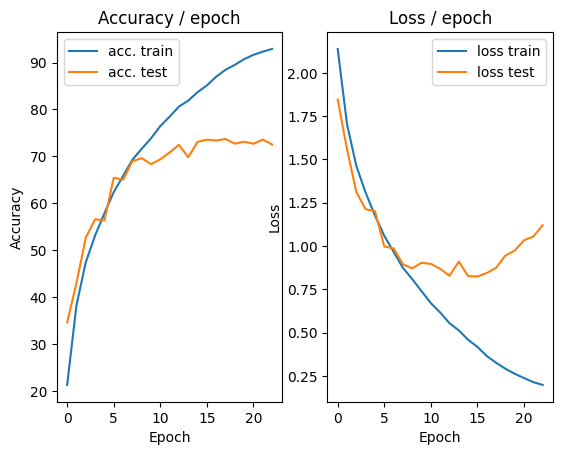

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.2151 (0.2151)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


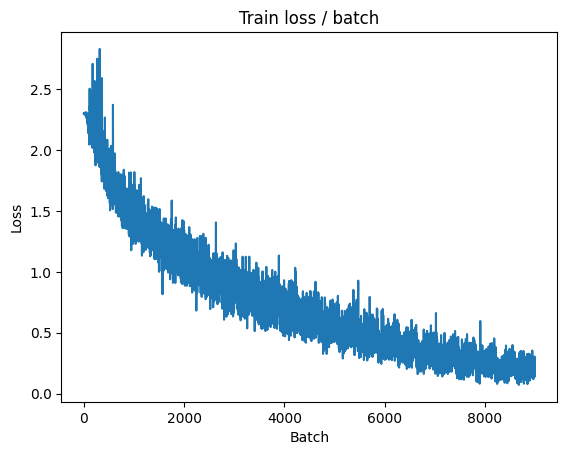

[TRAIN Batch 200/391]	Time 0.053s (0.026s)	Loss 0.1889 (0.1625)	Prec@1  92.2 ( 94.3)	Prec@5 100.0 (100.0)


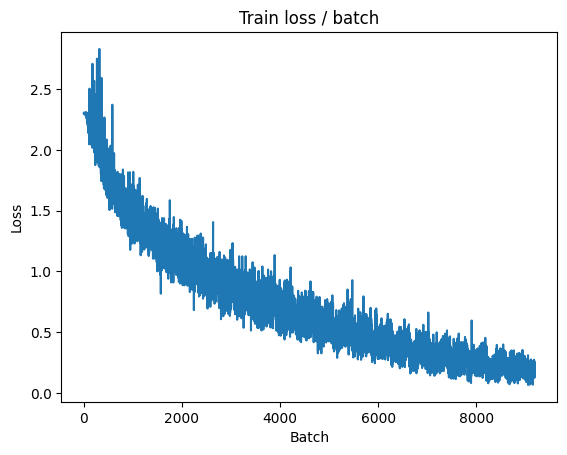


===============> Total time 11s	Avg loss 0.1791	Avg Prec@1 93.60 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 1.2028 (1.2028)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0661	Avg Prec@1 74.18 %	Avg Prec@5 97.88 %



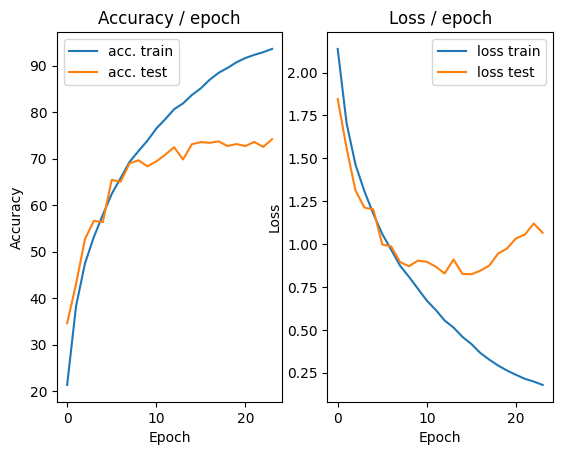

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.1819 (0.1819)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


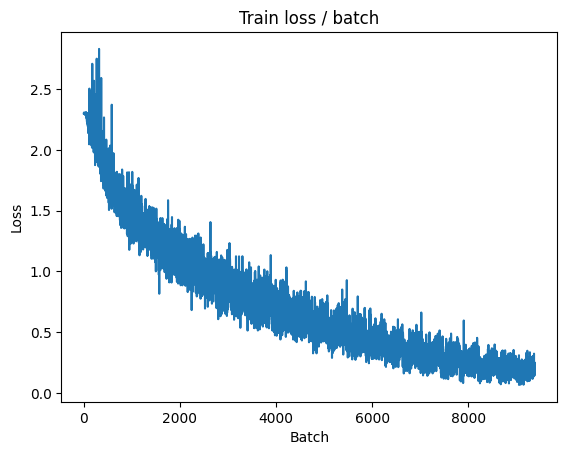

[TRAIN Batch 200/391]	Time 0.046s (0.030s)	Loss 0.2878 (0.1411)	Prec@1  93.0 ( 95.2)	Prec@5 100.0 (100.0)


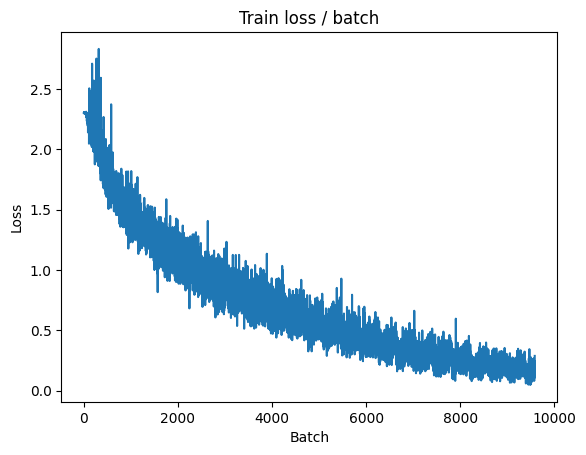


===============> Total time 10s	Avg loss 0.1573	Avg Prec@1 94.46 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.1454 (1.1454)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1301	Avg Prec@1 73.39 %	Avg Prec@5 97.85 %



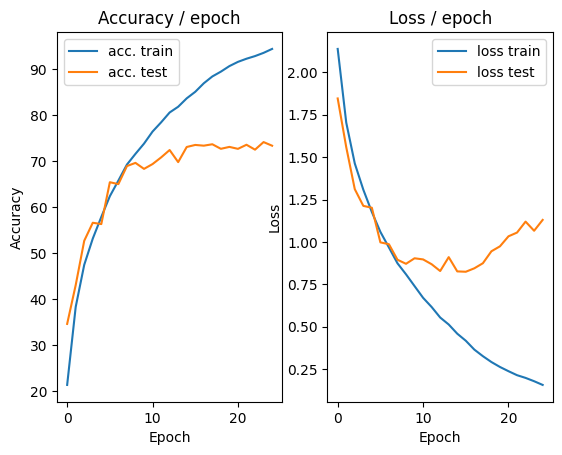

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.1766 (0.1766)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


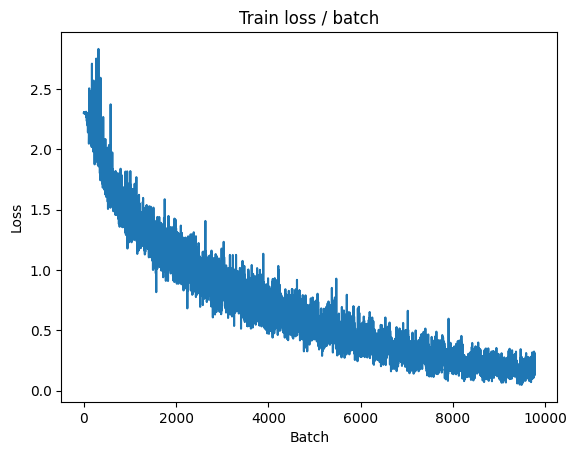

[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 0.1092 (0.1411)	Prec@1  96.9 ( 95.2)	Prec@5 100.0 (100.0)


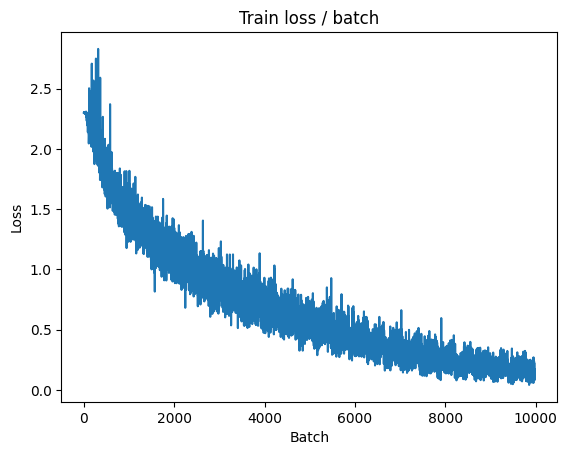


===============> Total time 10s	Avg loss 0.1560	Avg Prec@1 94.58 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.1669 (1.1669)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.1477	Avg Prec@1 73.91 %	Avg Prec@5 97.91 %



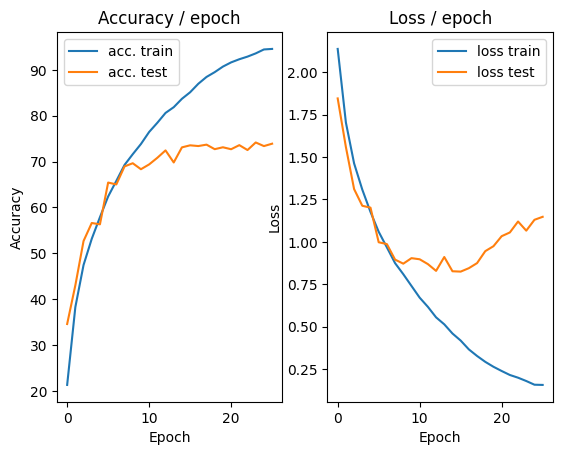

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.1303 (0.1303)	Prec@1  96.1 ( 96.1)	Prec@5  99.2 ( 99.2)


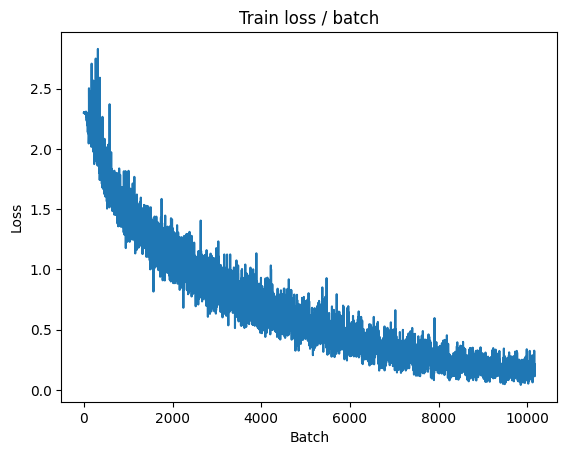

[TRAIN Batch 200/391]	Time 0.013s (0.027s)	Loss 0.1124 (0.1266)	Prec@1  96.1 ( 95.6)	Prec@5 100.0 (100.0)


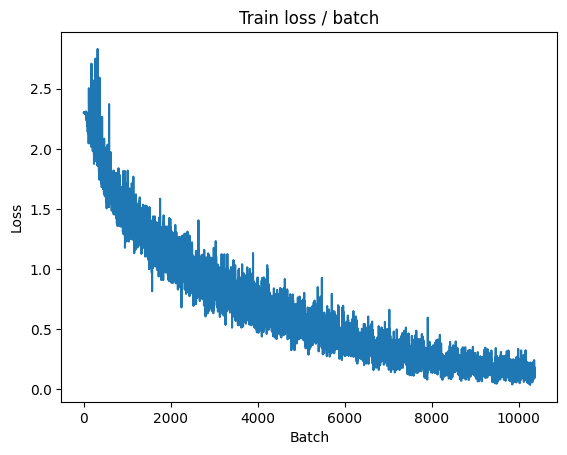


===============> Total time 10s	Avg loss 0.1379	Avg Prec@1 95.20 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.2503 (1.2503)	Prec@1  74.2 ( 74.2)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.2235	Avg Prec@1 72.63 %	Avg Prec@5 97.69 %



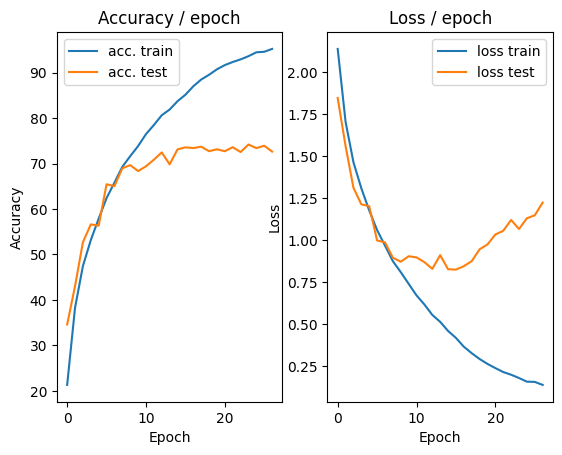

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.1382 (0.1382)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


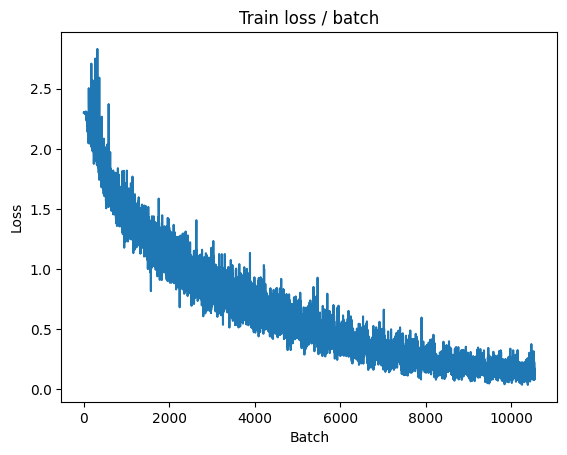

[TRAIN Batch 200/391]	Time 0.023s (0.028s)	Loss 0.0950 (0.1130)	Prec@1  97.7 ( 96.1)	Prec@5 100.0 (100.0)


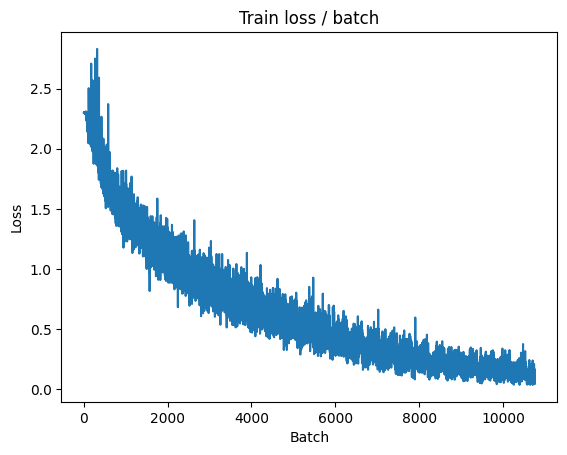


===============> Total time 10s	Avg loss 0.1259	Avg Prec@1 95.61 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.2440 (1.2440)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.3002	Avg Prec@1 72.80 %	Avg Prec@5 97.92 %



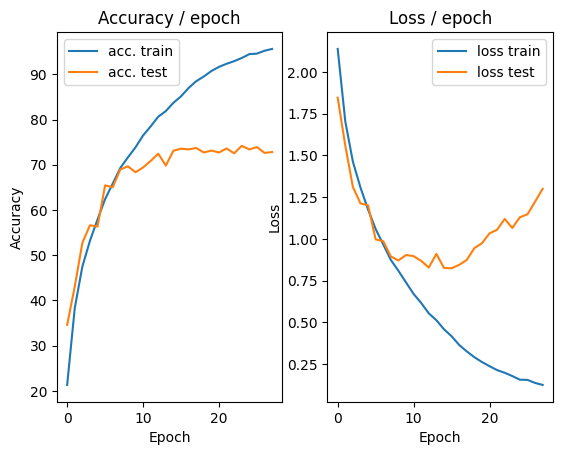

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.1250 (0.1250)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


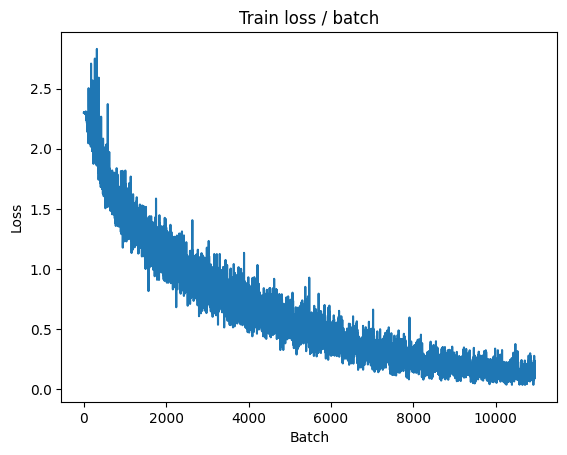

[TRAIN Batch 200/391]	Time 0.061s (0.028s)	Loss 0.0821 (0.1112)	Prec@1  97.7 ( 96.2)	Prec@5 100.0 (100.0)


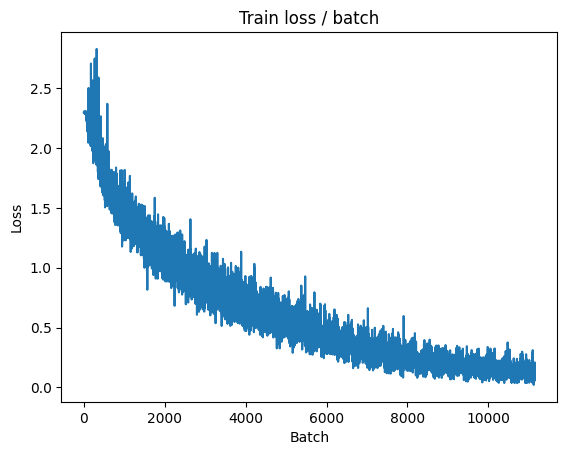


===============> Total time 10s	Avg loss 0.1173	Avg Prec@1 95.92 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 1.2606 (1.2606)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2052	Avg Prec@1 74.33 %	Avg Prec@5 98.02 %



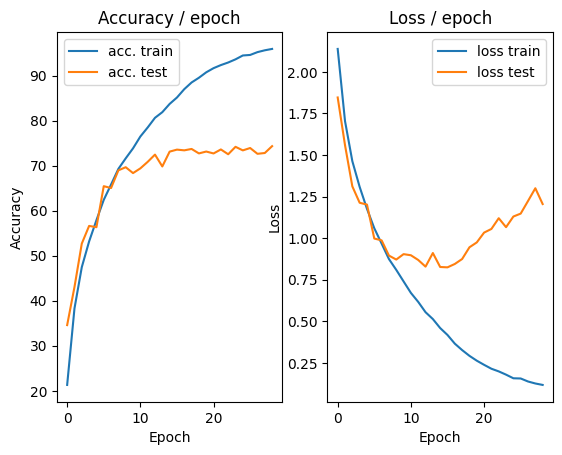

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 0.0927 (0.0927)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


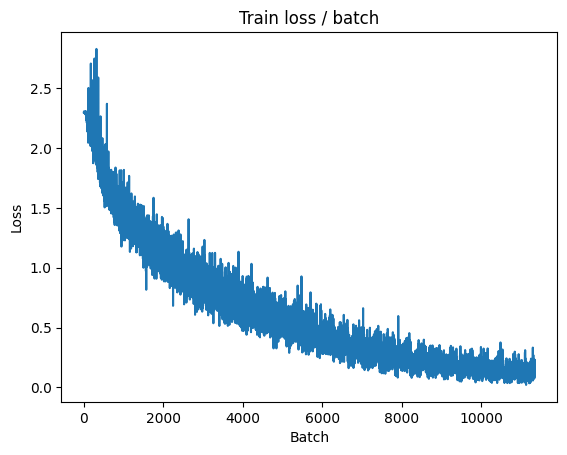

[TRAIN Batch 200/391]	Time 0.027s (0.030s)	Loss 0.1827 (0.1001)	Prec@1  93.0 ( 96.6)	Prec@5 100.0 (100.0)


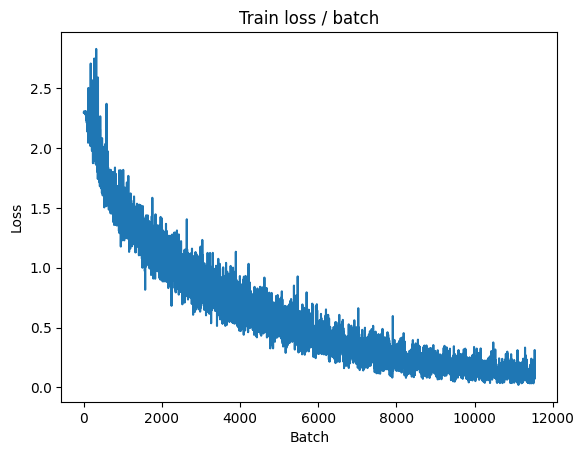


===============> Total time 10s	Avg loss 0.1055	Avg Prec@1 96.41 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.3691 (1.3691)	Prec@1  76.6 ( 76.6)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.3475	Avg Prec@1 74.36 %	Avg Prec@5 98.13 %



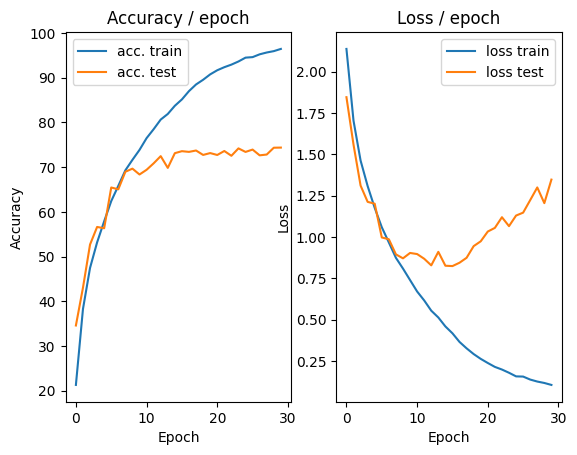

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.198s (0.198s)	Loss 0.1033 (0.1033)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


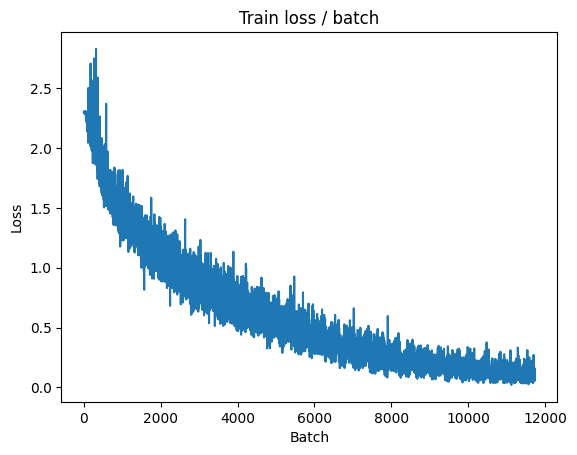

[TRAIN Batch 200/391]	Time 0.063s (0.035s)	Loss 0.0987 (0.1027)	Prec@1  96.9 ( 96.4)	Prec@5 100.0 (100.0)


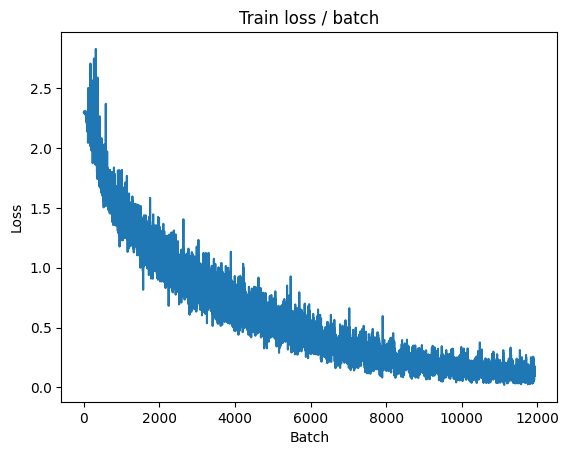


===============> Total time 11s	Avg loss 0.1103	Avg Prec@1 96.12 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.0767 (1.0767)	Prec@1  83.6 ( 83.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2654	Avg Prec@1 74.43 %	Avg Prec@5 98.00 %



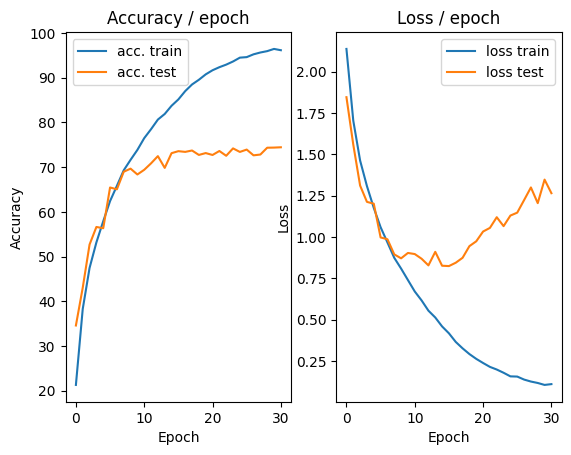

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0769 (0.0769)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


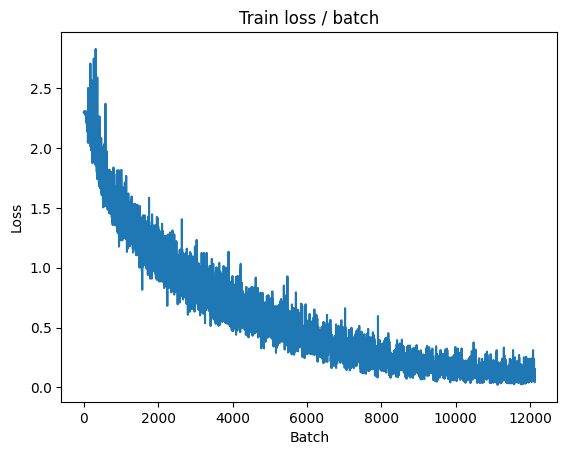

[TRAIN Batch 200/391]	Time 0.016s (0.029s)	Loss 0.0630 (0.1001)	Prec@1  99.2 ( 96.5)	Prec@5 100.0 (100.0)


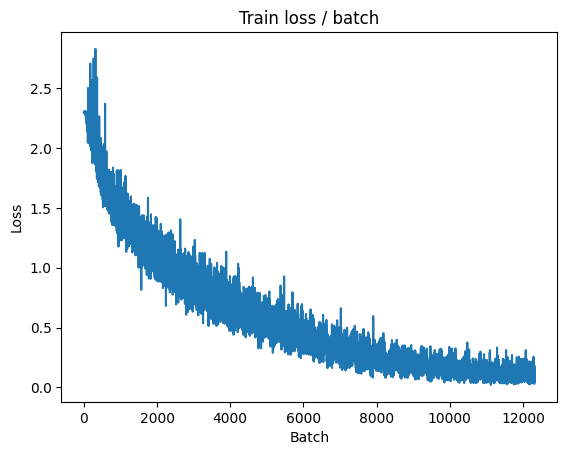


===============> Total time 10s	Avg loss 0.1038	Avg Prec@1 96.39 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.2646 (1.2646)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.3148	Avg Prec@1 74.07 %	Avg Prec@5 97.77 %



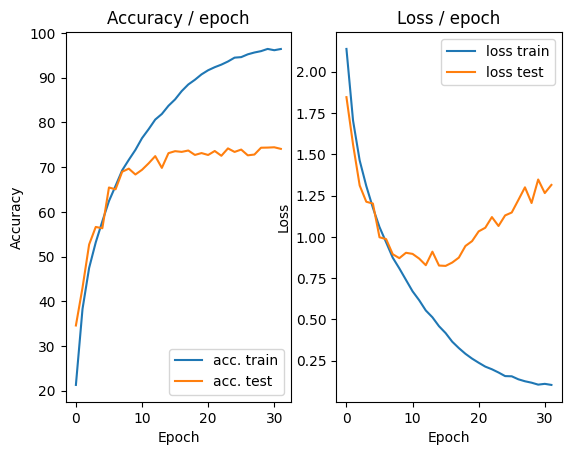

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.1084 (0.1084)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


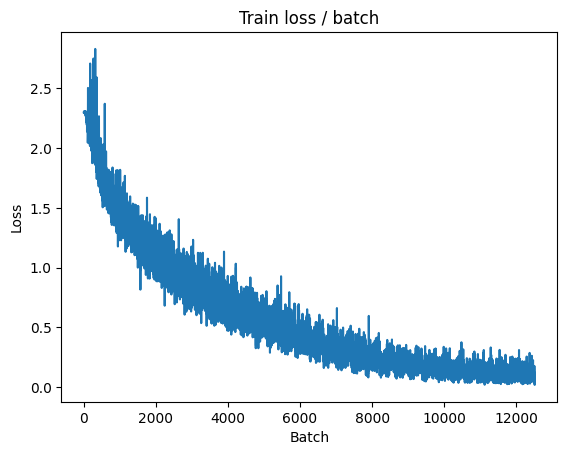

[TRAIN Batch 200/391]	Time 0.050s (0.030s)	Loss 0.1461 (0.0851)	Prec@1  97.7 ( 97.1)	Prec@5 100.0 (100.0)


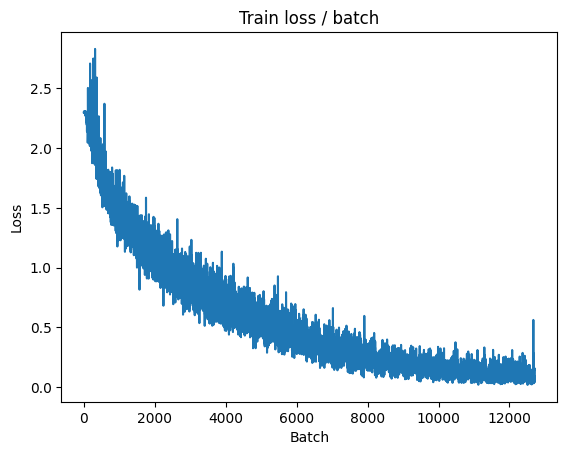


===============> Total time 10s	Avg loss 0.0980	Avg Prec@1 96.68 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.2910 (1.2910)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.3355	Avg Prec@1 73.59 %	Avg Prec@5 97.77 %



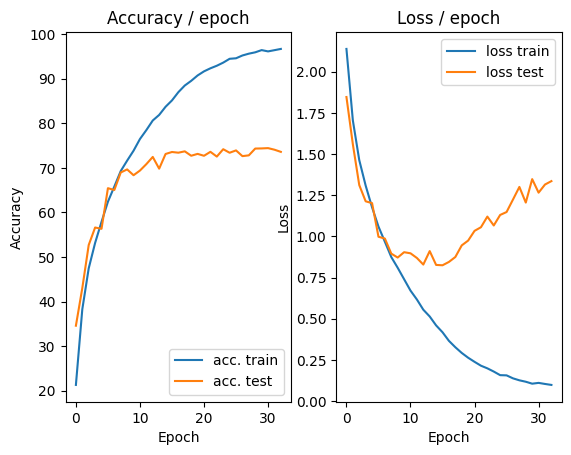

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.0864 (0.0864)	Prec@1  96.9 ( 96.9)	Prec@5  99.2 ( 99.2)


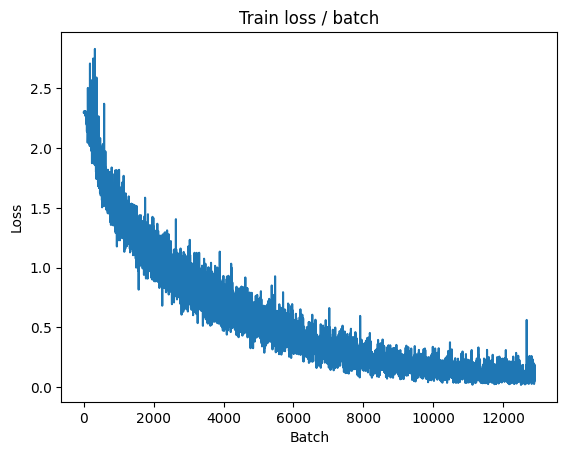

[TRAIN Batch 200/391]	Time 0.023s (0.031s)	Loss 0.0239 (0.0830)	Prec@1  99.2 ( 97.1)	Prec@5 100.0 (100.0)


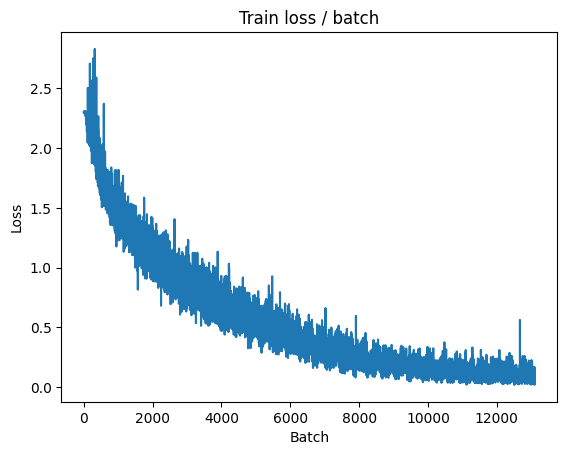


===============> Total time 10s	Avg loss 0.0917	Avg Prec@1 96.80 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 1.4799 (1.4799)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.3678	Avg Prec@1 74.05 %	Avg Prec@5 97.96 %



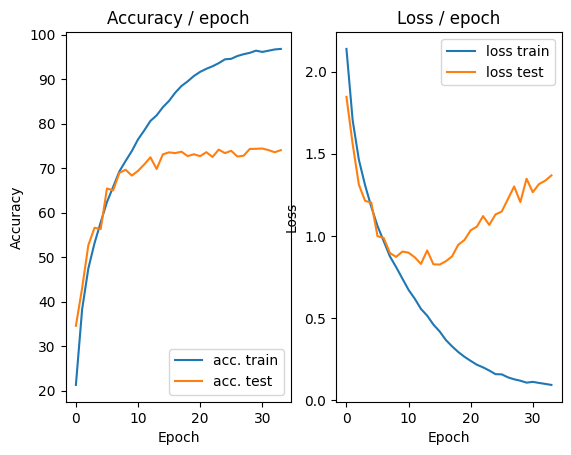

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.0974 (0.0974)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


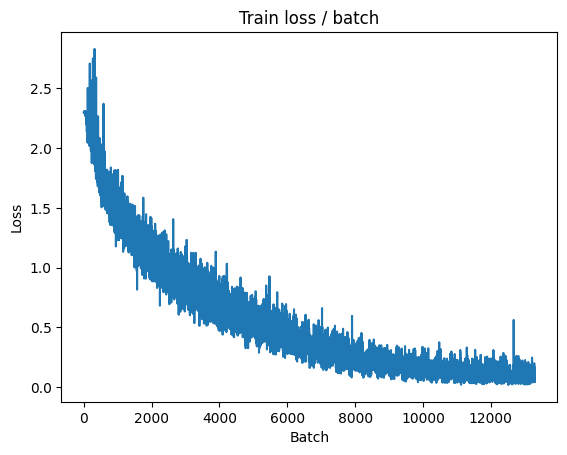

[TRAIN Batch 200/391]	Time 0.017s (0.033s)	Loss 0.1158 (0.0780)	Prec@1  96.1 ( 97.2)	Prec@5 100.0 (100.0)


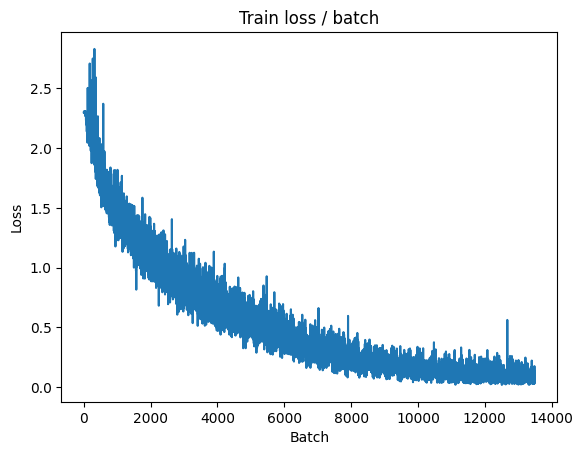


===============> Total time 11s	Avg loss 0.0857	Avg Prec@1 96.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 1.2997 (1.2997)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.3545	Avg Prec@1 73.45 %	Avg Prec@5 97.63 %



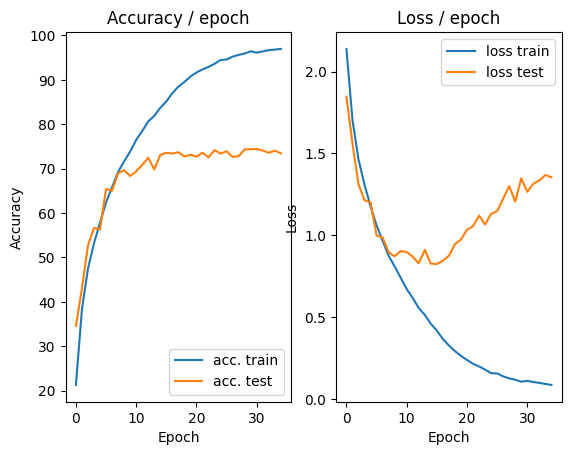

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.1165 (0.1165)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


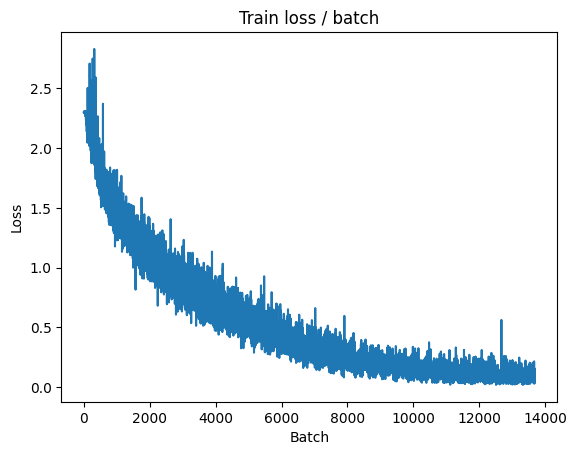

[TRAIN Batch 200/391]	Time 0.016s (0.030s)	Loss 0.1620 (0.0843)	Prec@1  96.1 ( 97.1)	Prec@5 100.0 (100.0)


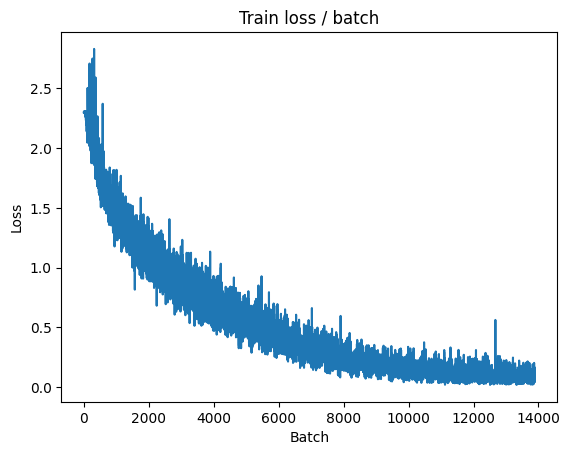


===============> Total time 10s	Avg loss 0.0843	Avg Prec@1 97.04 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.2623 (1.2623)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.4052	Avg Prec@1 74.00 %	Avg Prec@5 97.87 %



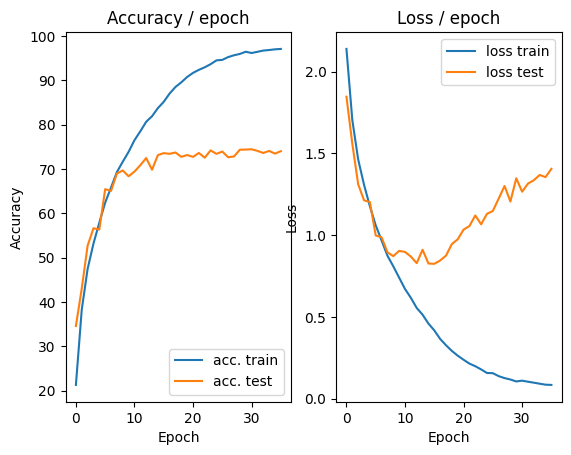

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.197s (0.197s)	Loss 0.0750 (0.0750)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


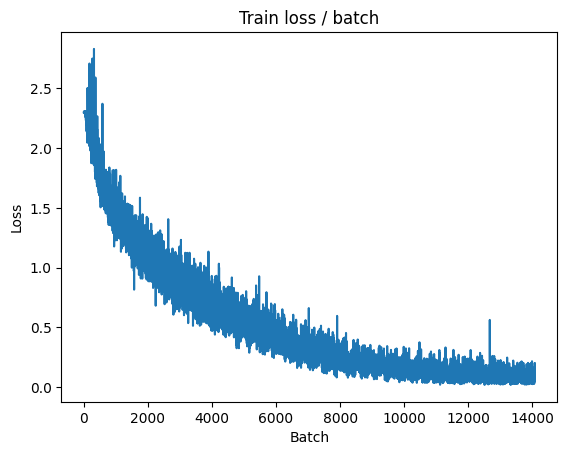

[TRAIN Batch 200/391]	Time 0.019s (0.030s)	Loss 0.0289 (0.0758)	Prec@1 100.0 ( 97.3)	Prec@5 100.0 (100.0)


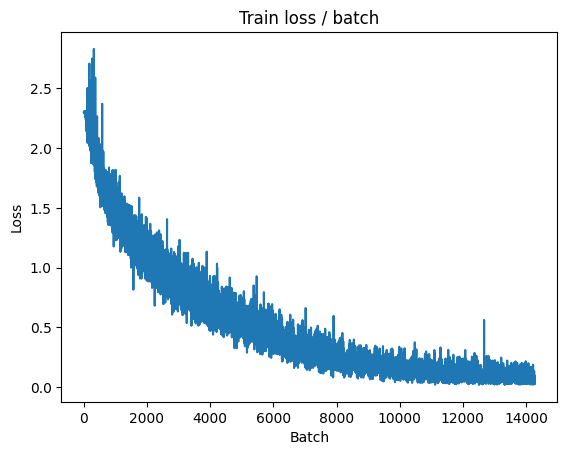


===============> Total time 10s	Avg loss 0.0781	Avg Prec@1 97.31 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.6087 (1.6087)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4680	Avg Prec@1 73.88 %	Avg Prec@5 97.85 %



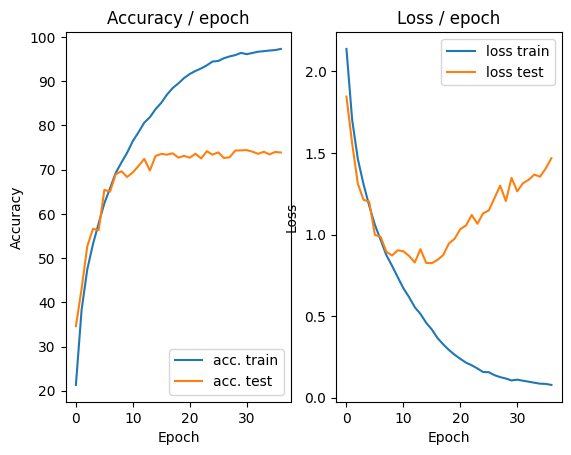

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 0.0821 (0.0821)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


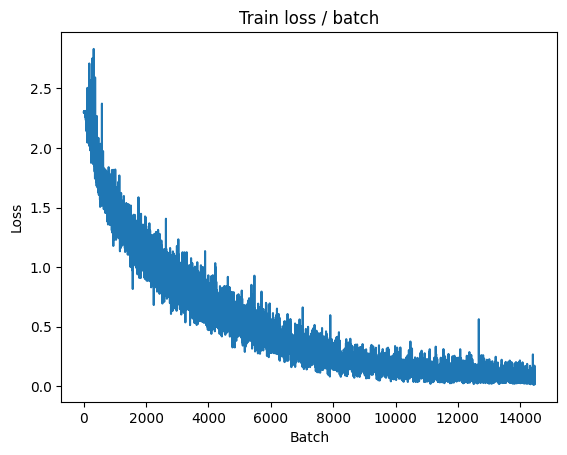

[TRAIN Batch 200/391]	Time 0.009s (0.030s)	Loss 0.0506 (0.0760)	Prec@1  98.4 ( 97.4)	Prec@5 100.0 (100.0)


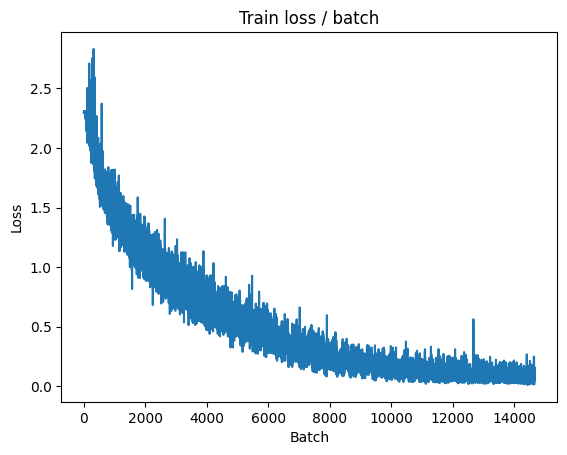


===============> Total time 10s	Avg loss 0.0835	Avg Prec@1 97.10 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.3834 (1.3834)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4752	Avg Prec@1 73.11 %	Avg Prec@5 97.81 %



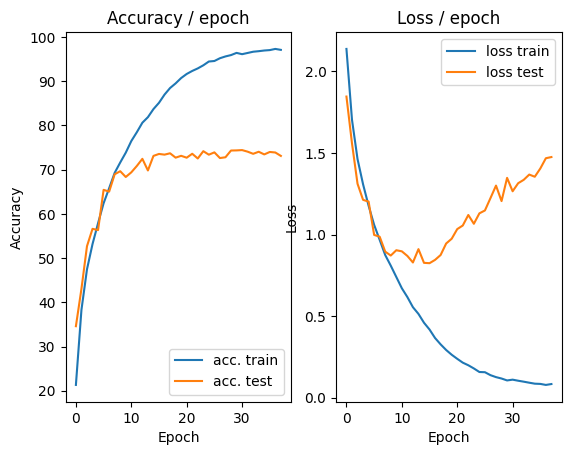

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0708 (0.0708)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


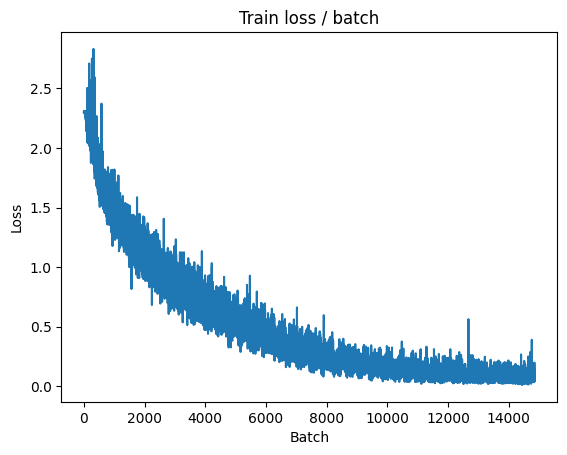

[TRAIN Batch 200/391]	Time 0.031s (0.030s)	Loss 0.0280 (0.0676)	Prec@1  99.2 ( 97.7)	Prec@5 100.0 (100.0)


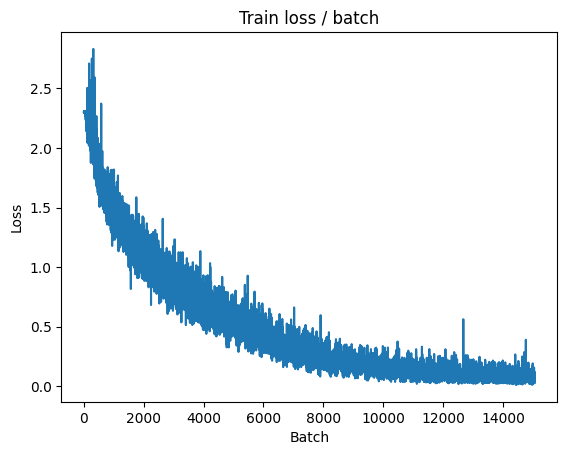


===============> Total time 10s	Avg loss 0.0718	Avg Prec@1 97.56 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.3410 (1.3410)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.5681	Avg Prec@1 73.57 %	Avg Prec@5 97.95 %



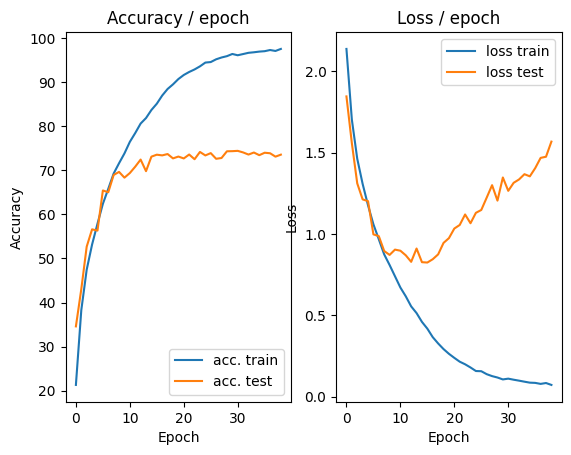

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.0442 (0.0442)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


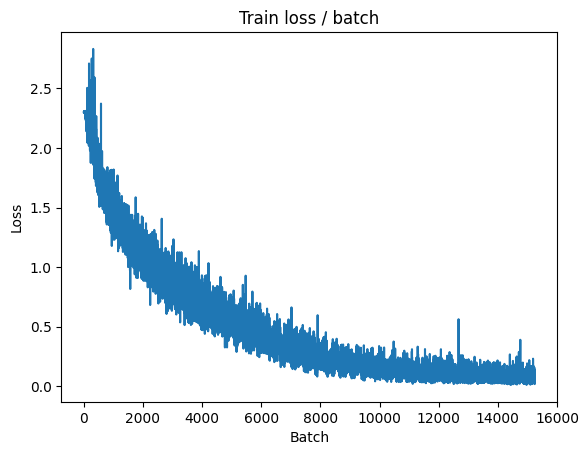

[TRAIN Batch 200/391]	Time 0.015s (0.035s)	Loss 0.0255 (0.0671)	Prec@1 100.0 ( 97.8)	Prec@5 100.0 (100.0)


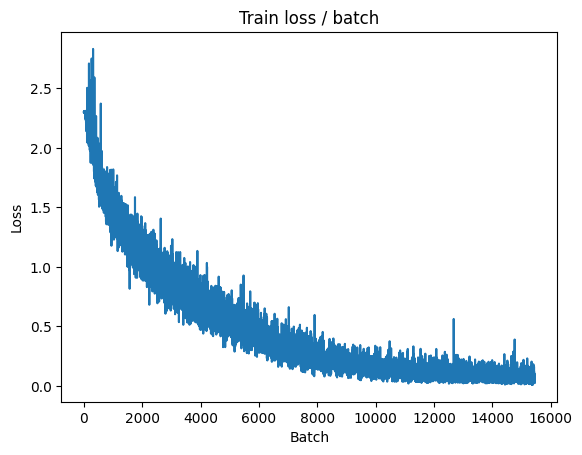


===============> Total time 11s	Avg loss 0.0721	Avg Prec@1 97.57 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.6025 (1.6025)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.5487	Avg Prec@1 73.47 %	Avg Prec@5 97.64 %



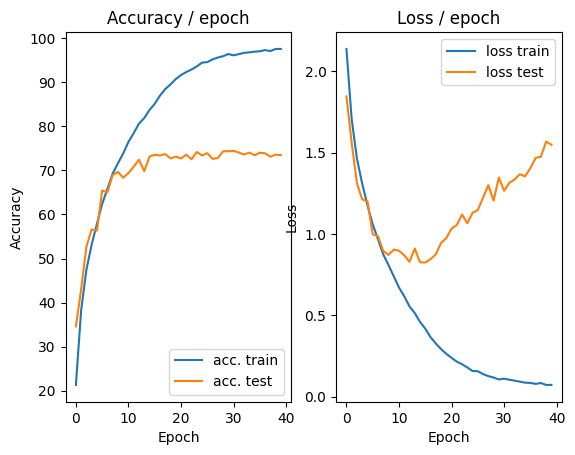

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True, model=ConvNetDropOut(0.5))

In [ ]:
class ConvNetBatchNorm(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNetBatchNorm, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),

            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )

        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10),
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 2.3428 (2.3428)	Prec@1   5.5 (  5.5)	Prec@5  43.0 ( 43.0)


<Figure size 640x480 with 0 Axes>

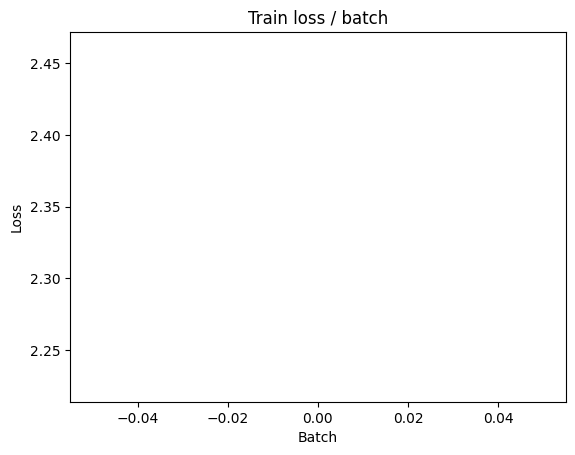

[TRAIN Batch 200/391]	Time 0.028s (0.029s)	Loss 1.4178 (1.5796)	Prec@1  50.0 ( 41.9)	Prec@5  90.6 ( 89.8)


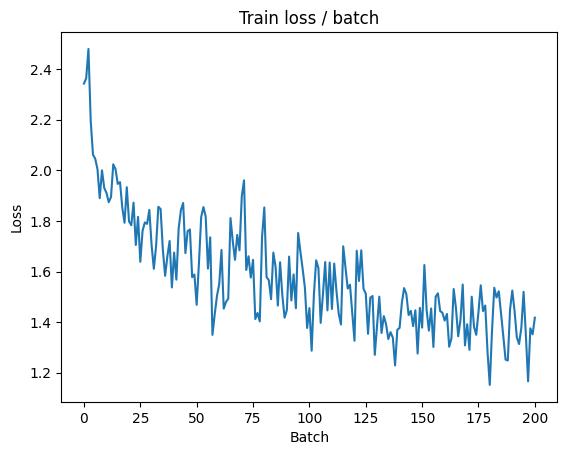


===============> Total time 10s	Avg loss 1.4203	Avg Prec@1 48.25 %	Avg Prec@5 92.25 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 4.0762 (4.0762)	Prec@1  18.8 ( 18.8)	Prec@5  79.7 ( 79.7)

===============> Total time 1s	Avg loss 4.3633	Avg Prec@1 20.43 %	Avg Prec@5 79.49 %



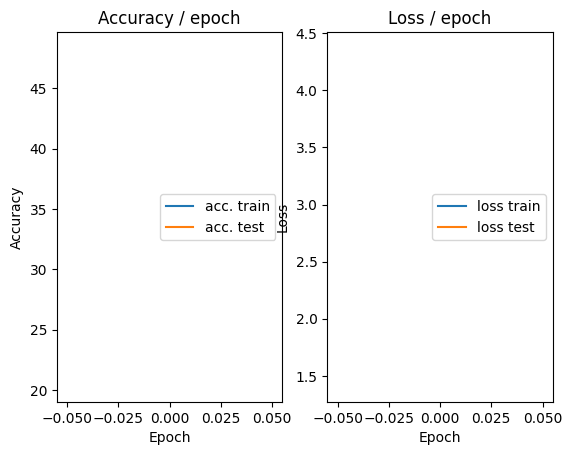

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.0945 (1.0945)	Prec@1  55.5 ( 55.5)	Prec@5  96.1 ( 96.1)


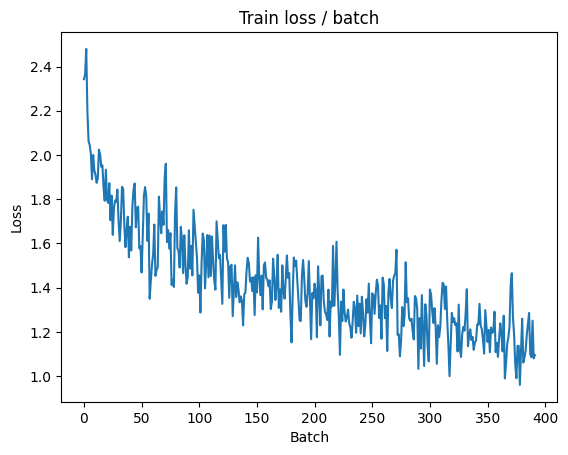

[TRAIN Batch 200/391]	Time 0.054s (0.028s)	Loss 1.1013 (1.0552)	Prec@1  62.5 ( 62.1)	Prec@5  96.9 ( 96.5)


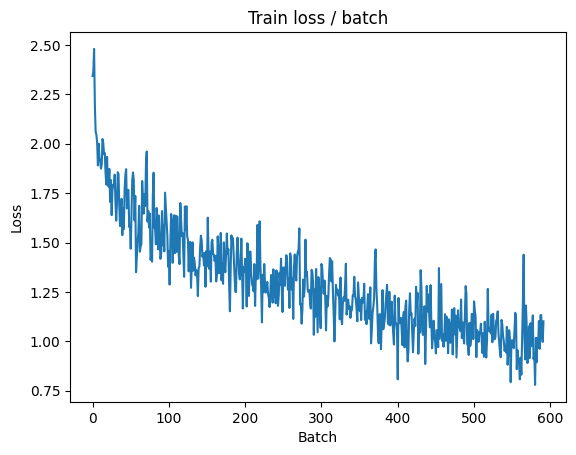


===============> Total time 10s	Avg loss 1.0016	Avg Prec@1 64.11 %	Avg Prec@5 96.93 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.1252 (1.1252)	Prec@1  57.0 ( 57.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.2493	Avg Prec@1 54.18 %	Avg Prec@5 94.74 %



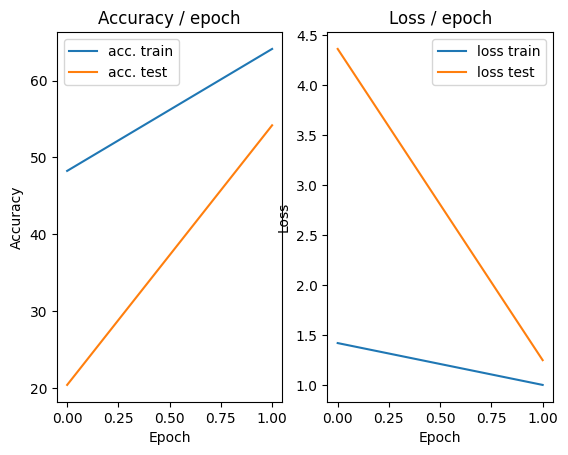

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.0121 (1.0121)	Prec@1  64.1 ( 64.1)	Prec@5  96.9 ( 96.9)


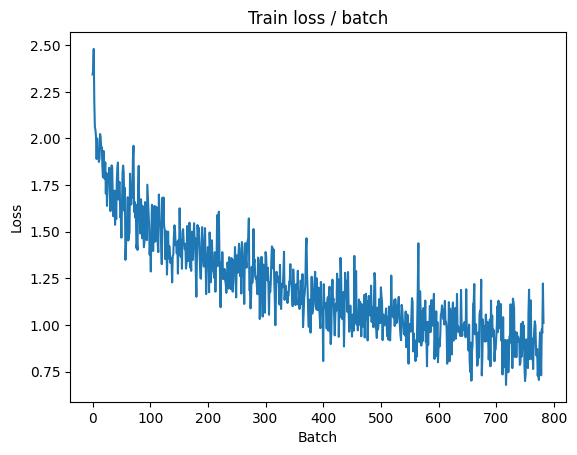

[TRAIN Batch 200/391]	Time 0.019s (0.024s)	Loss 0.8720 (0.8325)	Prec@1  65.6 ( 70.4)	Prec@5  99.2 ( 98.1)


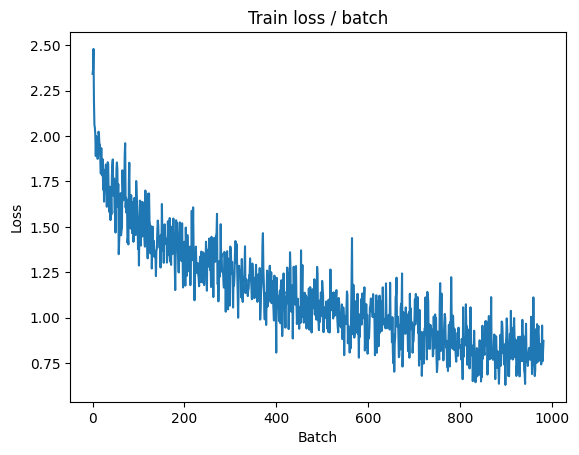


===============> Total time 9s	Avg loss 0.8139	Avg Prec@1 71.15 %	Avg Prec@5 98.08 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 1.4616 (1.4616)	Prec@1  55.5 ( 55.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.8215	Avg Prec@1 46.92 %	Avg Prec@5 91.16 %



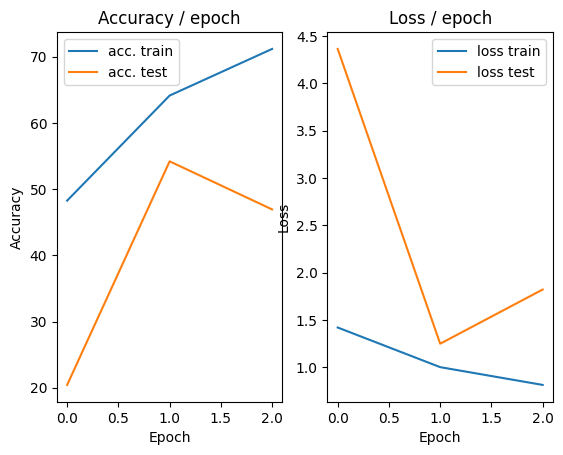

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.8850 (0.8850)	Prec@1  65.6 ( 65.6)	Prec@5  98.4 ( 98.4)


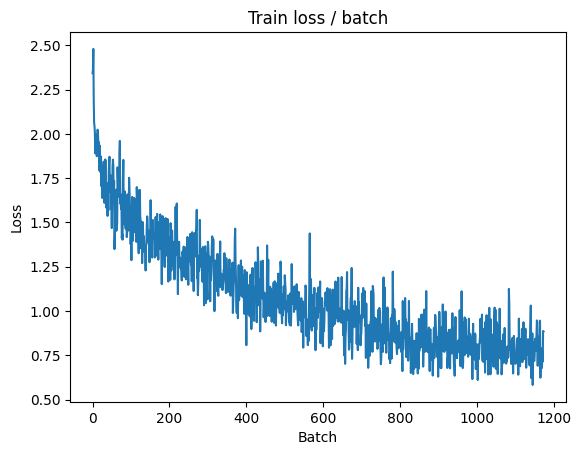

[TRAIN Batch 200/391]	Time 0.036s (0.023s)	Loss 0.6595 (0.6978)	Prec@1  78.9 ( 75.0)	Prec@5  99.2 ( 98.6)


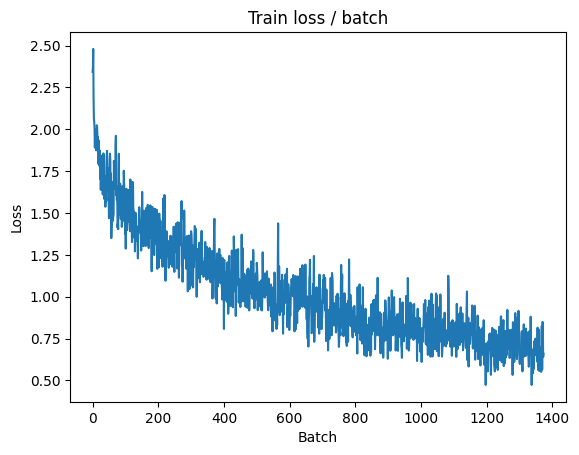


===============> Total time 9s	Avg loss 0.6844	Avg Prec@1 75.59 %	Avg Prec@5 98.65 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 1.0427 (1.0427)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2476	Avg Prec@1 60.97 %	Avg Prec@5 94.18 %



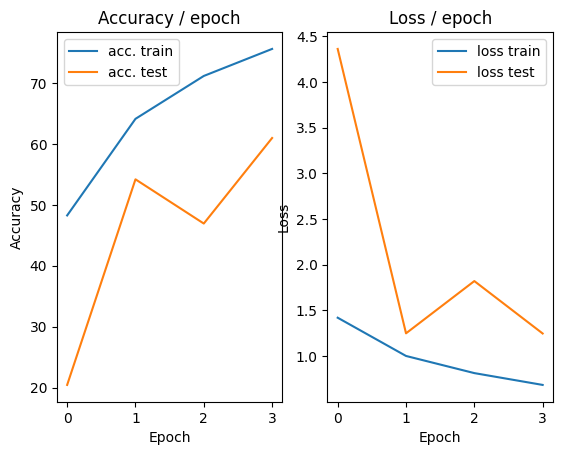

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.6902 (0.6902)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


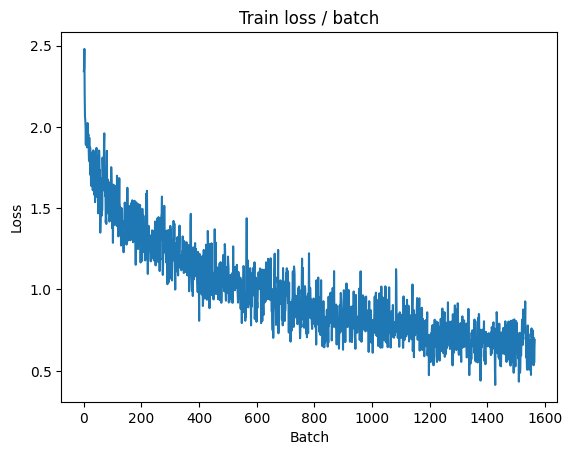

[TRAIN Batch 200/391]	Time 0.026s (0.025s)	Loss 0.5713 (0.5839)	Prec@1  81.2 ( 79.5)	Prec@5 100.0 ( 99.1)


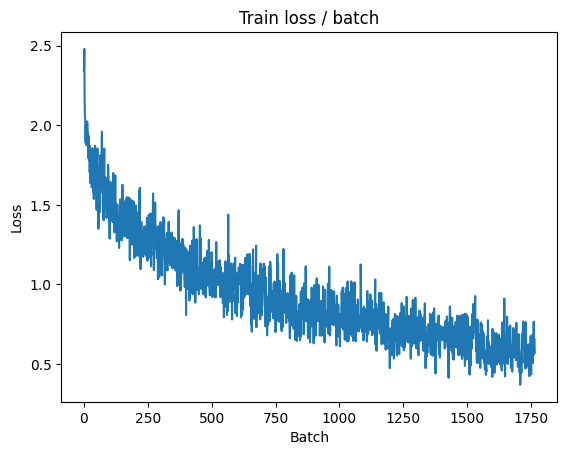


===============> Total time 11s	Avg loss 0.5883	Avg Prec@1 79.36 %	Avg Prec@5 99.01 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.7648 (0.7648)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9915	Avg Prec@1 67.01 %	Avg Prec@5 97.39 %



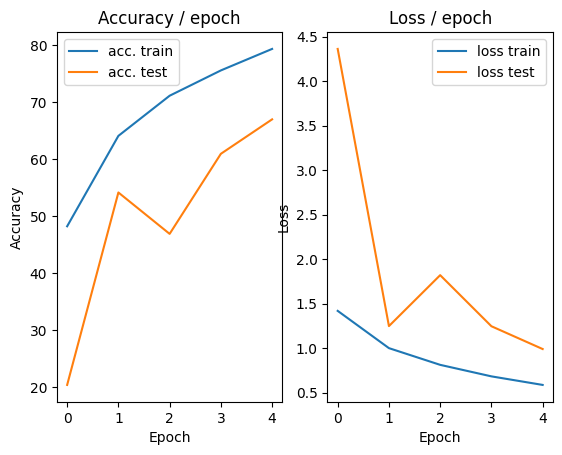

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.6978 (0.6978)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


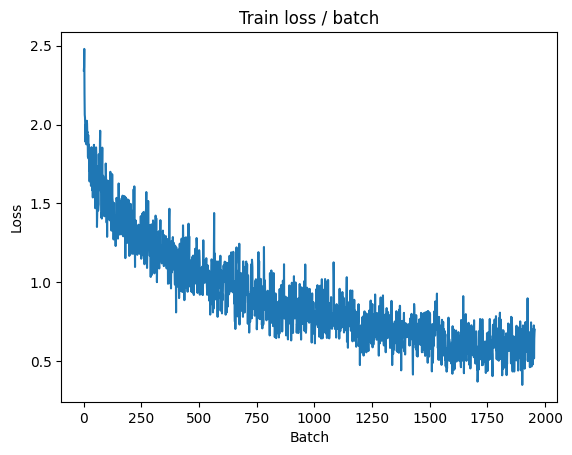

[TRAIN Batch 200/391]	Time 0.029s (0.024s)	Loss 0.4446 (0.4989)	Prec@1  82.8 ( 82.6)	Prec@5  99.2 ( 99.3)


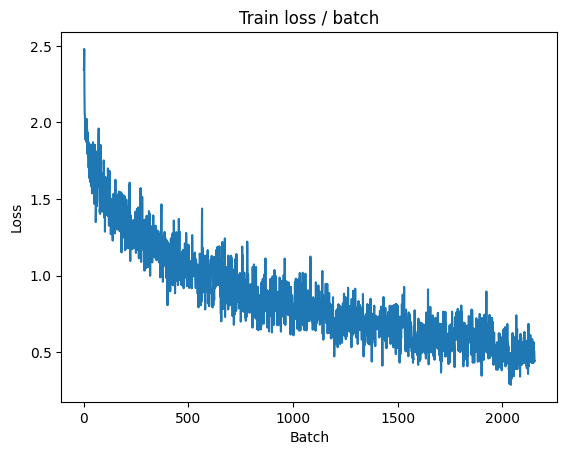


===============> Total time 10s	Avg loss 0.5032	Avg Prec@1 82.25 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 0.8247 (0.8247)	Prec@1  69.5 ( 69.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 1.1478	Avg Prec@1 63.19 %	Avg Prec@5 96.57 %



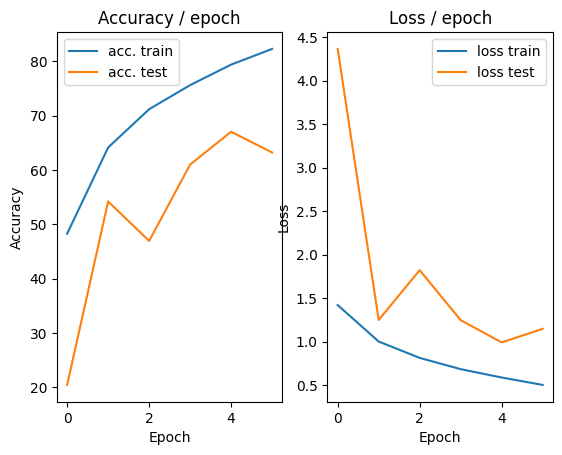

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.4165 (0.4165)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


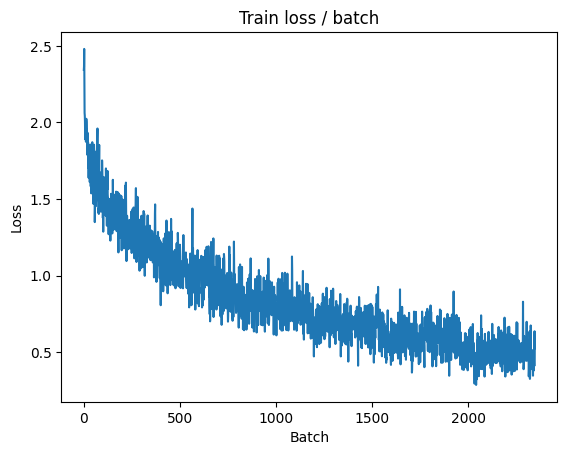

[TRAIN Batch 200/391]	Time 0.029s (0.024s)	Loss 0.3579 (0.4250)	Prec@1  89.1 ( 85.2)	Prec@5 100.0 ( 99.5)


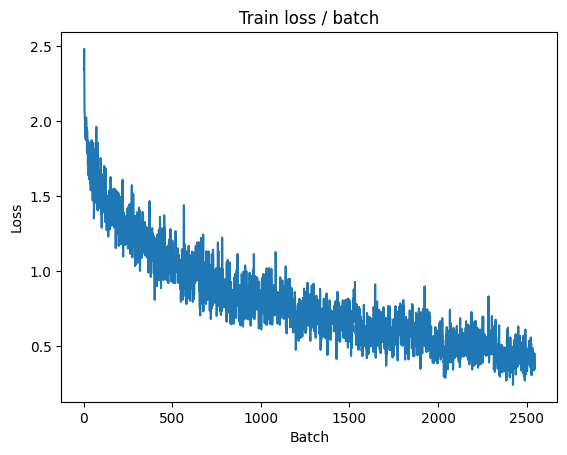


===============> Total time 10s	Avg loss 0.4308	Avg Prec@1 84.92 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.6328 (0.6328)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7111	Avg Prec@1 75.79 %	Avg Prec@5 98.17 %



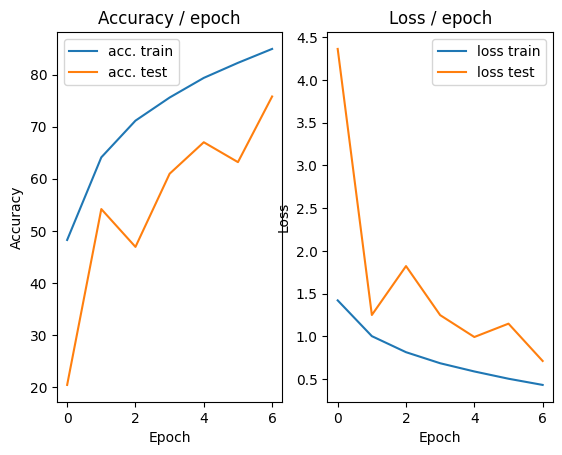

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.3689 (0.3689)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


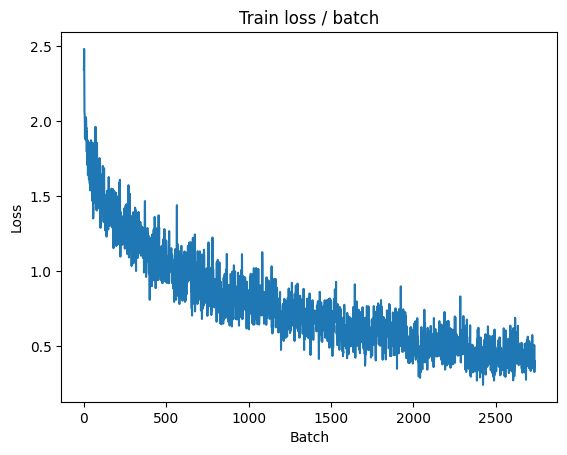

[TRAIN Batch 200/391]	Time 0.015s (0.023s)	Loss 0.2477 (0.3648)	Prec@1  91.4 ( 87.4)	Prec@5 100.0 ( 99.7)


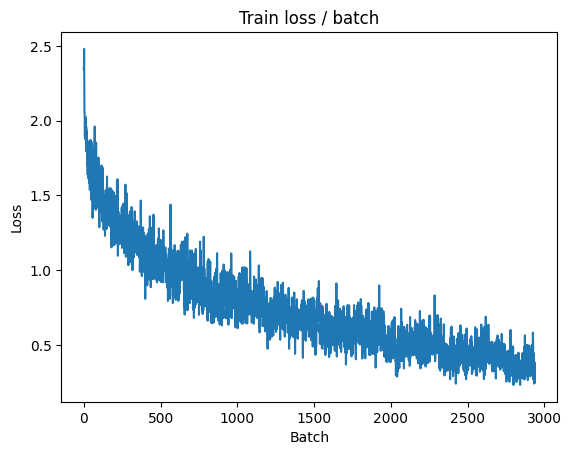


===============> Total time 10s	Avg loss 0.3700	Avg Prec@1 87.13 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.7704 (0.7704)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8779	Avg Prec@1 71.44 %	Avg Prec@5 97.62 %



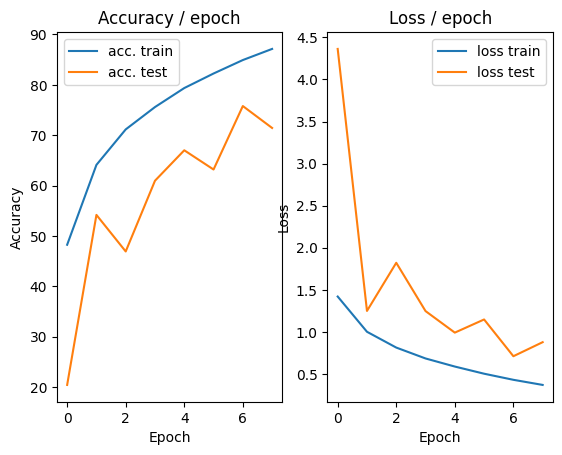

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.3883 (0.3883)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


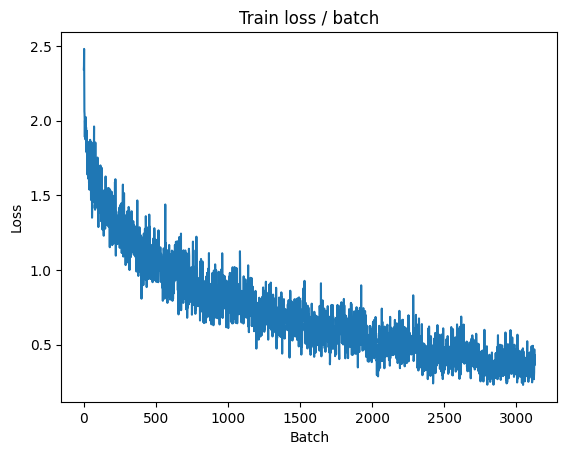

[TRAIN Batch 200/391]	Time 0.008s (0.024s)	Loss 0.2592 (0.2985)	Prec@1  91.4 ( 89.6)	Prec@5 100.0 ( 99.8)


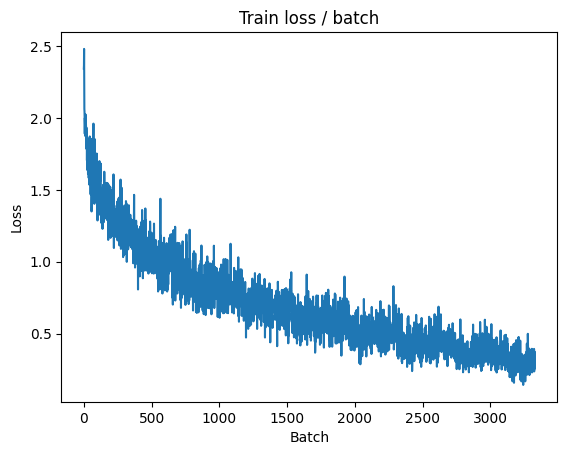


===============> Total time 10s	Avg loss 0.3119	Avg Prec@1 89.19 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.8293 (0.8293)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0376	Avg Prec@1 68.04 %	Avg Prec@5 97.05 %



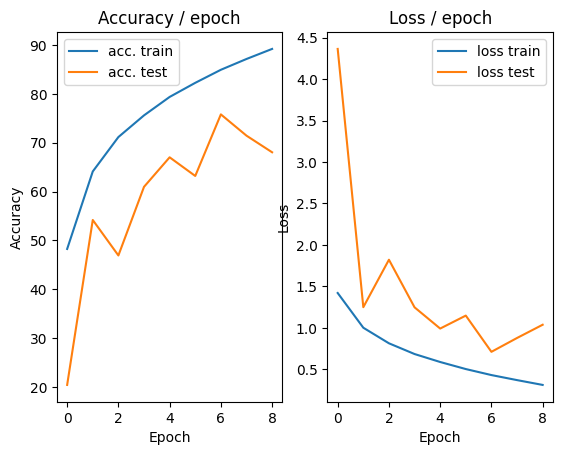

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.2559 (0.2559)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


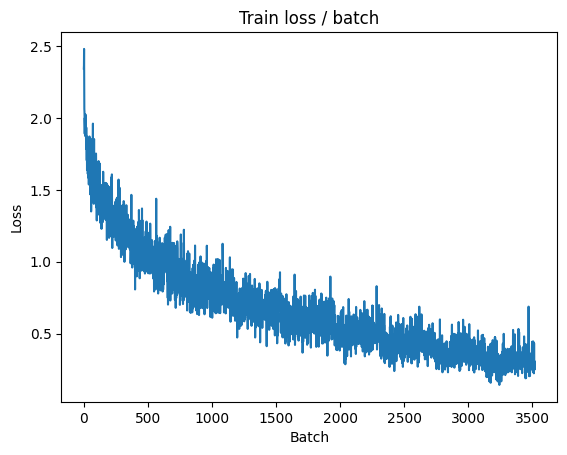

[TRAIN Batch 200/391]	Time 0.038s (0.025s)	Loss 0.3130 (0.2454)	Prec@1  85.9 ( 91.8)	Prec@5 100.0 ( 99.9)


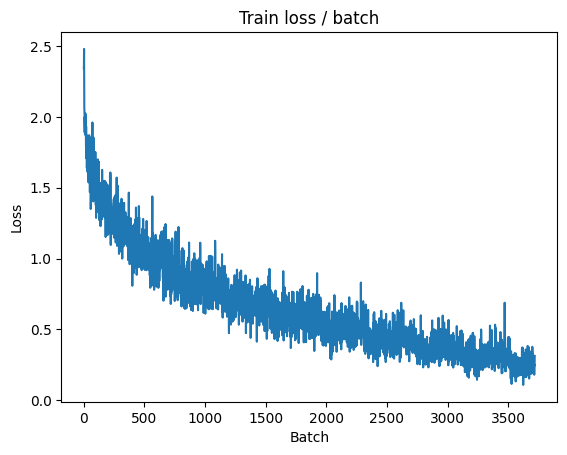


===============> Total time 11s	Avg loss 0.2565	Avg Prec@1 91.28 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.194s (0.194s)	Loss 0.8097 (0.8097)	Prec@1  75.0 ( 75.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8906	Avg Prec@1 73.89 %	Avg Prec@5 97.52 %



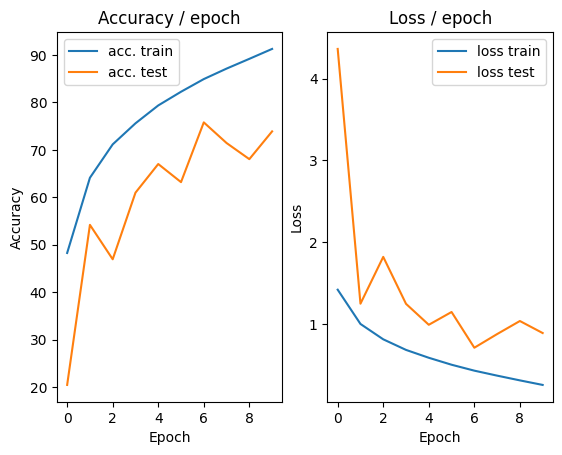

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.2654 (0.2654)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


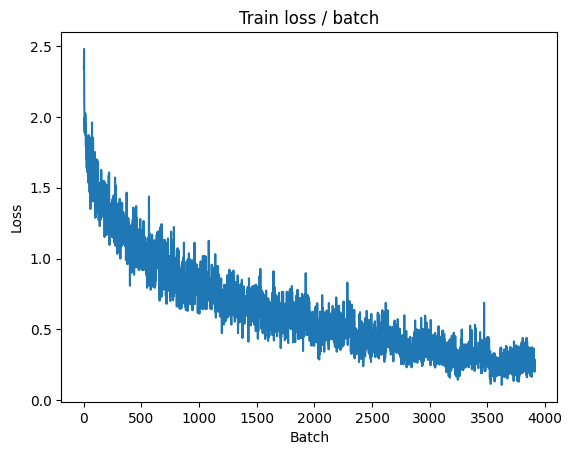

[TRAIN Batch 200/391]	Time 0.014s (0.023s)	Loss 0.2859 (0.1915)	Prec@1  90.6 ( 93.9)	Prec@5 100.0 ( 99.9)


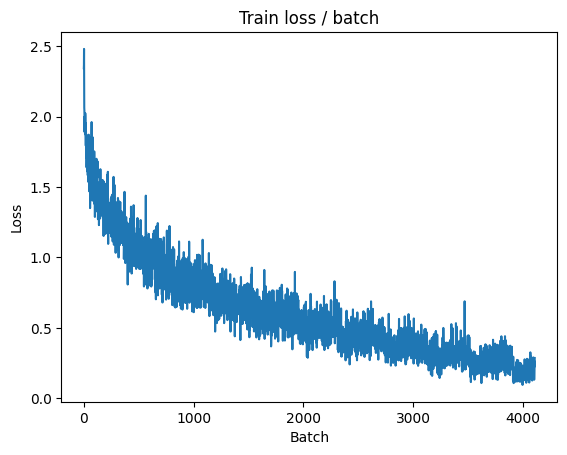


===============> Total time 10s	Avg loss 0.2030	Avg Prec@1 93.42 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.1565 (1.1565)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.1372	Avg Prec@1 68.52 %	Avg Prec@5 96.93 %



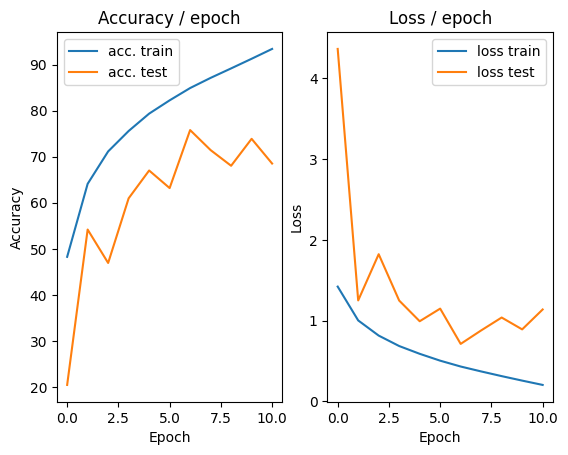

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.1972 (0.1972)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


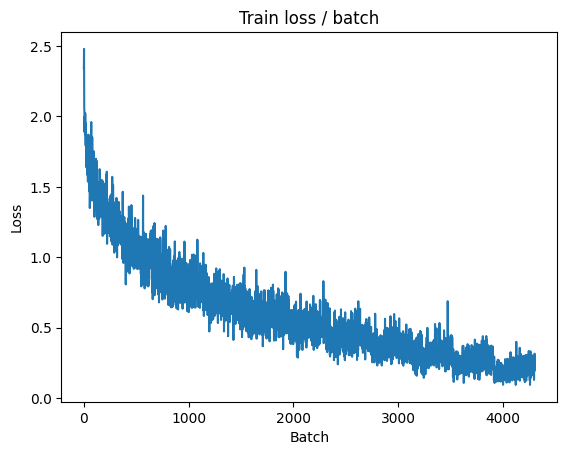

[TRAIN Batch 200/391]	Time 0.031s (0.025s)	Loss 0.1647 (0.1516)	Prec@1  96.1 ( 95.4)	Prec@5 100.0 (100.0)


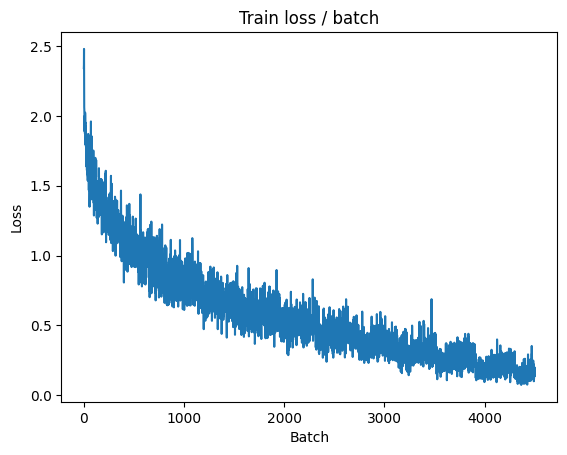


===============> Total time 10s	Avg loss 0.1615	Avg Prec@1 94.91 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.7082 (0.7082)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7406	Avg Prec@1 78.13 %	Avg Prec@5 98.49 %



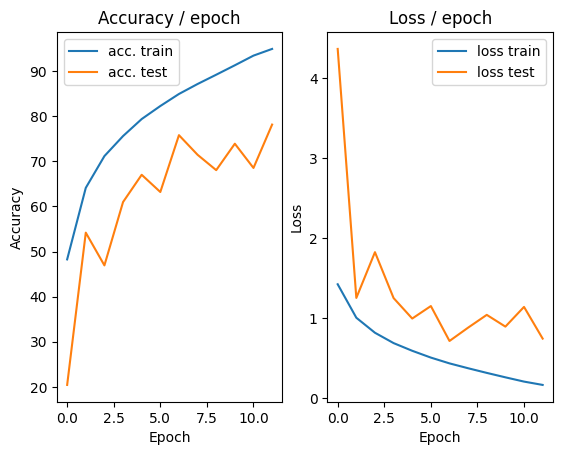

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.1555 (0.1555)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


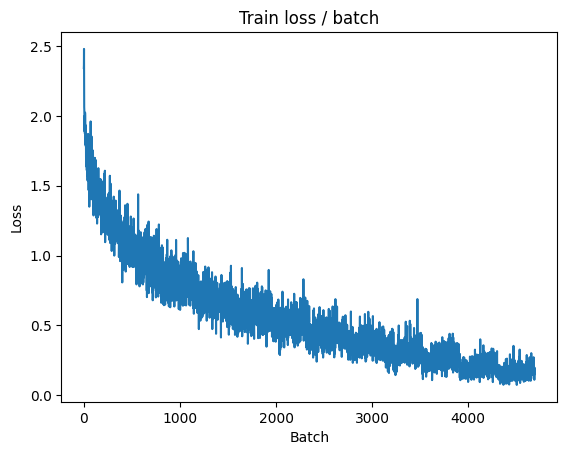

[TRAIN Batch 200/391]	Time 0.031s (0.024s)	Loss 0.0852 (0.1081)	Prec@1  97.7 ( 97.0)	Prec@5 100.0 (100.0)


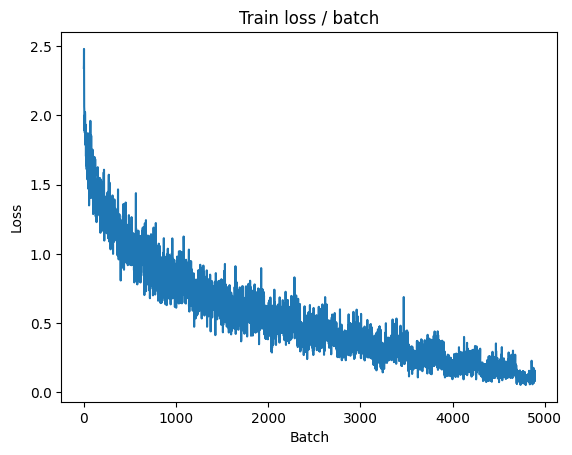


===============> Total time 10s	Avg loss 0.1184	Avg Prec@1 96.56 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.6527 (0.6527)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8225	Avg Prec@1 76.95 %	Avg Prec@5 98.51 %



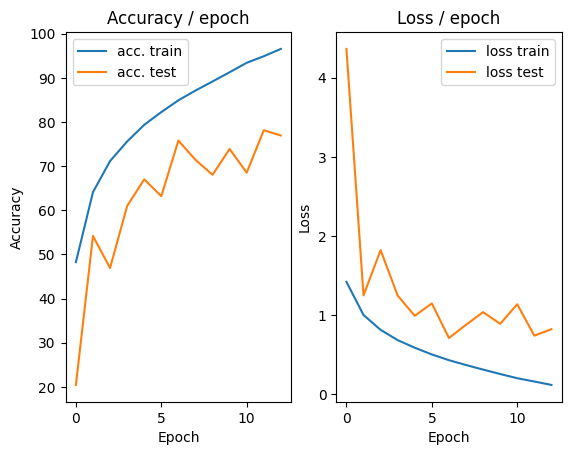

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.1156 (0.1156)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


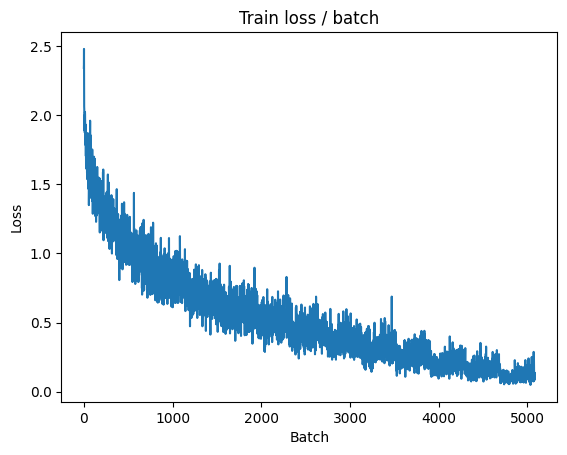

[TRAIN Batch 200/391]	Time 0.020s (0.024s)	Loss 0.0881 (0.0795)	Prec@1  98.4 ( 98.1)	Prec@5 100.0 (100.0)


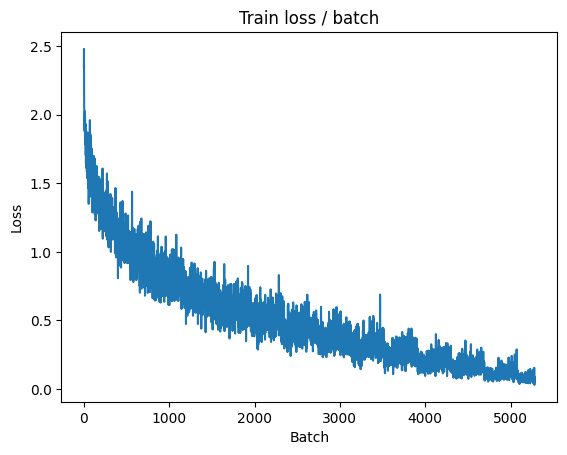


===============> Total time 10s	Avg loss 0.0836	Avg Prec@1 97.87 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.0090 (1.0090)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0660	Avg Prec@1 73.70 %	Avg Prec@5 97.87 %



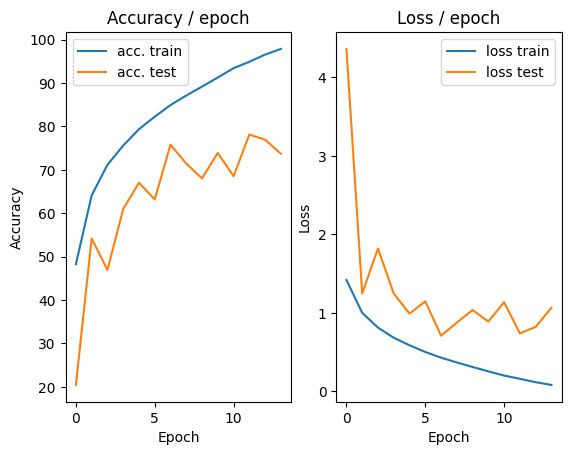

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.1246 (0.1246)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


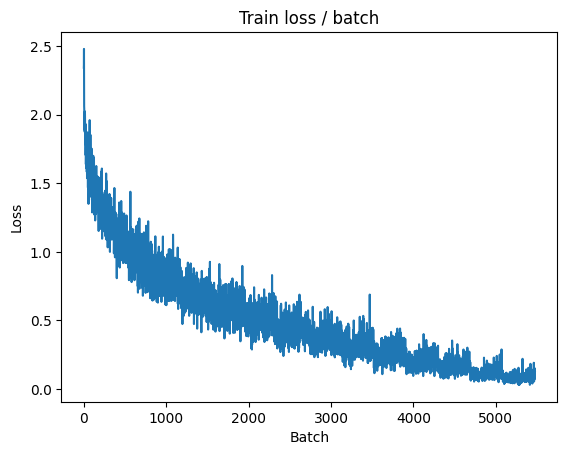

[TRAIN Batch 200/391]	Time 0.020s (0.024s)	Loss 0.0613 (0.0565)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


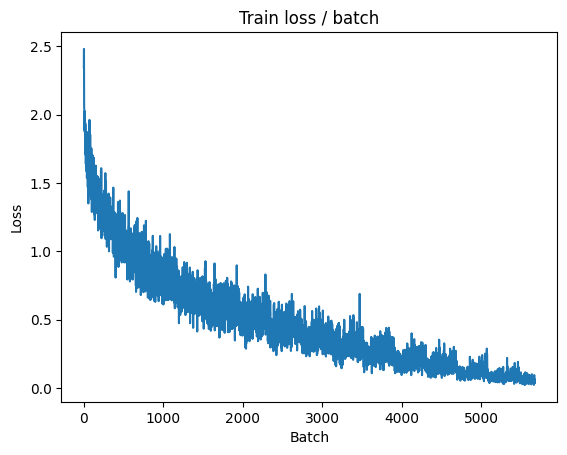


===============> Total time 11s	Avg loss 0.0590	Avg Prec@1 98.74 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.7971 (0.7971)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8062	Avg Prec@1 78.81 %	Avg Prec@5 98.72 %



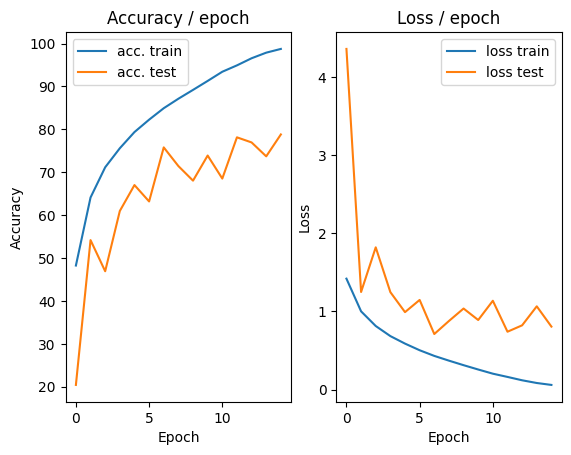

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.0311 (0.0311)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


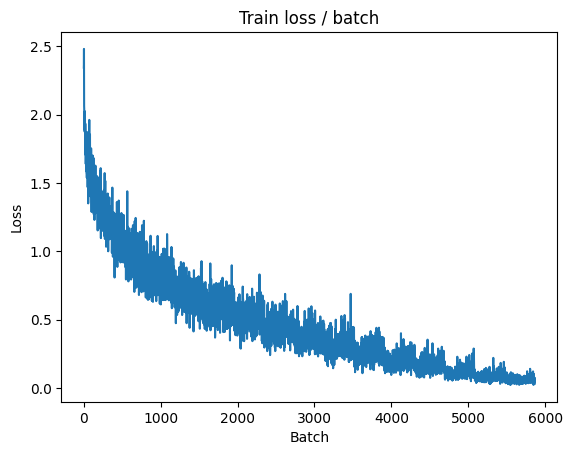

[TRAIN Batch 200/391]	Time 0.020s (0.024s)	Loss 0.0301 (0.0377)	Prec@1 100.0 ( 99.5)	Prec@5 100.0 (100.0)


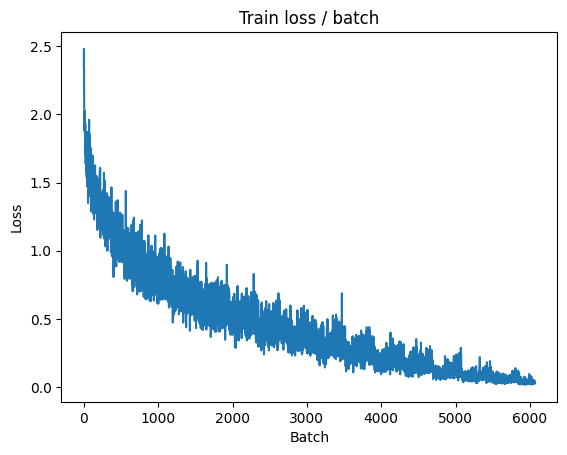


===============> Total time 10s	Avg loss 0.0385	Avg Prec@1 99.42 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7616 (0.7616)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8038	Avg Prec@1 79.45 %	Avg Prec@5 98.59 %



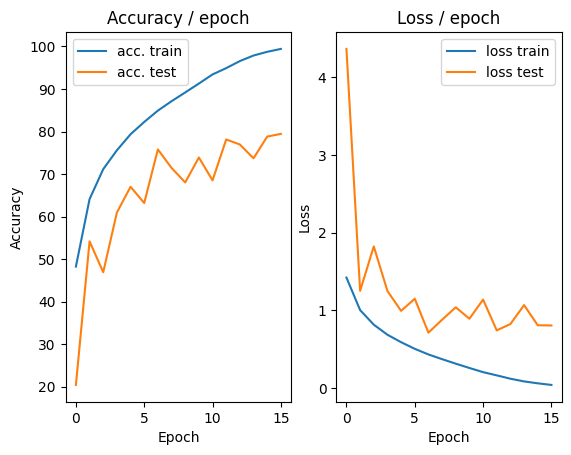

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0479 (0.0479)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


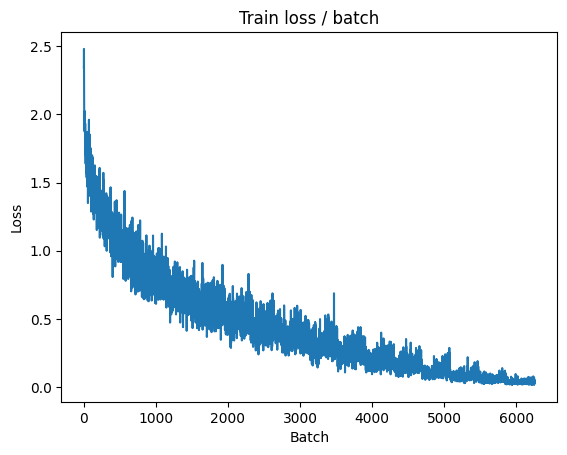

[TRAIN Batch 200/391]	Time 0.033s (0.024s)	Loss 0.0357 (0.0245)	Prec@1  99.2 ( 99.8)	Prec@5 100.0 (100.0)


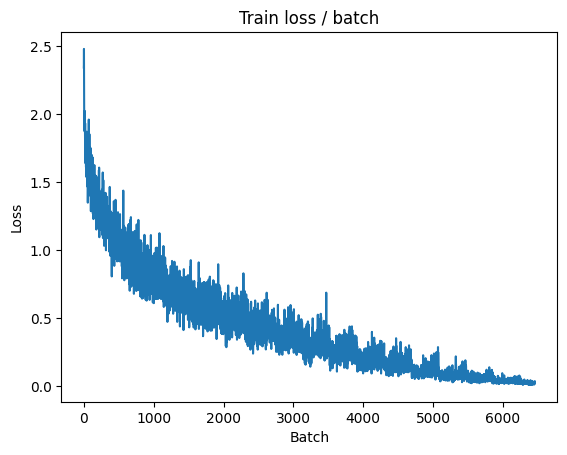


===============> Total time 10s	Avg loss 0.0255	Avg Prec@1 99.76 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.7901 (0.7901)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8146	Avg Prec@1 80.06 %	Avg Prec@5 98.75 %



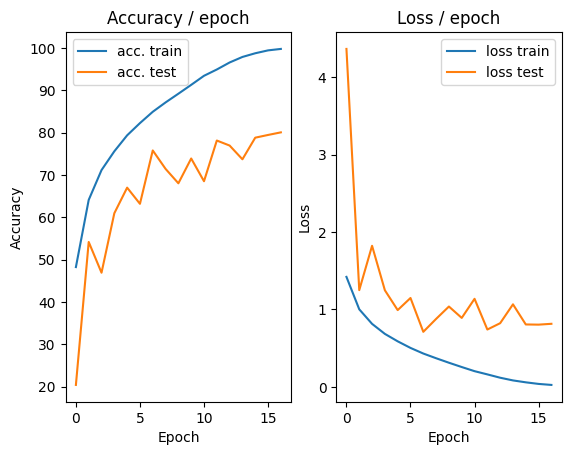

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.0262 (0.0262)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


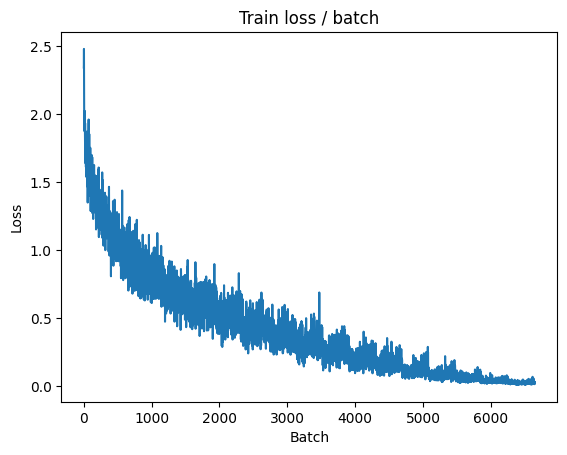

[TRAIN Batch 200/391]	Time 0.016s (0.025s)	Loss 0.0178 (0.0166)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


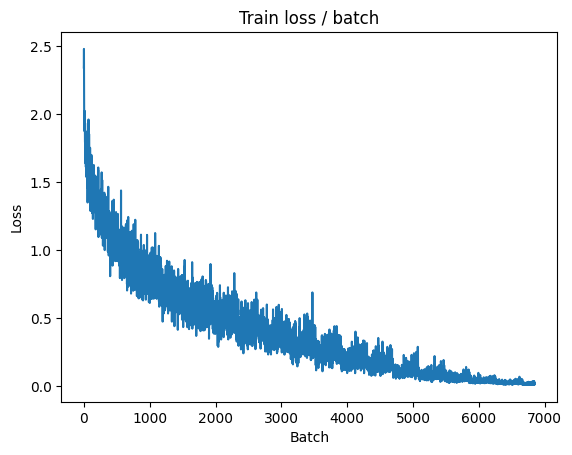


===============> Total time 10s	Avg loss 0.0173	Avg Prec@1 99.91 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.8200 (0.8200)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8256	Avg Prec@1 80.20 %	Avg Prec@5 98.77 %



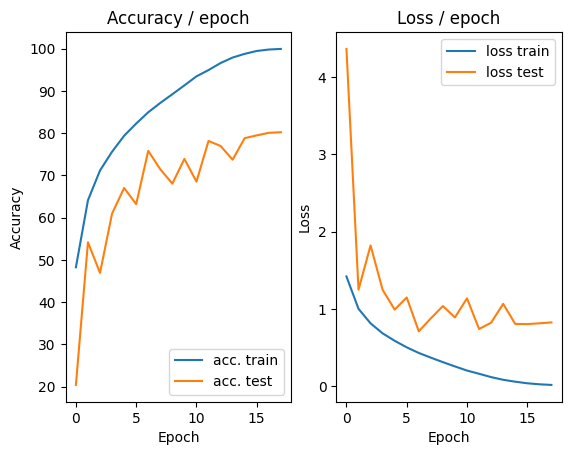

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.186s (0.186s)	Loss 0.0090 (0.0090)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


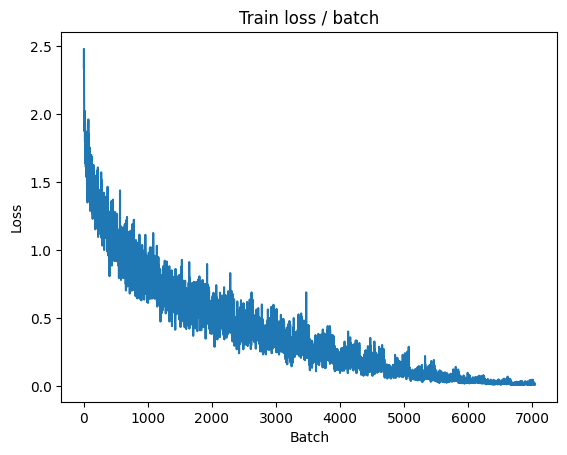

[TRAIN Batch 200/391]	Time 0.013s (0.025s)	Loss 0.0147 (0.0125)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


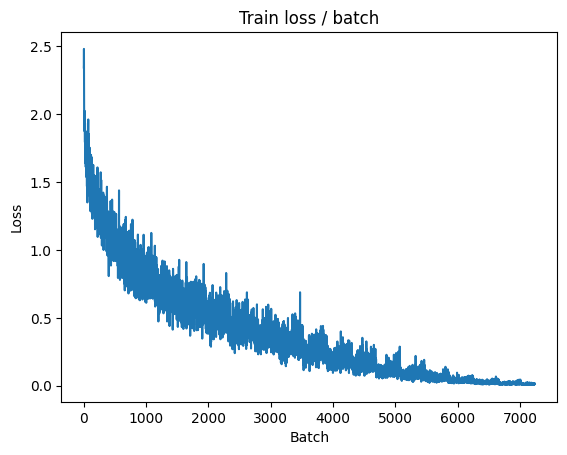


===============> Total time 10s	Avg loss 0.0129	Avg Prec@1 99.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.8311 (0.8311)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8629	Avg Prec@1 80.14 %	Avg Prec@5 98.76 %



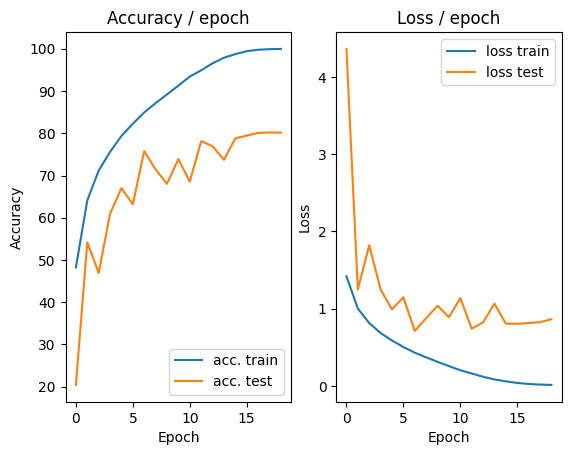

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0095 (0.0095)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


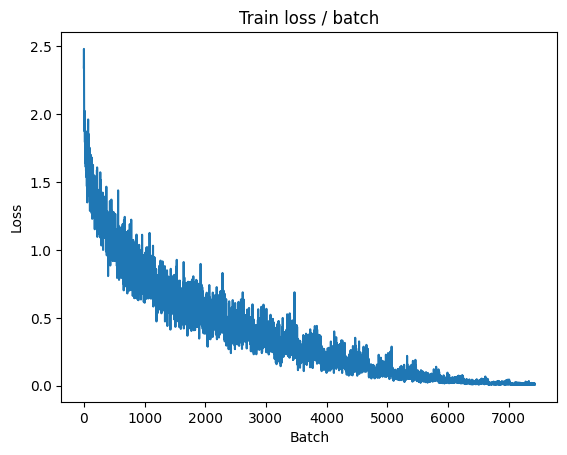

[TRAIN Batch 200/391]	Time 0.027s (0.025s)	Loss 0.0100 (0.0094)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


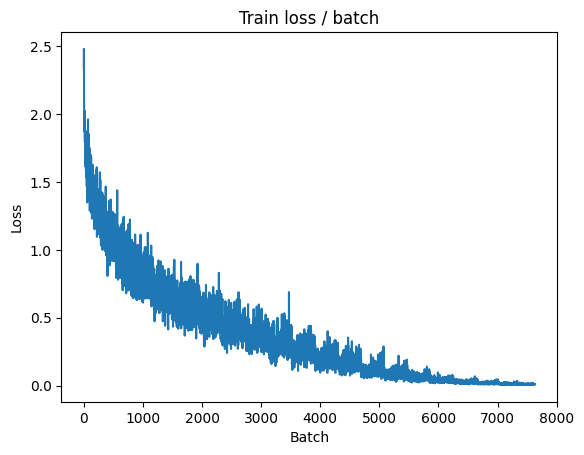


===============> Total time 11s	Avg loss 0.0097	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.7968 (0.7968)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8763	Avg Prec@1 79.90 %	Avg Prec@5 98.75 %



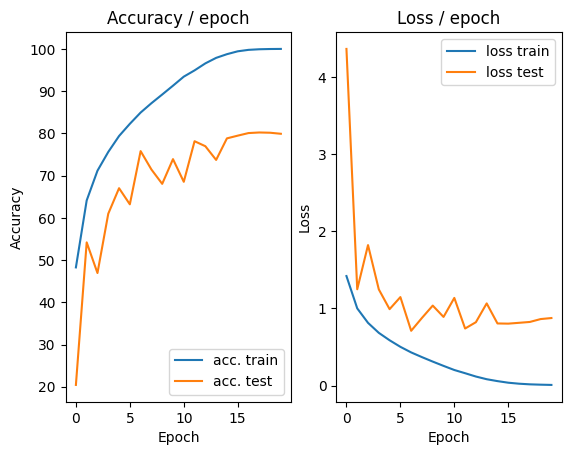

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.0064 (0.0064)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


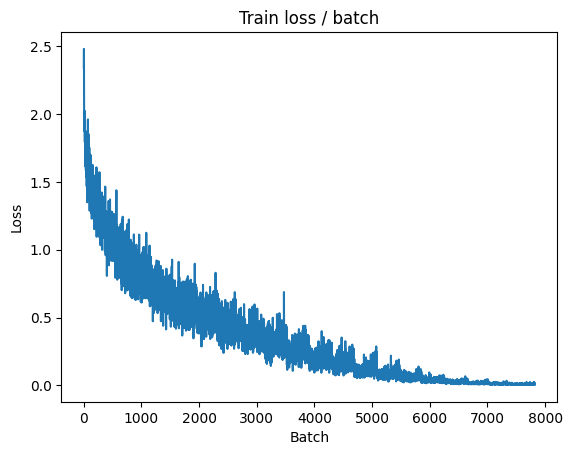

[TRAIN Batch 200/391]	Time 0.012s (0.025s)	Loss 0.0085 (0.0080)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


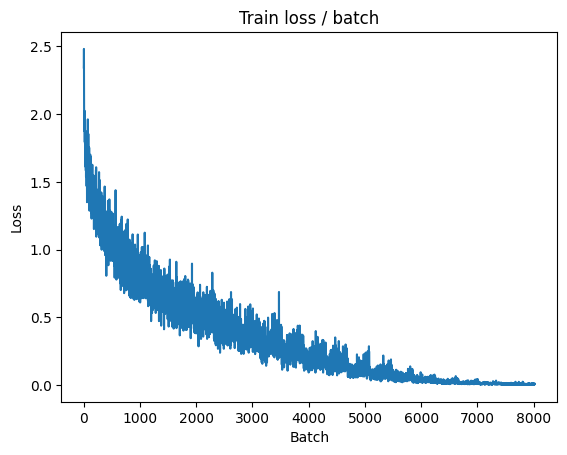


===============> Total time 10s	Avg loss 0.0084	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7450 (0.7450)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8880	Avg Prec@1 80.08 %	Avg Prec@5 98.80 %



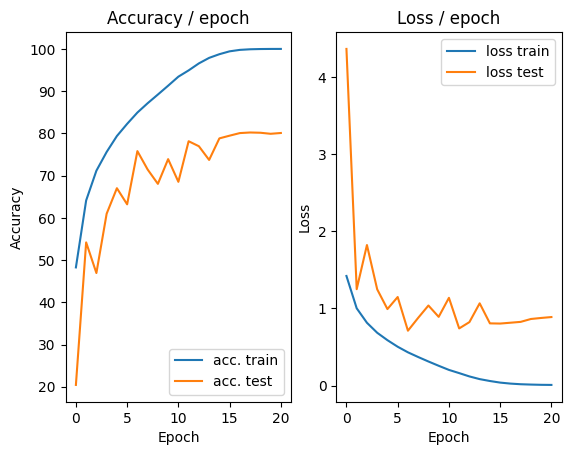

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0180 (0.0180)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


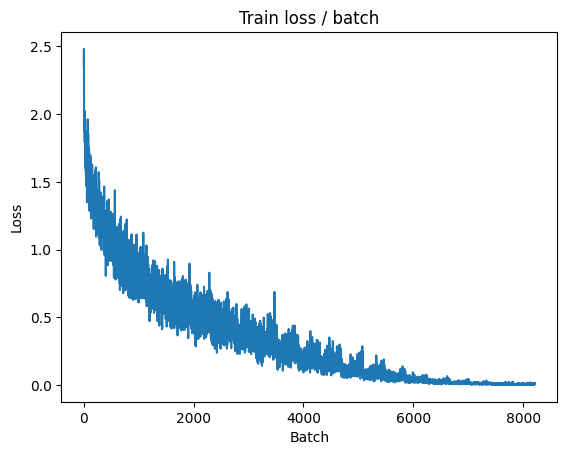

[TRAIN Batch 200/391]	Time 0.032s (0.024s)	Loss 0.0066 (0.0070)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


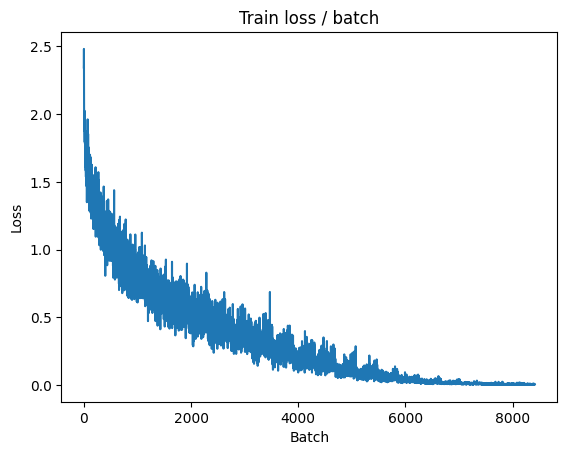


===============> Total time 10s	Avg loss 0.0072	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.8103 (0.8103)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8964	Avg Prec@1 80.04 %	Avg Prec@5 98.84 %



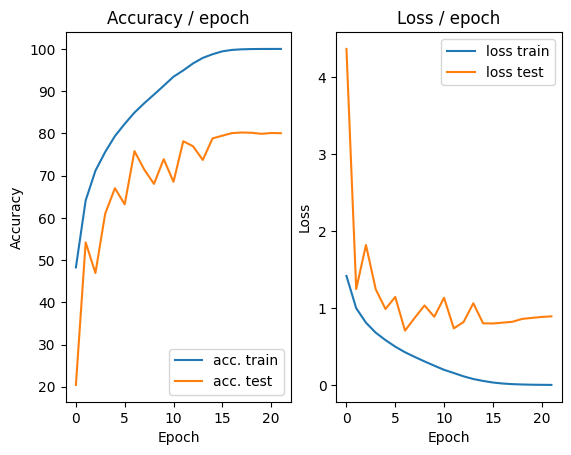

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.0058 (0.0058)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


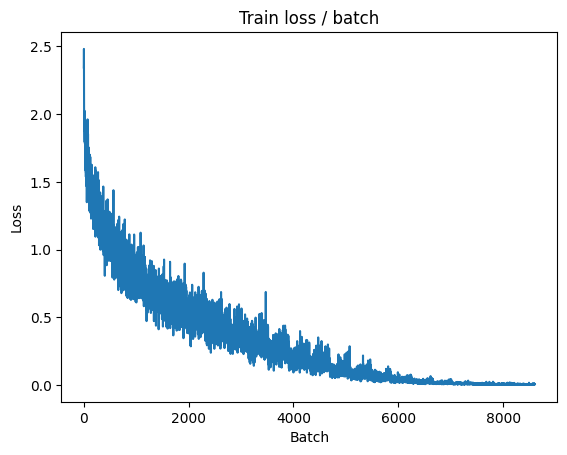

[TRAIN Batch 200/391]	Time 0.017s (0.024s)	Loss 0.0052 (0.0062)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


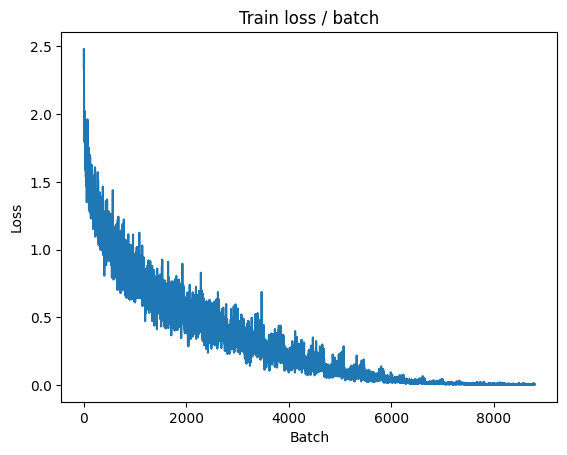


===============> Total time 10s	Avg loss 0.0063	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.8732 (0.8732)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9246	Avg Prec@1 80.09 %	Avg Prec@5 98.73 %



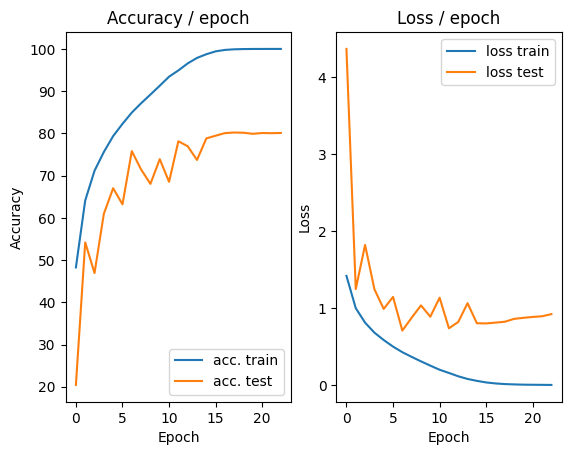

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 0.0066 (0.0066)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


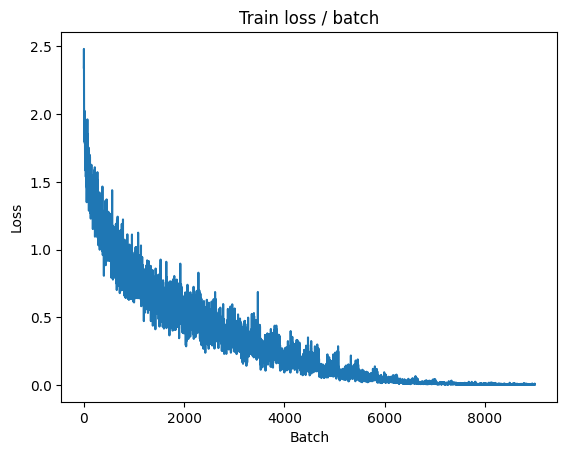

[TRAIN Batch 200/391]	Time 0.021s (0.024s)	Loss 0.0052 (0.0056)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


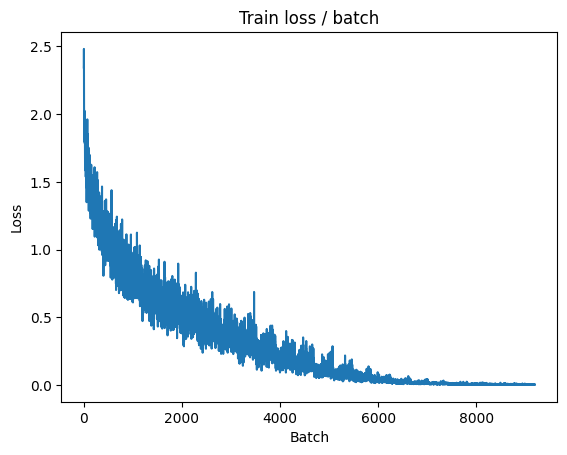


===============> Total time 10s	Avg loss 0.0056	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8270 (0.8270)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9177	Avg Prec@1 80.40 %	Avg Prec@5 98.82 %



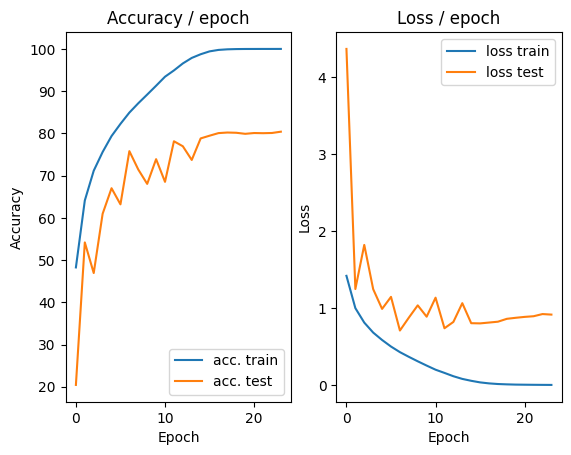

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0058 (0.0058)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


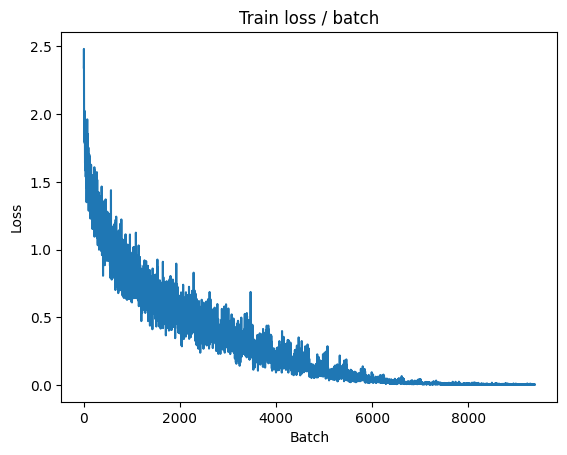

[TRAIN Batch 200/391]	Time 0.025s (0.025s)	Loss 0.0043 (0.0051)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


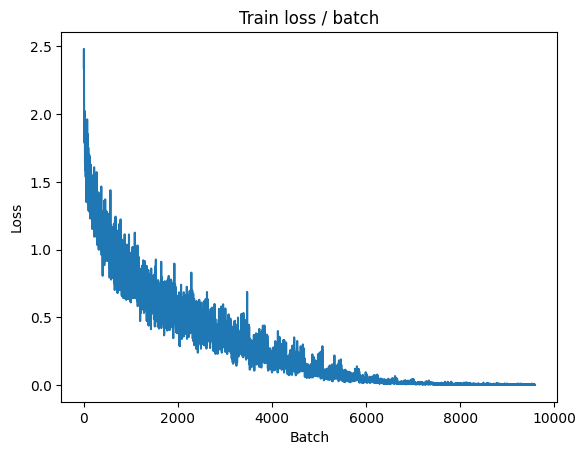


===============> Total time 10s	Avg loss 0.0051	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.8652 (0.8652)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9246	Avg Prec@1 80.40 %	Avg Prec@5 98.82 %



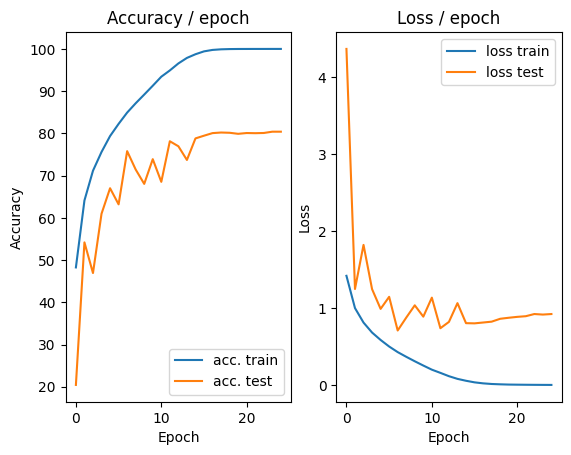

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.0061 (0.0061)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


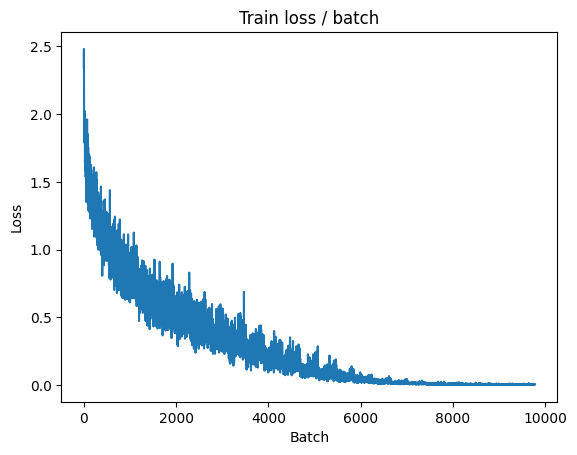

[TRAIN Batch 200/391]	Time 0.015s (0.024s)	Loss 0.0039 (0.0047)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


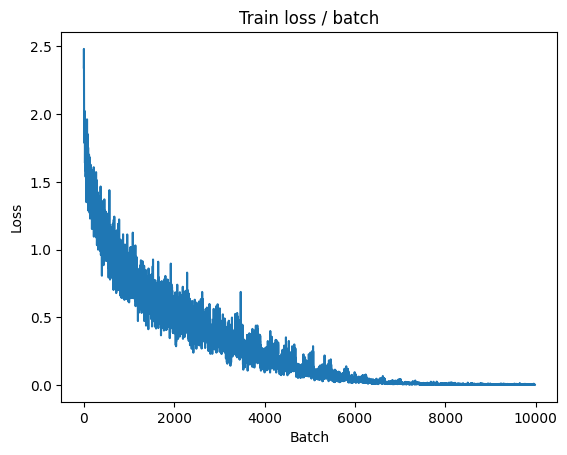


===============> Total time 10s	Avg loss 0.0048	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8409 (0.8409)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9396	Avg Prec@1 80.33 %	Avg Prec@5 98.76 %



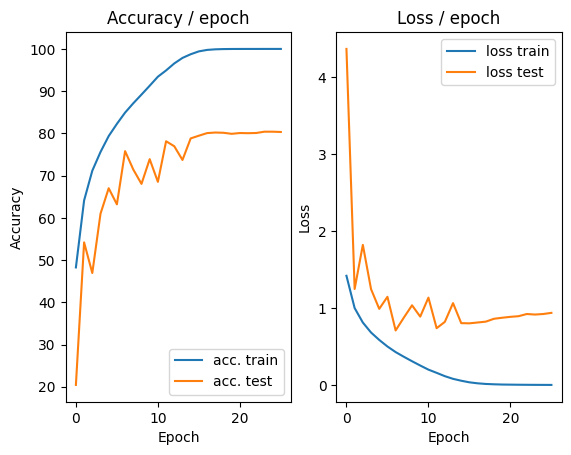

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.189s (0.189s)	Loss 0.0049 (0.0049)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


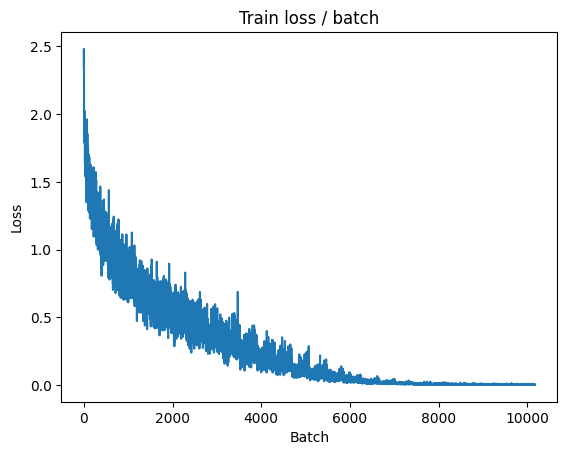

[TRAIN Batch 200/391]	Time 0.026s (0.024s)	Loss 0.0036 (0.0042)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


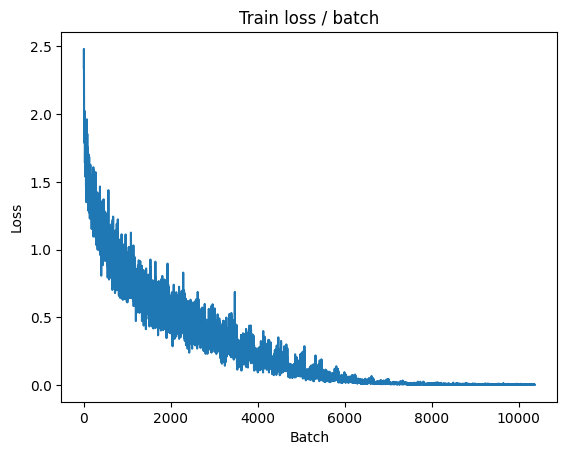


===============> Total time 10s	Avg loss 0.0043	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.8632 (0.8632)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9418	Avg Prec@1 80.29 %	Avg Prec@5 98.82 %



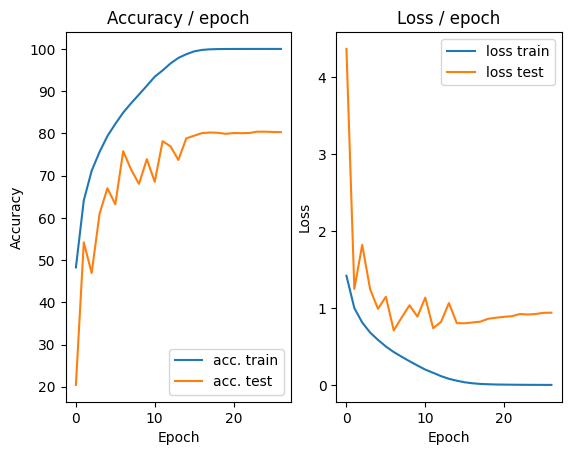

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0030 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


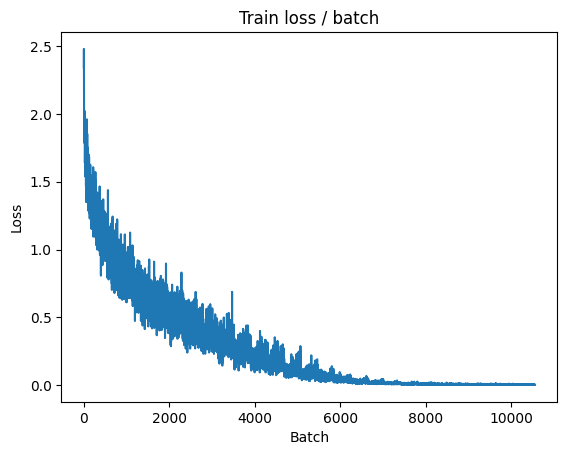

[TRAIN Batch 200/391]	Time 0.015s (0.024s)	Loss 0.0061 (0.0040)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


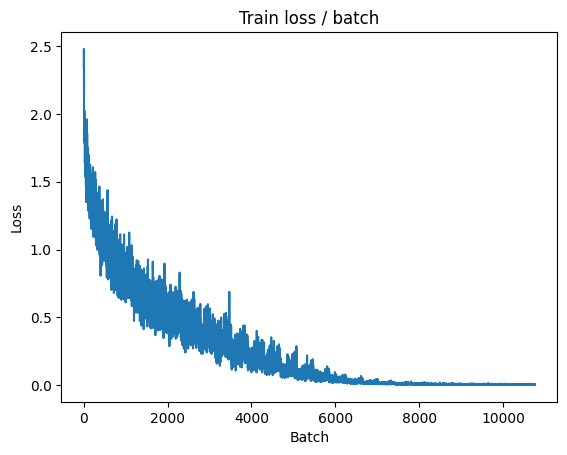


===============> Total time 10s	Avg loss 0.0041	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.8769 (0.8769)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9452	Avg Prec@1 80.48 %	Avg Prec@5 98.79 %



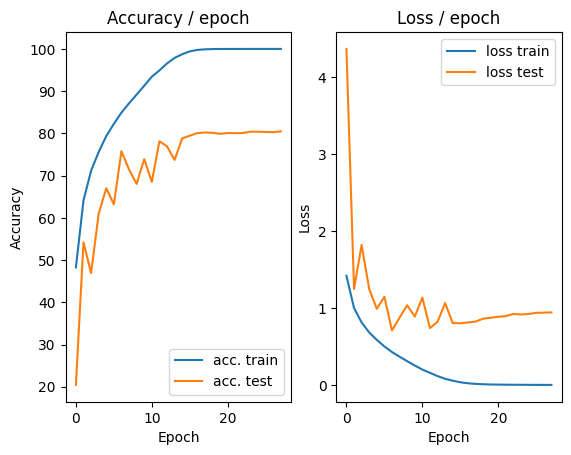

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 0.0043 (0.0043)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


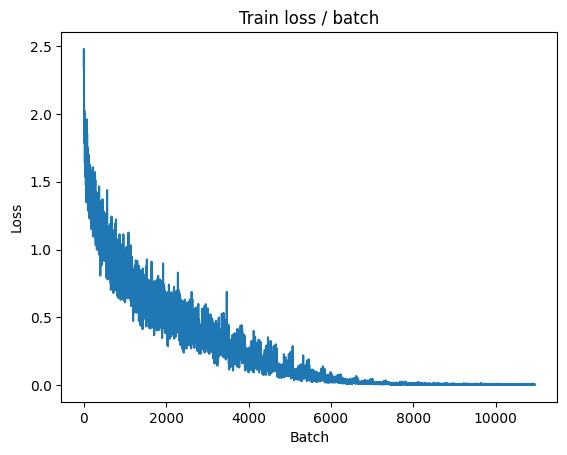

[TRAIN Batch 200/391]	Time 0.030s (0.025s)	Loss 0.0052 (0.0038)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


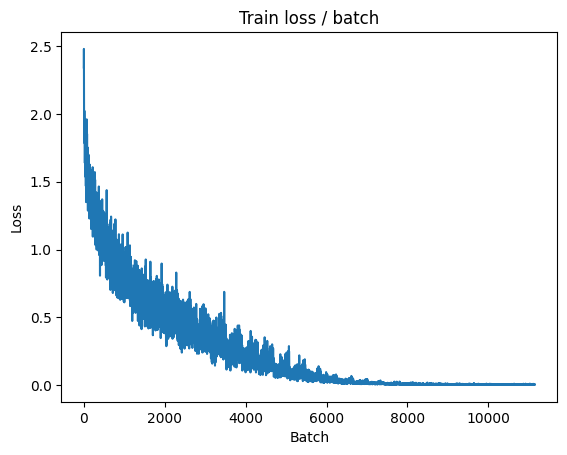


===============> Total time 10s	Avg loss 0.0039	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.8713 (0.8713)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9532	Avg Prec@1 80.43 %	Avg Prec@5 98.83 %



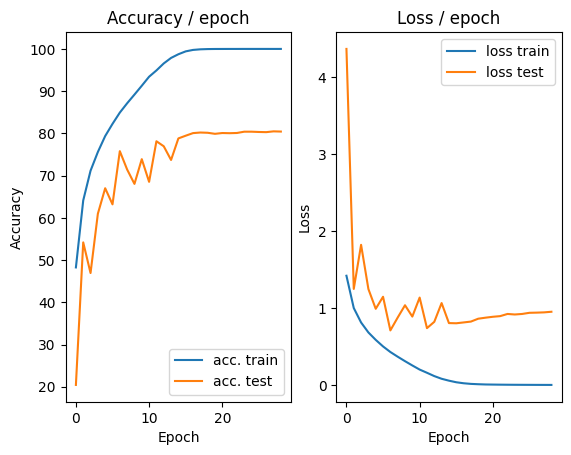

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.163s (0.163s)	Loss 0.0035 (0.0035)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


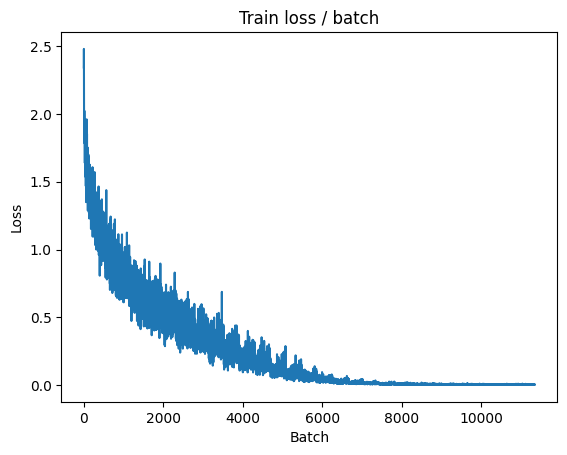

[TRAIN Batch 200/391]	Time 0.038s (0.024s)	Loss 0.0030 (0.0037)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


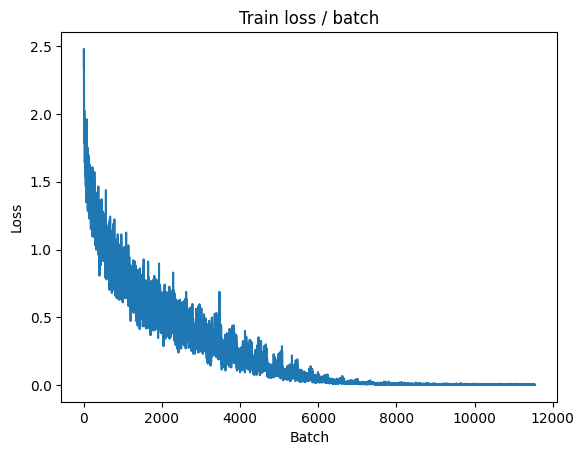


===============> Total time 10s	Avg loss 0.0037	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.8823 (0.8823)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9630	Avg Prec@1 80.21 %	Avg Prec@5 98.74 %



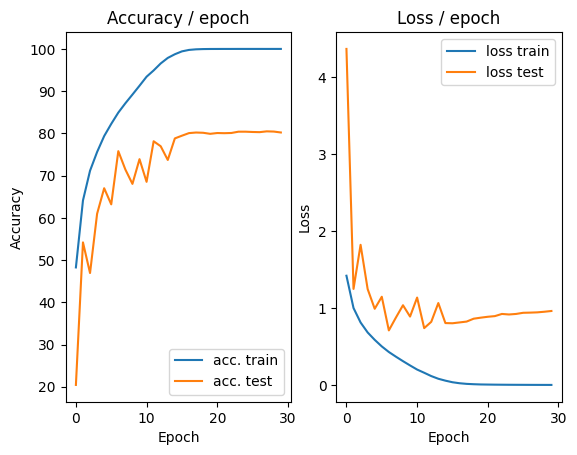

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0028 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


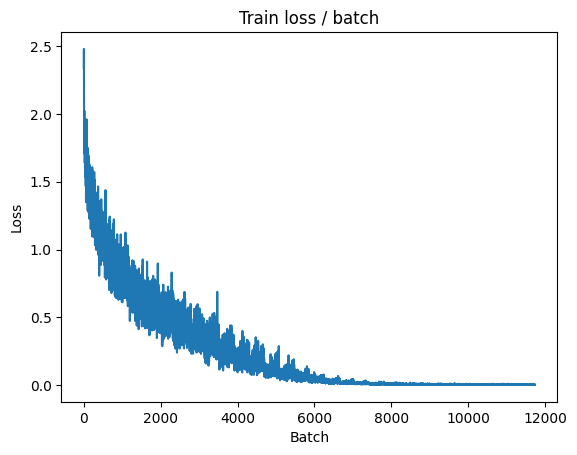

[TRAIN Batch 200/391]	Time 0.036s (0.024s)	Loss 0.0028 (0.0034)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


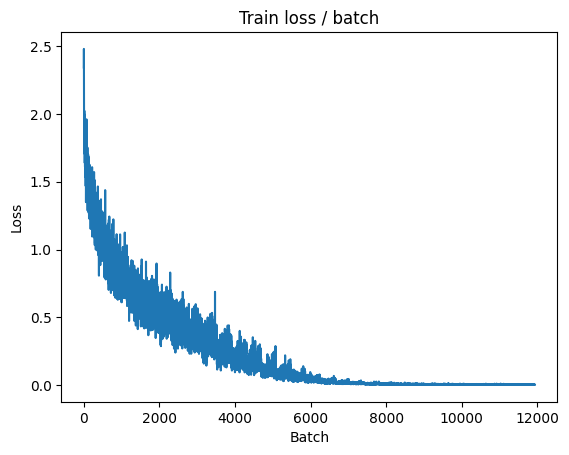


===============> Total time 10s	Avg loss 0.0034	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.9101 (0.9101)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9672	Avg Prec@1 80.36 %	Avg Prec@5 98.80 %



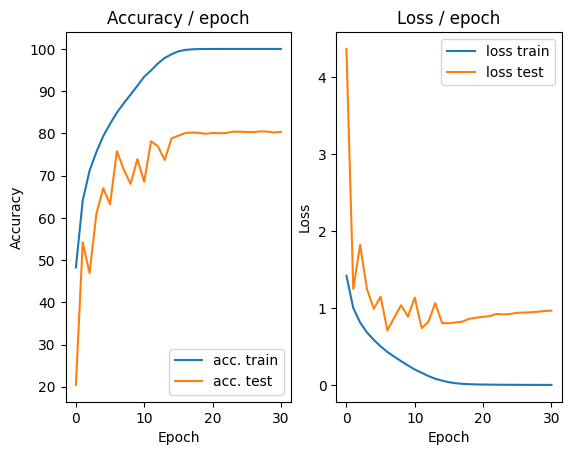

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.0041 (0.0041)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


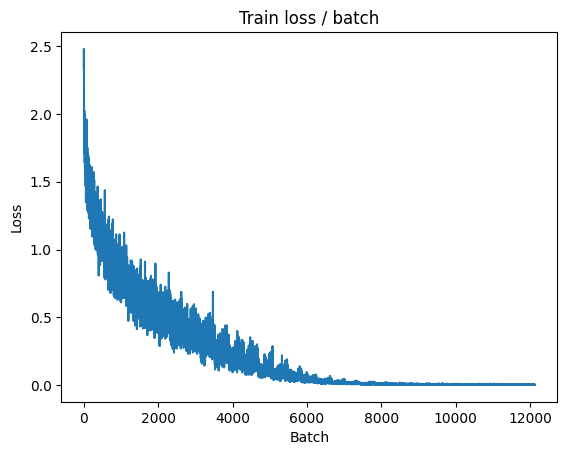

[TRAIN Batch 200/391]	Time 0.018s (0.025s)	Loss 0.0020 (0.0033)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


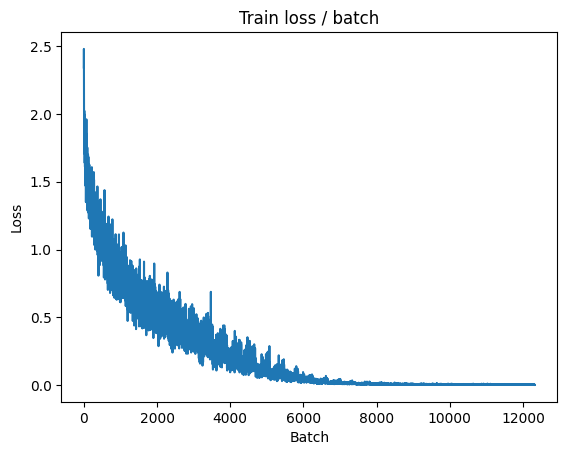


===============> Total time 10s	Avg loss 0.0033	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.9004 (0.9004)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9711	Avg Prec@1 80.30 %	Avg Prec@5 98.83 %



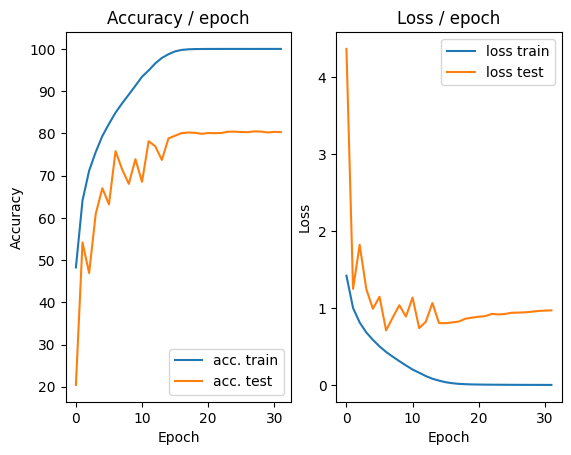

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.0030 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


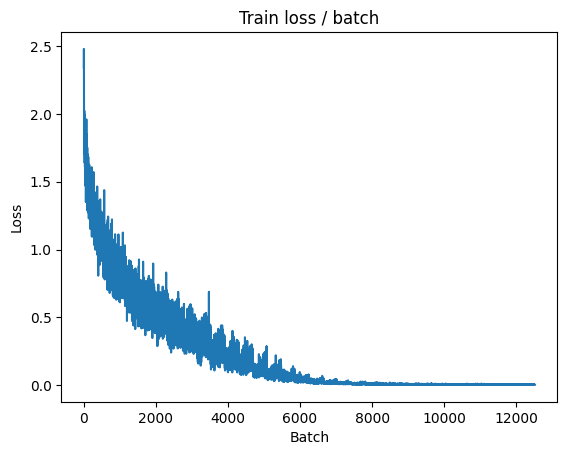

[TRAIN Batch 200/391]	Time 0.016s (0.025s)	Loss 0.0037 (0.0032)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


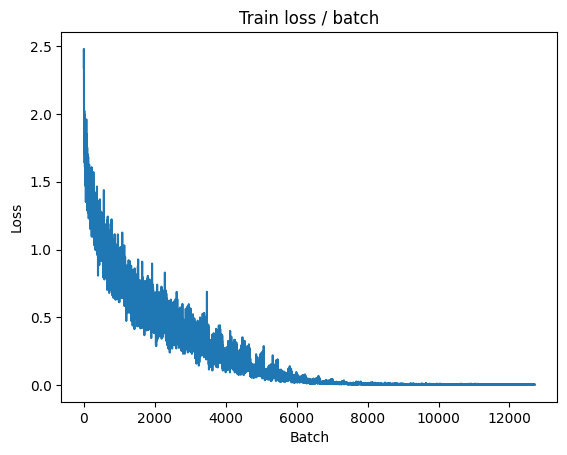


===============> Total time 10s	Avg loss 0.0032	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8979 (0.8979)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9783	Avg Prec@1 80.28 %	Avg Prec@5 98.77 %



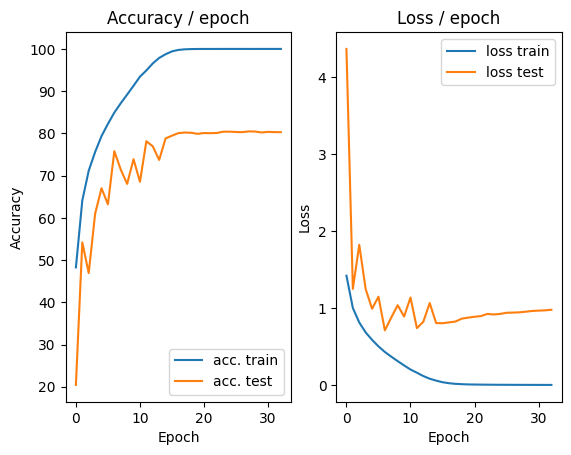

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.187s (0.187s)	Loss 0.0033 (0.0033)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


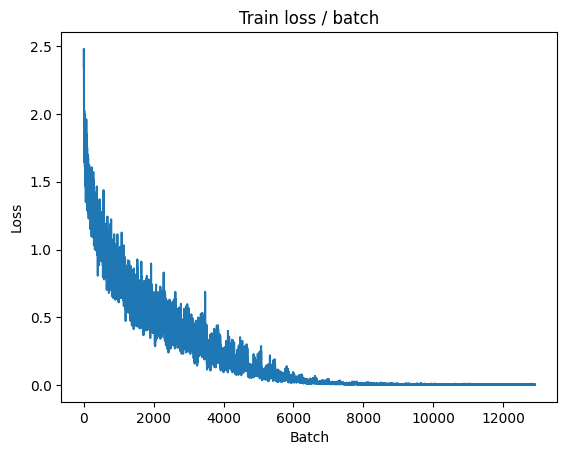

[TRAIN Batch 200/391]	Time 0.037s (0.025s)	Loss 0.0035 (0.0030)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


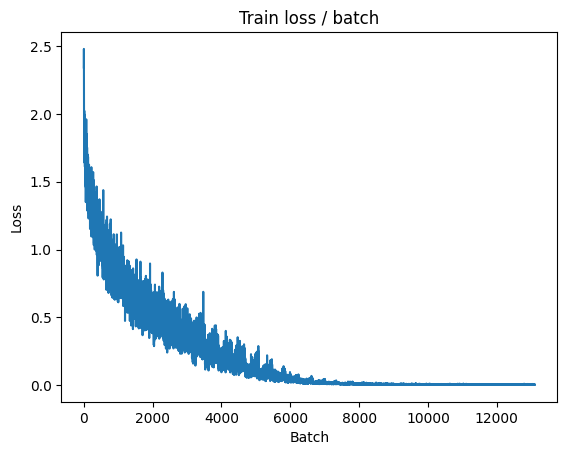


===============> Total time 10s	Avg loss 0.0031	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.8981 (0.8981)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9871	Avg Prec@1 80.19 %	Avg Prec@5 98.85 %



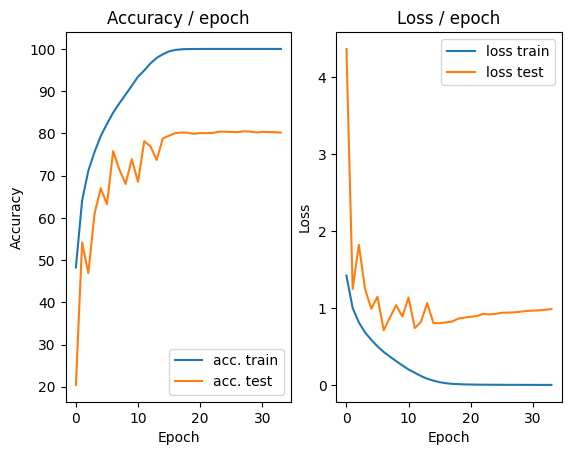

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.0024 (0.0024)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


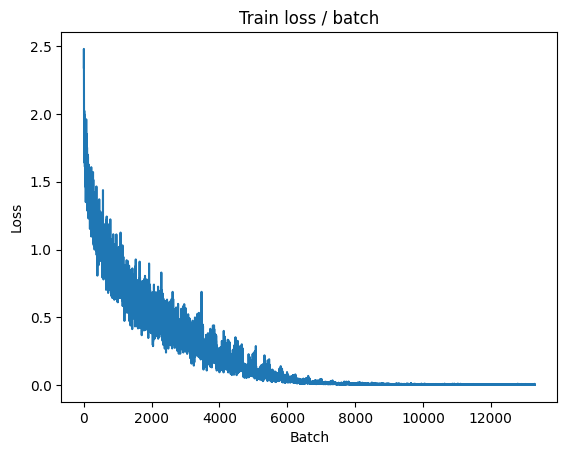

[TRAIN Batch 200/391]	Time 0.019s (0.024s)	Loss 0.0019 (0.0029)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


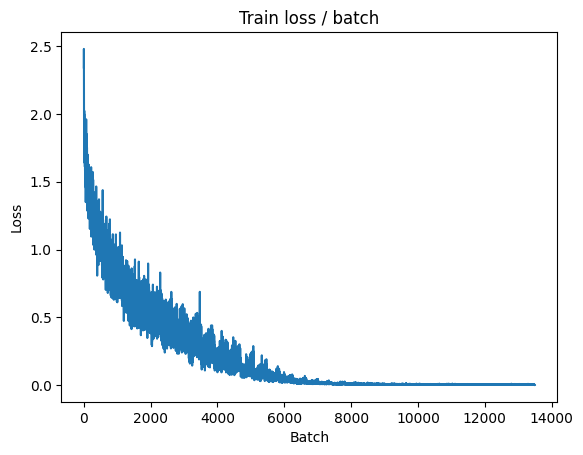


===============> Total time 10s	Avg loss 0.0030	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.9146 (0.9146)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9771	Avg Prec@1 80.29 %	Avg Prec@5 98.85 %



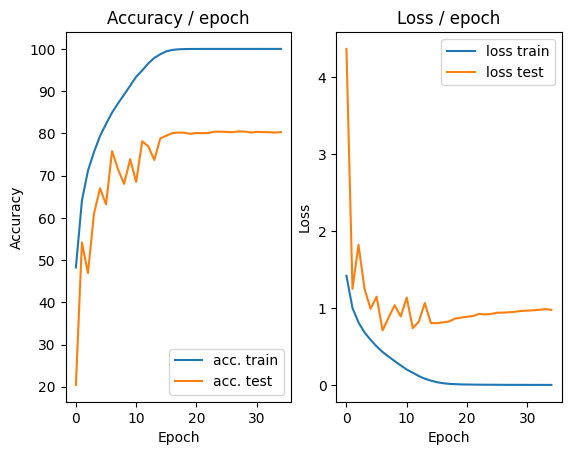

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.0021 (0.0021)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


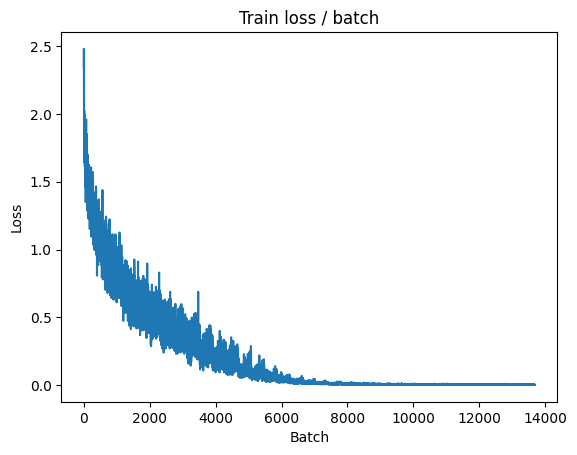

[TRAIN Batch 200/391]	Time 0.073s (0.025s)	Loss 0.0023 (0.0029)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


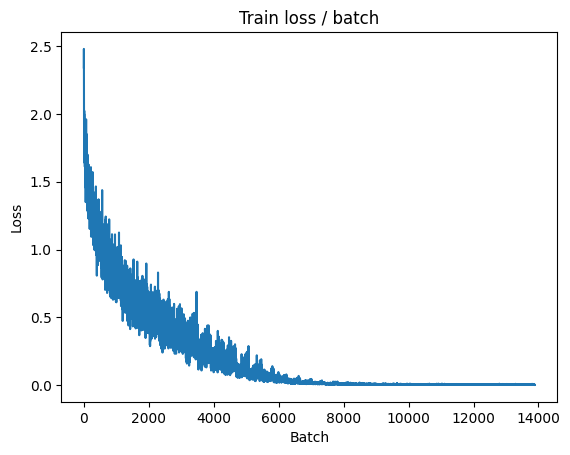


===============> Total time 10s	Avg loss 0.0029	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.8961 (0.8961)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9891	Avg Prec@1 80.23 %	Avg Prec@5 98.83 %



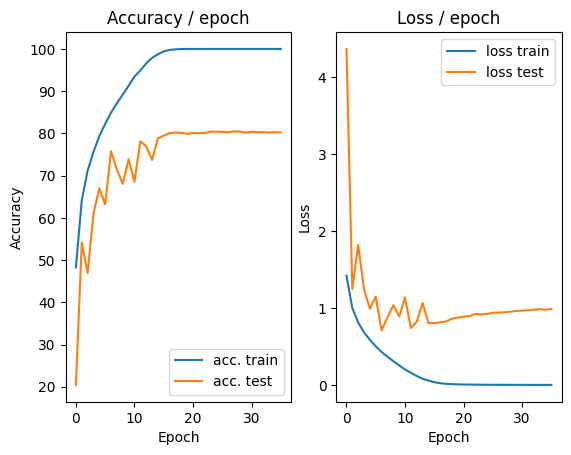

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.0035 (0.0035)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


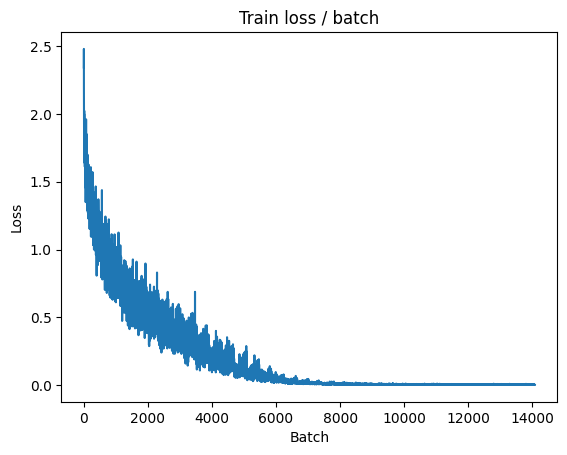

[TRAIN Batch 200/391]	Time 0.027s (0.024s)	Loss 0.0039 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


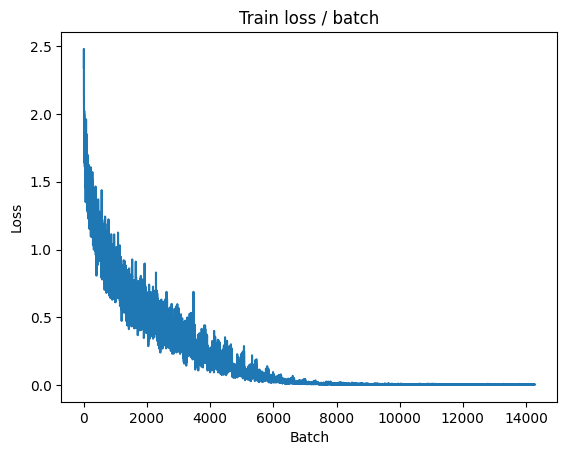


===============> Total time 10s	Avg loss 0.0029	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.9217 (0.9217)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0005	Avg Prec@1 80.13 %	Avg Prec@5 98.76 %



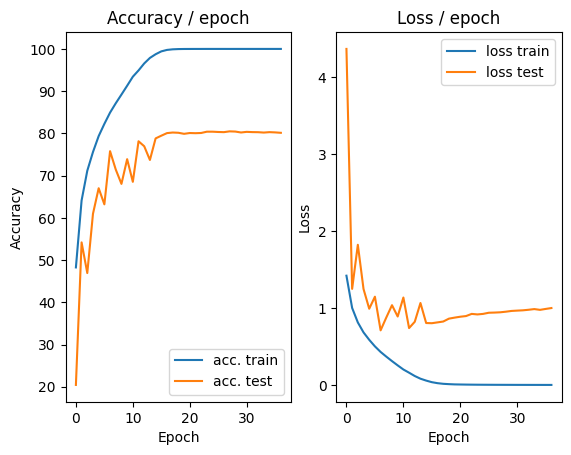

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0036 (0.0036)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


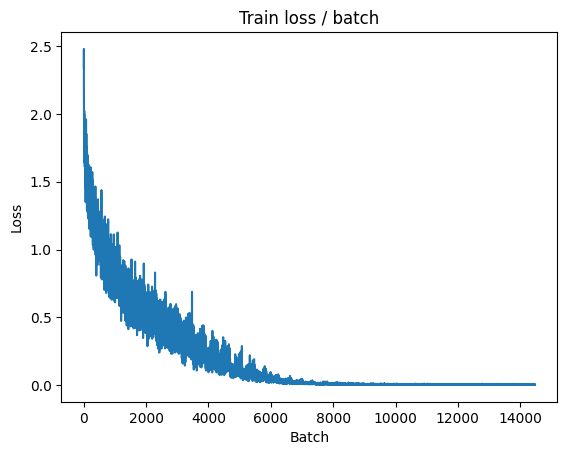

[TRAIN Batch 200/391]	Time 0.015s (0.025s)	Loss 0.0023 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


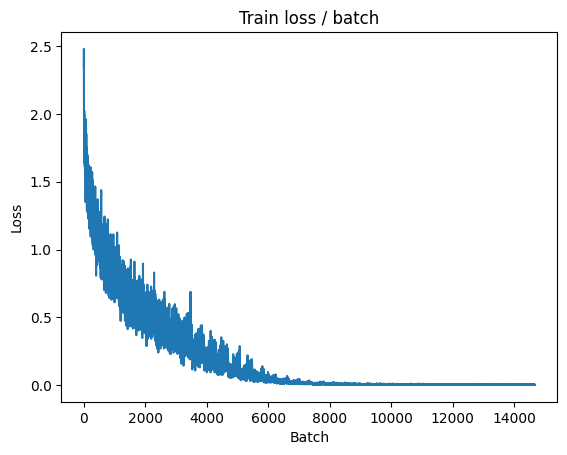


===============> Total time 10s	Avg loss 0.0027	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.9126 (0.9126)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9894	Avg Prec@1 80.35 %	Avg Prec@5 98.82 %



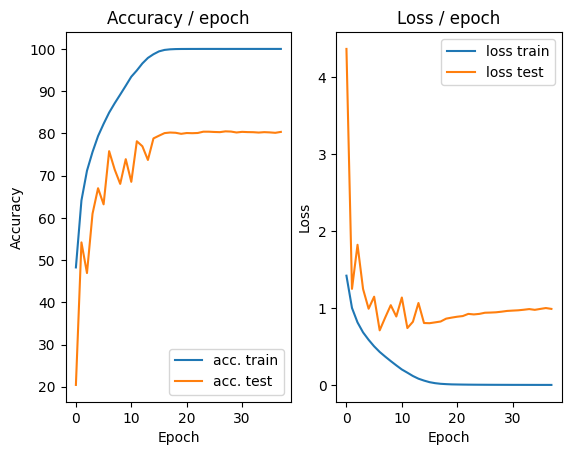

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.0026 (0.0026)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


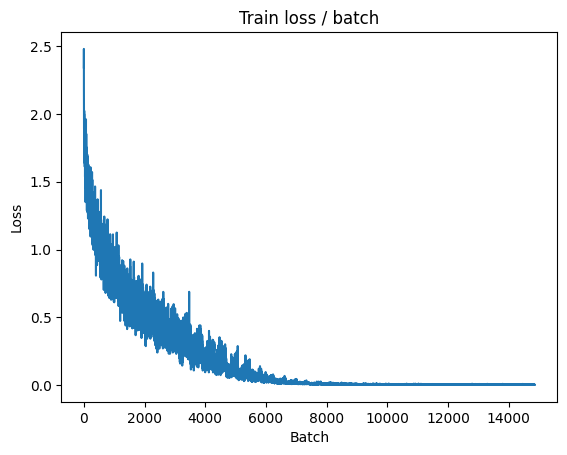

[TRAIN Batch 200/391]	Time 0.018s (0.025s)	Loss 0.0016 (0.0027)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


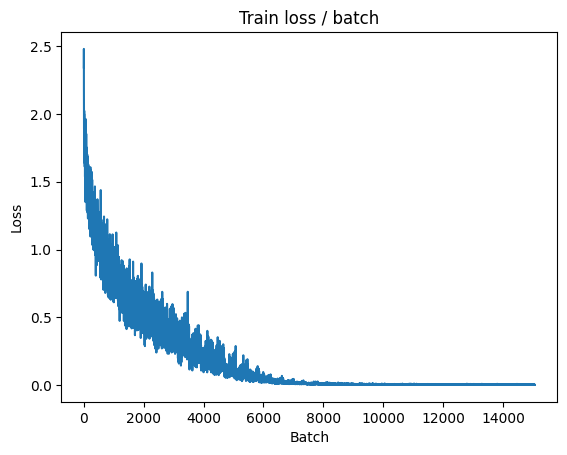


===============> Total time 10s	Avg loss 0.0027	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8999 (0.8999)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9953	Avg Prec@1 80.32 %	Avg Prec@5 98.82 %



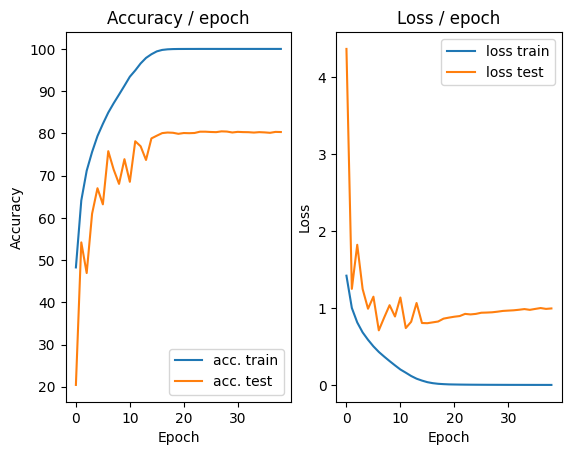

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.0025 (0.0025)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


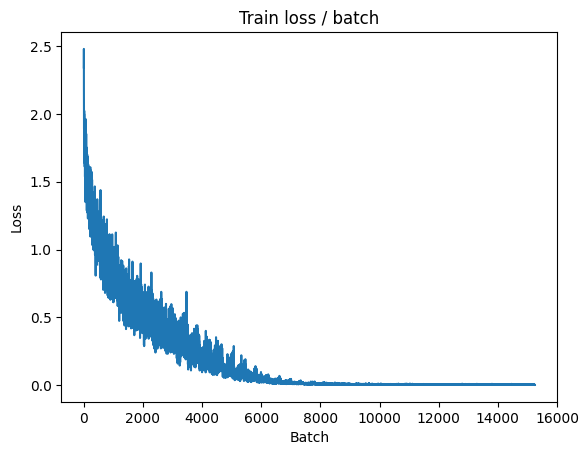

[TRAIN Batch 200/391]	Time 0.026s (0.024s)	Loss 0.0023 (0.0025)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


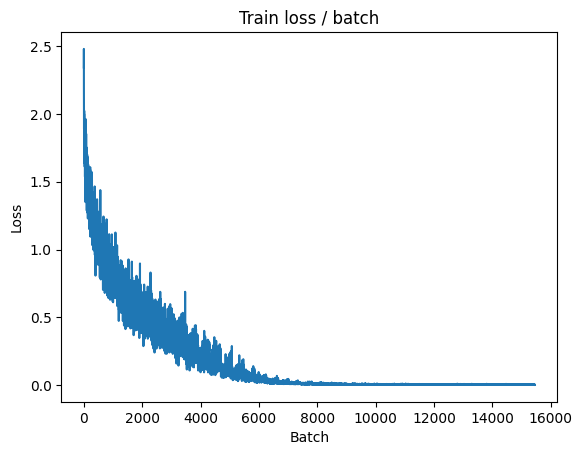


===============> Total time 10s	Avg loss 0.0026	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.185s (0.185s)	Loss 0.9085 (0.9085)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9974	Avg Prec@1 80.18 %	Avg Prec@5 98.83 %



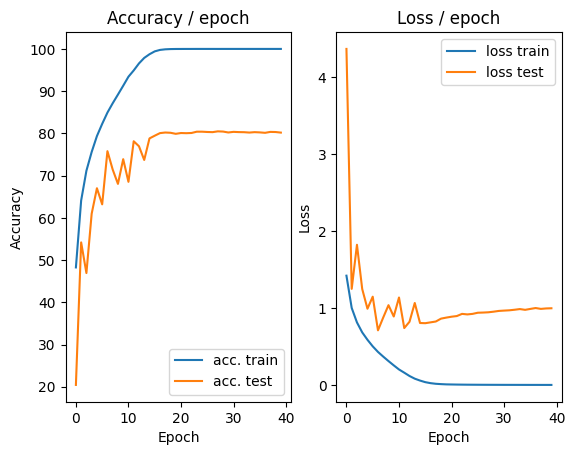

In [ ]:
main(batch_size=128, lr=0.1, epochs=40, cuda=True, model=ConvNetBatchNorm(), scheduler=True, get_dataset=get_dataset)